# Load Libraries

In [1]:
import numpy as np 
import matplotlib.pyplot as plt
import glob
import cv2

from keras.models import Model, Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
import os
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
list_of_architectures = [
    "Xception",
    "VGG16",
    "VGG19",
    "ResNet50V2",
    "ResNet101V2",
    "ResNet152V2",
    "InceptionV3",
    "MobileNet",
    "MobileNetV2",
    "DenseNet121",
    "DenseNet169",
    "DenseNet201"
    
]

In [3]:
list_of_classifiers = [
    "RF"
]

In [4]:
list_of_size = [
    128,
    256
]

In [5]:
layer = "last_layer"

In [6]:
preprocessing_technique = "smote_pca"

In [7]:
n_components = [50, 100, 500]

In [8]:
output_folder = "output"
analysis_output =  output_folder + "/" + layer + "_" + preprocessing_technique + "_fusion_2_axis0_RF_128_256.csv"

# get Data

In [9]:
import tensorflow as tf
def getData(model1, model2, image_size, n_component):
    X_data_dir="../pca/" + layer + "/" + str(image_size)+"/"
    y_train_data_dir="../class_imabalance/" + layer + "/" + str(image_size)+"/"
    y_test_data_dir="../feature_extractor/" + layer + "/" + str(image_size)+"/"
    
    X_train1=np.load(X_data_dir+model1+"_train_" + str(n_component) + ".npy")
    X_train2=np.load(X_data_dir+model2+"_train_" + str(n_component) + ".npy")
    X_train = tf.keras.layers.concatenate([X_train1, X_train2],
                            axis=0)
    
    y_train1=np.load(y_train_data_dir+model1+"_y_train_SMOTE.npy")
    y_train2=np.load(y_train_data_dir+model2+"_y_train_SMOTE.npy")
    y_train = tf.keras.layers.concatenate([y_train1, y_train2],
                            axis=0)
    
    X_test1=np.load(X_data_dir+model1+"_test_" + str(n_component) + ".npy")
    X_test2=np.load(X_data_dir+model2+"_test_" + str(n_component) + ".npy")
    X_test = tf.keras.layers.concatenate([X_test1, X_test2],
                            axis=0)
    
    y_test1=np.load(y_test_data_dir+"test_labels.npy")
    y_test2=np.load(y_test_data_dir+"test_labels.npy")
    y_test = tf.keras.layers.concatenate([y_test1, y_test2],
                            axis=0)
    
    return X_train, y_train, X_test, y_test

In [10]:
def getLabelEncoder(layer, image_size):
    label_encoder_location = "../feature_extractor/" + layer + "/" + str(image_size)+"/"
    label_encoder = np.load(label_encoder_location+'label_encoder.npy')
    return label_encoder

#  Reusable function for Confusion Matrix 

In [11]:
def getClassificationReport(test_labels, prediction):
    
    def plot_confusion_matrix(cm, classes,
                              normalize=False,
                              title='Confusion matrix',
                              cmap=plt.cm.Blues):
        """
        This function prints and plots the confusion matrix.
        Normalization can be applied by setting `normalize=True`.
        """
        import itertools
        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix")
        else:
            print('Confusion matrix, without normalization')

        #print(cm)

        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title)
        #plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        fmt = '.2f' if normalize else 'd'
        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

        plt.ylabel('True label')
        plt.xlabel('Predicted label')
        plt.tight_layout()
        plt.show()
        
    from sklearn.metrics import confusion_matrix
    test_label_list=list(np.unique(test_labels))
    cnf_matrix = confusion_matrix(test_labels, prediction,labels=test_label_list)
    np.set_printoptions(precision=2)

    # Plot non-normalized confusion matrix
    plt.figure(figsize=(8,8))
    plot_confusion_matrix(cnf_matrix, classes=test_label_list,
                          title='Confusion matrix, without normalization')
    
    
    from sklearn import metrics
    
    accuracy = round(metrics.accuracy_score(test_labels, prediction),3)
    precision = round(metrics.precision_score(test_labels, prediction, average='weighted'),3)
    recall = round(metrics.recall_score(test_labels, prediction, average='weighted'),3)
    f1_score = round(metrics.f1_score(test_labels, prediction, average='weighted'),3)
    
    # Balanced
    balanced_accuracy = round(metrics.balanced_accuracy_score(test_labels, prediction),3)
    
    FP = cnf_matrix.sum(axis=0) - np.diag(cnf_matrix)  
    FN = cnf_matrix.sum(axis=1) - np.diag(cnf_matrix)
    TP = np.diag(cnf_matrix)
    TN = cnf_matrix.sum() - (FP + FN + TP)
    
    # Sensitivity, hit rate, recall, or true positive rate
    TPR = round((TP/(TP+FN)).mean(),3)
    # Specificity or true negative rate
    TNR = round((TN/(TN+FP) ).mean(),3)
    # Precision or positive predictive value
    PPV = round((TP/(TP+FP)).mean(),3)
    # Negative predictive value
    NPV = round((TN/(TN+FN)).mean(),3)
    # Fall out or false positive rate
    FPR = round((FP/(FP+TN)).mean(),3)
    # False negative rate
    FNR = round((FN/(TP+FN)).mean(),3)
    # False discovery rate
    FDR = round((FP/(TP+FP)).mean(),3)

    # Overall accuracy
    Overall_Acc = round(((TP+TN)/(TP+FP+FN+TN)).mean(),3)
    Bal_F1 = round((2*(PPV*TPR)/(PPV+TPR)),3)
    
    
    print("Acc     = ", accuracy)
    print("Pre     = ", precision)
    print("Rec     = ", recall)
    print("F1      = ", f1_score)
    print("")
    
    print("Bal_Acc = ", balanced_accuracy)
    print("Bal_Pre = ", PPV)
    print("Bal_Rec = ", TPR)
    print("Bal_F1  = ", Bal_F1)
    print("")
    
    from sklearn.metrics import classification_report, confusion_matrix
    print(classification_report(test_labels, prediction))
    
    return accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc


# Classifier

In [12]:
def classify(model1, model2, classifier, image_size, n_component):
    X_train, y_train, X_test, y_test = getData(model1, model2, image_size, n_component)

    if classifier == "RF":
        from sklearn.ensemble import RandomForestClassifier
        model = RandomForestClassifier(n_estimators = 100, random_state = 42)
    elif classifier == "SVM":
        from sklearn.svm import SVC
        model = SVC(kernel='linear', degree=3, C=1, decision_function_shape='ovo')
        
    # Train the model on training data
    model.fit(X_train, y_train) #For sklearn no one hot encoding

    #Now predict using the trained RF model. 
    prediction = model.predict(X_test)
    
    #get the encoder from the pickle file
    from sklearn import preprocessing
    le = preprocessing.LabelEncoder()
    le.classes_ = getLabelEncoder(layer, image_size)
    
    """
    import pickle
    model_loc = "models"
    filename = model_loc + "/" + layer + "_" + preprocessing_technique + "_" + 'classifier'  + "_" + model_name + "_" + classifier + "_" + str(image_size) + " .sav "
    pickle.dump(model, open(filename, 'wb'))
    """
    
    #Inverse le transform to get original label back. 
    prediction = le.inverse_transform(prediction)
    y_test = le.inverse_transform(y_test)
    
    accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc = getClassificationReport(y_test, prediction)
    return accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc

In [13]:
from itertools import combinations
list_of_combinations=[",".join(map(str, comb)) for comb in combinations(list_of_architectures, 2)]
list_of_combinations

['Xception,VGG16',
 'Xception,VGG19',
 'Xception,ResNet50V2',
 'Xception,ResNet101V2',
 'Xception,ResNet152V2',
 'Xception,InceptionV3',
 'Xception,MobileNet',
 'Xception,MobileNetV2',
 'Xception,DenseNet121',
 'Xception,DenseNet169',
 'Xception,DenseNet201',
 'VGG16,VGG19',
 'VGG16,ResNet50V2',
 'VGG16,ResNet101V2',
 'VGG16,ResNet152V2',
 'VGG16,InceptionV3',
 'VGG16,MobileNet',
 'VGG16,MobileNetV2',
 'VGG16,DenseNet121',
 'VGG16,DenseNet169',
 'VGG16,DenseNet201',
 'VGG19,ResNet50V2',
 'VGG19,ResNet101V2',
 'VGG19,ResNet152V2',
 'VGG19,InceptionV3',
 'VGG19,MobileNet',
 'VGG19,MobileNetV2',
 'VGG19,DenseNet121',
 'VGG19,DenseNet169',
 'VGG19,DenseNet201',
 'ResNet50V2,ResNet101V2',
 'ResNet50V2,ResNet152V2',
 'ResNet50V2,InceptionV3',
 'ResNet50V2,MobileNet',
 'ResNet50V2,MobileNetV2',
 'ResNet50V2,DenseNet121',
 'ResNet50V2,DenseNet169',
 'ResNet50V2,DenseNet201',
 'ResNet101V2,ResNet152V2',
 'ResNet101V2,InceptionV3',
 'ResNet101V2,MobileNet',
 'ResNet101V2,MobileNetV2',
 'ResNet10

--------------------------------------------------------------------------
RF Xception VGG16 128 50


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, y

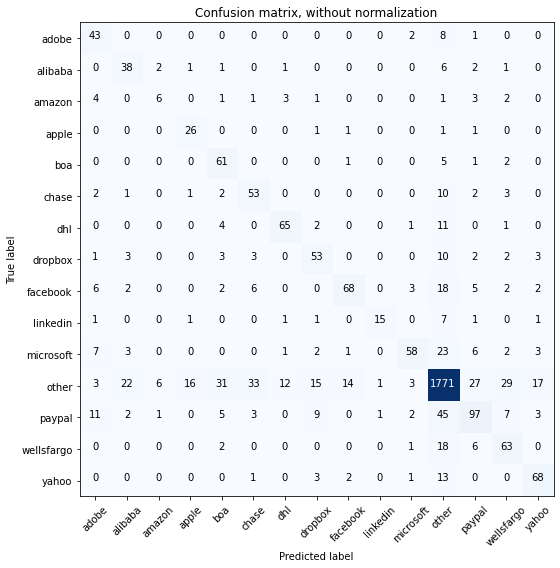

Acc     =  0.807
Pre     =  0.82
Rec     =  0.807
F1      =  0.809

Bal_Acc =  0.683
Bal_Pre =  0.654
Bal_Rec =  0.683
Bal_F1  =  0.668

              precision    recall  f1-score   support

       adobe       0.55      0.80      0.65        54
     alibaba       0.54      0.73      0.62        52
      amazon       0.40      0.27      0.32        22
       apple       0.58      0.87      0.69        30
         boa       0.54      0.87      0.67        70
       chase       0.53      0.72      0.61        74
         dhl       0.78      0.77      0.78        84
     dropbox       0.61      0.66      0.63        80
    facebook       0.78      0.60      0.68       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.82      0.55      0.66       106
       other       0.91      0.89      0.90      2000
      paypal       0.63      0.52      0.57       186
  wellsfargo       0.55      0.70      0.62        90
       yahoo       0.70      0.77      0.74        8

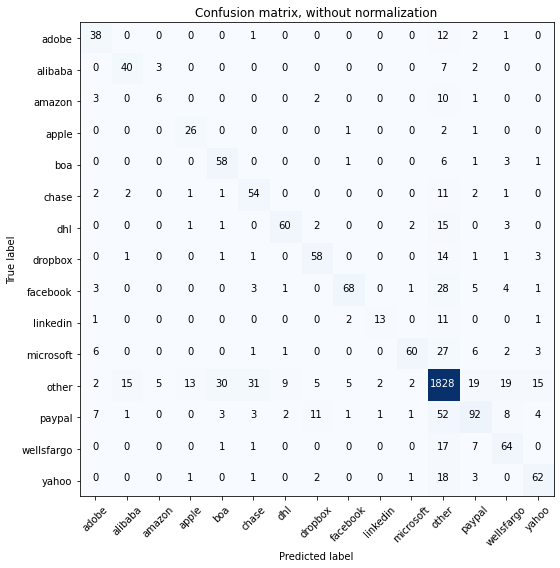

Acc     =  0.821
Pre     =  0.824
Rec     =  0.821
F1      =  0.818

Bal_Acc =  0.671
Bal_Pre =  0.698
Bal_Rec =  0.671
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.61      0.70      0.66        54
     alibaba       0.68      0.77      0.72        52
      amazon       0.43      0.27      0.33        22
       apple       0.62      0.87      0.72        30
         boa       0.61      0.83      0.70        70
       chase       0.56      0.73      0.64        74
         dhl       0.82      0.71      0.76        84
     dropbox       0.72      0.72      0.73        80
    facebook       0.87      0.60      0.71       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.90      0.57      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.65      0.49      0.56       186
  wellsfargo       0.60      0.71      0.65        90
       yahoo       0.69      0.70      0.70        

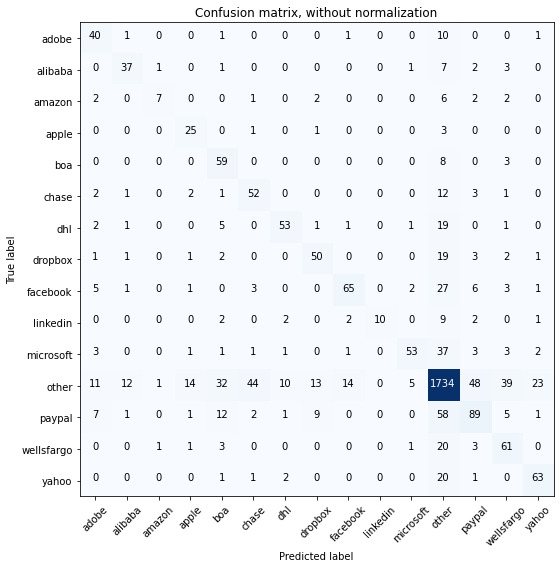

Acc     =  0.779
Pre     =  0.793
Rec     =  0.779
F1      =  0.779

Bal_Acc =  0.638
Bal_Pre =  0.672
Bal_Rec =  0.638
Bal_F1  =  0.655

              precision    recall  f1-score   support

       adobe       0.55      0.74      0.63        54
     alibaba       0.67      0.71      0.69        52
      amazon       0.70      0.32      0.44        22
       apple       0.54      0.83      0.66        30
         boa       0.49      0.84      0.62        70
       chase       0.50      0.70      0.58        74
         dhl       0.77      0.63      0.69        84
     dropbox       0.66      0.62      0.64        80
    facebook       0.77      0.57      0.66       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.84      0.50      0.63       106
       other       0.87      0.87      0.87      2000
      paypal       0.55      0.48      0.51       186
  wellsfargo       0.50      0.68      0.57        90
       yahoo       0.68      0.72      0.70        

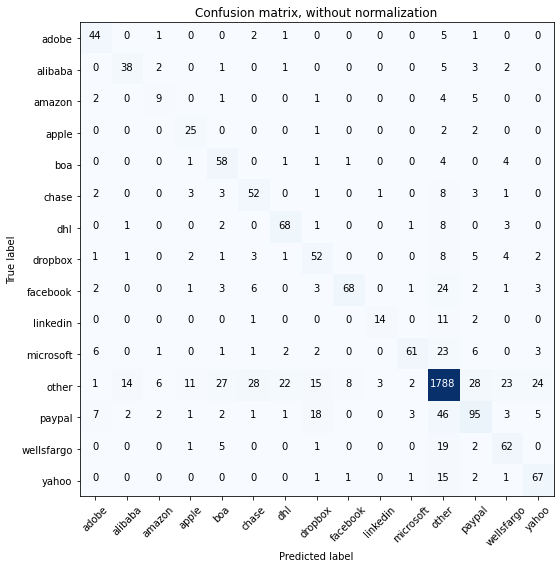

Acc     =  0.813
Pre     =  0.823
Rec     =  0.813
F1      =  0.813

Bal_Acc =  0.687
Bal_Pre =  0.665
Bal_Rec =  0.687
Bal_F1  =  0.676

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.68      0.73      0.70        52
      amazon       0.43      0.41      0.42        22
       apple       0.56      0.83      0.67        30
         boa       0.56      0.83      0.67        70
       chase       0.55      0.70      0.62        74
         dhl       0.70      0.81      0.75        84
     dropbox       0.54      0.65      0.59        80
    facebook       0.87      0.60      0.71       114
    linkedin       0.78      0.50      0.61        28
   microsoft       0.88      0.58      0.70       106
       other       0.91      0.89      0.90      2000
      paypal       0.61      0.51      0.56       186
  wellsfargo       0.60      0.69      0.64        90
       yahoo       0.64      0.76      0.70        

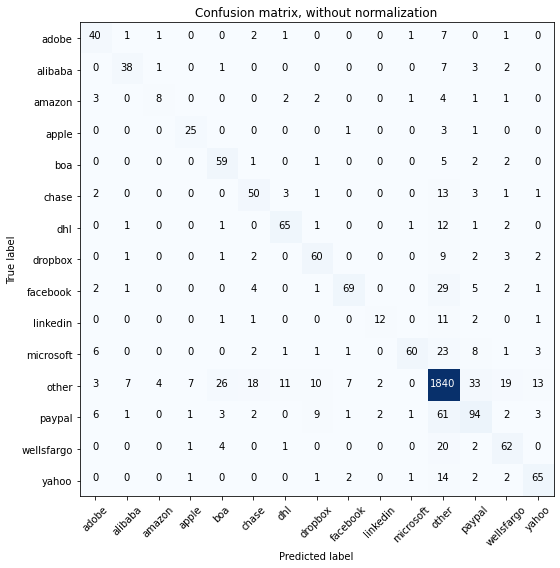

Acc     =  0.827
Pre     =  0.829
Rec     =  0.827
F1      =  0.824

Bal_Acc =  0.678
Bal_Pre =  0.716
Bal_Rec =  0.678
Bal_F1  =  0.696

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.76      0.73      0.75        52
      amazon       0.57      0.36      0.44        22
       apple       0.71      0.83      0.77        30
         boa       0.61      0.84      0.71        70
       chase       0.61      0.68      0.64        74
         dhl       0.77      0.77      0.77        84
     dropbox       0.69      0.75      0.72        80
    facebook       0.85      0.61      0.71       114
    linkedin       0.75      0.43      0.55        28
   microsoft       0.92      0.57      0.70       106
       other       0.89      0.92      0.91      2000
      paypal       0.59      0.51      0.54       186
  wellsfargo       0.62      0.69      0.65        90
       yahoo       0.73      0.74      0.73        

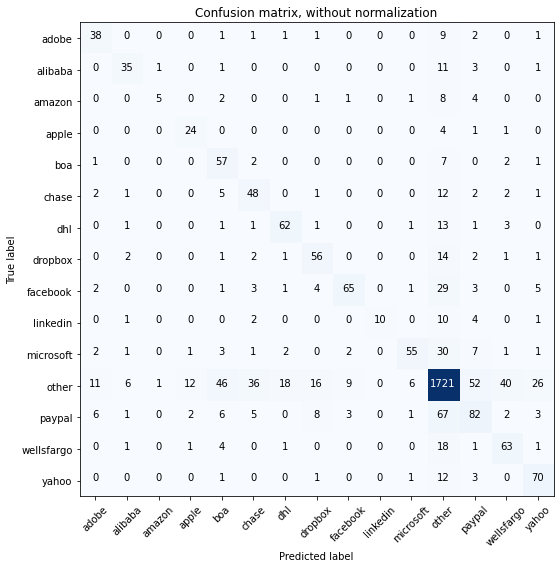

Acc     =  0.777
Pre     =  0.792
Rec     =  0.777
F1      =  0.777

Bal_Acc =  0.637
Bal_Pre =  0.673
Bal_Rec =  0.637
Bal_F1  =  0.655

              precision    recall  f1-score   support

       adobe       0.61      0.70      0.66        54
     alibaba       0.71      0.67      0.69        52
      amazon       0.71      0.23      0.34        22
       apple       0.60      0.80      0.69        30
         boa       0.44      0.81      0.57        70
       chase       0.48      0.65      0.55        74
         dhl       0.72      0.74      0.73        84
     dropbox       0.63      0.70      0.66        80
    facebook       0.81      0.57      0.67       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.83      0.52      0.64       106
       other       0.88      0.86      0.87      2000
      paypal       0.49      0.44      0.46       186
  wellsfargo       0.55      0.70      0.61        90
       yahoo       0.62      0.80      0.70        

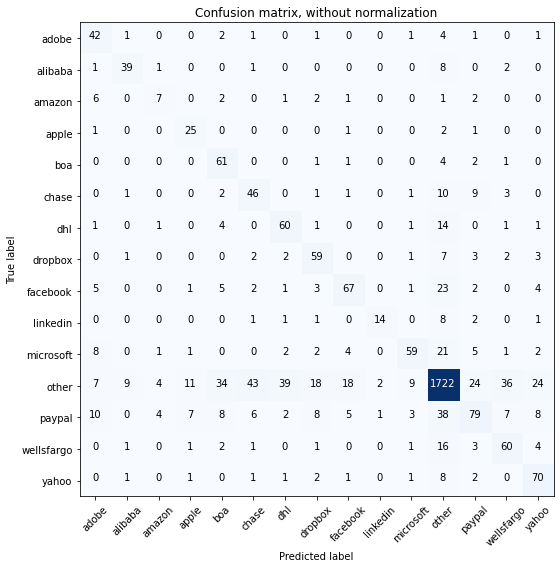

Acc     =  0.783
Pre     =  0.802
Rec     =  0.783
F1      =  0.787

Bal_Acc =  0.668
Bal_Pre =  0.61
Bal_Rec =  0.668
Bal_F1  =  0.638

              precision    recall  f1-score   support

       adobe       0.52      0.78      0.62        54
     alibaba       0.74      0.75      0.74        52
      amazon       0.39      0.32      0.35        22
       apple       0.53      0.83      0.65        30
         boa       0.51      0.87      0.64        70
       chase       0.44      0.62      0.52        74
         dhl       0.55      0.71      0.62        84
     dropbox       0.59      0.74      0.66        80
    facebook       0.68      0.59      0.63       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.76      0.56      0.64       106
       other       0.91      0.86      0.89      2000
      paypal       0.59      0.42      0.49       186
  wellsfargo       0.53      0.67      0.59        90
       yahoo       0.59      0.80      0.68        8

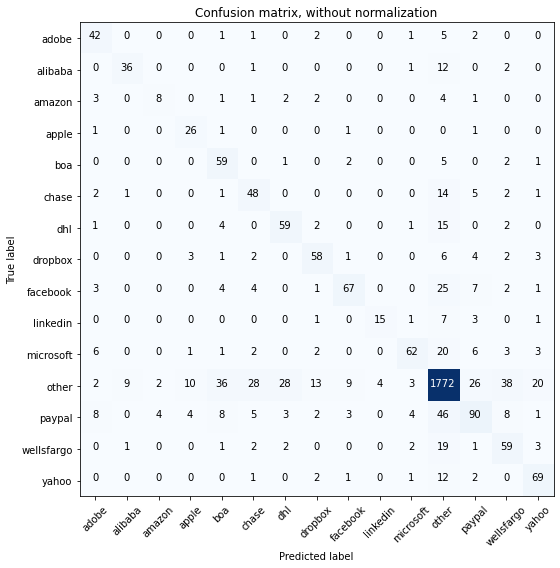

Acc     =  0.802
Pre     =  0.814
Rec     =  0.802
F1      =  0.804

Bal_Acc =  0.676
Bal_Pre =  0.662
Bal_Rec =  0.676
Bal_F1  =  0.669

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        54
     alibaba       0.77      0.69      0.73        52
      amazon       0.57      0.36      0.44        22
       apple       0.59      0.87      0.70        30
         boa       0.50      0.84      0.63        70
       chase       0.51      0.65      0.57        74
         dhl       0.62      0.70      0.66        84
     dropbox       0.68      0.72      0.70        80
    facebook       0.80      0.59      0.68       114
    linkedin       0.79      0.54      0.64        28
   microsoft       0.82      0.58      0.68       106
       other       0.90      0.89      0.89      2000
      paypal       0.61      0.48      0.54       186
  wellsfargo       0.49      0.66      0.56        90
       yahoo       0.67      0.78      0.72        

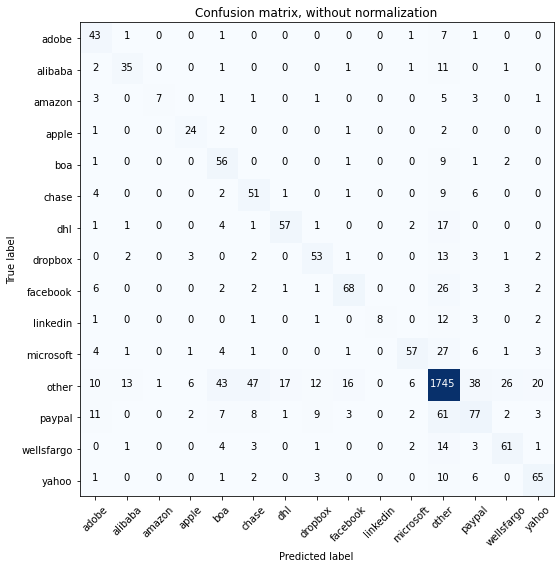

Acc     =  0.782
Pre     =  0.798
Rec     =  0.782
F1      =  0.783

Bal_Acc =  0.636
Bal_Pre =  0.677
Bal_Rec =  0.636
Bal_F1  =  0.656

              precision    recall  f1-score   support

       adobe       0.49      0.80      0.61        54
     alibaba       0.65      0.67      0.66        52
      amazon       0.88      0.32      0.47        22
       apple       0.67      0.80      0.73        30
         boa       0.44      0.80      0.57        70
       chase       0.43      0.69      0.53        74
         dhl       0.74      0.68      0.71        84
     dropbox       0.65      0.66      0.65        80
    facebook       0.73      0.60      0.66       114
    linkedin       1.00      0.29      0.44        28
   microsoft       0.80      0.54      0.64       106
       other       0.89      0.87      0.88      2000
      paypal       0.51      0.41      0.46       186
  wellsfargo       0.63      0.68      0.65        90
       yahoo       0.66      0.74      0.70        

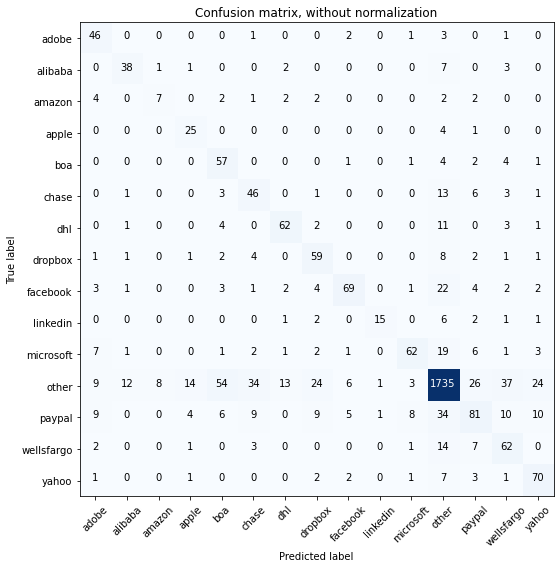

Acc     =  0.791
Pre     =  0.813
Rec     =  0.791
F1      =  0.796

Bal_Acc =  0.677
Bal_Pre =  0.631
Bal_Rec =  0.677
Bal_F1  =  0.653

              precision    recall  f1-score   support

       adobe       0.56      0.85      0.68        54
     alibaba       0.69      0.73      0.71        52
      amazon       0.44      0.32      0.37        22
       apple       0.53      0.83      0.65        30
         boa       0.43      0.81      0.56        70
       chase       0.46      0.62      0.53        74
         dhl       0.75      0.74      0.74        84
     dropbox       0.55      0.74      0.63        80
    facebook       0.80      0.61      0.69       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.79      0.58      0.67       106
       other       0.92      0.87      0.89      2000
      paypal       0.57      0.44      0.49       186
  wellsfargo       0.48      0.69      0.57        90
       yahoo       0.61      0.80      0.69        

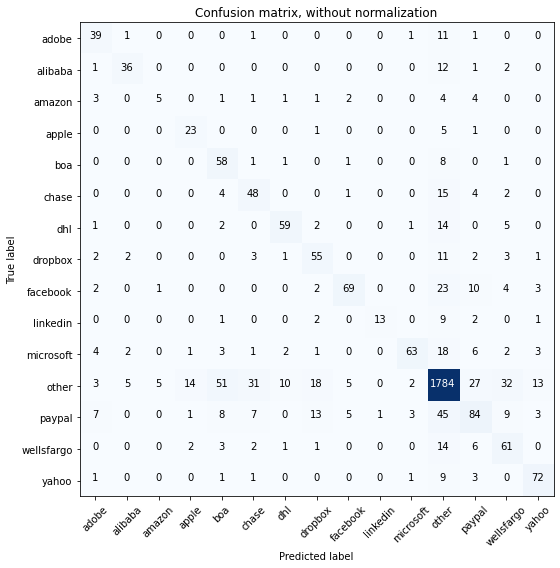

Acc     =  0.802
Pre     =  0.816
Rec     =  0.802
F1      =  0.803

Bal_Acc =  0.652
Bal_Pre =  0.672
Bal_Rec =  0.652
Bal_F1  =  0.662

              precision    recall  f1-score   support

       adobe       0.62      0.72      0.67        54
     alibaba       0.78      0.69      0.73        52
      amazon       0.45      0.23      0.30        22
       apple       0.56      0.77      0.65        30
         boa       0.44      0.83      0.57        70
       chase       0.50      0.65      0.56        74
         dhl       0.79      0.70      0.74        84
     dropbox       0.57      0.69      0.62        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.89      0.59      0.71       106
       other       0.90      0.89      0.90      2000
      paypal       0.56      0.45      0.50       186
  wellsfargo       0.50      0.68      0.58        90
       yahoo       0.75      0.82      0.78        

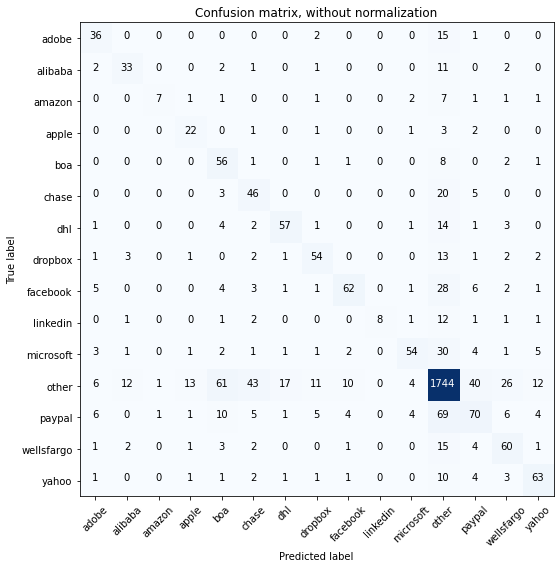

Acc     =  0.771
Pre     =  0.785
Rec     =  0.771
F1      =  0.771

Bal_Acc =  0.607
Bal_Pre =  0.66
Bal_Rec =  0.607
Bal_F1  =  0.632

              precision    recall  f1-score   support

       adobe       0.58      0.67      0.62        54
     alibaba       0.63      0.63      0.63        52
      amazon       0.78      0.32      0.45        22
       apple       0.54      0.73      0.62        30
         boa       0.38      0.80      0.51        70
       chase       0.41      0.62      0.50        74
         dhl       0.72      0.68      0.70        84
     dropbox       0.68      0.68      0.68        80
    facebook       0.77      0.54      0.64       114
    linkedin       1.00      0.29      0.44        28
   microsoft       0.79      0.51      0.62       106
       other       0.87      0.87      0.87      2000
      paypal       0.50      0.38      0.43       186
  wellsfargo       0.55      0.67      0.60        90
       yahoo       0.69      0.72      0.70        8

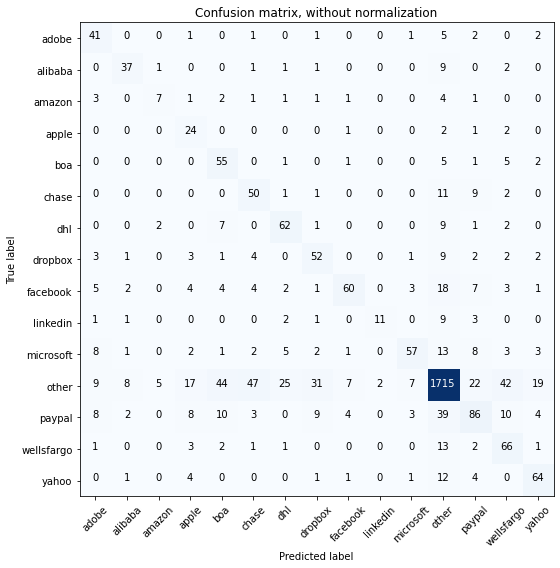

Acc     =  0.776
Pre     =  0.804
Rec     =  0.776
F1      =  0.782

Bal_Acc =  0.645
Bal_Pre =  0.605
Bal_Rec =  0.645
Bal_F1  =  0.624

              precision    recall  f1-score   support

       adobe       0.52      0.76      0.62        54
     alibaba       0.70      0.71      0.70        52
      amazon       0.47      0.32      0.38        22
       apple       0.36      0.80      0.49        30
         boa       0.44      0.79      0.56        70
       chase       0.44      0.68      0.53        74
         dhl       0.61      0.74      0.67        84
     dropbox       0.51      0.65      0.57        80
    facebook       0.79      0.53      0.63       114
    linkedin       0.85      0.39      0.54        28
   microsoft       0.78      0.54      0.64       106
       other       0.92      0.86      0.89      2000
      paypal       0.58      0.46      0.51       186
  wellsfargo       0.47      0.73      0.58        90
       yahoo       0.65      0.73      0.69        

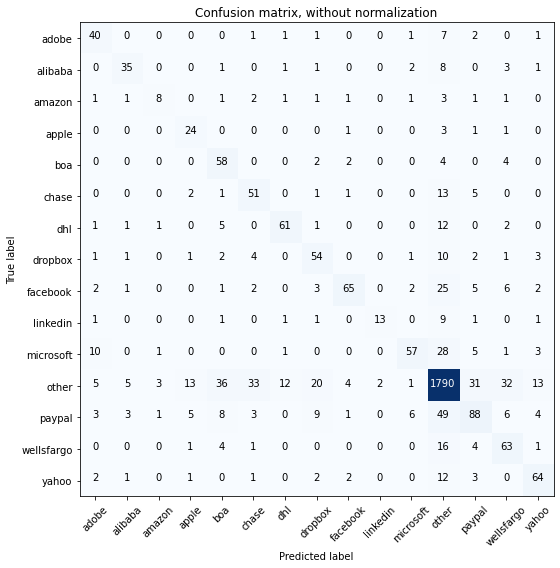

Acc     =  0.803
Pre     =  0.814
Rec     =  0.803
F1      =  0.803

Bal_Acc =  0.658
Bal_Pre =  0.666
Bal_Rec =  0.658
Bal_F1  =  0.662

              precision    recall  f1-score   support

       adobe       0.61      0.74      0.67        54
     alibaba       0.73      0.67      0.70        52
      amazon       0.57      0.36      0.44        22
       apple       0.51      0.80      0.62        30
         boa       0.49      0.83      0.62        70
       chase       0.52      0.69      0.59        74
         dhl       0.78      0.73      0.75        84
     dropbox       0.56      0.68      0.61        80
    facebook       0.84      0.57      0.68       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.80      0.54      0.64       106
       other       0.90      0.90      0.90      2000
      paypal       0.59      0.47      0.53       186
  wellsfargo       0.53      0.70      0.60        90
       yahoo       0.69      0.73      0.71        

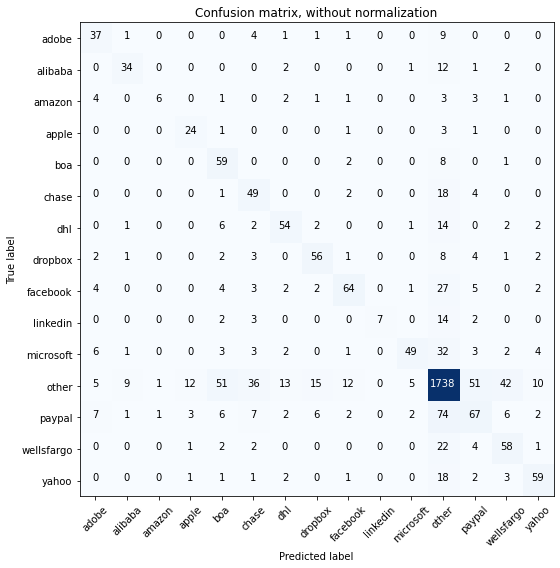

Acc     =  0.767
Pre     =  0.781
Rec     =  0.767
F1      =  0.766

Bal_Acc =  0.605
Bal_Pre =  0.661
Bal_Rec =  0.605
Bal_F1  =  0.632

              precision    recall  f1-score   support

       adobe       0.57      0.69      0.62        54
     alibaba       0.71      0.65      0.68        52
      amazon       0.75      0.27      0.40        22
       apple       0.59      0.80      0.68        30
         boa       0.42      0.84      0.56        70
       chase       0.43      0.66      0.52        74
         dhl       0.68      0.64      0.66        84
     dropbox       0.67      0.70      0.69        80
    facebook       0.73      0.56      0.63       114
    linkedin       1.00      0.25      0.40        28
   microsoft       0.83      0.46      0.59       106
       other       0.87      0.87      0.87      2000
      paypal       0.46      0.36      0.40       186
  wellsfargo       0.49      0.64      0.56        90
       yahoo       0.72      0.67      0.69        

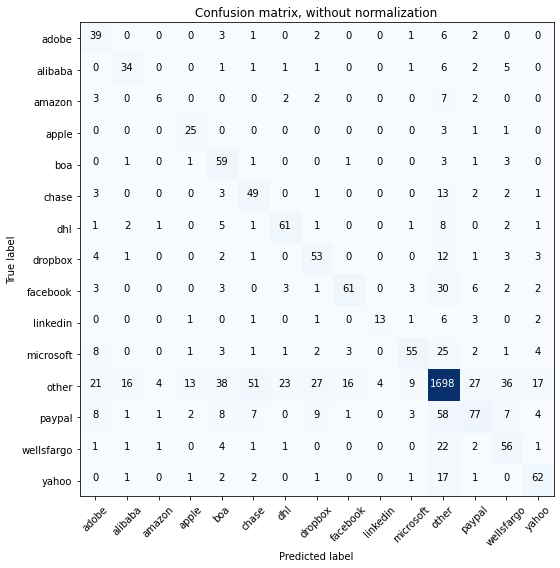

Acc     =  0.763
Pre     =  0.783
Rec     =  0.763
F1      =  0.766

Bal_Acc =  0.632
Bal_Pre =  0.597
Bal_Rec =  0.632
Bal_F1  =  0.614

              precision    recall  f1-score   support

       adobe       0.43      0.72      0.54        54
     alibaba       0.60      0.65      0.62        52
      amazon       0.46      0.27      0.34        22
       apple       0.57      0.83      0.68        30
         boa       0.45      0.84      0.59        70
       chase       0.42      0.66      0.51        74
         dhl       0.66      0.73      0.69        84
     dropbox       0.52      0.66      0.59        80
    facebook       0.74      0.54      0.62       114
    linkedin       0.76      0.46      0.58        28
   microsoft       0.73      0.52      0.61       106
       other       0.89      0.85      0.87      2000
      paypal       0.60      0.41      0.49       186
  wellsfargo       0.47      0.62      0.54        90
       yahoo       0.64      0.70      0.67        

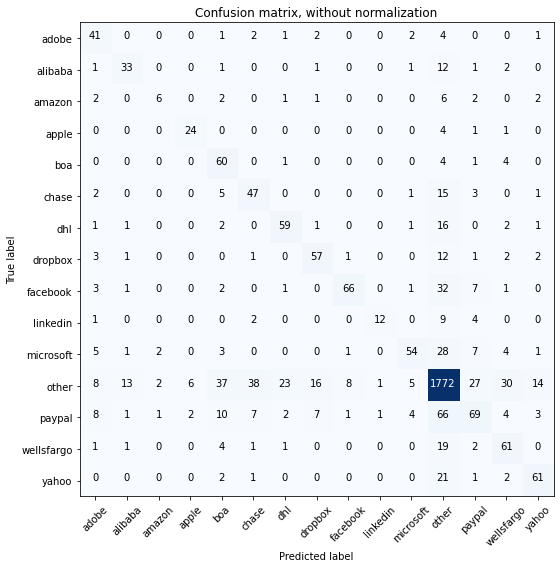

Acc     =  0.787
Pre     =  0.795
Rec     =  0.787
F1      =  0.785

Bal_Acc =  0.635
Bal_Pre =  0.661
Bal_Rec =  0.635
Bal_F1  =  0.648

              precision    recall  f1-score   support

       adobe       0.54      0.76      0.63        54
     alibaba       0.63      0.63      0.63        52
      amazon       0.55      0.27      0.36        22
       apple       0.75      0.80      0.77        30
         boa       0.47      0.86      0.60        70
       chase       0.47      0.64      0.54        74
         dhl       0.66      0.70      0.68        84
     dropbox       0.67      0.71      0.69        80
    facebook       0.86      0.58      0.69       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.78      0.51      0.62       106
       other       0.88      0.89      0.88      2000
      paypal       0.55      0.37      0.44       186
  wellsfargo       0.54      0.68      0.60        90
       yahoo       0.71      0.69      0.70        

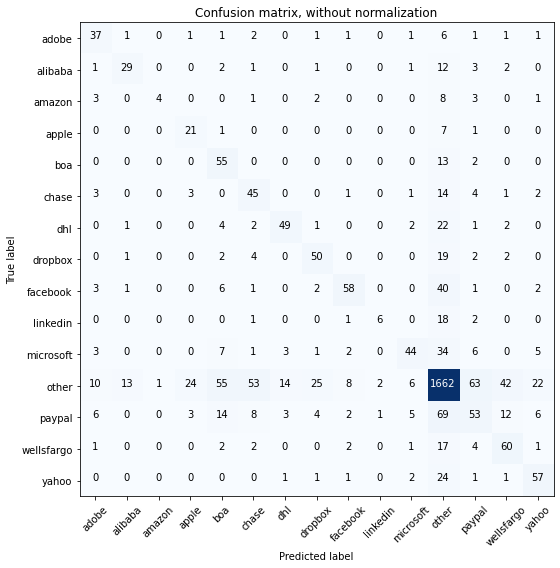

Acc     =  0.724
Pre     =  0.742
Rec     =  0.724
F1      =  0.725

Bal_Acc =  0.553
Bal_Pre =  0.587
Bal_Rec =  0.553
Bal_F1  =  0.569

              precision    recall  f1-score   support

       adobe       0.55      0.69      0.61        54
     alibaba       0.63      0.56      0.59        52
      amazon       0.80      0.18      0.30        22
       apple       0.40      0.70      0.51        30
         boa       0.37      0.79      0.50        70
       chase       0.37      0.61      0.46        74
         dhl       0.70      0.58      0.64        84
     dropbox       0.57      0.62      0.60        80
    facebook       0.76      0.51      0.61       114
    linkedin       0.67      0.21      0.32        28
   microsoft       0.70      0.42      0.52       106
       other       0.85      0.83      0.84      2000
      paypal       0.36      0.28      0.32       186
  wellsfargo       0.49      0.67      0.56        90
       yahoo       0.59      0.65      0.62        

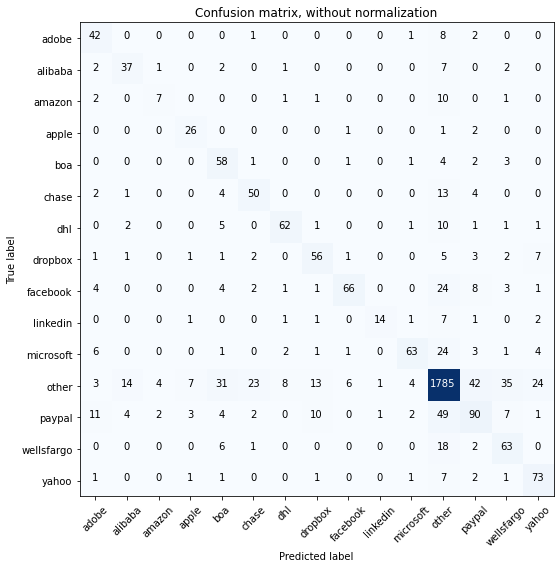

Acc     =  0.81
Pre     =  0.821
Rec     =  0.81
F1      =  0.81

Bal_Acc =  0.68
Bal_Pre =  0.678
Bal_Rec =  0.68
Bal_F1  =  0.679

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        54
     alibaba       0.63      0.71      0.67        52
      amazon       0.50      0.32      0.39        22
       apple       0.67      0.87      0.75        30
         boa       0.50      0.83      0.62        70
       chase       0.61      0.68      0.64        74
         dhl       0.82      0.74      0.78        84
     dropbox       0.66      0.70      0.68        80
    facebook       0.87      0.58      0.69       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.59      0.70       106
       other       0.91      0.89      0.90      2000
      paypal       0.56      0.48      0.52       186
  wellsfargo       0.53      0.70      0.60        90
       yahoo       0.65      0.83      0.73        88

 

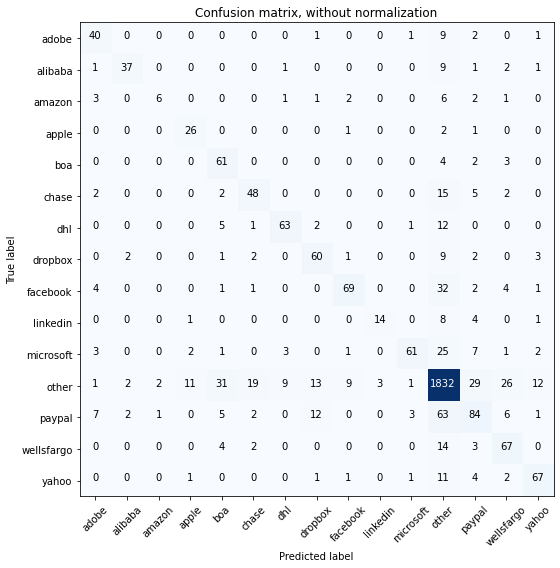

Acc     =  0.824
Pre     =  0.827
Rec     =  0.824
F1      =  0.82

Bal_Acc =  0.678
Bal_Pre =  0.722
Bal_Rec =  0.678
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.66      0.74      0.70        54
     alibaba       0.86      0.71      0.78        52
      amazon       0.67      0.27      0.39        22
       apple       0.63      0.87      0.73        30
         boa       0.55      0.87      0.67        70
       chase       0.64      0.65      0.64        74
         dhl       0.82      0.75      0.78        84
     dropbox       0.67      0.75      0.71        80
    facebook       0.82      0.61      0.70       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.90      0.58      0.70       106
       other       0.89      0.92      0.90      2000
      paypal       0.57      0.45      0.50       186
  wellsfargo       0.59      0.74      0.66        90
       yahoo       0.75      0.76      0.76        8

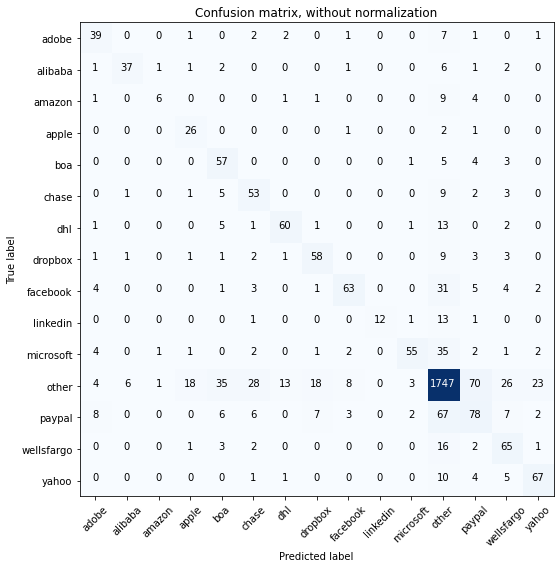

Acc     =  0.787
Pre     =  0.801
Rec     =  0.787
F1      =  0.788

Bal_Acc =  0.655
Bal_Pre =  0.686
Bal_Rec =  0.655
Bal_F1  =  0.67

              precision    recall  f1-score   support

       adobe       0.62      0.72      0.67        54
     alibaba       0.82      0.71      0.76        52
      amazon       0.67      0.27      0.39        22
       apple       0.52      0.87      0.65        30
         boa       0.50      0.81      0.62        70
       chase       0.52      0.72      0.61        74
         dhl       0.77      0.71      0.74        84
     dropbox       0.67      0.72      0.69        80
    facebook       0.80      0.55      0.65       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.87      0.52      0.65       106
       other       0.88      0.87      0.88      2000
      paypal       0.44      0.42      0.43       186
  wellsfargo       0.54      0.72      0.62        90
       yahoo       0.68      0.76      0.72        8

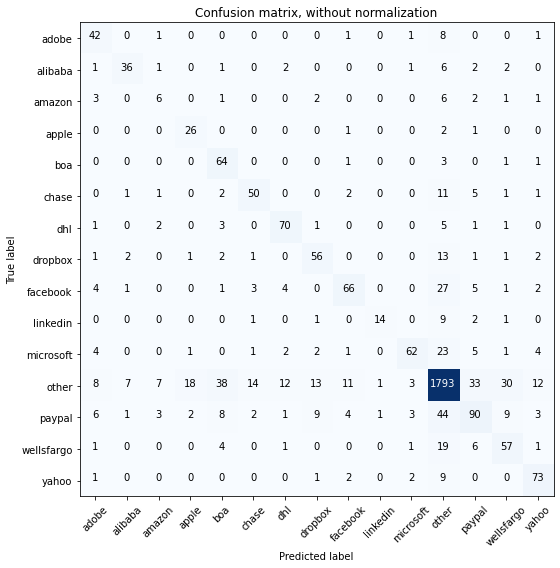

Acc     =  0.814
Pre     =  0.822
Rec     =  0.814
F1      =  0.814

Bal_Acc =  0.683
Bal_Pre =  0.667
Bal_Rec =  0.683
Bal_F1  =  0.675

              precision    recall  f1-score   support

       adobe       0.58      0.78      0.67        54
     alibaba       0.75      0.69      0.72        52
      amazon       0.29      0.27      0.28        22
       apple       0.54      0.87      0.67        30
         boa       0.52      0.91      0.66        70
       chase       0.69      0.68      0.68        74
         dhl       0.76      0.83      0.80        84
     dropbox       0.66      0.70      0.68        80
    facebook       0.74      0.58      0.65       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.58      0.69       106
       other       0.91      0.90      0.90      2000
      paypal       0.59      0.48      0.53       186
  wellsfargo       0.54      0.63      0.58        90
       yahoo       0.72      0.83      0.77        

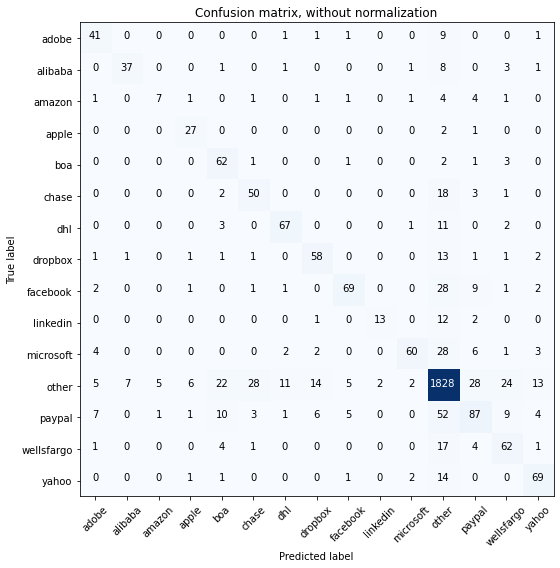

Acc     =  0.824
Pre     =  0.827
Rec     =  0.824
F1      =  0.821

Bal_Acc =  0.684
Bal_Pre =  0.718
Bal_Rec =  0.684
Bal_F1  =  0.701

              precision    recall  f1-score   support

       adobe       0.66      0.76      0.71        54
     alibaba       0.82      0.71      0.76        52
      amazon       0.54      0.32      0.40        22
       apple       0.71      0.90      0.79        30
         boa       0.58      0.89      0.70        70
       chase       0.58      0.68      0.63        74
         dhl       0.80      0.80      0.80        84
     dropbox       0.70      0.72      0.71        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.90      0.57      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.60      0.47      0.52       186
  wellsfargo       0.57      0.69      0.63        90
       yahoo       0.72      0.78      0.75        

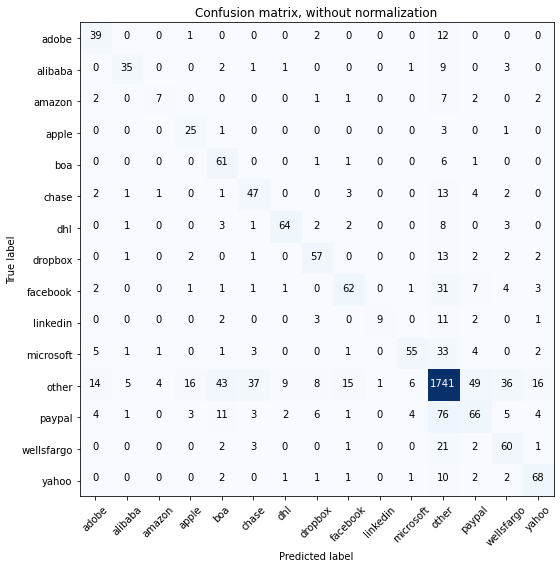

Acc     =  0.778
Pre     =  0.787
Rec     =  0.778
F1      =  0.777

Bal_Acc =  0.638
Bal_Pre =  0.656
Bal_Rec =  0.638
Bal_F1  =  0.647

              precision    recall  f1-score   support

       adobe       0.57      0.72      0.64        54
     alibaba       0.78      0.67      0.72        52
      amazon       0.54      0.32      0.40        22
       apple       0.52      0.83      0.64        30
         boa       0.47      0.87      0.61        70
       chase       0.48      0.64      0.55        74
         dhl       0.82      0.76      0.79        84
     dropbox       0.70      0.71      0.71        80
    facebook       0.70      0.54      0.61       114
    linkedin       0.90      0.32      0.47        28
   microsoft       0.81      0.52      0.63       106
       other       0.87      0.87      0.87      2000
      paypal       0.47      0.35      0.40       186
  wellsfargo       0.51      0.67      0.58        90
       yahoo       0.69      0.77      0.73        

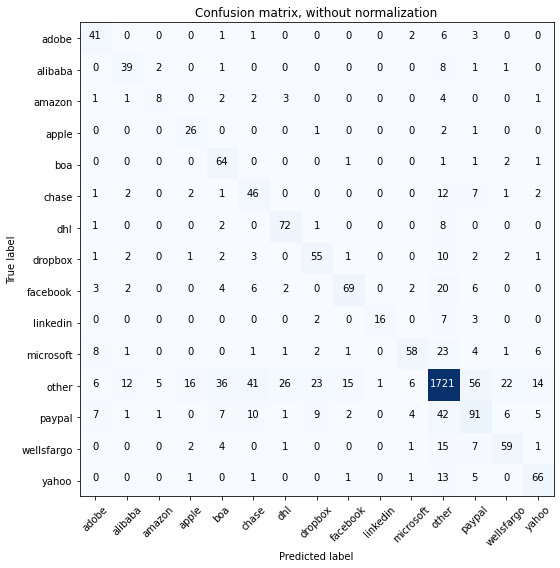

Acc     =  0.79
Pre     =  0.808
Rec     =  0.79
F1      =  0.794

Bal_Acc =  0.687
Bal_Pre =  0.646
Bal_Rec =  0.687
Bal_F1  =  0.666

              precision    recall  f1-score   support

       adobe       0.59      0.76      0.67        54
     alibaba       0.65      0.75      0.70        52
      amazon       0.50      0.36      0.42        22
       apple       0.54      0.87      0.67        30
         boa       0.52      0.91      0.66        70
       chase       0.41      0.62      0.50        74
         dhl       0.68      0.86      0.76        84
     dropbox       0.59      0.69      0.64        80
    facebook       0.77      0.61      0.68       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.78      0.55      0.64       106
       other       0.91      0.86      0.88      2000
      paypal       0.49      0.49      0.49       186
  wellsfargo       0.63      0.66      0.64        90
       yahoo       0.68      0.75      0.71        88

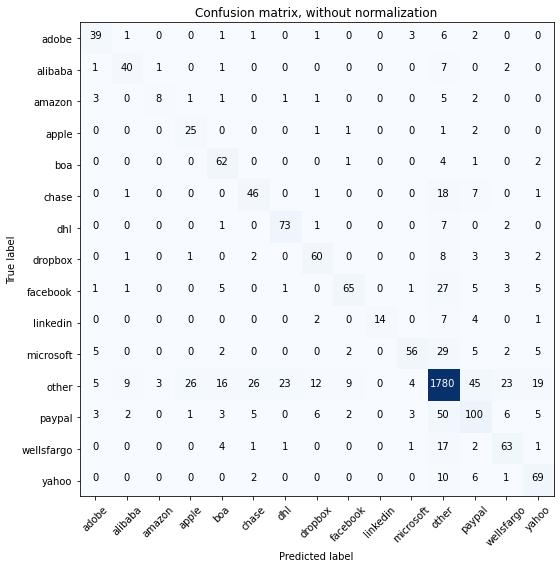

Acc     =  0.812
Pre     =  0.821
Rec     =  0.812
F1      =  0.812

Bal_Acc =  0.688
Bal_Pre =  0.699
Bal_Rec =  0.688
Bal_F1  =  0.693

              precision    recall  f1-score   support

       adobe       0.68      0.72      0.70        54
     alibaba       0.73      0.77      0.75        52
      amazon       0.67      0.36      0.47        22
       apple       0.46      0.83      0.60        30
         boa       0.65      0.89      0.75        70
       chase       0.55      0.62      0.59        74
         dhl       0.74      0.87      0.80        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.81      0.57      0.67       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.82      0.53      0.64       106
       other       0.90      0.89      0.90      2000
      paypal       0.54      0.54      0.54       186
  wellsfargo       0.60      0.70      0.65        90
       yahoo       0.63      0.78      0.70        

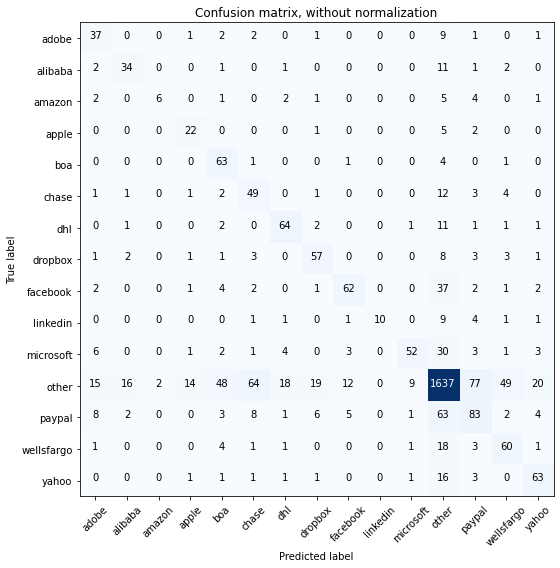

Acc     =  0.747
Pre     =  0.774
Rec     =  0.747
F1      =  0.752

Bal_Acc =  0.628
Bal_Pre =  0.634
Bal_Rec =  0.628
Bal_F1  =  0.631

              precision    recall  f1-score   support

       adobe       0.49      0.69      0.57        54
     alibaba       0.61      0.65      0.63        52
      amazon       0.75      0.27      0.40        22
       apple       0.52      0.73      0.61        30
         boa       0.47      0.90      0.62        70
       chase       0.37      0.66      0.47        74
         dhl       0.69      0.76      0.72        84
     dropbox       0.63      0.71      0.67        80
    facebook       0.74      0.54      0.63       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.80      0.49      0.61       106
       other       0.87      0.82      0.84      2000
      paypal       0.44      0.45      0.44       186
  wellsfargo       0.48      0.67      0.56        90
       yahoo       0.64      0.72      0.68        

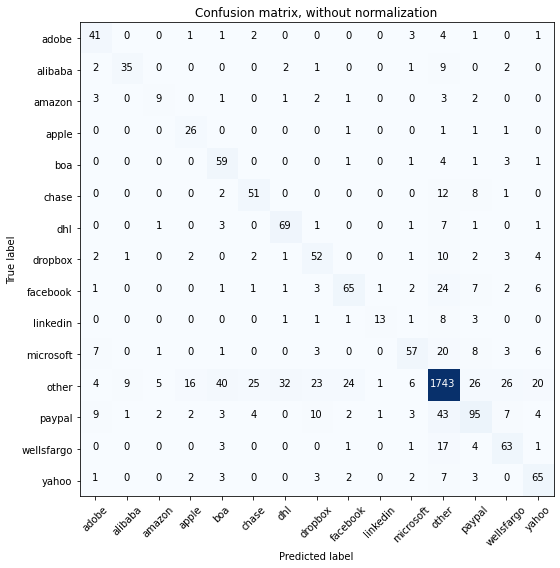

Acc     =  0.794
Pre     =  0.807
Rec     =  0.794
F1      =  0.796

Bal_Acc =  0.674
Bal_Pre =  0.634
Bal_Rec =  0.674
Bal_F1  =  0.653

              precision    recall  f1-score   support

       adobe       0.59      0.76      0.66        54
     alibaba       0.76      0.67      0.71        52
      amazon       0.50      0.41      0.45        22
       apple       0.53      0.87      0.66        30
         boa       0.50      0.84      0.63        70
       chase       0.60      0.69      0.64        74
         dhl       0.64      0.82      0.72        84
     dropbox       0.53      0.65      0.58        80
    facebook       0.66      0.57      0.61       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.72      0.54      0.62       106
       other       0.91      0.87      0.89      2000
      paypal       0.59      0.51      0.55       186
  wellsfargo       0.57      0.70      0.63        90
       yahoo       0.60      0.74      0.66        

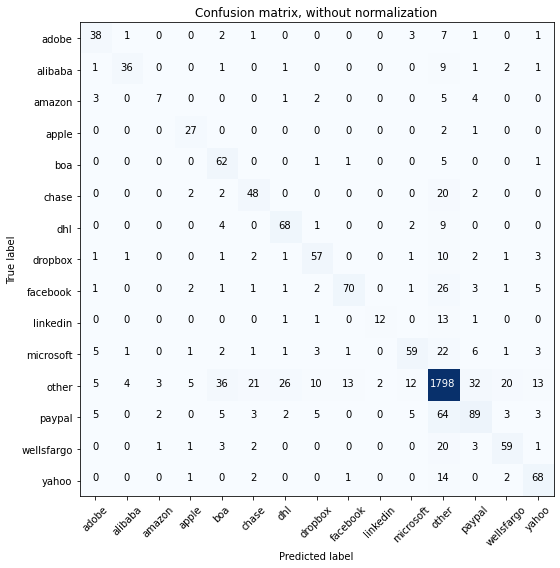

Acc     =  0.812
Pre     =  0.814
Rec     =  0.812
F1      =  0.809

Bal_Acc =  0.672
Bal_Pre =  0.695
Bal_Rec =  0.672
Bal_F1  =  0.683

              precision    recall  f1-score   support

       adobe       0.64      0.70      0.67        54
     alibaba       0.84      0.69      0.76        52
      amazon       0.54      0.32      0.40        22
       apple       0.69      0.90      0.78        30
         boa       0.52      0.89      0.66        70
       chase       0.59      0.65      0.62        74
         dhl       0.67      0.81      0.73        84
     dropbox       0.70      0.71      0.70        80
    facebook       0.81      0.61      0.70       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.71      0.56      0.62       106
       other       0.89      0.90      0.89      2000
      paypal       0.61      0.48      0.54       186
  wellsfargo       0.66      0.66      0.66        90
       yahoo       0.69      0.77      0.73        

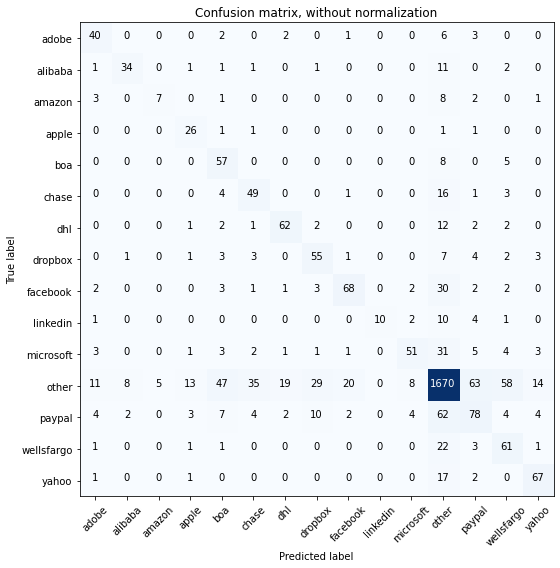

Acc     =  0.759
Pre     =  0.779
Rec     =  0.759
F1      =  0.762

Bal_Acc =  0.641
Bal_Pre =  0.642
Bal_Rec =  0.641
Bal_F1  =  0.641

              precision    recall  f1-score   support

       adobe       0.60      0.74      0.66        54
     alibaba       0.76      0.65      0.70        52
      amazon       0.58      0.32      0.41        22
       apple       0.54      0.87      0.67        30
         boa       0.43      0.81      0.56        70
       chase       0.51      0.66      0.57        74
         dhl       0.71      0.74      0.73        84
     dropbox       0.54      0.69      0.61        80
    facebook       0.72      0.60      0.65       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.76      0.48      0.59       106
       other       0.87      0.83      0.85      2000
      paypal       0.46      0.42      0.44       186
  wellsfargo       0.42      0.68      0.52        90
       yahoo       0.72      0.76      0.74        

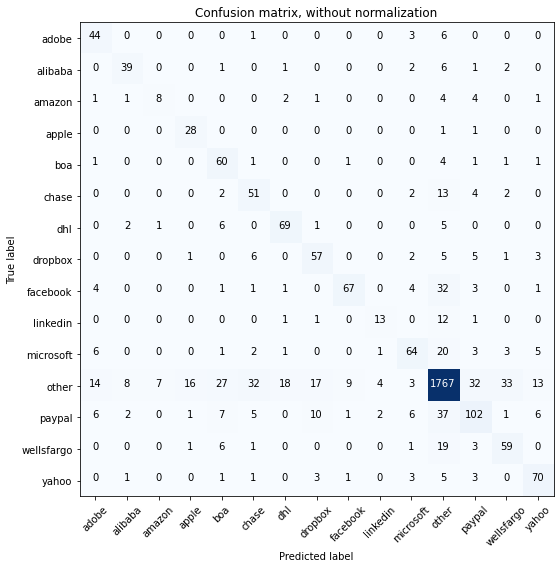

Acc     =  0.812
Pre     =  0.823
Rec     =  0.812
F1      =  0.813

Bal_Acc =  0.699
Bal_Pre =  0.657
Bal_Rec =  0.699
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.58      0.81      0.68        54
     alibaba       0.74      0.75      0.74        52
      amazon       0.50      0.36      0.42        22
       apple       0.60      0.93      0.73        30
         boa       0.54      0.86      0.66        70
       chase       0.50      0.69      0.58        74
         dhl       0.74      0.82      0.78        84
     dropbox       0.63      0.71      0.67        80
    facebook       0.85      0.59      0.69       114
    linkedin       0.65      0.46      0.54        28
   microsoft       0.71      0.60      0.65       106
       other       0.91      0.88      0.90      2000
      paypal       0.63      0.55      0.58       186
  wellsfargo       0.58      0.66      0.61        90
       yahoo       0.70      0.80      0.74        

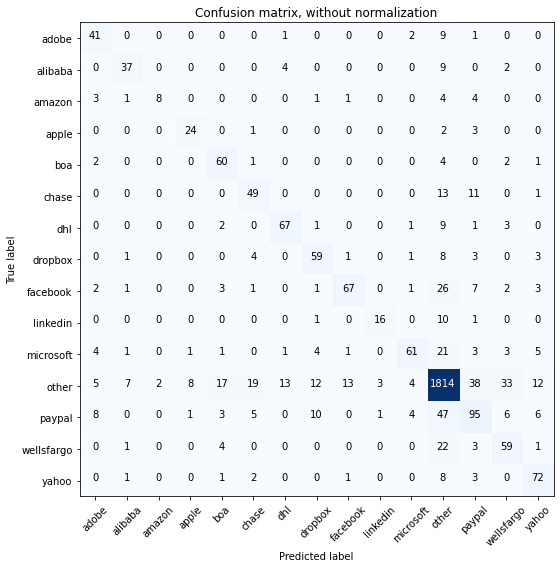

Acc     =  0.822
Pre     =  0.825
Rec     =  0.822
F1      =  0.821

Bal_Acc =  0.688
Bal_Pre =  0.712
Bal_Rec =  0.688
Bal_F1  =  0.7

              precision    recall  f1-score   support

       adobe       0.63      0.76      0.69        54
     alibaba       0.74      0.71      0.73        52
      amazon       0.80      0.36      0.50        22
       apple       0.71      0.80      0.75        30
         boa       0.66      0.86      0.75        70
       chase       0.60      0.66      0.63        74
         dhl       0.78      0.80      0.79        84
     dropbox       0.66      0.74      0.70        80
    facebook       0.80      0.59      0.68       114
    linkedin       0.80      0.57      0.67        28
   microsoft       0.82      0.58      0.68       106
       other       0.90      0.91      0.91      2000
      paypal       0.55      0.51      0.53       186
  wellsfargo       0.54      0.66      0.59        90
       yahoo       0.69      0.82      0.75        88

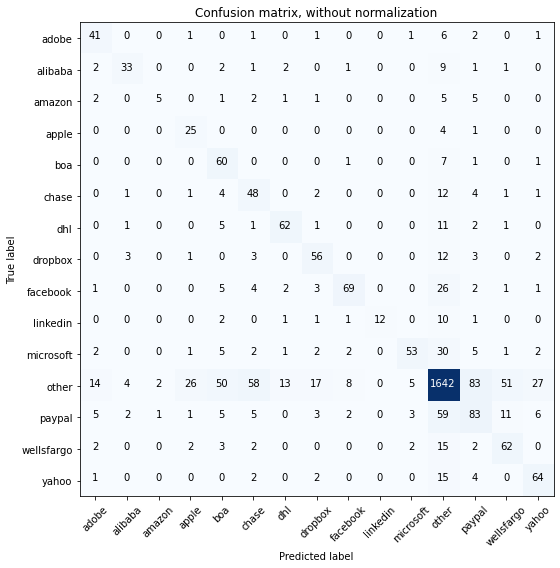

Acc     =  0.752
Pre     =  0.785
Rec     =  0.752
F1      =  0.76

Bal_Acc =  0.641
Bal_Pre =  0.641
Bal_Rec =  0.641
Bal_F1  =  0.641

              precision    recall  f1-score   support

       adobe       0.59      0.76      0.66        54
     alibaba       0.75      0.63      0.69        52
      amazon       0.62      0.23      0.33        22
       apple       0.43      0.83      0.57        30
         boa       0.42      0.86      0.57        70
       chase       0.37      0.65      0.47        74
         dhl       0.76      0.74      0.75        84
     dropbox       0.63      0.70      0.66        80
    facebook       0.82      0.61      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.83      0.50      0.62       106
       other       0.88      0.82      0.85      2000
      paypal       0.42      0.45      0.43       186
  wellsfargo       0.48      0.69      0.57        90
       yahoo       0.61      0.73      0.66        8

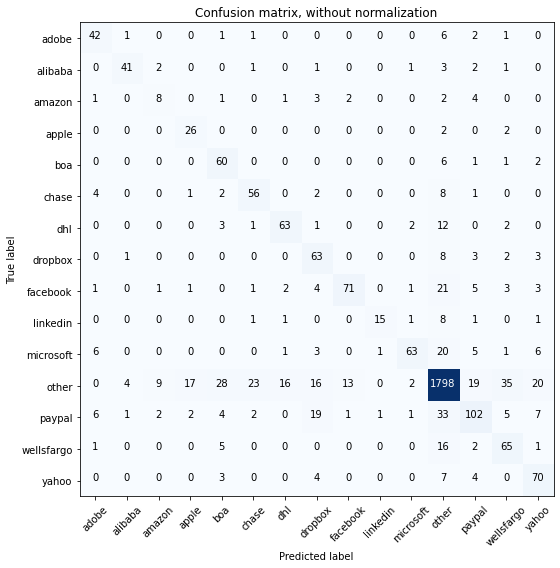

Acc     =  0.826
Pre     =  0.84
Rec     =  0.826
F1      =  0.828

Bal_Acc =  0.711
Bal_Pre =  0.688
Bal_Rec =  0.711
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.85      0.79      0.82        52
      amazon       0.36      0.36      0.36        22
       apple       0.55      0.87      0.68        30
         boa       0.56      0.86      0.68        70
       chase       0.65      0.76      0.70        74
         dhl       0.75      0.75      0.75        84
     dropbox       0.54      0.79      0.64        80
    facebook       0.82      0.62      0.71       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.89      0.59      0.71       106
       other       0.92      0.90      0.91      2000
      paypal       0.68      0.55      0.61       186
  wellsfargo       0.55      0.72      0.62        90
       yahoo       0.62      0.80      0.70        8

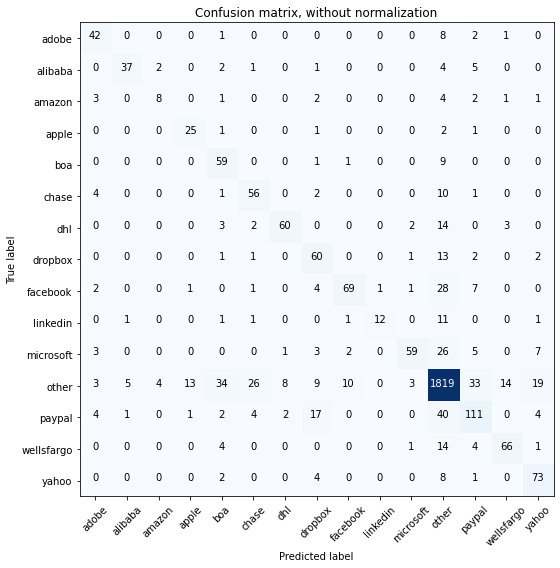

Acc     =  0.83
Pre     =  0.839
Rec     =  0.83
F1      =  0.83

Bal_Acc =  0.694
Bal_Pre =  0.728
Bal_Rec =  0.694
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.84      0.71      0.77        52
      amazon       0.57      0.36      0.44        22
       apple       0.62      0.83      0.71        30
         boa       0.53      0.84      0.65        70
       chase       0.61      0.76      0.67        74
         dhl       0.85      0.71      0.77        84
     dropbox       0.58      0.75      0.65        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.88      0.56      0.68       106
       other       0.90      0.91      0.91      2000
      paypal       0.64      0.60      0.62       186
  wellsfargo       0.78      0.73      0.75        90
       yahoo       0.68      0.83      0.74        88


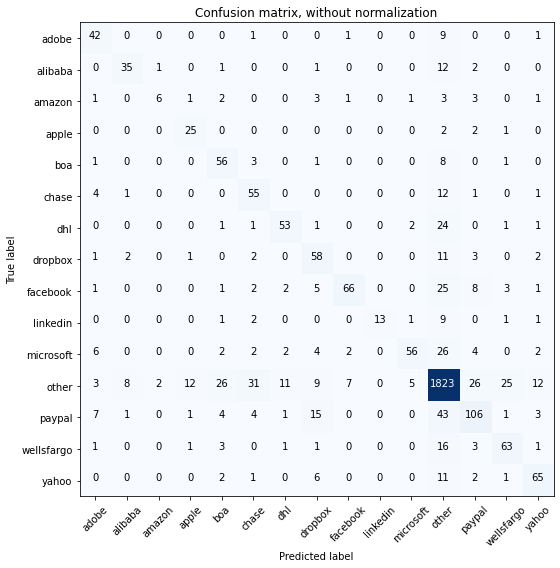

Acc     =  0.819
Pre     =  0.827
Rec     =  0.819
F1      =  0.818

Bal_Acc =  0.663
Bal_Pre =  0.713
Bal_Rec =  0.663
Bal_F1  =  0.687

              precision    recall  f1-score   support

       adobe       0.63      0.78      0.69        54
     alibaba       0.74      0.67      0.71        52
      amazon       0.67      0.27      0.39        22
       apple       0.61      0.83      0.70        30
         boa       0.57      0.80      0.66        70
       chase       0.53      0.74      0.62        74
         dhl       0.76      0.63      0.69        84
     dropbox       0.56      0.72      0.63        80
    facebook       0.86      0.58      0.69       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.86      0.53      0.65       106
       other       0.90      0.91      0.90      2000
      paypal       0.66      0.57      0.61       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.71      0.74      0.73        

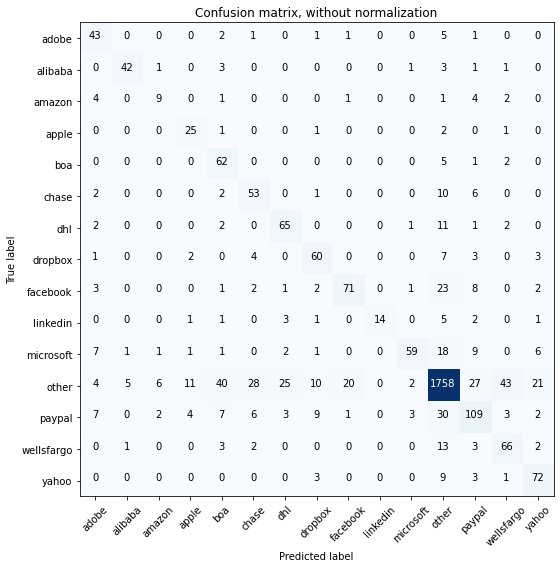

Acc     =  0.815
Pre     =  0.834
Rec     =  0.815
F1      =  0.819

Bal_Acc =  0.711
Bal_Pre =  0.683
Bal_Rec =  0.711
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.59      0.80      0.68        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.47      0.41      0.44        22
       apple       0.57      0.83      0.68        30
         boa       0.49      0.89      0.63        70
       chase       0.55      0.72      0.62        74
         dhl       0.66      0.77      0.71        84
     dropbox       0.67      0.75      0.71        80
    facebook       0.76      0.62      0.68       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.56      0.68       106
       other       0.93      0.88      0.90      2000
      paypal       0.61      0.59      0.60       186
  wellsfargo       0.55      0.73      0.63        90
       yahoo       0.66      0.82      0.73        

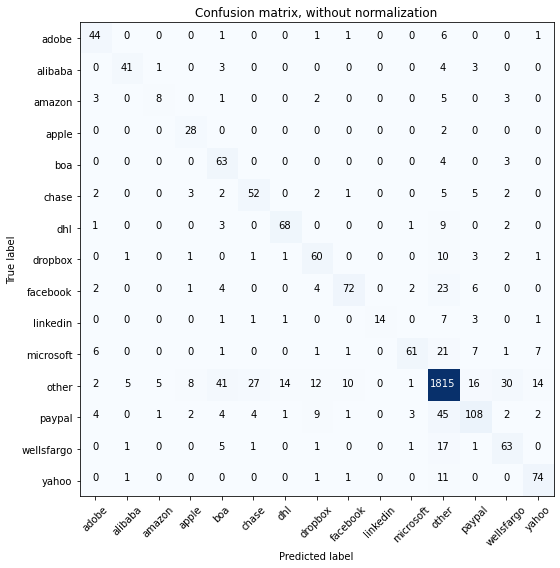

Acc     =  0.835
Pre     =  0.846
Rec     =  0.835
F1      =  0.836

Bal_Acc =  0.72
Bal_Pre =  0.727
Bal_Rec =  0.72
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.84      0.79      0.81        52
      amazon       0.53      0.36      0.43        22
       apple       0.65      0.93      0.77        30
         boa       0.49      0.90      0.63        70
       chase       0.60      0.70      0.65        74
         dhl       0.80      0.81      0.80        84
     dropbox       0.65      0.75      0.69        80
    facebook       0.83      0.63      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.58      0.70       106
       other       0.91      0.91      0.91      2000
      paypal       0.71      0.58      0.64       186
  wellsfargo       0.58      0.70      0.64        90
       yahoo       0.74      0.84      0.79        88

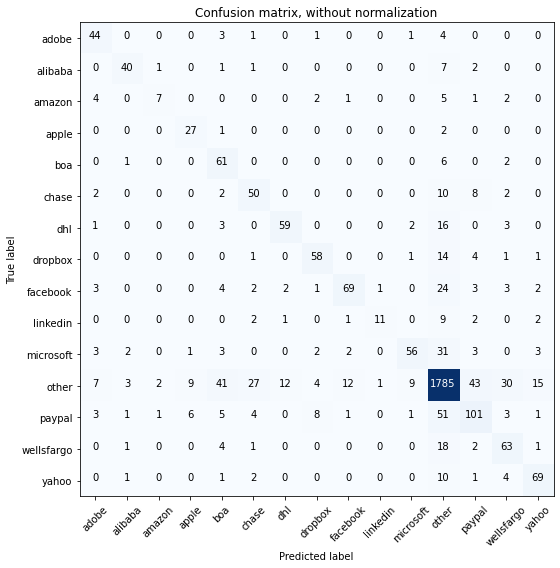

Acc     =  0.812
Pre     =  0.822
Rec     =  0.812
F1      =  0.812

Bal_Acc =  0.682
Bal_Pre =  0.703
Bal_Rec =  0.682
Bal_F1  =  0.692

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.82      0.77      0.79        52
      amazon       0.64      0.32      0.42        22
       apple       0.63      0.90      0.74        30
         boa       0.47      0.87      0.61        70
       chase       0.55      0.68      0.61        74
         dhl       0.80      0.70      0.75        84
     dropbox       0.76      0.72      0.74        80
    facebook       0.80      0.61      0.69       114
    linkedin       0.85      0.39      0.54        28
   microsoft       0.80      0.53      0.64       106
       other       0.90      0.89      0.89      2000
      paypal       0.59      0.54      0.57       186
  wellsfargo       0.56      0.70      0.62        90
       yahoo       0.73      0.78      0.76        

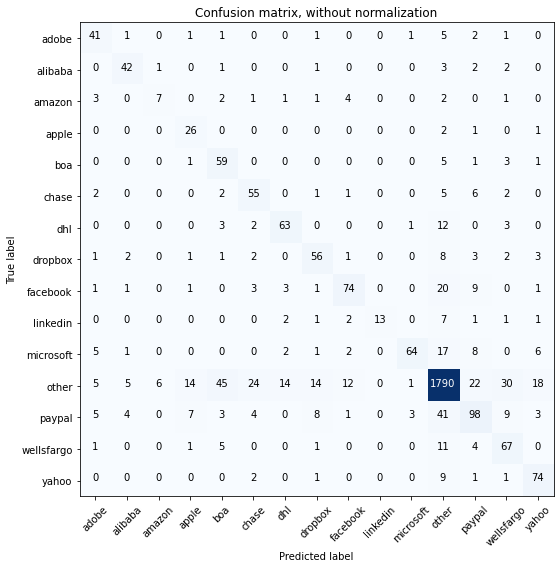

Acc     =  0.822
Pre     =  0.837
Rec     =  0.822
F1      =  0.824

Bal_Acc =  0.701
Bal_Pre =  0.687
Bal_Rec =  0.701
Bal_F1  =  0.694

              precision    recall  f1-score   support

       adobe       0.64      0.76      0.69        54
     alibaba       0.75      0.81      0.78        52
      amazon       0.50      0.32      0.39        22
       apple       0.50      0.87      0.63        30
         boa       0.48      0.84      0.61        70
       chase       0.59      0.74      0.66        74
         dhl       0.74      0.75      0.75        84
     dropbox       0.64      0.70      0.67        80
    facebook       0.76      0.65      0.70       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.91      0.60      0.73       106
       other       0.92      0.90      0.91      2000
      paypal       0.62      0.53      0.57       186
  wellsfargo       0.55      0.74      0.63        90
       yahoo       0.69      0.84      0.76        

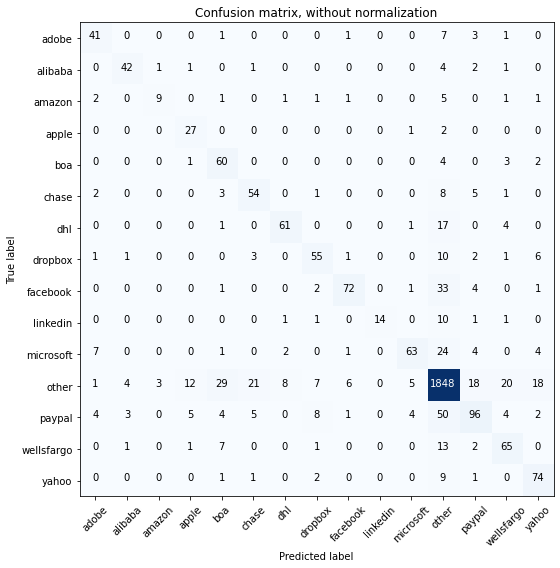

Acc     =  0.839
Pre     =  0.844
Rec     =  0.839
F1      =  0.836

Bal_Acc =  0.707
Bal_Pre =  0.744
Bal_Rec =  0.707
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.71      0.76      0.73        54
     alibaba       0.82      0.81      0.82        52
      amazon       0.69      0.41      0.51        22
       apple       0.57      0.90      0.70        30
         boa       0.55      0.86      0.67        70
       chase       0.64      0.73      0.68        74
         dhl       0.84      0.73      0.78        84
     dropbox       0.71      0.69      0.70        80
    facebook       0.87      0.63      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.84      0.59      0.70       106
       other       0.90      0.92      0.91      2000
      paypal       0.70      0.52      0.59       186
  wellsfargo       0.64      0.72      0.68        90
       yahoo       0.69      0.84      0.76        

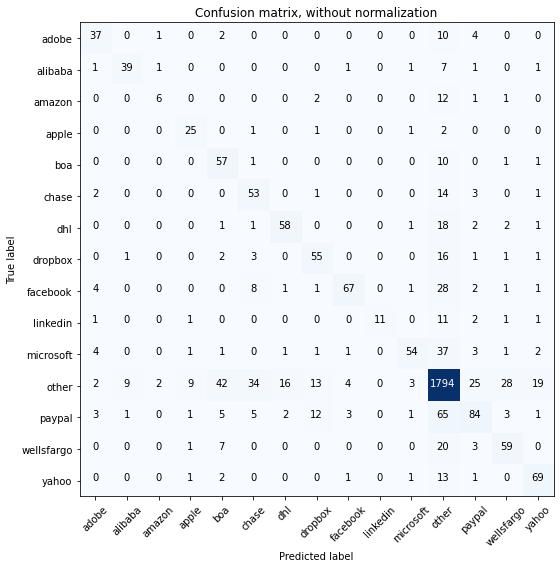

Acc     =  0.802
Pre     =  0.809
Rec     =  0.802
F1      =  0.799

Bal_Acc =  0.649
Bal_Pre =  0.707
Bal_Rec =  0.649
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.69      0.69      0.69        54
     alibaba       0.78      0.75      0.76        52
      amazon       0.60      0.27      0.37        22
       apple       0.64      0.83      0.72        30
         boa       0.48      0.81      0.60        70
       chase       0.50      0.72      0.59        74
         dhl       0.74      0.69      0.72        84
     dropbox       0.64      0.69      0.66        80
    facebook       0.87      0.59      0.70       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.86      0.51      0.64       106
       other       0.87      0.90      0.88      2000
      paypal       0.64      0.45      0.53       186
  wellsfargo       0.60      0.66      0.63        90
       yahoo       0.70      0.78      0.74        

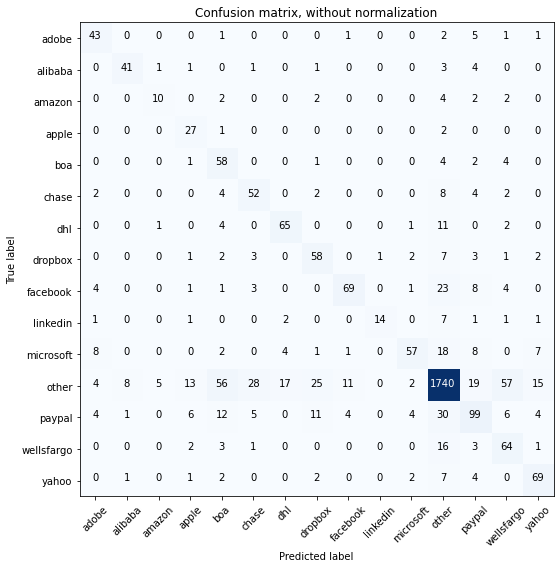

Acc     =  0.801
Pre     =  0.828
Rec     =  0.801
F1      =  0.808

Bal_Acc =  0.701
Bal_Pre =  0.669
Bal_Rec =  0.701
Bal_F1  =  0.685

              precision    recall  f1-score   support

       adobe       0.65      0.80      0.72        54
     alibaba       0.80      0.79      0.80        52
      amazon       0.59      0.45      0.51        22
       apple       0.50      0.90      0.64        30
         boa       0.39      0.83      0.53        70
       chase       0.56      0.70      0.62        74
         dhl       0.74      0.77      0.76        84
     dropbox       0.56      0.72      0.63        80
    facebook       0.80      0.61      0.69       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.83      0.54      0.65       106
       other       0.92      0.87      0.90      2000
      paypal       0.61      0.53      0.57       186
  wellsfargo       0.44      0.71      0.55        90
       yahoo       0.69      0.78      0.73        

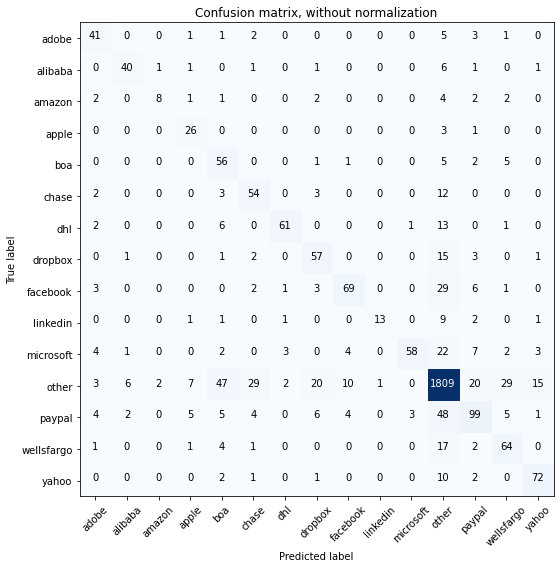

Acc     =  0.821
Pre     =  0.834
Rec     =  0.821
F1      =  0.821

Bal_Acc =  0.687
Bal_Pre =  0.723
Bal_Rec =  0.687
Bal_F1  =  0.705

              precision    recall  f1-score   support

       adobe       0.66      0.76      0.71        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.73      0.36      0.48        22
       apple       0.60      0.87      0.71        30
         boa       0.43      0.80      0.56        70
       chase       0.56      0.73      0.64        74
         dhl       0.90      0.73      0.80        84
     dropbox       0.61      0.71      0.66        80
    facebook       0.78      0.61      0.68       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.94      0.55      0.69       106
       other       0.90      0.90      0.90      2000
      paypal       0.66      0.53      0.59       186
  wellsfargo       0.58      0.71      0.64        90
       yahoo       0.77      0.82      0.79        

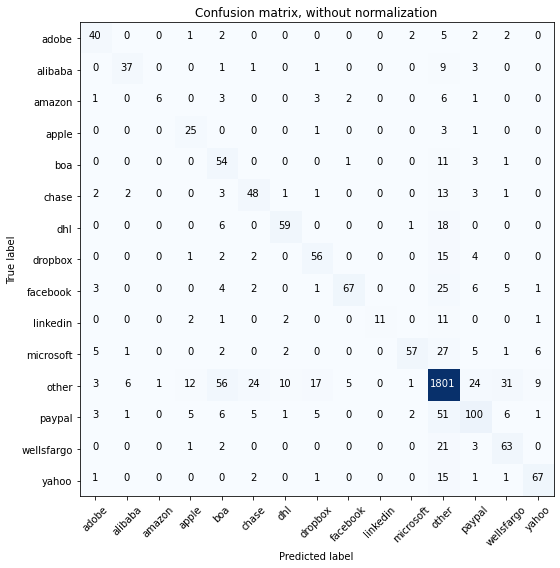

Acc     =  0.809
Pre     =  0.825
Rec     =  0.809
F1      =  0.809

Bal_Acc =  0.653
Bal_Pre =  0.729
Bal_Rec =  0.653
Bal_F1  =  0.689

              precision    recall  f1-score   support

       adobe       0.69      0.74      0.71        54
     alibaba       0.79      0.71      0.75        52
      amazon       0.86      0.27      0.41        22
       apple       0.53      0.83      0.65        30
         boa       0.38      0.77      0.51        70
       chase       0.57      0.65      0.61        74
         dhl       0.79      0.70      0.74        84
     dropbox       0.65      0.70      0.67        80
    facebook       0.89      0.59      0.71       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.90      0.54      0.67       106
       other       0.89      0.90      0.89      2000
      paypal       0.64      0.54      0.58       186
  wellsfargo       0.57      0.70      0.63        90
       yahoo       0.79      0.76      0.77        

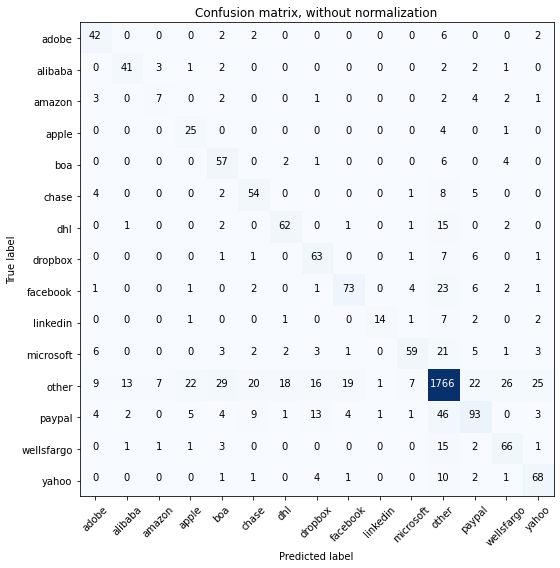

Acc     =  0.809
Pre     =  0.82
Rec     =  0.809
F1      =  0.811

Bal_Acc =  0.692
Bal_Pre =  0.654
Bal_Rec =  0.692
Bal_F1  =  0.672

              precision    recall  f1-score   support

       adobe       0.61      0.78      0.68        54
     alibaba       0.71      0.79      0.75        52
      amazon       0.39      0.32      0.35        22
       apple       0.45      0.83      0.58        30
         boa       0.53      0.81      0.64        70
       chase       0.59      0.73      0.65        74
         dhl       0.72      0.74      0.73        84
     dropbox       0.62      0.79      0.69        80
    facebook       0.74      0.64      0.69       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.79      0.56      0.65       106
       other       0.91      0.88      0.90      2000
      paypal       0.62      0.50      0.56       186
  wellsfargo       0.62      0.73      0.67        90
       yahoo       0.64      0.77      0.70        8

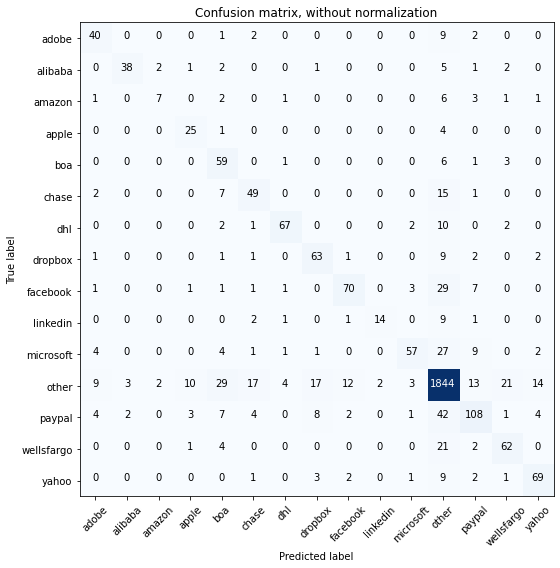

Acc     =  0.836
Pre     =  0.841
Rec     =  0.836
F1      =  0.834

Bal_Acc =  0.689
Bal_Pre =  0.733
Bal_Rec =  0.689
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.88      0.73      0.80        52
      amazon       0.64      0.32      0.42        22
       apple       0.61      0.83      0.70        30
         boa       0.49      0.84      0.62        70
       chase       0.62      0.66      0.64        74
         dhl       0.88      0.80      0.84        84
     dropbox       0.68      0.79      0.73        80
    facebook       0.80      0.61      0.69       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.54      0.66       106
       other       0.90      0.92      0.91      2000
      paypal       0.71      0.58      0.64       186
  wellsfargo       0.67      0.69      0.68        90
       yahoo       0.75      0.78      0.77        8

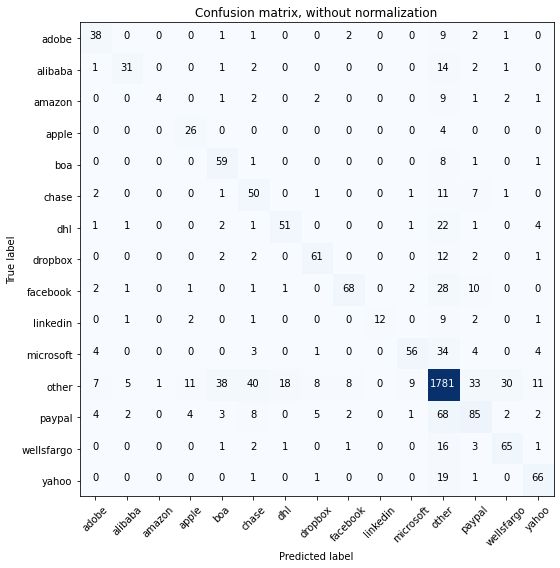

Acc     =  0.797
Pre     =  0.804
Rec     =  0.797
F1      =  0.794

Bal_Acc =  0.641
Bal_Pre =  0.712
Bal_Rec =  0.641
Bal_F1  =  0.675

              precision    recall  f1-score   support

       adobe       0.64      0.70      0.67        54
     alibaba       0.76      0.60      0.67        52
      amazon       0.80      0.18      0.30        22
       apple       0.59      0.87      0.70        30
         boa       0.54      0.84      0.66        70
       chase       0.43      0.68      0.53        74
         dhl       0.72      0.61      0.66        84
     dropbox       0.77      0.76      0.77        80
    facebook       0.84      0.60      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.80      0.53      0.64       106
       other       0.87      0.89      0.88      2000
      paypal       0.55      0.46      0.50       186
  wellsfargo       0.64      0.72      0.68        90
       yahoo       0.72      0.75      0.73        

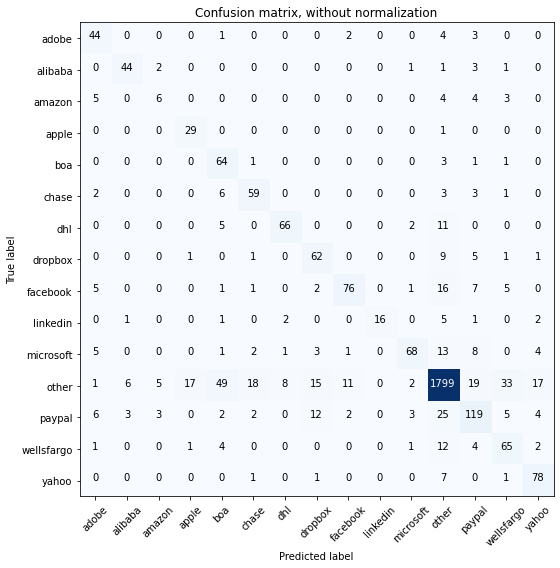

Acc     =  0.843
Pre     =  0.86
Rec     =  0.843
F1      =  0.847

Bal_Acc =  0.747
Bal_Pre =  0.714
Bal_Rec =  0.747
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.64      0.81      0.72        54
     alibaba       0.81      0.85      0.83        52
      amazon       0.38      0.27      0.32        22
       apple       0.60      0.97      0.74        30
         boa       0.48      0.91      0.63        70
       chase       0.69      0.80      0.74        74
         dhl       0.86      0.79      0.82        84
     dropbox       0.65      0.78      0.71        80
    facebook       0.83      0.67      0.74       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.87      0.64      0.74       106
       other       0.94      0.90      0.92      2000
      paypal       0.67      0.64      0.66       186
  wellsfargo       0.56      0.72      0.63        90
       yahoo       0.72      0.89      0.80        88

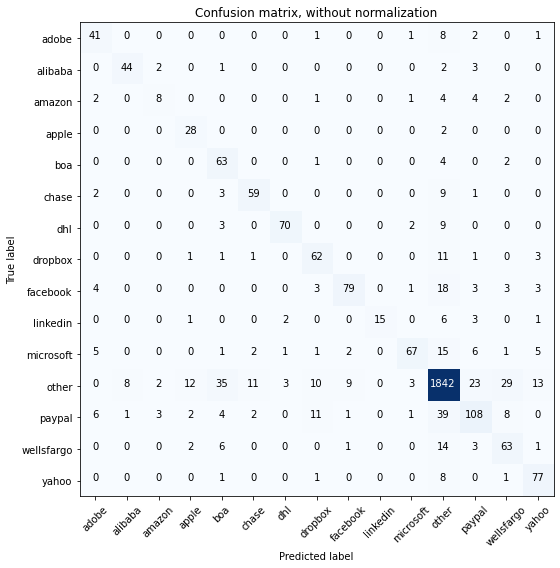

Acc     =  0.853
Pre     =  0.862
Rec     =  0.853
F1      =  0.853

Bal_Acc =  0.743
Bal_Pre =  0.75
Bal_Rec =  0.743
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.68      0.76      0.72        54
     alibaba       0.83      0.85      0.84        52
      amazon       0.53      0.36      0.43        22
       apple       0.61      0.93      0.74        30
         boa       0.53      0.90      0.67        70
       chase       0.79      0.80      0.79        74
         dhl       0.92      0.83      0.88        84
     dropbox       0.68      0.78      0.73        80
    facebook       0.86      0.69      0.77       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.88      0.63      0.74       106
       other       0.93      0.92      0.92      2000
      paypal       0.69      0.58      0.63       186
  wellsfargo       0.58      0.70      0.63        90
       yahoo       0.74      0.88      0.80        8

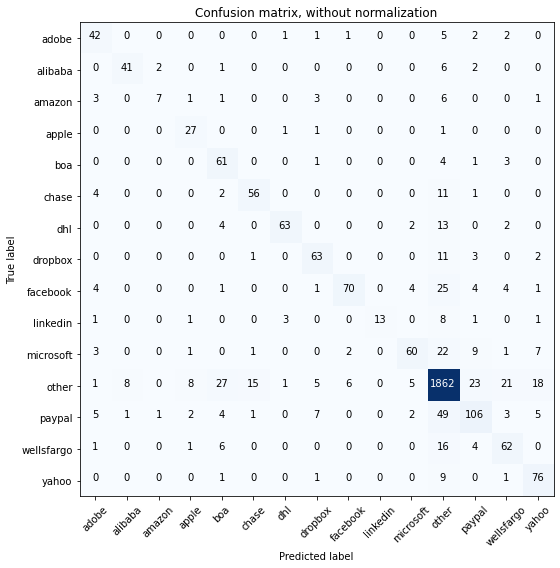

Acc     =  0.848
Pre     =  0.852
Rec     =  0.848
F1      =  0.845

Bal_Acc =  0.71
Bal_Pre =  0.762
Bal_Rec =  0.71
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        54
     alibaba       0.82      0.79      0.80        52
      amazon       0.70      0.32      0.44        22
       apple       0.66      0.90      0.76        30
         boa       0.56      0.87      0.69        70
       chase       0.76      0.76      0.76        74
         dhl       0.91      0.75      0.82        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.89      0.61      0.73       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.82      0.57      0.67       106
       other       0.91      0.93      0.92      2000
      paypal       0.68      0.57      0.62       186
  wellsfargo       0.63      0.69      0.66        90
       yahoo       0.68      0.86      0.76        88

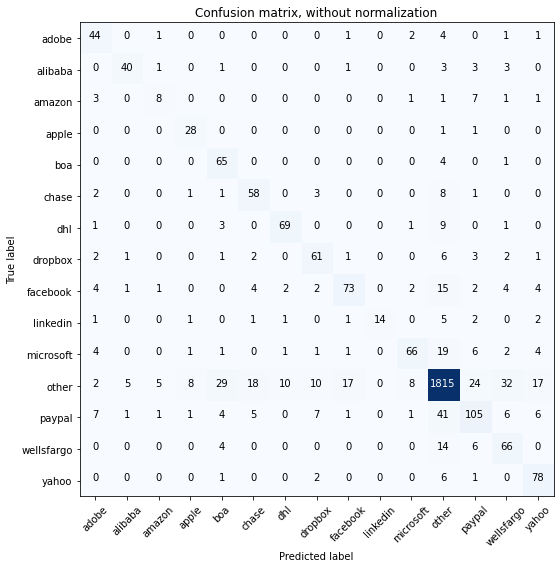

Acc     =  0.841
Pre     =  0.851
Rec     =  0.841
F1      =  0.842

Bal_Acc =  0.735
Bal_Pre =  0.721
Bal_Rec =  0.735
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.47      0.36      0.41        22
       apple       0.70      0.93      0.80        30
         boa       0.59      0.93      0.72        70
       chase       0.66      0.78      0.72        74
         dhl       0.83      0.82      0.83        84
     dropbox       0.71      0.76      0.73        80
    facebook       0.76      0.64      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.81      0.62      0.71       106
       other       0.93      0.91      0.92      2000
      paypal       0.65      0.56      0.61       186
  wellsfargo       0.55      0.73      0.63        90
       yahoo       0.68      0.89      0.77        

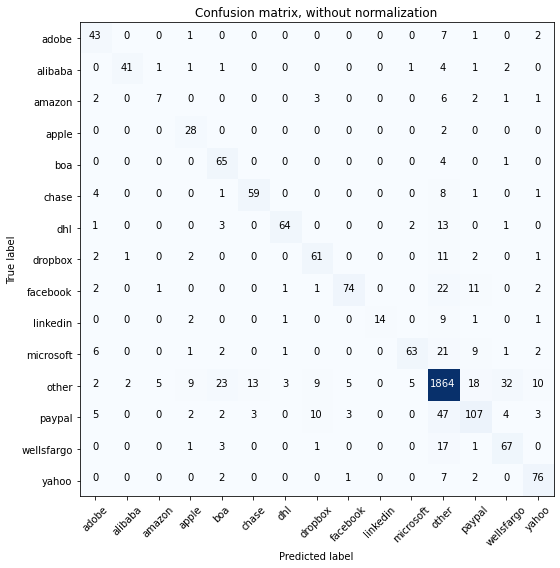

Acc     =  0.855
Pre     =  0.861
Rec     =  0.855
F1      =  0.853

Bal_Acc =  0.73
Bal_Pre =  0.766
Bal_Rec =  0.73
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.64      0.80      0.71        54
     alibaba       0.93      0.79      0.85        52
      amazon       0.50      0.32      0.39        22
       apple       0.60      0.93      0.73        30
         boa       0.64      0.93      0.76        70
       chase       0.79      0.80      0.79        74
         dhl       0.91      0.76      0.83        84
     dropbox       0.72      0.76      0.74        80
    facebook       0.89      0.65      0.75       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.59      0.71       106
       other       0.91      0.93      0.92      2000
      paypal       0.69      0.58      0.63       186
  wellsfargo       0.61      0.74      0.67        90
       yahoo       0.77      0.86      0.81        88

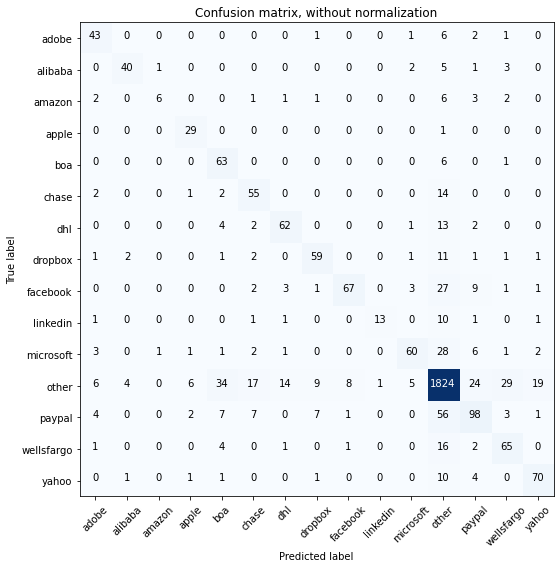

Acc     =  0.83
Pre     =  0.835
Rec     =  0.83
F1      =  0.827

Bal_Acc =  0.7
Bal_Pre =  0.744
Bal_Rec =  0.7
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       0.85      0.77      0.81        52
      amazon       0.75      0.27      0.40        22
       apple       0.72      0.97      0.83        30
         boa       0.54      0.90      0.67        70
       chase       0.62      0.74      0.67        74
         dhl       0.75      0.74      0.74        84
     dropbox       0.75      0.74      0.74        80
    facebook       0.87      0.59      0.70       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.82      0.57      0.67       106
       other       0.90      0.91      0.90      2000
      paypal       0.64      0.53      0.58       186
  wellsfargo       0.61      0.72      0.66        90
       yahoo       0.74      0.80      0.77        88

  

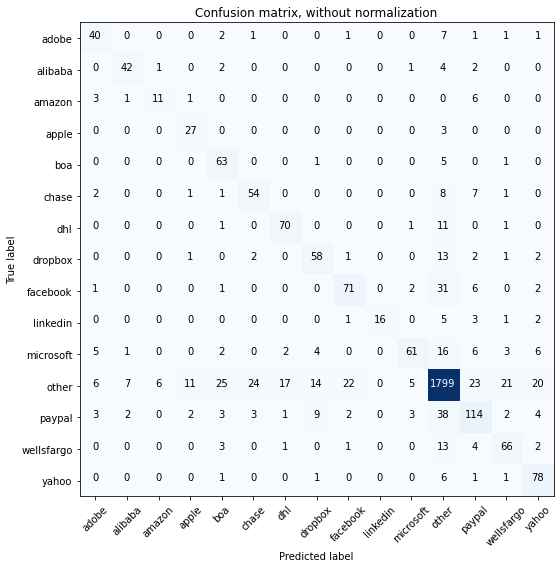

Acc     =  0.835
Pre     =  0.842
Rec     =  0.835
F1      =  0.835

Bal_Acc =  0.736
Bal_Pre =  0.723
Bal_Rec =  0.736
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.67      0.74      0.70        54
     alibaba       0.79      0.81      0.80        52
      amazon       0.61      0.50      0.55        22
       apple       0.63      0.90      0.74        30
         boa       0.61      0.90      0.72        70
       chase       0.64      0.73      0.68        74
         dhl       0.77      0.83      0.80        84
     dropbox       0.67      0.72      0.69        80
    facebook       0.72      0.62      0.67       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.84      0.58      0.68       106
       other       0.92      0.90      0.91      2000
      paypal       0.65      0.61      0.63       186
  wellsfargo       0.67      0.73      0.70        90
       yahoo       0.67      0.89      0.76        

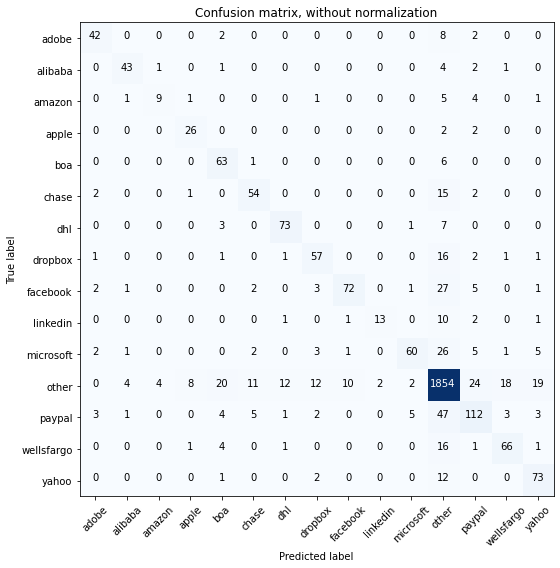

Acc     =  0.85
Pre     =  0.851
Rec     =  0.85
F1      =  0.847

Bal_Acc =  0.723
Bal_Pre =  0.766
Bal_Rec =  0.723
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.81      0.78      0.79        54
     alibaba       0.84      0.83      0.83        52
      amazon       0.64      0.41      0.50        22
       apple       0.70      0.87      0.78        30
         boa       0.64      0.90      0.75        70
       chase       0.72      0.73      0.72        74
         dhl       0.82      0.87      0.84        84
     dropbox       0.71      0.71      0.71        80
    facebook       0.86      0.63      0.73       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.87      0.57      0.69       106
       other       0.90      0.93      0.91      2000
      paypal       0.69      0.60      0.64       186
  wellsfargo       0.73      0.73      0.73        90
       yahoo       0.70      0.83      0.76        88

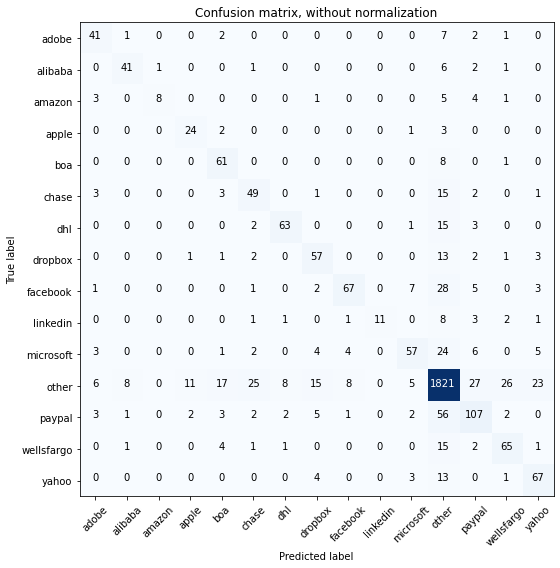

Acc     =  0.825
Pre     =  0.829
Rec     =  0.825
F1      =  0.822

Bal_Acc =  0.68
Bal_Pre =  0.74
Bal_Rec =  0.68
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.68      0.76      0.72        54
     alibaba       0.79      0.79      0.79        52
      amazon       0.89      0.36      0.52        22
       apple       0.63      0.80      0.71        30
         boa       0.65      0.87      0.74        70
       chase       0.57      0.66      0.61        74
         dhl       0.84      0.75      0.79        84
     dropbox       0.64      0.71      0.67        80
    facebook       0.83      0.59      0.69       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.75      0.54      0.63       106
       other       0.89      0.91      0.90      2000
      paypal       0.65      0.58      0.61       186
  wellsfargo       0.64      0.72      0.68        90
       yahoo       0.64      0.76      0.70        88


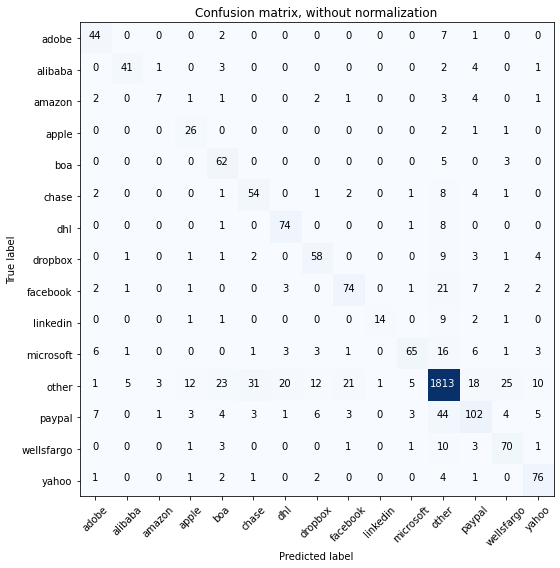

Acc     =  0.838
Pre     =  0.845
Rec     =  0.838
F1      =  0.838

Bal_Acc =  0.725
Bal_Pre =  0.714
Bal_Rec =  0.725
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.84      0.79      0.81        52
      amazon       0.58      0.32      0.41        22
       apple       0.55      0.87      0.68        30
         boa       0.60      0.89      0.71        70
       chase       0.59      0.73      0.65        74
         dhl       0.73      0.88      0.80        84
     dropbox       0.69      0.72      0.71        80
    facebook       0.72      0.65      0.68       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.84      0.61      0.71       106
       other       0.92      0.91      0.92      2000
      paypal       0.65      0.55      0.60       186
  wellsfargo       0.64      0.78      0.70        90
       yahoo       0.74      0.86      0.80        

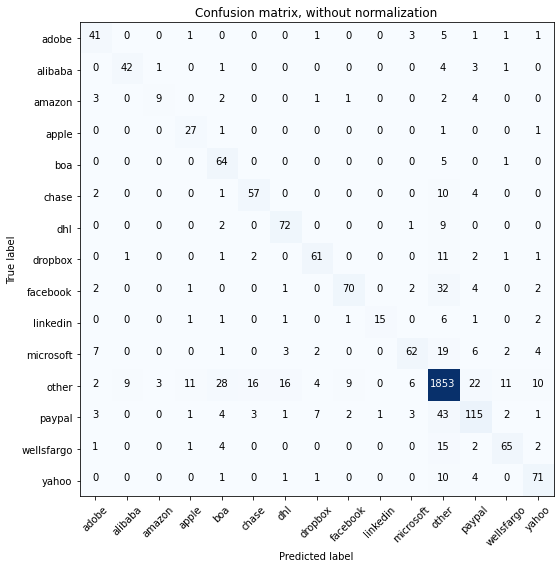

Acc     =  0.853
Pre     =  0.856
Rec     =  0.853
F1      =  0.851

Bal_Acc =  0.733
Bal_Pre =  0.758
Bal_Rec =  0.733
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.67      0.76      0.71        54
     alibaba       0.81      0.81      0.81        52
      amazon       0.69      0.41      0.51        22
       apple       0.63      0.90      0.74        30
         boa       0.58      0.91      0.71        70
       chase       0.73      0.77      0.75        74
         dhl       0.76      0.86      0.80        84
     dropbox       0.79      0.76      0.78        80
    facebook       0.84      0.61      0.71       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.81      0.58      0.68       106
       other       0.92      0.93      0.92      2000
      paypal       0.68      0.62      0.65       186
  wellsfargo       0.77      0.72      0.75        90
       yahoo       0.75      0.81      0.78        

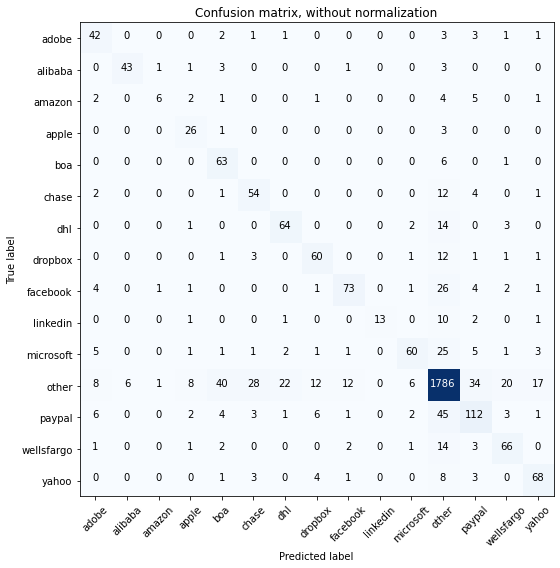

Acc     =  0.824
Pre     =  0.834
Rec     =  0.824
F1      =  0.824

Bal_Acc =  0.704
Bal_Pre =  0.72
Bal_Rec =  0.704
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        54
     alibaba       0.88      0.83      0.85        52
      amazon       0.67      0.27      0.39        22
       apple       0.59      0.87      0.70        30
         boa       0.53      0.90      0.66        70
       chase       0.58      0.73      0.65        74
         dhl       0.70      0.76      0.73        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.80      0.64      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.82      0.57      0.67       106
       other       0.91      0.89      0.90      2000
      paypal       0.64      0.60      0.62       186
  wellsfargo       0.67      0.73      0.70        90
       yahoo       0.72      0.77      0.74        8

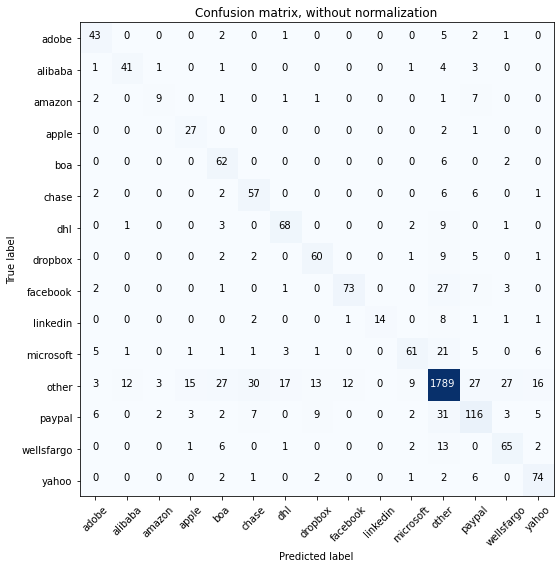

Acc     =  0.831
Pre     =  0.843
Rec     =  0.831
F1      =  0.833

Bal_Acc =  0.727
Bal_Pre =  0.71
Bal_Rec =  0.727
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.67      0.80      0.73        54
     alibaba       0.75      0.79      0.77        52
      amazon       0.60      0.41      0.49        22
       apple       0.57      0.90      0.70        30
         boa       0.55      0.89      0.68        70
       chase       0.57      0.77      0.66        74
         dhl       0.74      0.81      0.77        84
     dropbox       0.70      0.75      0.72        80
    facebook       0.85      0.64      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.77      0.58      0.66       106
       other       0.93      0.89      0.91      2000
      paypal       0.62      0.62      0.62       186
  wellsfargo       0.63      0.72      0.67        90
       yahoo       0.70      0.84      0.76        8

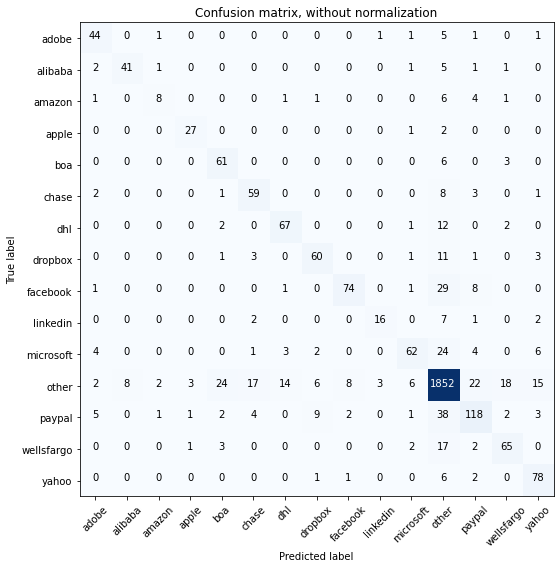

Acc     =  0.855
Pre     =  0.856
Rec     =  0.855
F1      =  0.853

Bal_Acc =  0.737
Bal_Pre =  0.761
Bal_Rec =  0.737
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.84      0.79      0.81        52
      amazon       0.62      0.36      0.46        22
       apple       0.84      0.90      0.87        30
         boa       0.65      0.87      0.74        70
       chase       0.69      0.80      0.74        74
         dhl       0.78      0.80      0.79        84
     dropbox       0.76      0.75      0.75        80
    facebook       0.87      0.65      0.74       114
    linkedin       0.80      0.57      0.67        28
   microsoft       0.81      0.58      0.68       106
       other       0.91      0.93      0.92      2000
      paypal       0.71      0.63      0.67       186
  wellsfargo       0.71      0.72      0.71        90
       yahoo       0.72      0.89      0.79        

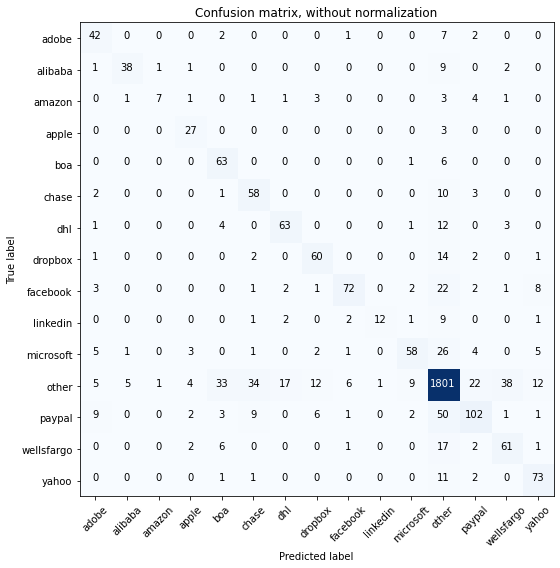

Acc     =  0.824
Pre     =  0.833
Rec     =  0.824
F1      =  0.823

Bal_Acc =  0.698
Bal_Pre =  0.727
Bal_Rec =  0.698
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.61      0.78      0.68        54
     alibaba       0.84      0.73      0.78        52
      amazon       0.78      0.32      0.45        22
       apple       0.68      0.90      0.77        30
         boa       0.56      0.90      0.69        70
       chase       0.54      0.78      0.64        74
         dhl       0.74      0.75      0.75        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.86      0.63      0.73       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.78      0.55      0.64       106
       other       0.90      0.90      0.90      2000
      paypal       0.70      0.55      0.62       186
  wellsfargo       0.57      0.68      0.62        90
       yahoo       0.72      0.83      0.77        

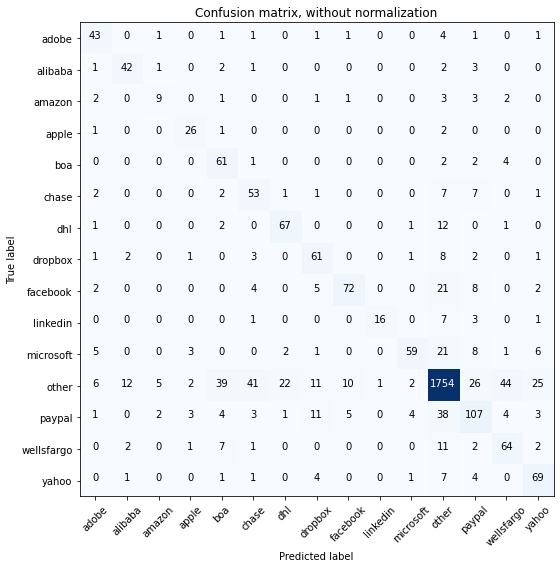

Acc     =  0.813
Pre     =  0.832
Rec     =  0.813
F1      =  0.817

Bal_Acc =  0.716
Bal_Pre =  0.683
Bal_Rec =  0.716
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.66      0.80      0.72        54
     alibaba       0.71      0.81      0.76        52
      amazon       0.50      0.41      0.45        22
       apple       0.72      0.87      0.79        30
         boa       0.50      0.87      0.64        70
       chase       0.48      0.72      0.58        74
         dhl       0.72      0.80      0.76        84
     dropbox       0.64      0.76      0.69        80
    facebook       0.81      0.63      0.71       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.87      0.56      0.68       106
       other       0.92      0.88      0.90      2000
      paypal       0.61      0.58      0.59       186
  wellsfargo       0.53      0.71      0.61        90
       yahoo       0.62      0.78      0.69        

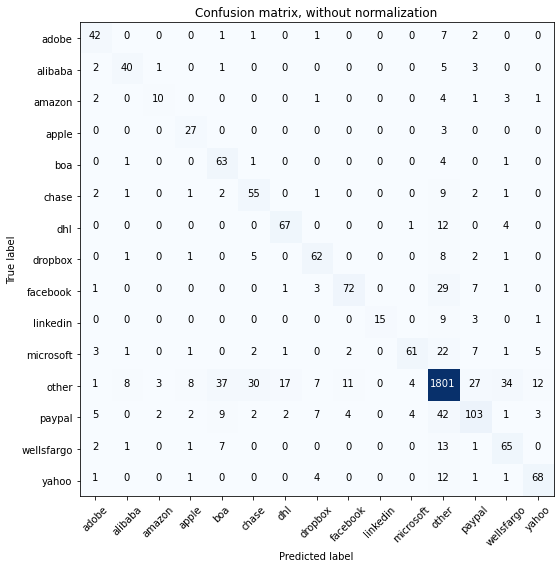

Acc     =  0.829
Pre     =  0.838
Rec     =  0.829
F1      =  0.829

Bal_Acc =  0.721
Bal_Pre =  0.724
Bal_Rec =  0.721
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.75      0.77      0.76        52
      amazon       0.62      0.45      0.53        22
       apple       0.64      0.90      0.75        30
         boa       0.53      0.90      0.66        70
       chase       0.57      0.74      0.65        74
         dhl       0.76      0.80      0.78        84
     dropbox       0.72      0.78      0.75        80
    facebook       0.81      0.63      0.71       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.87      0.58      0.69       106
       other       0.91      0.90      0.91      2000
      paypal       0.65      0.55      0.60       186
  wellsfargo       0.58      0.72      0.64        90
       yahoo       0.76      0.77      0.76        

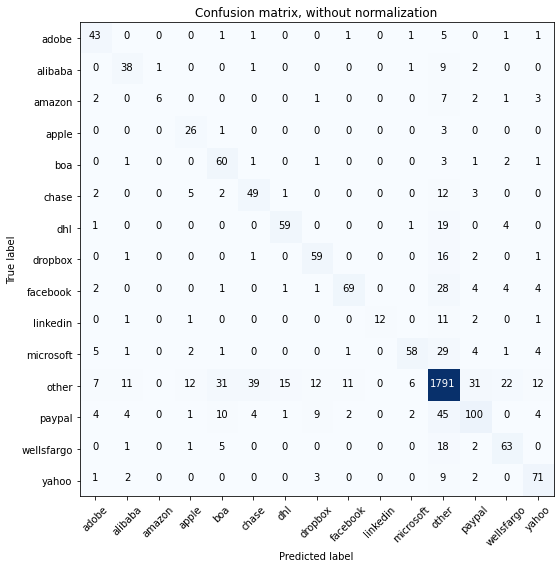

Acc     =  0.814
Pre     =  0.823
Rec     =  0.814
F1      =  0.812

Bal_Acc =  0.676
Bal_Pre =  0.714
Bal_Rec =  0.676
Bal_F1  =  0.694

              precision    recall  f1-score   support

       adobe       0.64      0.80      0.71        54
     alibaba       0.63      0.73      0.68        52
      amazon       0.86      0.27      0.41        22
       apple       0.54      0.87      0.67        30
         boa       0.54      0.86      0.66        70
       chase       0.51      0.66      0.58        74
         dhl       0.77      0.70      0.73        84
     dropbox       0.69      0.74      0.71        80
    facebook       0.82      0.61      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.84      0.55      0.66       106
       other       0.89      0.90      0.89      2000
      paypal       0.65      0.54      0.59       186
  wellsfargo       0.64      0.70      0.67        90
       yahoo       0.70      0.81      0.75        

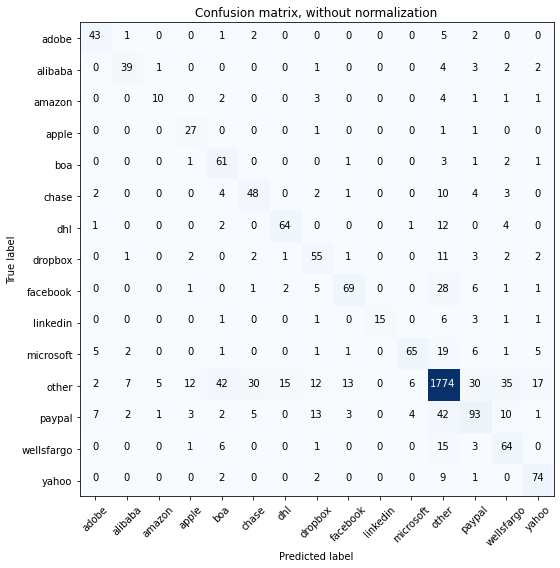

Acc     =  0.813
Pre     =  0.827
Rec     =  0.813
F1      =  0.815

Bal_Acc =  0.704
Bal_Pre =  0.691
Bal_Rec =  0.704
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.72      0.80      0.75        54
     alibaba       0.75      0.75      0.75        52
      amazon       0.59      0.45      0.51        22
       apple       0.57      0.90      0.70        30
         boa       0.49      0.87      0.63        70
       chase       0.55      0.65      0.59        74
         dhl       0.78      0.76      0.77        84
     dropbox       0.57      0.69      0.62        80
    facebook       0.78      0.61      0.68       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.86      0.61      0.71       106
       other       0.91      0.89      0.90      2000
      paypal       0.59      0.50      0.54       186
  wellsfargo       0.51      0.71      0.59        90
       yahoo       0.70      0.84      0.77        

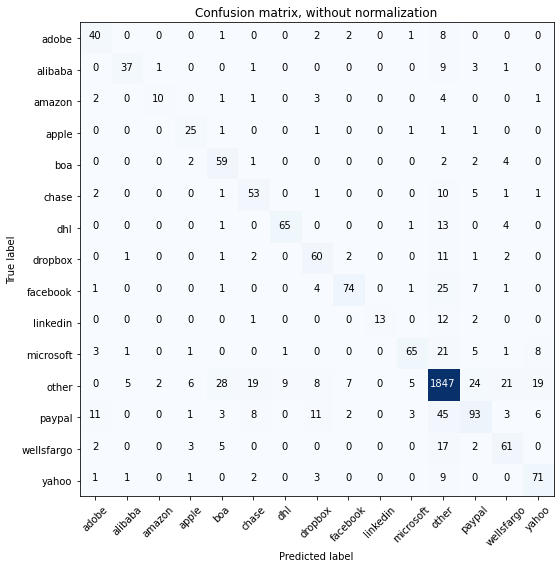

Acc     =  0.836
Pre     =  0.841
Rec     =  0.836
F1      =  0.834

Bal_Acc =  0.697
Bal_Pre =  0.74
Bal_Rec =  0.697
Bal_F1  =  0.718

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.82      0.71      0.76        52
      amazon       0.77      0.45      0.57        22
       apple       0.64      0.83      0.72        30
         boa       0.58      0.84      0.69        70
       chase       0.60      0.72      0.65        74
         dhl       0.87      0.77      0.82        84
     dropbox       0.65      0.75      0.69        80
    facebook       0.85      0.65      0.74       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.84      0.61      0.71       106
       other       0.91      0.92      0.92      2000
      paypal       0.64      0.50      0.56       186
  wellsfargo       0.62      0.68      0.65        90
       yahoo       0.67      0.81      0.73        8

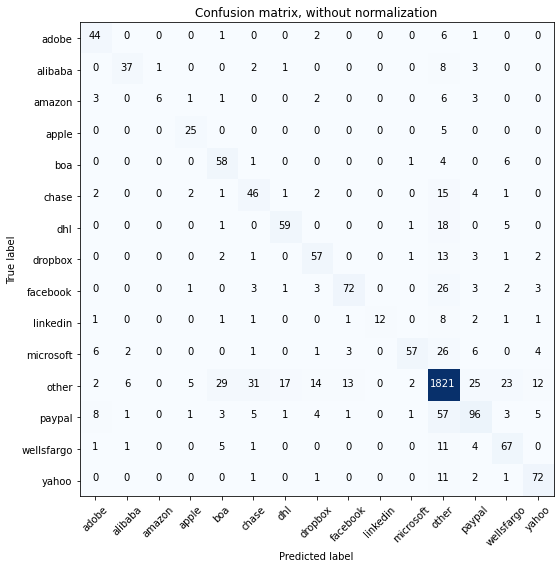

Acc     =  0.822
Pre     =  0.828
Rec     =  0.822
F1      =  0.819

Bal_Acc =  0.672
Bal_Pre =  0.736
Bal_Rec =  0.672
Bal_F1  =  0.703

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.79      0.71      0.75        52
      amazon       0.86      0.27      0.41        22
       apple       0.71      0.83      0.77        30
         boa       0.57      0.83      0.67        70
       chase       0.49      0.62      0.55        74
         dhl       0.74      0.70      0.72        84
     dropbox       0.66      0.71      0.69        80
    facebook       0.80      0.63      0.71       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.90      0.54      0.67       106
       other       0.89      0.91      0.90      2000
      paypal       0.63      0.52      0.57       186
  wellsfargo       0.61      0.74      0.67        90
       yahoo       0.73      0.82      0.77        

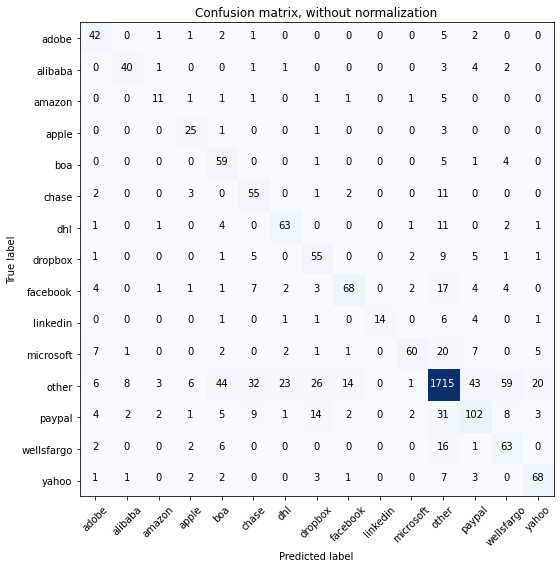

Acc     =  0.793
Pre     =  0.82
Rec     =  0.793
F1      =  0.8

Bal_Acc =  0.696
Bal_Pre =  0.661
Bal_Rec =  0.696
Bal_F1  =  0.678

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        54
     alibaba       0.77      0.77      0.77        52
      amazon       0.55      0.50      0.52        22
       apple       0.60      0.83      0.69        30
         boa       0.46      0.84      0.59        70
       chase       0.50      0.74      0.59        74
         dhl       0.68      0.75      0.71        84
     dropbox       0.51      0.69      0.59        80
    facebook       0.76      0.60      0.67       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.87      0.57      0.69       106
       other       0.92      0.86      0.89      2000
      paypal       0.58      0.55      0.56       186
  wellsfargo       0.44      0.70      0.54        90
       yahoo       0.69      0.77      0.73        88


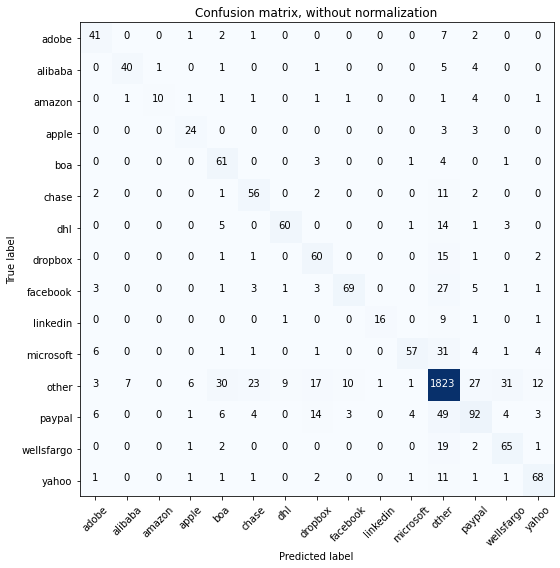

Acc     =  0.826
Pre     =  0.833
Rec     =  0.826
F1      =  0.824

Bal_Acc =  0.699
Bal_Pre =  0.745
Bal_Rec =  0.699
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.66      0.76      0.71        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.91      0.45      0.61        22
       apple       0.69      0.80      0.74        30
         boa       0.54      0.87      0.67        70
       chase       0.62      0.76      0.68        74
         dhl       0.85      0.71      0.77        84
     dropbox       0.58      0.75      0.65        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.88      0.54      0.67       106
       other       0.90      0.91      0.90      2000
      paypal       0.62      0.49      0.55       186
  wellsfargo       0.61      0.72      0.66        90
       yahoo       0.73      0.77      0.75        

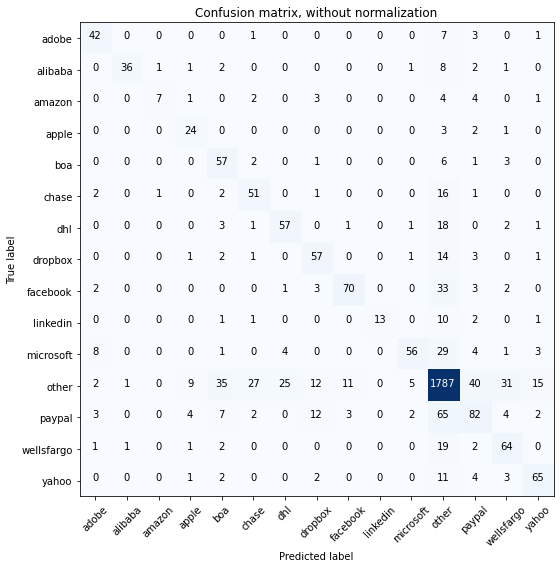

Acc     =  0.802
Pre     =  0.809
Rec     =  0.802
F1      =  0.8

Bal_Acc =  0.658
Bal_Pre =  0.716
Bal_Rec =  0.658
Bal_F1  =  0.686

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.95      0.69      0.80        52
      amazon       0.78      0.32      0.45        22
       apple       0.57      0.80      0.67        30
         boa       0.50      0.81      0.62        70
       chase       0.58      0.69      0.63        74
         dhl       0.66      0.68      0.67        84
     dropbox       0.63      0.71      0.67        80
    facebook       0.82      0.61      0.70       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.85      0.53      0.65       106
       other       0.88      0.89      0.89      2000
      paypal       0.54      0.44      0.48       186
  wellsfargo       0.57      0.71      0.63        90
       yahoo       0.72      0.74      0.73        88

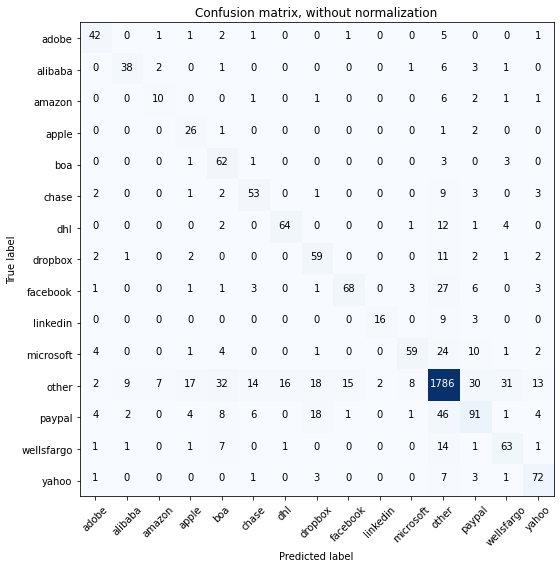

Acc     =  0.815
Pre     =  0.826
Rec     =  0.815
F1      =  0.816

Bal_Acc =  0.704
Bal_Pre =  0.683
Bal_Rec =  0.704
Bal_F1  =  0.693

              precision    recall  f1-score   support

       adobe       0.71      0.78      0.74        54
     alibaba       0.75      0.73      0.74        52
      amazon       0.50      0.45      0.48        22
       apple       0.47      0.87      0.61        30
         boa       0.51      0.89      0.65        70
       chase       0.66      0.72      0.69        74
         dhl       0.79      0.76      0.78        84
     dropbox       0.58      0.74      0.65        80
    facebook       0.80      0.60      0.68       114
    linkedin       0.89      0.57      0.70        28
   microsoft       0.81      0.56      0.66       106
       other       0.91      0.89      0.90      2000
      paypal       0.58      0.49      0.53       186
  wellsfargo       0.59      0.70      0.64        90
       yahoo       0.71      0.82      0.76        

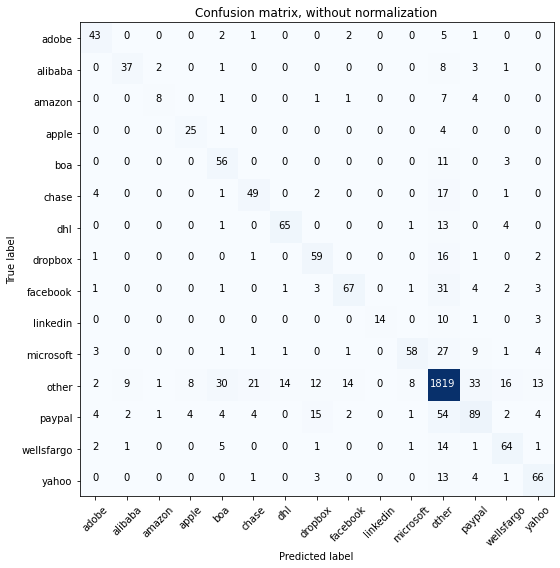

Acc     =  0.818
Pre     =  0.82
Rec     =  0.818
F1      =  0.815

Bal_Acc =  0.677
Bal_Pre =  0.723
Bal_Rec =  0.677
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.72      0.80      0.75        54
     alibaba       0.76      0.71      0.73        52
      amazon       0.67      0.36      0.47        22
       apple       0.68      0.83      0.75        30
         boa       0.54      0.80      0.64        70
       chase       0.63      0.66      0.64        74
         dhl       0.80      0.77      0.79        84
     dropbox       0.61      0.74      0.67        80
    facebook       0.77      0.59      0.67       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.83      0.55      0.66       106
       other       0.89      0.91      0.90      2000
      paypal       0.59      0.48      0.53       186
  wellsfargo       0.67      0.71      0.69        90
       yahoo       0.69      0.75      0.72        8

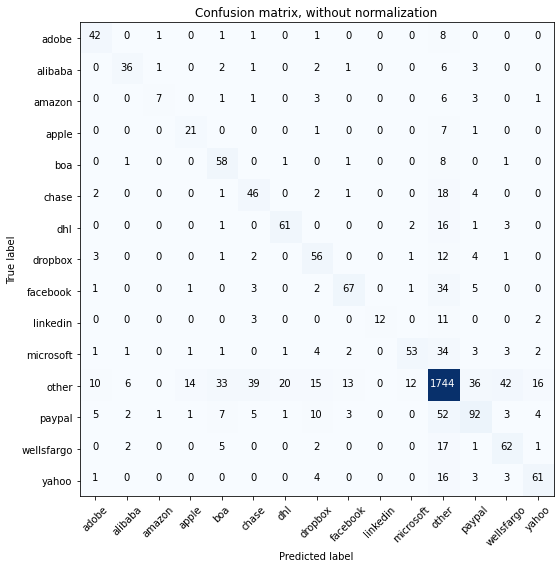

Acc     =  0.786
Pre     =  0.796
Rec     =  0.786
F1      =  0.786

Bal_Acc =  0.642
Bal_Pre =  0.675
Bal_Rec =  0.642
Bal_F1  =  0.658

              precision    recall  f1-score   support

       adobe       0.65      0.78      0.71        54
     alibaba       0.75      0.69      0.72        52
      amazon       0.70      0.32      0.44        22
       apple       0.55      0.70      0.62        30
         boa       0.52      0.83      0.64        70
       chase       0.46      0.62      0.53        74
         dhl       0.73      0.73      0.73        84
     dropbox       0.55      0.70      0.62        80
    facebook       0.76      0.59      0.66       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.77      0.50      0.61       106
       other       0.88      0.87      0.87      2000
      paypal       0.59      0.49      0.54       186
  wellsfargo       0.53      0.69      0.60        90
       yahoo       0.70      0.69      0.70        

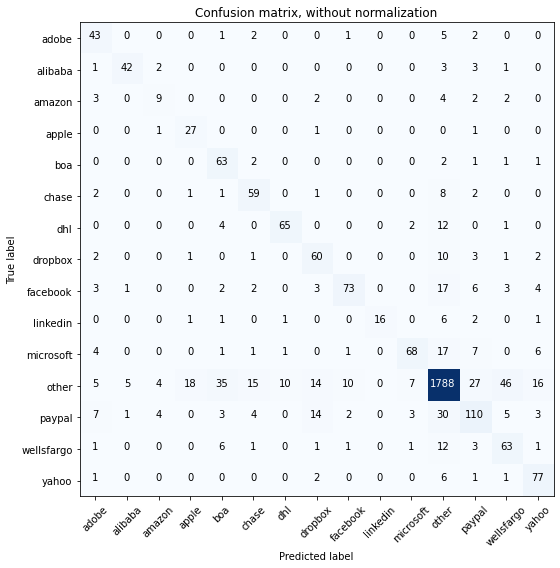

Acc     =  0.833
Pre     =  0.849
Rec     =  0.833
F1      =  0.836

Bal_Acc =  0.737
Bal_Pre =  0.706
Bal_Rec =  0.737
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.60      0.80      0.68        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.45      0.41      0.43        22
       apple       0.56      0.90      0.69        30
         boa       0.54      0.90      0.67        70
       chase       0.68      0.80      0.73        74
         dhl       0.84      0.77      0.81        84
     dropbox       0.61      0.75      0.67        80
    facebook       0.83      0.64      0.72       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.84      0.64      0.73       106
       other       0.93      0.89      0.91      2000
      paypal       0.65      0.59      0.62       186
  wellsfargo       0.51      0.70      0.59        90
       yahoo       0.69      0.88      0.77        

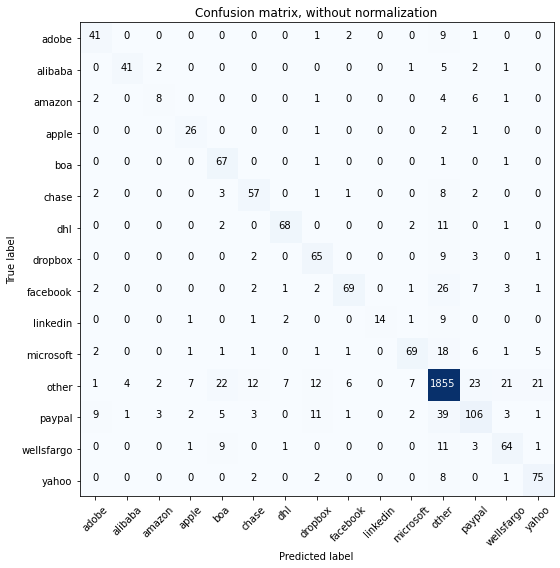

Acc     =  0.853
Pre     =  0.857
Rec     =  0.853
F1      =  0.851

Bal_Acc =  0.73
Bal_Pre =  0.754
Bal_Rec =  0.73
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.69      0.76      0.73        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.53      0.36      0.43        22
       apple       0.68      0.87      0.76        30
         boa       0.61      0.96      0.75        70
       chase       0.71      0.77      0.74        74
         dhl       0.86      0.81      0.83        84
     dropbox       0.66      0.81      0.73        80
    facebook       0.86      0.61      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.83      0.65      0.73       106
       other       0.92      0.93      0.92      2000
      paypal       0.66      0.57      0.61       186
  wellsfargo       0.66      0.71      0.68        90
       yahoo       0.71      0.85      0.78        88

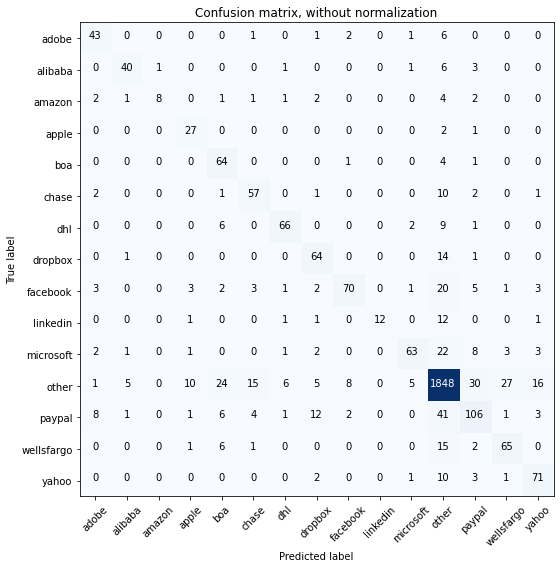

Acc     =  0.846
Pre     =  0.852
Rec     =  0.846
F1      =  0.844

Bal_Acc =  0.717
Bal_Pre =  0.765
Bal_Rec =  0.717
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.70      0.80      0.75        54
     alibaba       0.82      0.77      0.79        52
      amazon       0.89      0.36      0.52        22
       apple       0.61      0.90      0.73        30
         boa       0.58      0.91      0.71        70
       chase       0.70      0.77      0.73        74
         dhl       0.85      0.79      0.81        84
     dropbox       0.70      0.80      0.74        80
    facebook       0.84      0.61      0.71       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.85      0.59      0.70       106
       other       0.91      0.92      0.92      2000
      paypal       0.64      0.57      0.60       186
  wellsfargo       0.66      0.72      0.69        90
       yahoo       0.72      0.81      0.76        8

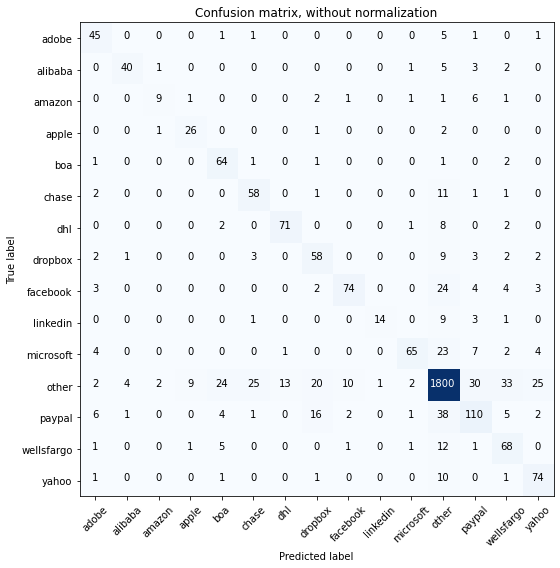

Acc     =  0.837
Pre     =  0.848
Rec     =  0.837
F1      =  0.838

Bal_Acc =  0.733
Bal_Pre =  0.739
Bal_Rec =  0.733
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.67      0.83      0.74        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.69      0.41      0.51        22
       apple       0.70      0.87      0.78        30
         boa       0.63      0.91      0.75        70
       chase       0.64      0.78      0.71        74
         dhl       0.84      0.85      0.84        84
     dropbox       0.57      0.72      0.64        80
    facebook       0.84      0.65      0.73       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.90      0.61      0.73       106
       other       0.92      0.90      0.91      2000
      paypal       0.65      0.59      0.62       186
  wellsfargo       0.55      0.76      0.64        90
       yahoo       0.67      0.84      0.74        

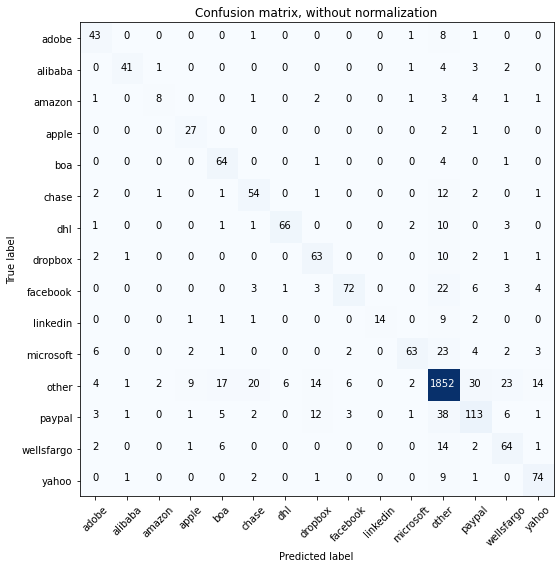

Acc     =  0.851
Pre     =  0.857
Rec     =  0.851
F1      =  0.849

Bal_Acc =  0.725
Bal_Pre =  0.763
Bal_Rec =  0.725
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.67      0.80      0.73        54
     alibaba       0.91      0.79      0.85        52
      amazon       0.67      0.36      0.47        22
       apple       0.66      0.90      0.76        30
         boa       0.67      0.91      0.77        70
       chase       0.64      0.73      0.68        74
         dhl       0.90      0.79      0.84        84
     dropbox       0.65      0.79      0.71        80
    facebook       0.87      0.63      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.59      0.71       106
       other       0.92      0.93      0.92      2000
      paypal       0.66      0.61      0.63       186
  wellsfargo       0.60      0.71      0.65        90
       yahoo       0.74      0.84      0.79        

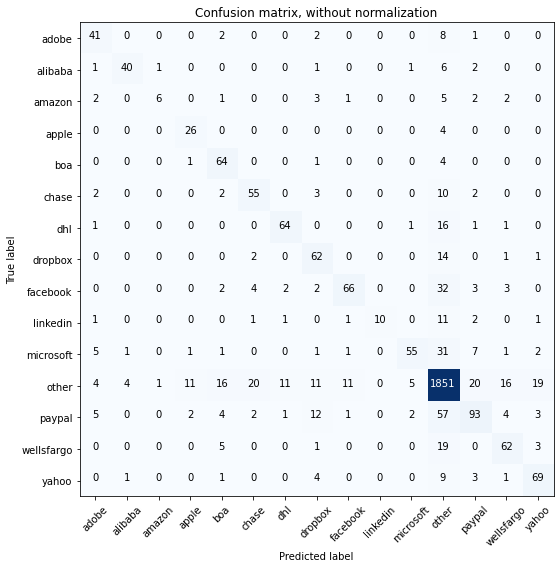

Acc     =  0.833
Pre     =  0.835
Rec     =  0.833
F1      =  0.828

Bal_Acc =  0.681
Bal_Pre =  0.751
Bal_Rec =  0.681
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.66      0.76      0.71        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.75      0.27      0.40        22
       apple       0.63      0.87      0.73        30
         boa       0.65      0.91      0.76        70
       chase       0.65      0.74      0.70        74
         dhl       0.81      0.76      0.79        84
     dropbox       0.60      0.78      0.68        80
    facebook       0.81      0.58      0.68       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.86      0.52      0.65       106
       other       0.89      0.93      0.91      2000
      paypal       0.68      0.50      0.58       186
  wellsfargo       0.68      0.69      0.69        90
       yahoo       0.70      0.78      0.74        

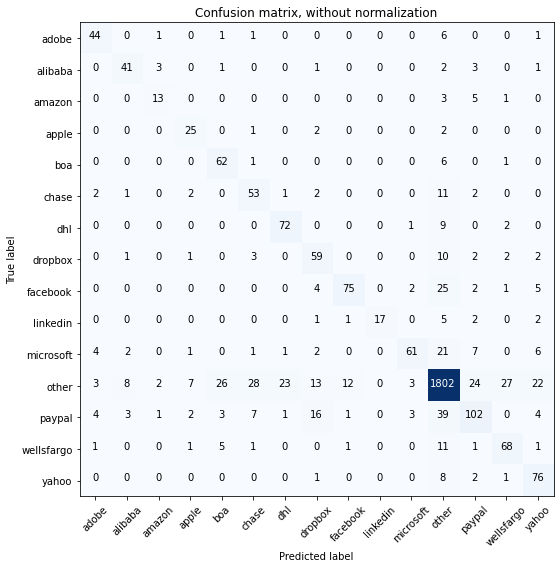

Acc     =  0.835
Pre     =  0.845
Rec     =  0.835
F1      =  0.836

Bal_Acc =  0.742
Bal_Pre =  0.725
Bal_Rec =  0.742
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        54
     alibaba       0.73      0.79      0.76        52
      amazon       0.65      0.59      0.62        22
       apple       0.64      0.83      0.72        30
         boa       0.63      0.89      0.74        70
       chase       0.55      0.72      0.62        74
         dhl       0.73      0.86      0.79        84
     dropbox       0.58      0.74      0.65        80
    facebook       0.83      0.66      0.74       114
    linkedin       1.00      0.61      0.76        28
   microsoft       0.87      0.58      0.69       106
       other       0.92      0.90      0.91      2000
      paypal       0.67      0.55      0.60       186
  wellsfargo       0.66      0.76      0.70        90
       yahoo       0.63      0.86      0.73        

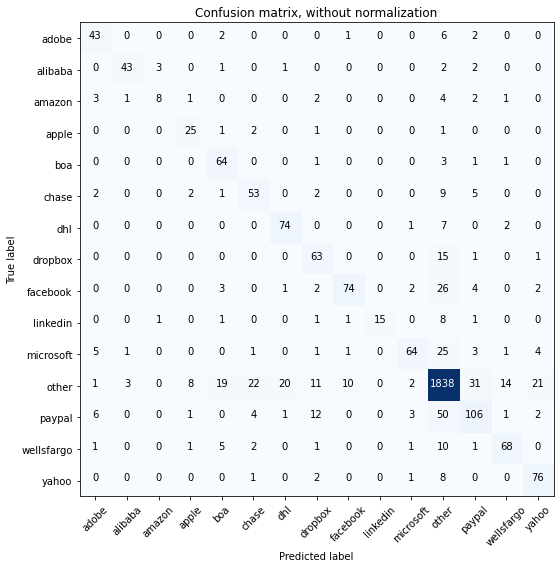

Acc     =  0.849
Pre     =  0.853
Rec     =  0.849
F1      =  0.848

Bal_Acc =  0.734
Bal_Pre =  0.76
Bal_Rec =  0.734
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.70      0.80      0.75        54
     alibaba       0.90      0.83      0.86        52
      amazon       0.67      0.36      0.47        22
       apple       0.66      0.83      0.74        30
         boa       0.66      0.91      0.77        70
       chase       0.62      0.72      0.67        74
         dhl       0.76      0.88      0.82        84
     dropbox       0.64      0.79      0.70        80
    facebook       0.85      0.65      0.74       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.86      0.60      0.71       106
       other       0.91      0.92      0.92      2000
      paypal       0.67      0.57      0.61       186
  wellsfargo       0.77      0.76      0.76        90
       yahoo       0.72      0.86      0.78        8

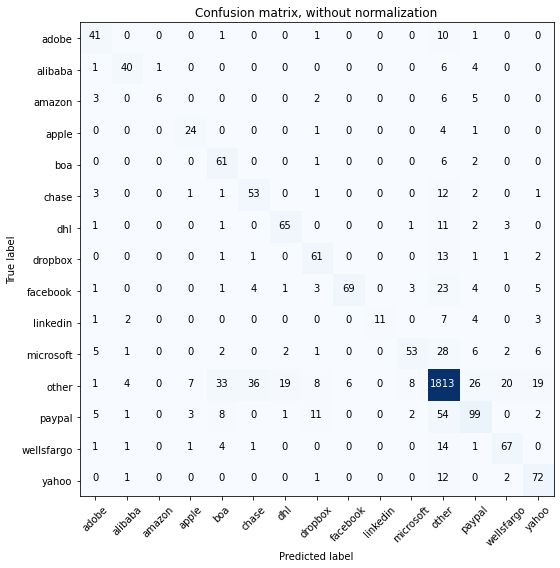

Acc     =  0.824
Pre     =  0.832
Rec     =  0.824
F1      =  0.821

Bal_Acc =  0.682
Bal_Pre =  0.738
Bal_Rec =  0.682
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.65      0.76      0.70        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.86      0.27      0.41        22
       apple       0.67      0.80      0.73        30
         boa       0.54      0.87      0.67        70
       chase       0.56      0.72      0.63        74
         dhl       0.74      0.77      0.76        84
     dropbox       0.67      0.76      0.71        80
    facebook       0.92      0.61      0.73       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.79      0.50      0.61       106
       other       0.90      0.91      0.90      2000
      paypal       0.63      0.53      0.58       186
  wellsfargo       0.71      0.74      0.72        90
       yahoo       0.65      0.82      0.73        

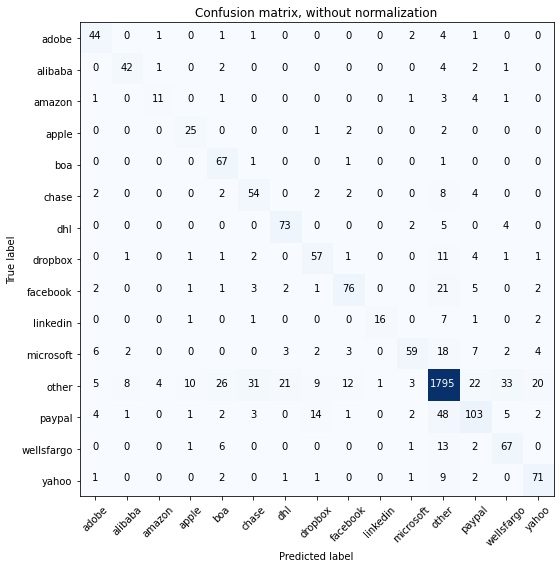

Acc     =  0.832
Pre     =  0.841
Rec     =  0.832
F1      =  0.832

Bal_Acc =  0.735
Bal_Pre =  0.712
Bal_Rec =  0.735
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.78      0.81      0.79        52
      amazon       0.65      0.50      0.56        22
       apple       0.62      0.83      0.71        30
         boa       0.60      0.96      0.74        70
       chase       0.56      0.73      0.64        74
         dhl       0.73      0.87      0.79        84
     dropbox       0.66      0.71      0.68        80
    facebook       0.78      0.67      0.72       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.83      0.56      0.67       106
       other       0.92      0.90      0.91      2000
      paypal       0.66      0.55      0.60       186
  wellsfargo       0.59      0.74      0.66        90
       yahoo       0.70      0.81      0.75        

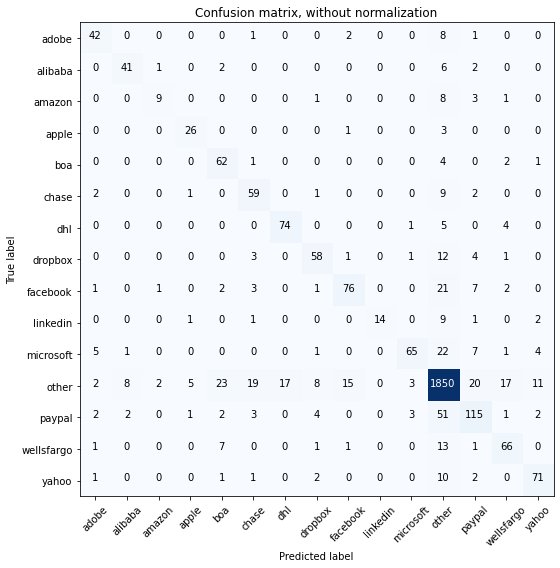

Acc     =  0.854
Pre     =  0.856
Rec     =  0.854
F1      =  0.852

Bal_Acc =  0.733
Bal_Pre =  0.773
Bal_Rec =  0.733
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        54
     alibaba       0.79      0.79      0.79        52
      amazon       0.69      0.41      0.51        22
       apple       0.76      0.87      0.81        30
         boa       0.63      0.89      0.73        70
       chase       0.65      0.80      0.72        74
         dhl       0.81      0.88      0.85        84
     dropbox       0.75      0.72      0.74        80
    facebook       0.79      0.67      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.61      0.73       106
       other       0.91      0.93      0.92      2000
      paypal       0.70      0.62      0.66       186
  wellsfargo       0.69      0.73      0.71        90
       yahoo       0.78      0.81      0.79        

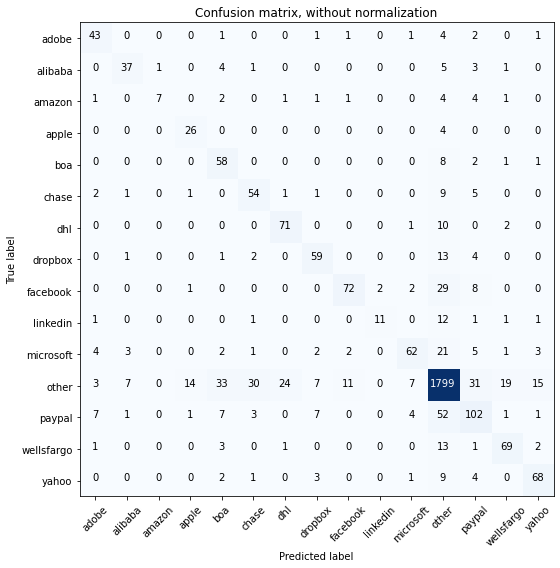

Acc     =  0.825
Pre     =  0.832
Rec     =  0.825
F1      =  0.824

Bal_Acc =  0.695
Bal_Pre =  0.726
Bal_Rec =  0.695
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.74      0.71      0.73        52
      amazon       0.88      0.32      0.47        22
       apple       0.60      0.87      0.71        30
         boa       0.51      0.83      0.63        70
       chase       0.58      0.73      0.65        74
         dhl       0.72      0.85      0.78        84
     dropbox       0.73      0.74      0.73        80
    facebook       0.83      0.63      0.72       114
    linkedin       0.85      0.39      0.54        28
   microsoft       0.79      0.58      0.67       106
       other       0.90      0.90      0.90      2000
      paypal       0.59      0.55      0.57       186
  wellsfargo       0.72      0.77      0.74        90
       yahoo       0.74      0.77      0.76        8

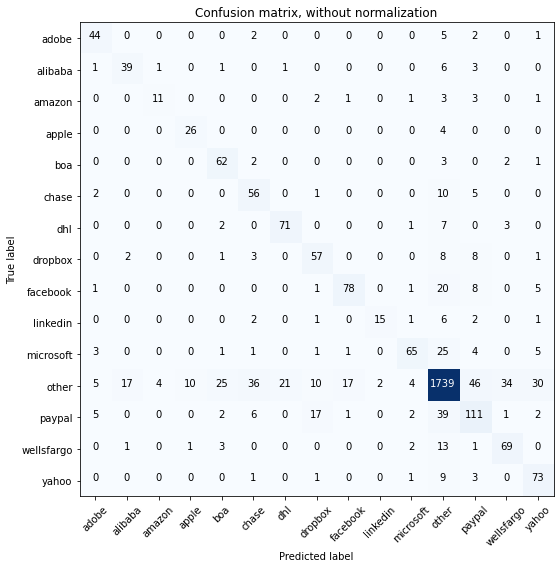

Acc     =  0.817
Pre     =  0.832
Rec     =  0.817
F1      =  0.821

Bal_Acc =  0.735
Bal_Pre =  0.703
Bal_Rec =  0.735
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.66      0.75      0.70        52
      amazon       0.69      0.50      0.58        22
       apple       0.70      0.87      0.78        30
         boa       0.64      0.89      0.74        70
       chase       0.51      0.76      0.61        74
         dhl       0.76      0.85      0.80        84
     dropbox       0.63      0.71      0.67        80
    facebook       0.80      0.68      0.74       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.83      0.61      0.71       106
       other       0.92      0.87      0.89      2000
      paypal       0.57      0.60      0.58       186
  wellsfargo       0.63      0.77      0.69        90
       yahoo       0.61      0.83      0.70        

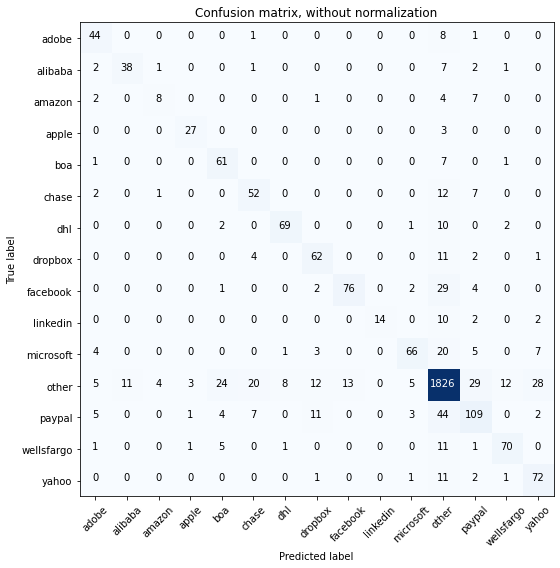

Acc     =  0.843
Pre     =  0.847
Rec     =  0.843
F1      =  0.842

Bal_Acc =  0.724
Bal_Pre =  0.756
Bal_Rec =  0.724
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        54
     alibaba       0.78      0.73      0.75        52
      amazon       0.57      0.36      0.44        22
       apple       0.84      0.90      0.87        30
         boa       0.63      0.87      0.73        70
       chase       0.61      0.70      0.65        74
         dhl       0.87      0.82      0.85        84
     dropbox       0.67      0.78      0.72        80
    facebook       0.85      0.67      0.75       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.85      0.62      0.72       106
       other       0.91      0.91      0.91      2000
      paypal       0.64      0.59      0.61       186
  wellsfargo       0.80      0.78      0.79        90
       yahoo       0.64      0.82      0.72        8

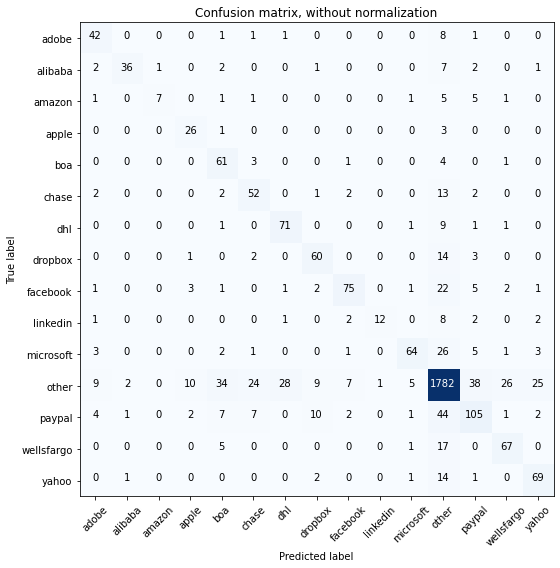

Acc     =  0.822
Pre     =  0.832
Rec     =  0.822
F1      =  0.822

Bal_Acc =  0.7
Bal_Pre =  0.733
Bal_Rec =  0.7
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.65      0.78      0.71        54
     alibaba       0.90      0.69      0.78        52
      amazon       0.88      0.32      0.47        22
       apple       0.62      0.87      0.72        30
         boa       0.52      0.87      0.65        70
       chase       0.57      0.70      0.63        74
         dhl       0.70      0.85      0.76        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.83      0.66      0.74       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.85      0.60      0.71       106
       other       0.90      0.89      0.90      2000
      paypal       0.62      0.56      0.59       186
  wellsfargo       0.67      0.74      0.71        90
       yahoo       0.67      0.78      0.72        88



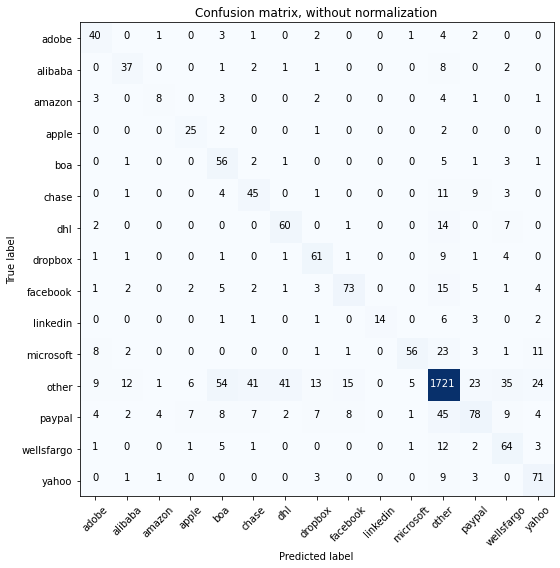

Acc     =  0.783
Pre     =  0.808
Rec     =  0.783
F1      =  0.788

Bal_Acc =  0.667
Bal_Pre =  0.639
Bal_Rec =  0.667
Bal_F1  =  0.653

              precision    recall  f1-score   support

       adobe       0.58      0.74      0.65        54
     alibaba       0.63      0.71      0.67        52
      amazon       0.53      0.36      0.43        22
       apple       0.61      0.83      0.70        30
         boa       0.39      0.80      0.53        70
       chase       0.44      0.61      0.51        74
         dhl       0.56      0.71      0.63        84
     dropbox       0.64      0.76      0.69        80
    facebook       0.74      0.64      0.69       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.53      0.66       106
       other       0.91      0.86      0.89      2000
      paypal       0.60      0.42      0.49       186
  wellsfargo       0.50      0.71      0.58        90
       yahoo       0.59      0.81      0.68        

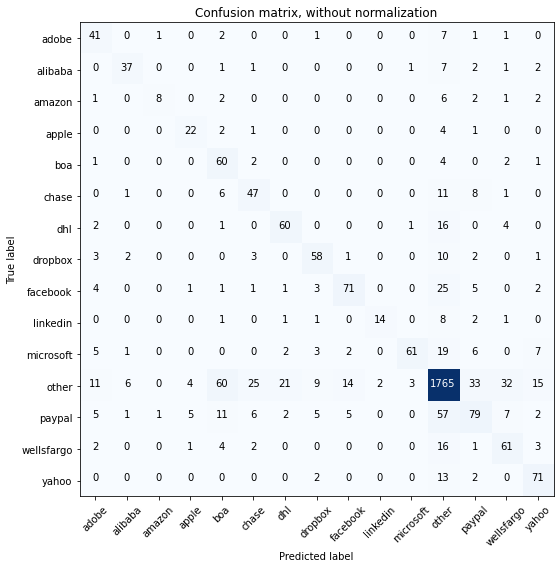

Acc     =  0.798
Pre     =  0.813
Rec     =  0.798
F1      =  0.799

Bal_Acc =  0.666
Bal_Pre =  0.689
Bal_Rec =  0.666
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.55      0.76      0.64        54
     alibaba       0.77      0.71      0.74        52
      amazon       0.80      0.36      0.50        22
       apple       0.67      0.73      0.70        30
         boa       0.40      0.86      0.54        70
       chase       0.53      0.64      0.58        74
         dhl       0.69      0.71      0.70        84
     dropbox       0.71      0.72      0.72        80
    facebook       0.76      0.62      0.69       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.92      0.58      0.71       106
       other       0.90      0.88      0.89      2000
      paypal       0.55      0.42      0.48       186
  wellsfargo       0.55      0.68      0.61        90
       yahoo       0.67      0.81      0.73        

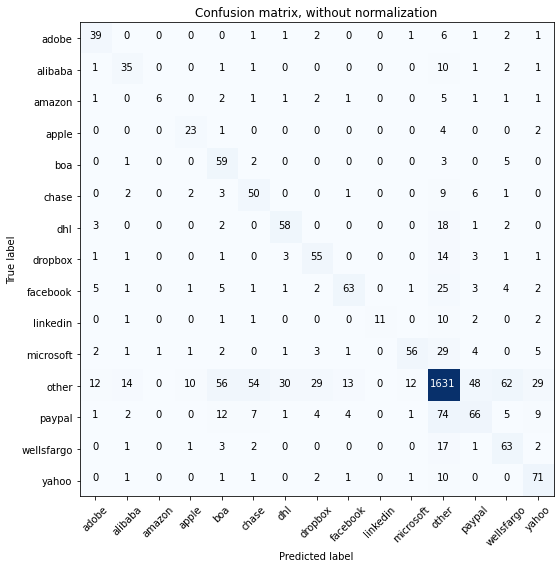

Acc     =  0.743
Pre     =  0.772
Rec     =  0.743
F1      =  0.748

Bal_Acc =  0.632
Bal_Pre =  0.633
Bal_Rec =  0.632
Bal_F1  =  0.632

              precision    recall  f1-score   support

       adobe       0.60      0.72      0.66        54
     alibaba       0.58      0.67      0.63        52
      amazon       0.86      0.27      0.41        22
       apple       0.61      0.77      0.68        30
         boa       0.40      0.84      0.54        70
       chase       0.41      0.68      0.51        74
         dhl       0.60      0.69      0.64        84
     dropbox       0.56      0.69      0.61        80
    facebook       0.75      0.55      0.64       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.78      0.53      0.63       106
       other       0.87      0.82      0.84      2000
      paypal       0.48      0.35      0.41       186
  wellsfargo       0.43      0.70      0.53        90
       yahoo       0.56      0.81      0.66        

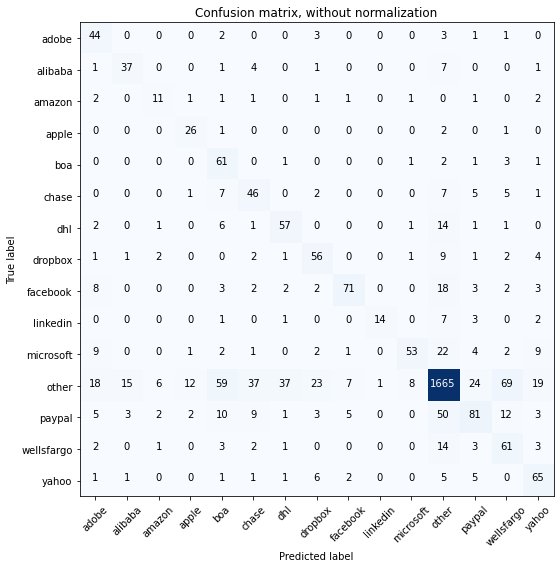

Acc     =  0.763
Pre     =  0.802
Rec     =  0.763
F1      =  0.772

Bal_Acc =  0.671
Bal_Pre =  0.613
Bal_Rec =  0.671
Bal_F1  =  0.641

              precision    recall  f1-score   support

       adobe       0.47      0.81      0.60        54
     alibaba       0.65      0.71      0.68        52
      amazon       0.48      0.50      0.49        22
       apple       0.60      0.87      0.71        30
         boa       0.39      0.87      0.54        70
       chase       0.43      0.62      0.51        74
         dhl       0.56      0.68      0.61        84
     dropbox       0.57      0.70      0.63        80
    facebook       0.82      0.62      0.71       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.82      0.50      0.62       106
       other       0.91      0.83      0.87      2000
      paypal       0.61      0.44      0.51       186
  wellsfargo       0.38      0.68      0.49        90
       yahoo       0.58      0.74      0.65        

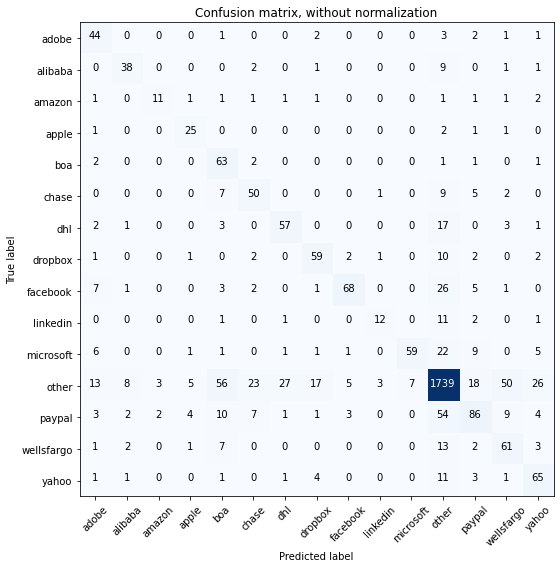

Acc     =  0.792
Pre     =  0.814
Rec     =  0.792
F1      =  0.796

Bal_Acc =  0.68
Bal_Pre =  0.662
Bal_Rec =  0.68
Bal_F1  =  0.671

              precision    recall  f1-score   support

       adobe       0.54      0.81      0.65        54
     alibaba       0.72      0.73      0.72        52
      amazon       0.69      0.50      0.58        22
       apple       0.66      0.83      0.74        30
         boa       0.41      0.90      0.56        70
       chase       0.56      0.68      0.61        74
         dhl       0.64      0.68      0.66        84
     dropbox       0.68      0.74      0.71        80
    facebook       0.86      0.60      0.70       114
    linkedin       0.71      0.43      0.53        28
   microsoft       0.89      0.56      0.69       106
       other       0.90      0.87      0.89      2000
      paypal       0.63      0.46      0.53       186
  wellsfargo       0.47      0.68      0.55        90
       yahoo       0.58      0.74      0.65        88

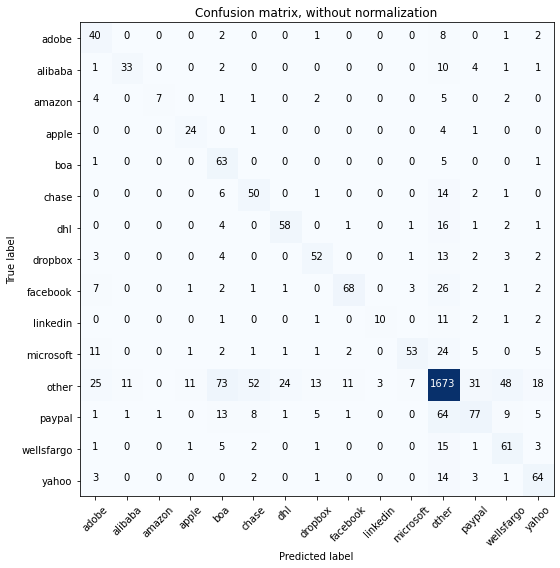

Acc     =  0.758
Pre     =  0.79
Rec     =  0.758
F1      =  0.764

Bal_Acc =  0.635
Bal_Pre =  0.648
Bal_Rec =  0.635
Bal_F1  =  0.641

              precision    recall  f1-score   support

       adobe       0.41      0.74      0.53        54
     alibaba       0.73      0.63      0.68        52
      amazon       0.88      0.32      0.47        22
       apple       0.63      0.80      0.71        30
         boa       0.35      0.90      0.51        70
       chase       0.42      0.68      0.52        74
         dhl       0.68      0.69      0.69        84
     dropbox       0.67      0.65      0.66        80
    facebook       0.82      0.60      0.69       114
    linkedin       0.77      0.36      0.49        28
   microsoft       0.82      0.50      0.62       106
       other       0.88      0.84      0.86      2000
      paypal       0.59      0.41      0.49       186
  wellsfargo       0.47      0.68      0.55        90
       yahoo       0.60      0.73      0.66        8

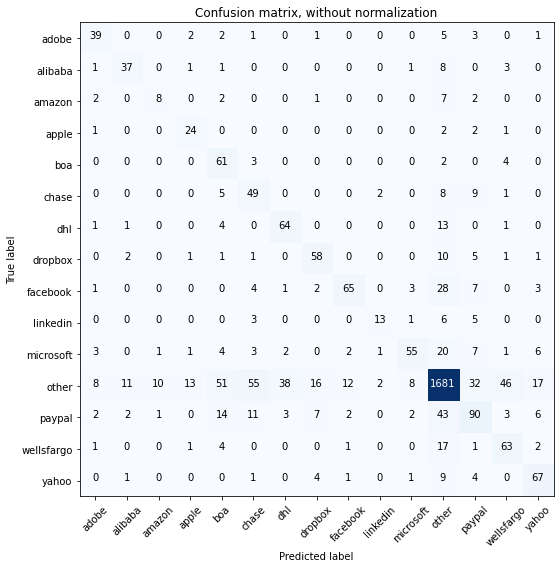

Acc     =  0.771
Pre     =  0.799
Rec     =  0.771
F1      =  0.778

Bal_Acc =  0.664
Bal_Pre =  0.614
Bal_Rec =  0.664
Bal_F1  =  0.638

              precision    recall  f1-score   support

       adobe       0.66      0.72      0.69        54
     alibaba       0.69      0.71      0.70        52
      amazon       0.40      0.36      0.38        22
       apple       0.56      0.80      0.66        30
         boa       0.41      0.87      0.56        70
       chase       0.37      0.66      0.48        74
         dhl       0.59      0.76      0.67        84
     dropbox       0.65      0.72      0.69        80
    facebook       0.78      0.57      0.66       114
    linkedin       0.72      0.46      0.57        28
   microsoft       0.77      0.52      0.62       106
       other       0.90      0.84      0.87      2000
      paypal       0.54      0.48      0.51       186
  wellsfargo       0.51      0.70      0.59        90
       yahoo       0.65      0.76      0.70        

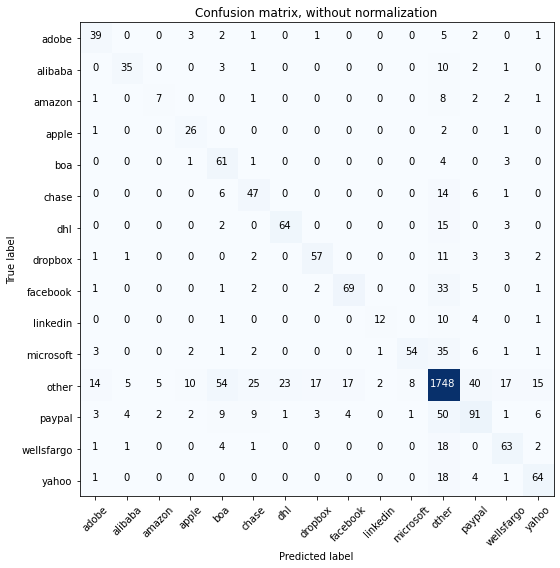

Acc     =  0.792
Pre     =  0.803
Rec     =  0.792
F1      =  0.792

Bal_Acc =  0.66
Bal_Pre =  0.668
Bal_Rec =  0.66
Bal_F1  =  0.664

              precision    recall  f1-score   support

       adobe       0.60      0.72      0.66        54
     alibaba       0.76      0.67      0.71        52
      amazon       0.50      0.32      0.39        22
       apple       0.59      0.87      0.70        30
         boa       0.42      0.87      0.57        70
       chase       0.51      0.64      0.57        74
         dhl       0.73      0.76      0.74        84
     dropbox       0.71      0.71      0.71        80
    facebook       0.77      0.61      0.68       114
    linkedin       0.80      0.43      0.56        28
   microsoft       0.86      0.51      0.64       106
       other       0.88      0.87      0.88      2000
      paypal       0.55      0.49      0.52       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.68      0.73      0.70        88

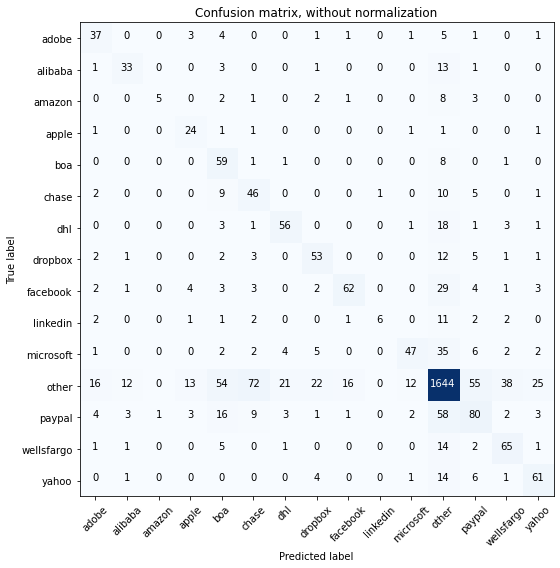

Acc     =  0.74
Pre     =  0.771
Rec     =  0.74
F1      =  0.746

Bal_Acc =  0.601
Bal_Pre =  0.618
Bal_Rec =  0.601
Bal_F1  =  0.609

              precision    recall  f1-score   support

       adobe       0.54      0.69      0.60        54
     alibaba       0.63      0.63      0.63        52
      amazon       0.83      0.23      0.36        22
       apple       0.50      0.80      0.62        30
         boa       0.36      0.84      0.50        70
       chase       0.33      0.62      0.43        74
         dhl       0.65      0.67      0.66        84
     dropbox       0.58      0.66      0.62        80
    facebook       0.76      0.54      0.63       114
    linkedin       0.86      0.21      0.34        28
   microsoft       0.72      0.44      0.55       106
       other       0.87      0.82      0.85      2000
      paypal       0.47      0.43      0.45       186
  wellsfargo       0.56      0.72      0.63        90
       yahoo       0.61      0.69      0.65        88

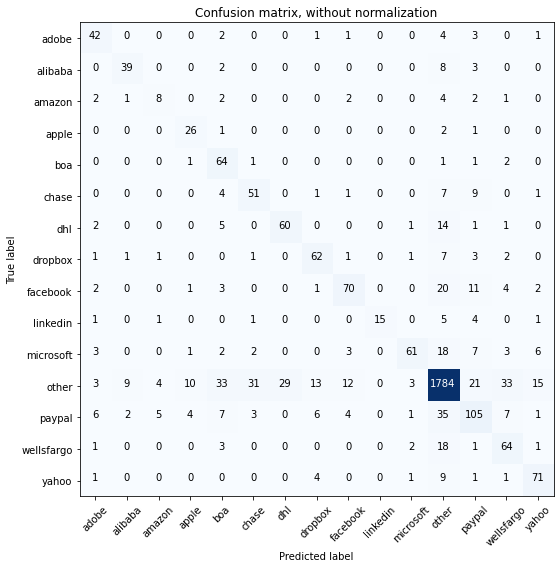

Acc     =  0.819
Pre     =  0.833
Rec     =  0.819
F1      =  0.822

Bal_Acc =  0.703
Bal_Pre =  0.685
Bal_Rec =  0.703
Bal_F1  =  0.694

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        54
     alibaba       0.75      0.75      0.75        52
      amazon       0.42      0.36      0.39        22
       apple       0.60      0.87      0.71        30
         boa       0.50      0.91      0.65        70
       chase       0.57      0.69      0.62        74
         dhl       0.67      0.71      0.69        84
     dropbox       0.70      0.78      0.74        80
    facebook       0.74      0.61      0.67       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.87      0.58      0.69       106
       other       0.92      0.89      0.91      2000
      paypal       0.61      0.56      0.58       186
  wellsfargo       0.54      0.71      0.62        90
       yahoo       0.72      0.81      0.76        

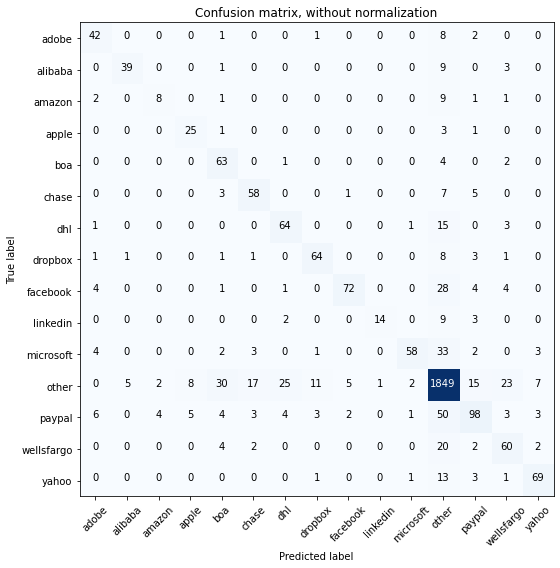

Acc     =  0.839
Pre     =  0.844
Rec     =  0.839
F1      =  0.836

Bal_Acc =  0.703
Bal_Pre =  0.751
Bal_Rec =  0.703
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.87      0.75      0.80        52
      amazon       0.57      0.36      0.44        22
       apple       0.66      0.83      0.74        30
         boa       0.56      0.90      0.69        70
       chase       0.69      0.78      0.73        74
         dhl       0.66      0.76      0.71        84
     dropbox       0.79      0.80      0.80        80
    facebook       0.90      0.63      0.74       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.92      0.55      0.69       106
       other       0.90      0.92      0.91      2000
      paypal       0.71      0.53      0.60       186
  wellsfargo       0.59      0.67      0.63        90
       yahoo       0.82      0.78      0.80        

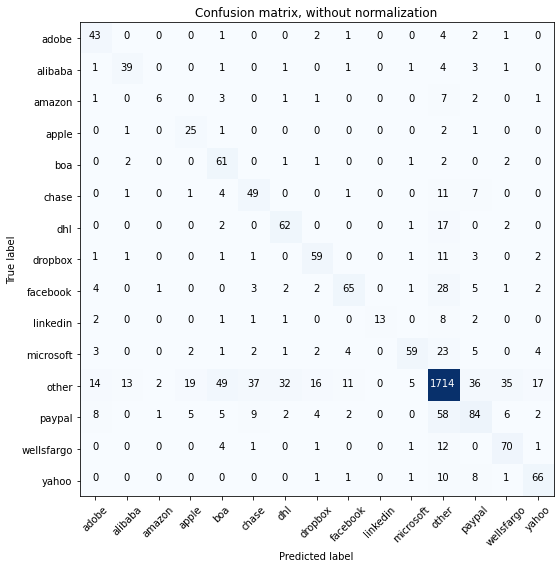

Acc     =  0.785
Pre     =  0.803
Rec     =  0.785
F1      =  0.787

Bal_Acc =  0.673
Bal_Pre =  0.655
Bal_Rec =  0.673
Bal_F1  =  0.664

              precision    recall  f1-score   support

       adobe       0.56      0.80      0.66        54
     alibaba       0.68      0.75      0.72        52
      amazon       0.60      0.27      0.37        22
       apple       0.48      0.83      0.61        30
         boa       0.46      0.87      0.60        70
       chase       0.48      0.66      0.55        74
         dhl       0.60      0.74      0.66        84
     dropbox       0.66      0.74      0.70        80
    facebook       0.76      0.57      0.65       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.83      0.56      0.67       106
       other       0.90      0.86      0.88      2000
      paypal       0.53      0.45      0.49       186
  wellsfargo       0.59      0.78      0.67        90
       yahoo       0.69      0.75      0.72        

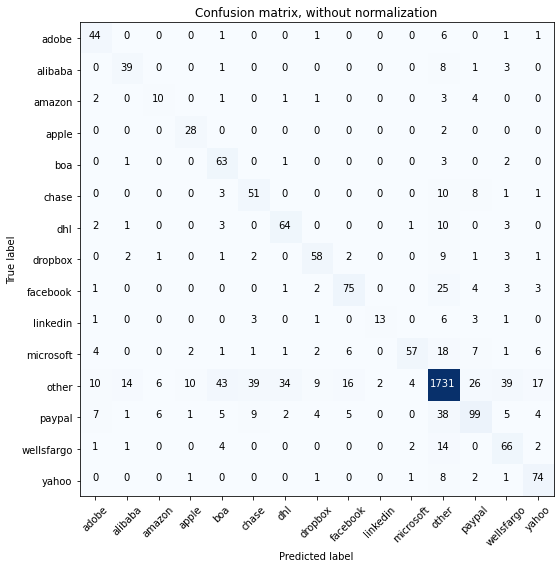

Acc     =  0.803
Pre     =  0.823
Rec     =  0.803
F1      =  0.807

Bal_Acc =  0.711
Bal_Pre =  0.661
Bal_Rec =  0.711
Bal_F1  =  0.685

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        54
     alibaba       0.66      0.75      0.70        52
      amazon       0.43      0.45      0.44        22
       apple       0.67      0.93      0.78        30
         boa       0.50      0.90      0.64        70
       chase       0.49      0.69      0.57        74
         dhl       0.62      0.76      0.68        84
     dropbox       0.73      0.72      0.73        80
    facebook       0.72      0.66      0.69       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.88      0.54      0.67       106
       other       0.92      0.87      0.89      2000
      paypal       0.64      0.53      0.58       186
  wellsfargo       0.51      0.73      0.60        90
       yahoo       0.68      0.84      0.75        

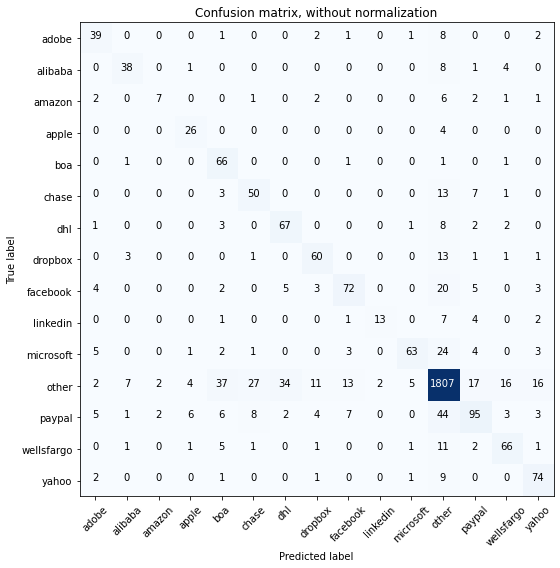

Acc     =  0.826
Pre     =  0.834
Rec     =  0.826
F1      =  0.825

Bal_Acc =  0.699
Bal_Pre =  0.705
Bal_Rec =  0.699
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.65      0.72      0.68        54
     alibaba       0.75      0.73      0.74        52
      amazon       0.64      0.32      0.42        22
       apple       0.67      0.87      0.75        30
         boa       0.52      0.94      0.67        70
       chase       0.56      0.68      0.61        74
         dhl       0.62      0.80      0.70        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.73      0.63      0.68       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.88      0.59      0.71       106
       other       0.91      0.90      0.91      2000
      paypal       0.68      0.51      0.58       186
  wellsfargo       0.69      0.73      0.71        90
       yahoo       0.70      0.84      0.76        

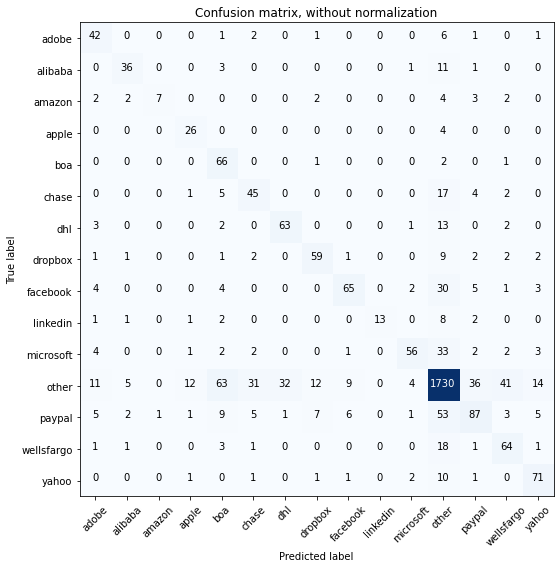

Acc     =  0.789
Pre     =  0.809
Rec     =  0.789
F1      =  0.791

Bal_Acc =  0.674
Bal_Pre =  0.695
Bal_Rec =  0.674
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.57      0.78      0.66        54
     alibaba       0.75      0.69      0.72        52
      amazon       0.88      0.32      0.47        22
       apple       0.60      0.87      0.71        30
         boa       0.41      0.94      0.57        70
       chase       0.51      0.61      0.55        74
         dhl       0.66      0.75      0.70        84
     dropbox       0.71      0.74      0.72        80
    facebook       0.78      0.57      0.66       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.84      0.53      0.65       106
       other       0.89      0.86      0.88      2000
      paypal       0.60      0.47      0.53       186
  wellsfargo       0.53      0.71      0.61        90
       yahoo       0.71      0.81      0.76        

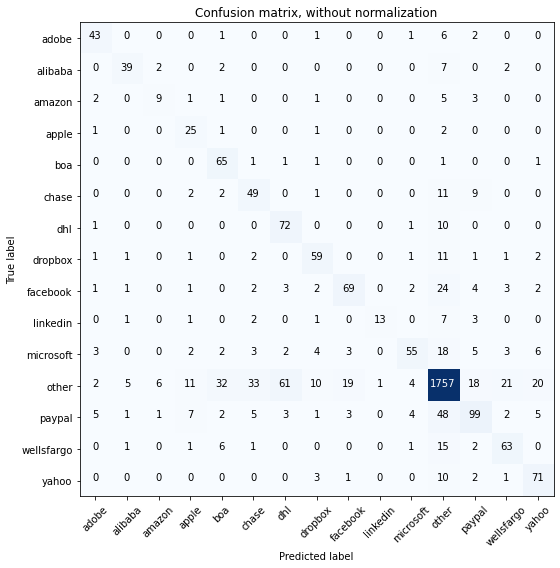

Acc     =  0.808
Pre     =  0.824
Rec     =  0.808
F1      =  0.81

Bal_Acc =  0.699
Bal_Pre =  0.675
Bal_Rec =  0.699
Bal_F1  =  0.687

              precision    recall  f1-score   support

       adobe       0.73      0.80      0.76        54
     alibaba       0.80      0.75      0.77        52
      amazon       0.50      0.41      0.45        22
       apple       0.48      0.83      0.61        30
         boa       0.57      0.93      0.71        70
       chase       0.50      0.66      0.57        74
         dhl       0.51      0.86      0.64        84
     dropbox       0.69      0.74      0.72        80
    facebook       0.73      0.61      0.66       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.80      0.52      0.63       106
       other       0.91      0.88      0.89      2000
      paypal       0.67      0.53      0.59       186
  wellsfargo       0.66      0.70      0.68        90
       yahoo       0.66      0.81      0.73        8

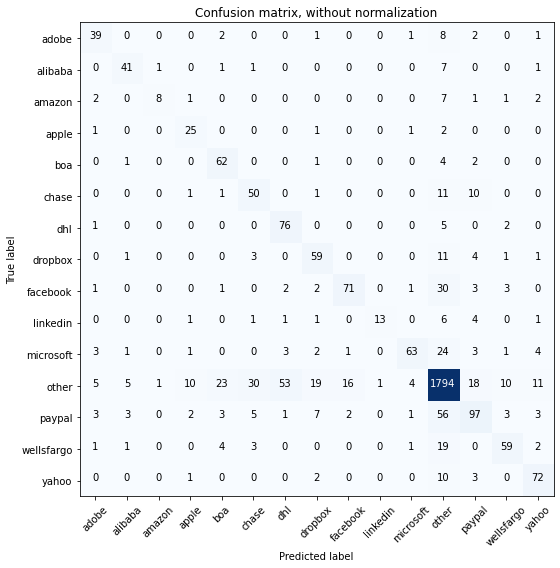

Acc     =  0.822
Pre     =  0.83
Rec     =  0.822
F1      =  0.821

Bal_Acc =  0.699
Bal_Pre =  0.723
Bal_Rec =  0.699
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.70      0.72      0.71        54
     alibaba       0.77      0.79      0.78        52
      amazon       0.80      0.36      0.50        22
       apple       0.60      0.83      0.69        30
         boa       0.64      0.89      0.74        70
       chase       0.54      0.68      0.60        74
         dhl       0.56      0.90      0.69        84
     dropbox       0.61      0.74      0.67        80
    facebook       0.79      0.62      0.70       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.88      0.59      0.71       106
       other       0.90      0.90      0.90      2000
      paypal       0.66      0.52      0.58       186
  wellsfargo       0.74      0.66      0.69        90
       yahoo       0.73      0.82      0.77        8

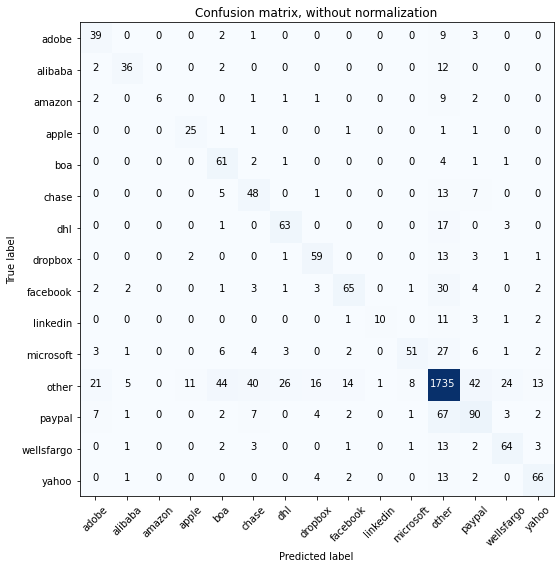

Acc     =  0.786
Pre     =  0.8
Rec     =  0.786
F1      =  0.786

Bal_Acc =  0.65
Bal_Pre =  0.697
Bal_Rec =  0.65
Bal_F1  =  0.673

              precision    recall  f1-score   support

       adobe       0.51      0.72      0.60        54
     alibaba       0.77      0.69      0.73        52
      amazon       1.00      0.27      0.43        22
       apple       0.66      0.83      0.74        30
         boa       0.48      0.87      0.62        70
       chase       0.44      0.65      0.52        74
         dhl       0.66      0.75      0.70        84
     dropbox       0.67      0.74      0.70        80
    facebook       0.74      0.57      0.64       114
    linkedin       0.91      0.36      0.51        28
   microsoft       0.82      0.48      0.61       106
       other       0.88      0.87      0.87      2000
      paypal       0.54      0.48      0.51       186
  wellsfargo       0.65      0.71      0.68        90
       yahoo       0.73      0.75      0.74        88



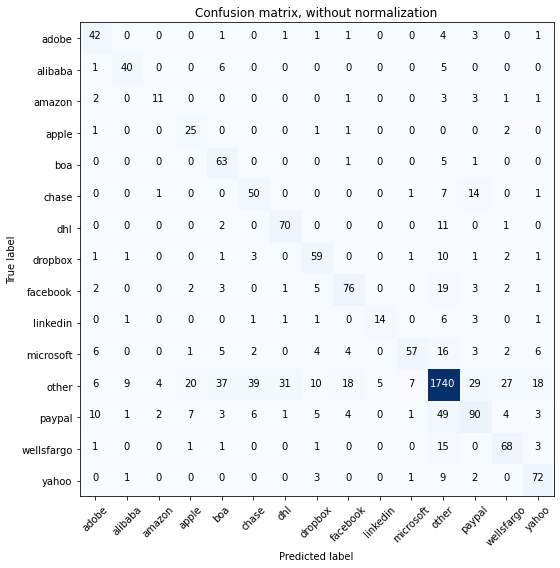

Acc     =  0.805
Pre     =  0.821
Rec     =  0.805
F1      =  0.808

Bal_Acc =  0.711
Bal_Pre =  0.655
Bal_Rec =  0.711
Bal_F1  =  0.682

              precision    recall  f1-score   support

       adobe       0.58      0.78      0.67        54
     alibaba       0.75      0.77      0.76        52
      amazon       0.61      0.50      0.55        22
       apple       0.45      0.83      0.58        30
         boa       0.52      0.90      0.66        70
       chase       0.50      0.68      0.57        74
         dhl       0.67      0.83      0.74        84
     dropbox       0.66      0.74      0.69        80
    facebook       0.72      0.67      0.69       114
    linkedin       0.74      0.50      0.60        28
   microsoft       0.84      0.54      0.66       106
       other       0.92      0.87      0.89      2000
      paypal       0.59      0.48      0.53       186
  wellsfargo       0.62      0.76      0.68        90
       yahoo       0.67      0.82      0.73        

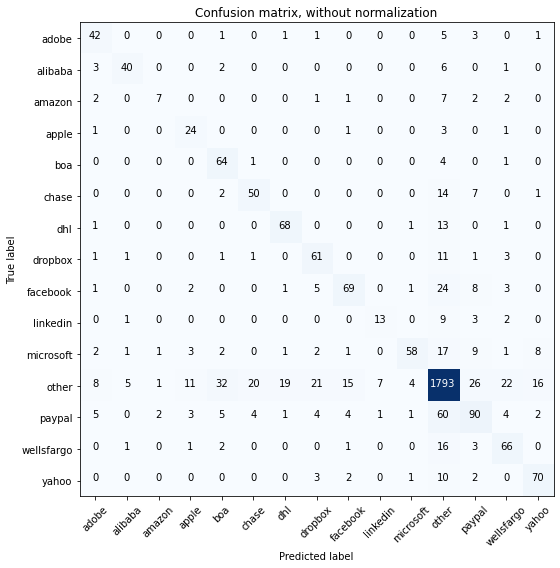

Acc     =  0.817
Pre     =  0.822
Rec     =  0.817
F1      =  0.816

Bal_Acc =  0.69
Bal_Pre =  0.686
Bal_Rec =  0.69
Bal_F1  =  0.688

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        54
     alibaba       0.82      0.77      0.79        52
      amazon       0.64      0.32      0.42        22
       apple       0.55      0.80      0.65        30
         boa       0.58      0.91      0.71        70
       chase       0.66      0.68      0.67        74
         dhl       0.75      0.81      0.78        84
     dropbox       0.62      0.76      0.69        80
    facebook       0.73      0.61      0.66       114
    linkedin       0.62      0.46      0.53        28
   microsoft       0.88      0.55      0.67       106
       other       0.90      0.90      0.90      2000
      paypal       0.58      0.48      0.53       186
  wellsfargo       0.62      0.73      0.67        90
       yahoo       0.71      0.80      0.75        88

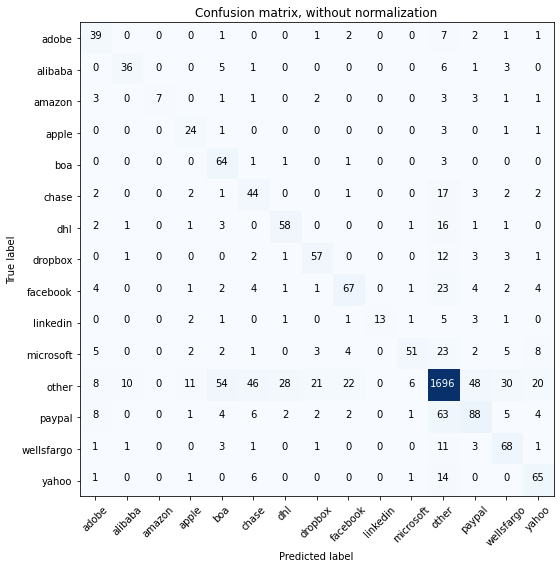

Acc     =  0.772
Pre     =  0.796
Rec     =  0.772
F1      =  0.776

Bal_Acc =  0.653
Bal_Pre =  0.667
Bal_Rec =  0.653
Bal_F1  =  0.66

              precision    recall  f1-score   support

       adobe       0.53      0.72      0.61        54
     alibaba       0.73      0.69      0.71        52
      amazon       1.00      0.32      0.48        22
       apple       0.53      0.80      0.64        30
         boa       0.45      0.91      0.60        70
       chase       0.39      0.59      0.47        74
         dhl       0.63      0.69      0.66        84
     dropbox       0.65      0.71      0.68        80
    facebook       0.67      0.59      0.63       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.82      0.48      0.61       106
       other       0.89      0.85      0.87      2000
      paypal       0.55      0.47      0.51       186
  wellsfargo       0.55      0.76      0.64        90
       yahoo       0.60      0.74      0.66        8

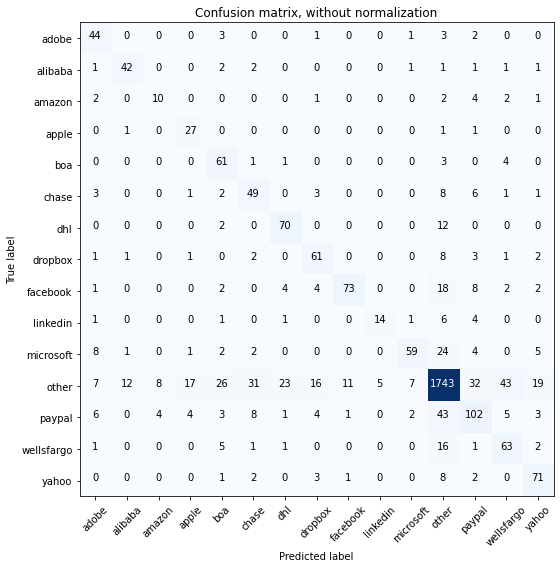

Acc     =  0.809
Pre     =  0.826
Rec     =  0.809
F1      =  0.812

Bal_Acc =  0.715
Bal_Pre =  0.655
Bal_Rec =  0.715
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.68        54
     alibaba       0.74      0.81      0.77        52
      amazon       0.45      0.45      0.45        22
       apple       0.53      0.90      0.67        30
         boa       0.55      0.87      0.68        70
       chase       0.50      0.66      0.57        74
         dhl       0.69      0.83      0.76        84
     dropbox       0.66      0.76      0.71        80
    facebook       0.85      0.64      0.73       114
    linkedin       0.74      0.50      0.60        28
   microsoft       0.83      0.56      0.67       106
       other       0.92      0.87      0.89      2000
      paypal       0.60      0.55      0.57       186
  wellsfargo       0.52      0.70      0.59        90
       yahoo       0.66      0.81      0.73        

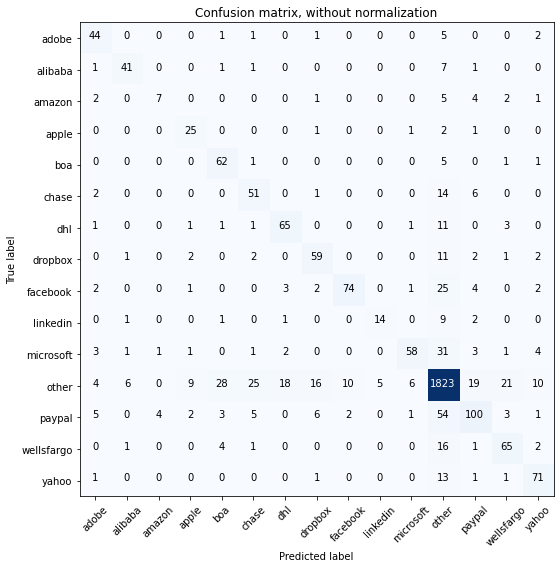

Acc     =  0.831
Pre     =  0.834
Rec     =  0.831
F1      =  0.829

Bal_Acc =  0.701
Bal_Pre =  0.714
Bal_Rec =  0.701
Bal_F1  =  0.707

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.80      0.79      0.80        52
      amazon       0.58      0.32      0.41        22
       apple       0.61      0.83      0.70        30
         boa       0.61      0.89      0.73        70
       chase       0.57      0.69      0.63        74
         dhl       0.73      0.77      0.75        84
     dropbox       0.67      0.74      0.70        80
    facebook       0.86      0.65      0.74       114
    linkedin       0.74      0.50      0.60        28
   microsoft       0.85      0.55      0.67       106
       other       0.90      0.91      0.90      2000
      paypal       0.69      0.54      0.61       186
  wellsfargo       0.66      0.72      0.69        90
       yahoo       0.74      0.81      0.77        

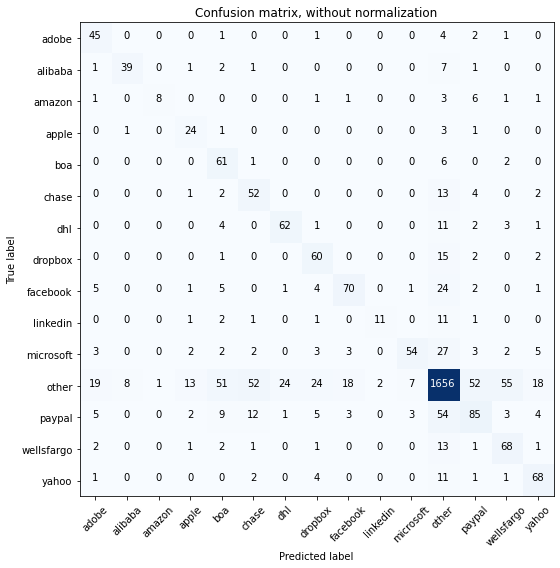

Acc     =  0.768
Pre     =  0.796
Rec     =  0.768
F1      =  0.773

Bal_Acc =  0.676
Bal_Pre =  0.659
Bal_Rec =  0.676
Bal_F1  =  0.667

              precision    recall  f1-score   support

       adobe       0.55      0.83      0.66        54
     alibaba       0.81      0.75      0.78        52
      amazon       0.89      0.36      0.52        22
       apple       0.52      0.80      0.63        30
         boa       0.43      0.87      0.57        70
       chase       0.42      0.70      0.53        74
         dhl       0.70      0.74      0.72        84
     dropbox       0.57      0.75      0.65        80
    facebook       0.74      0.61      0.67       114
    linkedin       0.85      0.39      0.54        28
   microsoft       0.83      0.51      0.63       106
       other       0.89      0.83      0.86      2000
      paypal       0.52      0.46      0.49       186
  wellsfargo       0.50      0.76      0.60        90
       yahoo       0.66      0.77      0.71        

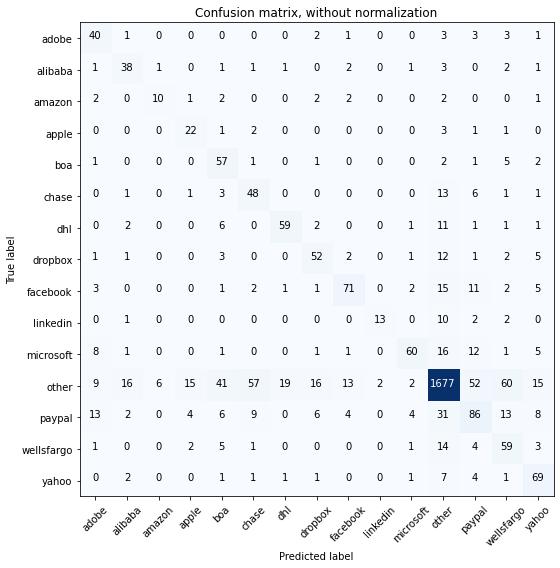

Acc     =  0.767
Pre     =  0.802
Rec     =  0.767
F1      =  0.778

Bal_Acc =  0.658
Bal_Pre =  0.61
Bal_Rec =  0.658
Bal_F1  =  0.633

              precision    recall  f1-score   support

       adobe       0.51      0.74      0.60        54
     alibaba       0.58      0.73      0.65        52
      amazon       0.59      0.45      0.51        22
       apple       0.49      0.73      0.59        30
         boa       0.45      0.81      0.58        70
       chase       0.39      0.65      0.49        74
         dhl       0.73      0.70      0.72        84
     dropbox       0.62      0.65      0.63        80
    facebook       0.74      0.62      0.68       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.82      0.57      0.67       106
       other       0.92      0.84      0.88      2000
      paypal       0.47      0.46      0.46       186
  wellsfargo       0.39      0.66      0.49        90
       yahoo       0.59      0.78      0.67        8

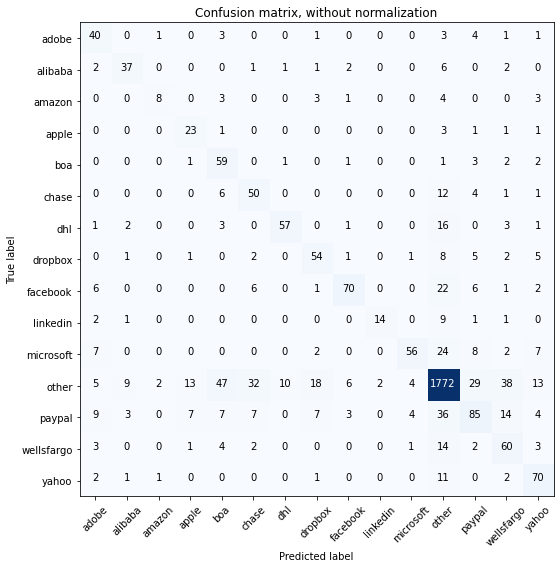

Acc     =  0.798
Pre     =  0.818
Rec     =  0.798
F1      =  0.801

Bal_Acc =  0.66
Bal_Pre =  0.658
Bal_Rec =  0.66
Bal_F1  =  0.659

              precision    recall  f1-score   support

       adobe       0.52      0.74      0.61        54
     alibaba       0.69      0.71      0.70        52
      amazon       0.67      0.36      0.47        22
       apple       0.50      0.77      0.61        30
         boa       0.44      0.84      0.58        70
       chase       0.50      0.68      0.57        74
         dhl       0.83      0.68      0.75        84
     dropbox       0.61      0.68      0.64        80
    facebook       0.82      0.61      0.70       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.53      0.65       106
       other       0.91      0.89      0.90      2000
      paypal       0.57      0.46      0.51       186
  wellsfargo       0.46      0.67      0.55        90
       yahoo       0.62      0.80      0.70        88

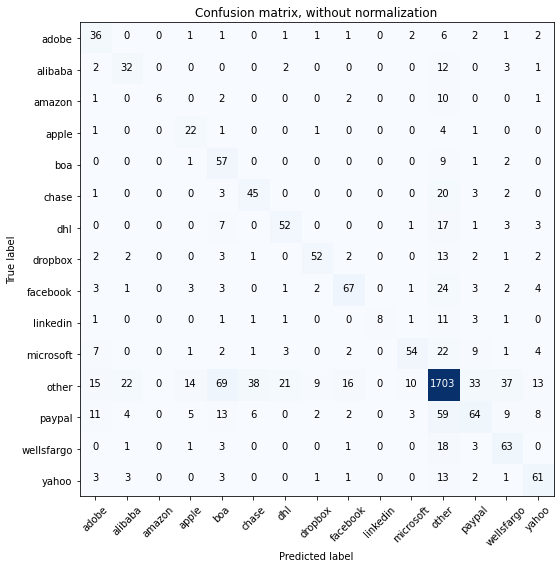

Acc     =  0.754
Pre     =  0.779
Rec     =  0.754
F1      =  0.757

Bal_Acc =  0.597
Bal_Pre =  0.639
Bal_Rec =  0.597
Bal_F1  =  0.617

              precision    recall  f1-score   support

       adobe       0.43      0.67      0.53        54
     alibaba       0.49      0.62      0.55        52
      amazon       1.00      0.27      0.43        22
       apple       0.46      0.73      0.56        30
         boa       0.34      0.81      0.48        70
       chase       0.49      0.61      0.54        74
         dhl       0.64      0.62      0.63        84
     dropbox       0.76      0.65      0.70        80
    facebook       0.71      0.59      0.64       114
    linkedin       1.00      0.29      0.44        28
   microsoft       0.75      0.51      0.61       106
       other       0.88      0.85      0.86      2000
      paypal       0.50      0.34      0.41       186
  wellsfargo       0.50      0.70      0.58        90
       yahoo       0.62      0.69      0.65        

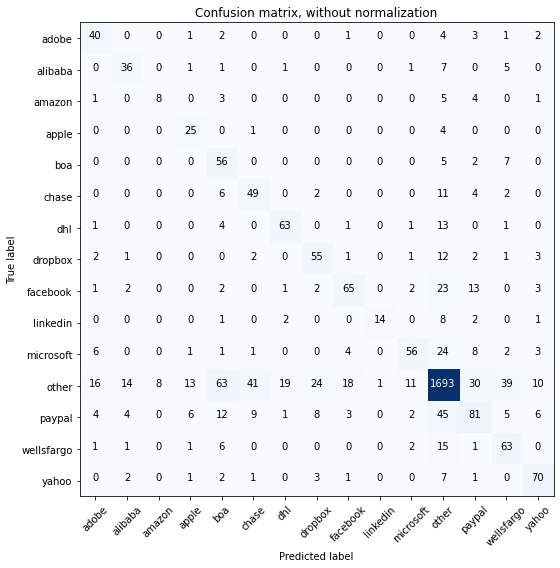

Acc     =  0.771
Pre     =  0.796
Rec     =  0.771
F1      =  0.777

Bal_Acc =  0.66
Bal_Pre =  0.62
Bal_Rec =  0.66
Bal_F1  =  0.639

              precision    recall  f1-score   support

       adobe       0.56      0.74      0.63        54
     alibaba       0.60      0.69      0.64        52
      amazon       0.50      0.36      0.42        22
       apple       0.51      0.83      0.63        30
         boa       0.35      0.80      0.49        70
       chase       0.47      0.66      0.55        74
         dhl       0.72      0.75      0.74        84
     dropbox       0.59      0.69      0.63        80
    facebook       0.69      0.57      0.62       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.74      0.53      0.62       106
       other       0.90      0.85      0.87      2000
      paypal       0.54      0.44      0.48       186
  wellsfargo       0.50      0.70      0.58        90
       yahoo       0.71      0.80      0.75        88


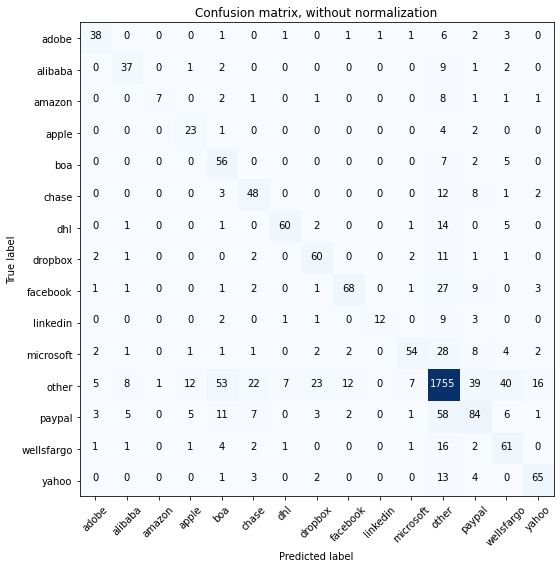

Acc     =  0.789
Pre     =  0.805
Rec     =  0.789
F1      =  0.791

Bal_Acc =  0.646
Bal_Pre =  0.69
Bal_Rec =  0.646
Bal_F1  =  0.667

              precision    recall  f1-score   support

       adobe       0.73      0.70      0.72        54
     alibaba       0.67      0.71      0.69        52
      amazon       0.88      0.32      0.47        22
       apple       0.53      0.77      0.63        30
         boa       0.40      0.80      0.54        70
       chase       0.55      0.65      0.59        74
         dhl       0.86      0.71      0.78        84
     dropbox       0.63      0.75      0.69        80
    facebook       0.80      0.60      0.68       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.79      0.51      0.62       106
       other       0.89      0.88      0.88      2000
      paypal       0.51      0.45      0.48       186
  wellsfargo       0.47      0.68      0.56        90
       yahoo       0.72      0.74      0.73        8

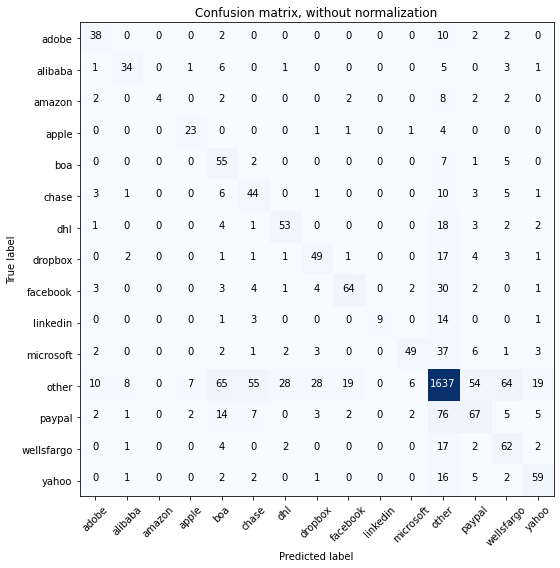

Acc     =  0.73
Pre     =  0.762
Rec     =  0.73
F1      =  0.736

Bal_Acc =  0.588
Bal_Pre =  0.648
Bal_Rec =  0.588
Bal_F1  =  0.617

              precision    recall  f1-score   support

       adobe       0.61      0.70      0.66        54
     alibaba       0.71      0.65      0.68        52
      amazon       1.00      0.18      0.31        22
       apple       0.70      0.77      0.73        30
         boa       0.33      0.79      0.46        70
       chase       0.37      0.59      0.45        74
         dhl       0.60      0.63      0.62        84
     dropbox       0.54      0.61      0.58        80
    facebook       0.72      0.56      0.63       114
    linkedin       1.00      0.32      0.49        28
   microsoft       0.82      0.46      0.59       106
       other       0.86      0.82      0.84      2000
      paypal       0.44      0.36      0.40       186
  wellsfargo       0.40      0.69      0.50        90
       yahoo       0.62      0.67      0.64        88

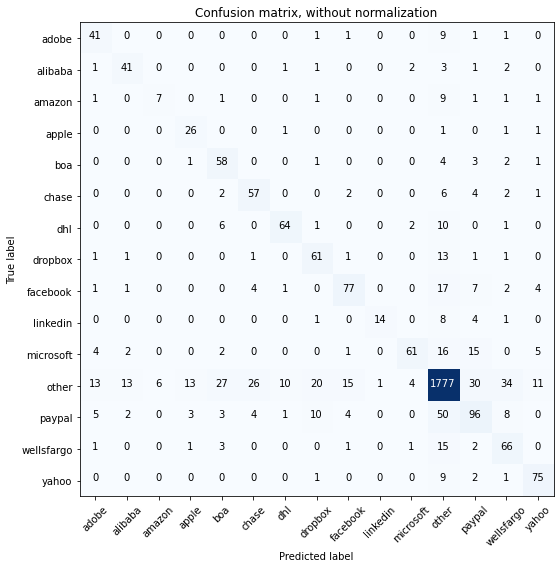

Acc     =  0.819
Pre     =  0.83
Rec     =  0.819
F1      =  0.82

Bal_Acc =  0.706
Bal_Pre =  0.693
Bal_Rec =  0.706
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.60      0.76      0.67        54
     alibaba       0.68      0.79      0.73        52
      amazon       0.54      0.32      0.40        22
       apple       0.59      0.87      0.70        30
         boa       0.57      0.83      0.67        70
       chase       0.62      0.77      0.69        74
         dhl       0.82      0.76      0.79        84
     dropbox       0.62      0.76      0.69        80
    facebook       0.75      0.68      0.71       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.87      0.58      0.69       106
       other       0.91      0.89      0.90      2000
      paypal       0.57      0.52      0.54       186
  wellsfargo       0.54      0.73      0.62        90
       yahoo       0.76      0.85      0.80        88

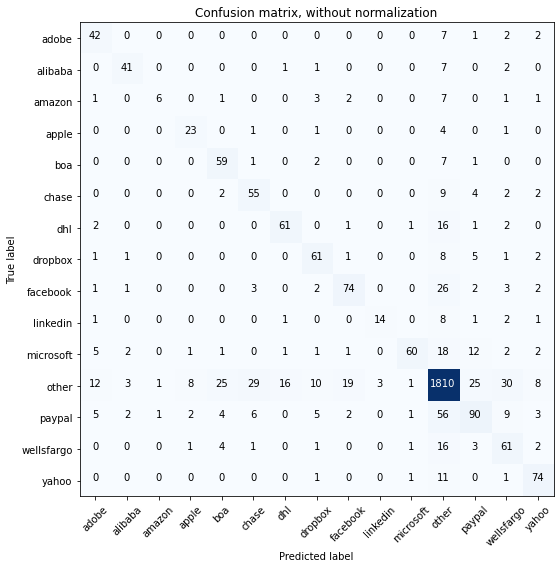

Acc     =  0.822
Pre     =  0.828
Rec     =  0.822
F1      =  0.821

Bal_Acc =  0.687
Bal_Pre =  0.716
Bal_Rec =  0.687
Bal_F1  =  0.701

              precision    recall  f1-score   support

       adobe       0.60      0.78      0.68        54
     alibaba       0.82      0.79      0.80        52
      amazon       0.75      0.27      0.40        22
       apple       0.66      0.77      0.71        30
         boa       0.61      0.84      0.71        70
       chase       0.57      0.74      0.65        74
         dhl       0.76      0.73      0.74        84
     dropbox       0.69      0.76      0.73        80
    facebook       0.74      0.65      0.69       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.92      0.57      0.70       106
       other       0.90      0.91      0.90      2000
      paypal       0.62      0.48      0.54       186
  wellsfargo       0.51      0.68      0.58        90
       yahoo       0.75      0.84      0.79        

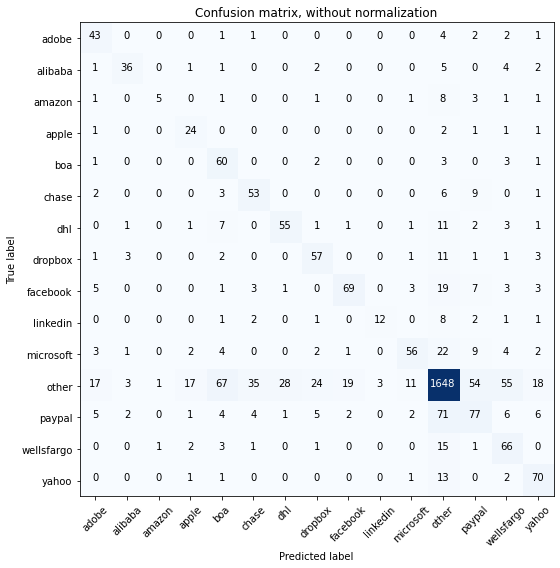

Acc     =  0.757
Pre     =  0.786
Rec     =  0.757
F1      =  0.764

Bal_Acc =  0.652
Bal_Pre =  0.626
Bal_Rec =  0.652
Bal_F1  =  0.639

              precision    recall  f1-score   support

       adobe       0.54      0.80      0.64        54
     alibaba       0.78      0.69      0.73        52
      amazon       0.71      0.23      0.34        22
       apple       0.49      0.80      0.61        30
         boa       0.38      0.86      0.53        70
       chase       0.54      0.72      0.61        74
         dhl       0.65      0.65      0.65        84
     dropbox       0.59      0.71      0.65        80
    facebook       0.75      0.61      0.67       114
    linkedin       0.80      0.43      0.56        28
   microsoft       0.74      0.53      0.62       106
       other       0.89      0.82      0.86      2000
      paypal       0.46      0.41      0.44       186
  wellsfargo       0.43      0.73      0.55        90
       yahoo       0.63      0.80      0.70        

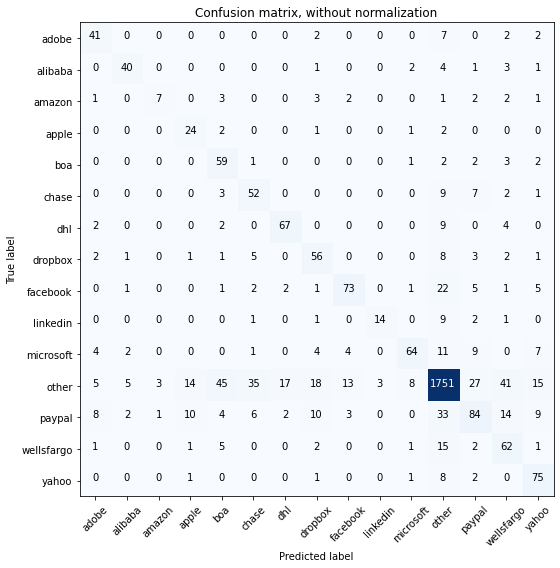

Acc     =  0.802
Pre     =  0.823
Rec     =  0.802
F1      =  0.807

Bal_Acc =  0.687
Bal_Pre =  0.654
Bal_Rec =  0.687
Bal_F1  =  0.67

              precision    recall  f1-score   support

       adobe       0.64      0.76      0.69        54
     alibaba       0.78      0.77      0.78        52
      amazon       0.64      0.32      0.42        22
       apple       0.47      0.80      0.59        30
         boa       0.47      0.84      0.61        70
       chase       0.50      0.70      0.59        74
         dhl       0.76      0.80      0.78        84
     dropbox       0.56      0.70      0.62        80
    facebook       0.77      0.64      0.70       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.81      0.60      0.69       106
       other       0.93      0.88      0.90      2000
      paypal       0.58      0.45      0.51       186
  wellsfargo       0.45      0.69      0.55        90
       yahoo       0.62      0.85      0.72        8

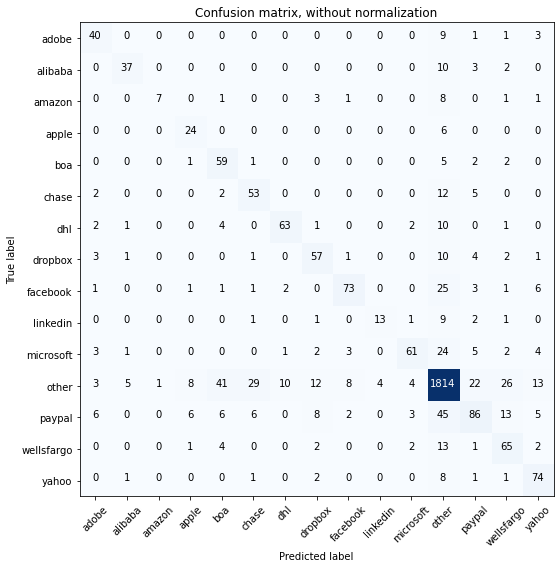

Acc     =  0.821
Pre     =  0.829
Rec     =  0.821
F1      =  0.819

Bal_Acc =  0.68
Bal_Pre =  0.712
Bal_Rec =  0.68
Bal_F1  =  0.696

              precision    recall  f1-score   support

       adobe       0.67      0.74      0.70        54
     alibaba       0.80      0.71      0.76        52
      amazon       0.88      0.32      0.47        22
       apple       0.59      0.80      0.68        30
         boa       0.50      0.84      0.63        70
       chase       0.57      0.72      0.63        74
         dhl       0.83      0.75      0.79        84
     dropbox       0.65      0.71      0.68        80
    facebook       0.83      0.64      0.72       114
    linkedin       0.76      0.46      0.58        28
   microsoft       0.84      0.58      0.68       106
       other       0.90      0.91      0.91      2000
      paypal       0.64      0.46      0.54       186
  wellsfargo       0.55      0.72      0.62        90
       yahoo       0.68      0.84      0.75        88

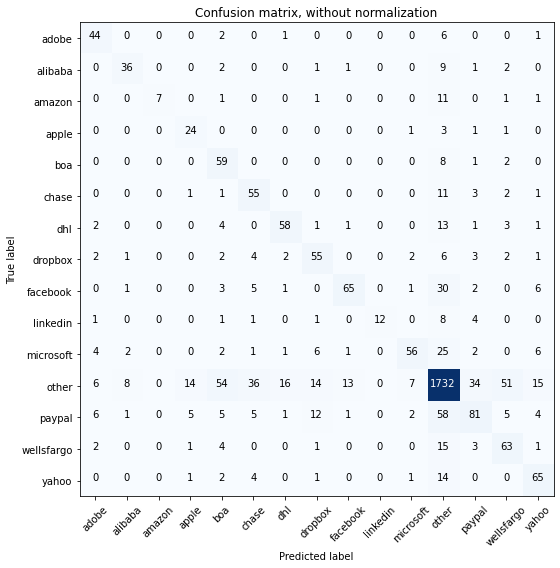

Acc     =  0.784
Pre     =  0.804
Rec     =  0.784
F1      =  0.786

Bal_Acc =  0.657
Bal_Pre =  0.689
Bal_Rec =  0.657
Bal_F1  =  0.673

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.73      0.69      0.71        52
      amazon       1.00      0.32      0.48        22
       apple       0.52      0.80      0.63        30
         boa       0.42      0.84      0.56        70
       chase       0.50      0.74      0.59        74
         dhl       0.72      0.69      0.71        84
     dropbox       0.59      0.69      0.64        80
    facebook       0.79      0.57      0.66       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.80      0.53      0.64       106
       other       0.89      0.87      0.88      2000
      paypal       0.60      0.44      0.50       186
  wellsfargo       0.48      0.70      0.57        90
       yahoo       0.64      0.74      0.68        

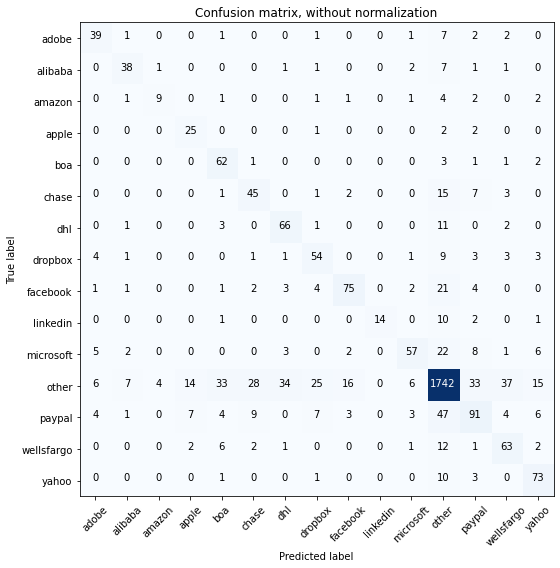

Acc     =  0.797
Pre     =  0.811
Rec     =  0.797
F1      =  0.799

Bal_Acc =  0.682
Bal_Pre =  0.664
Bal_Rec =  0.682
Bal_F1  =  0.673

              precision    recall  f1-score   support

       adobe       0.66      0.72      0.69        54
     alibaba       0.72      0.73      0.72        52
      amazon       0.64      0.41      0.50        22
       apple       0.52      0.83      0.64        30
         boa       0.54      0.89      0.67        70
       chase       0.51      0.61      0.56        74
         dhl       0.61      0.79      0.68        84
     dropbox       0.56      0.68      0.61        80
    facebook       0.76      0.66      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.77      0.54      0.63       106
       other       0.91      0.87      0.89      2000
      paypal       0.57      0.49      0.53       186
  wellsfargo       0.54      0.70      0.61        90
       yahoo       0.66      0.83      0.74        

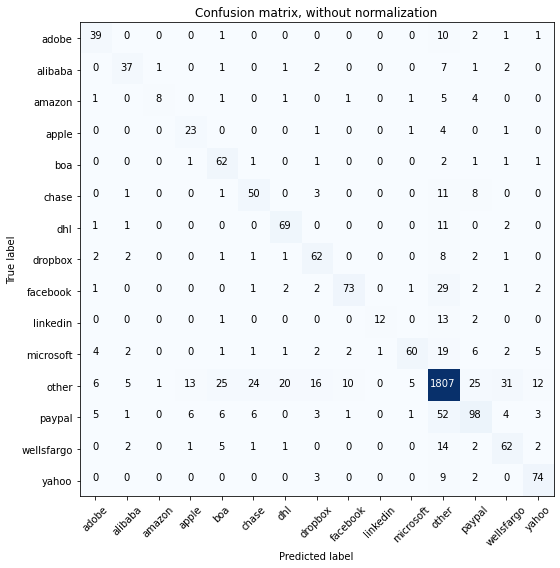

Acc     =  0.824
Pre     =  0.831
Rec     =  0.824
F1      =  0.823

Bal_Acc =  0.688
Bal_Pre =  0.716
Bal_Rec =  0.688
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.66      0.72      0.69        54
     alibaba       0.73      0.71      0.72        52
      amazon       0.80      0.36      0.50        22
       apple       0.52      0.77      0.62        30
         boa       0.59      0.89      0.71        70
       chase       0.59      0.68      0.63        74
         dhl       0.72      0.82      0.77        84
     dropbox       0.65      0.78      0.71        80
    facebook       0.84      0.64      0.73       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.87      0.57      0.69       106
       other       0.90      0.90      0.90      2000
      paypal       0.63      0.53      0.57       186
  wellsfargo       0.57      0.69      0.63        90
       yahoo       0.74      0.84      0.79        

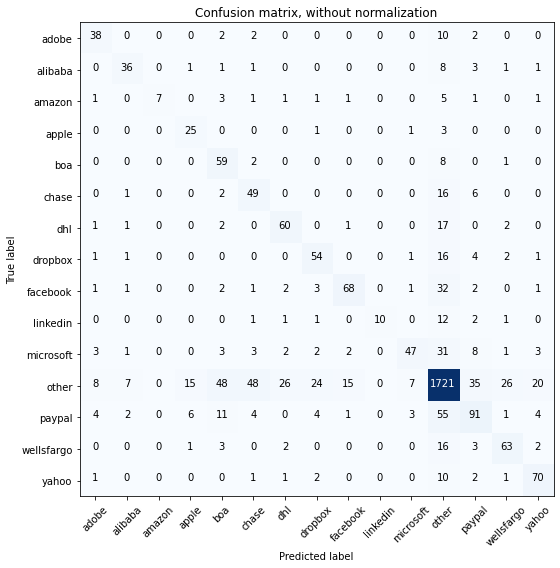

Acc     =  0.779
Pre     =  0.797
Rec     =  0.779
F1      =  0.78

Bal_Acc =  0.646
Bal_Pre =  0.687
Bal_Rec =  0.646
Bal_F1  =  0.666

              precision    recall  f1-score   support

       adobe       0.66      0.70      0.68        54
     alibaba       0.72      0.69      0.71        52
      amazon       1.00      0.32      0.48        22
       apple       0.52      0.83      0.64        30
         boa       0.43      0.84      0.57        70
       chase       0.43      0.66      0.52        74
         dhl       0.63      0.71      0.67        84
     dropbox       0.59      0.68      0.63        80
    facebook       0.77      0.60      0.67       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.78      0.44      0.57       106
       other       0.88      0.86      0.87      2000
      paypal       0.57      0.49      0.53       186
  wellsfargo       0.64      0.70      0.67        90
       yahoo       0.68      0.80      0.73        8

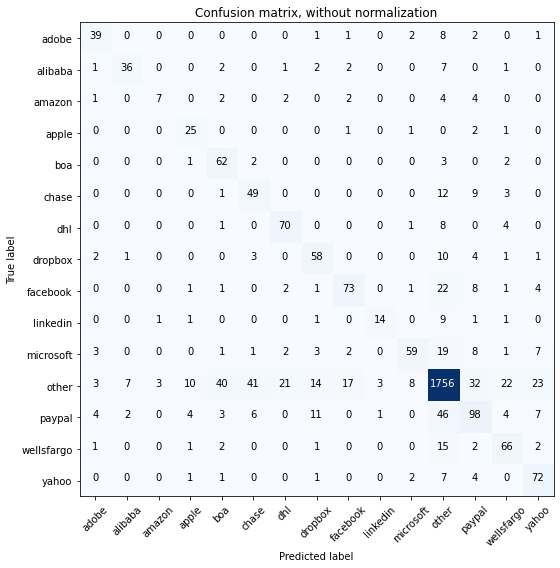

Acc     =  0.807
Pre     =  0.82
Rec     =  0.807
F1      =  0.809

Bal_Acc =  0.688
Bal_Pre =  0.673
Bal_Rec =  0.688
Bal_F1  =  0.68

              precision    recall  f1-score   support

       adobe       0.72      0.72      0.72        54
     alibaba       0.78      0.69      0.73        52
      amazon       0.64      0.32      0.42        22
       apple       0.57      0.83      0.68        30
         boa       0.53      0.89      0.67        70
       chase       0.48      0.66      0.56        74
         dhl       0.71      0.83      0.77        84
     dropbox       0.62      0.72      0.67        80
    facebook       0.74      0.64      0.69       114
    linkedin       0.78      0.50      0.61        28
   microsoft       0.80      0.56      0.66       106
       other       0.91      0.88      0.89      2000
      paypal       0.56      0.53      0.54       186
  wellsfargo       0.62      0.73      0.67        90
       yahoo       0.62      0.82      0.70        88

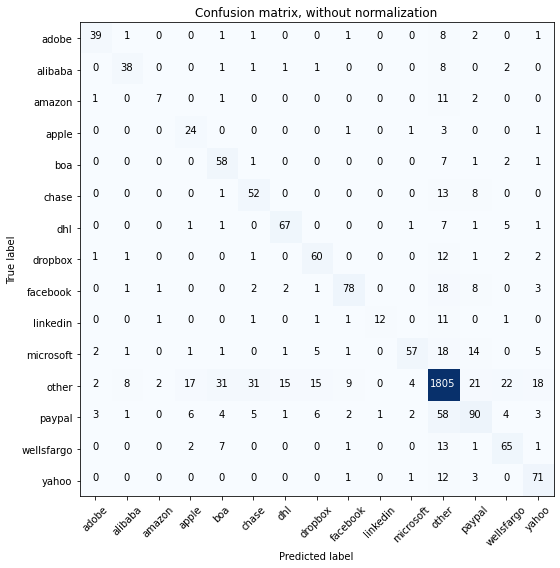

Acc     =  0.82
Pre     =  0.827
Rec     =  0.82
F1      =  0.819

Bal_Acc =  0.681
Bal_Pre =  0.707
Bal_Rec =  0.681
Bal_F1  =  0.694

              precision    recall  f1-score   support

       adobe       0.81      0.72      0.76        54
     alibaba       0.75      0.73      0.74        52
      amazon       0.64      0.32      0.42        22
       apple       0.47      0.80      0.59        30
         boa       0.55      0.83      0.66        70
       chase       0.55      0.70      0.62        74
         dhl       0.77      0.80      0.78        84
     dropbox       0.67      0.75      0.71        80
    facebook       0.82      0.68      0.75       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.86      0.54      0.66       106
       other       0.90      0.90      0.90      2000
      paypal       0.59      0.48      0.53       186
  wellsfargo       0.63      0.72      0.67        90
       yahoo       0.66      0.81      0.73        88

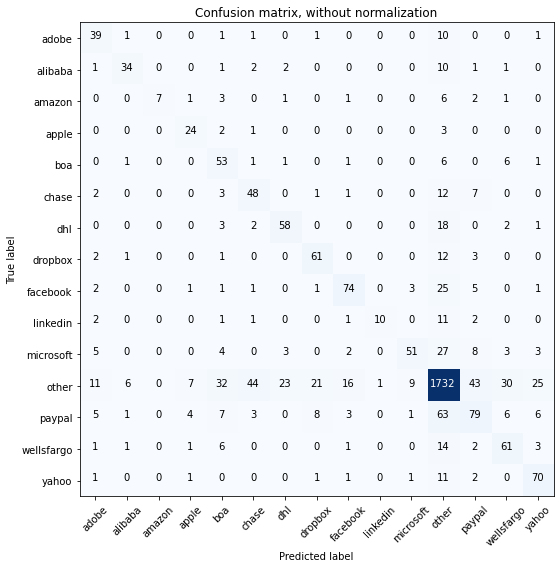

Acc     =  0.78
Pre     =  0.794
Rec     =  0.78
F1      =  0.781

Bal_Acc =  0.64
Bal_Pre =  0.676
Bal_Rec =  0.64
Bal_F1  =  0.658

              precision    recall  f1-score   support

       adobe       0.55      0.72      0.62        54
     alibaba       0.76      0.65      0.70        52
      amazon       1.00      0.32      0.48        22
       apple       0.62      0.80      0.70        30
         boa       0.45      0.76      0.56        70
       chase       0.46      0.65      0.54        74
         dhl       0.66      0.69      0.67        84
     dropbox       0.65      0.76      0.70        80
    facebook       0.73      0.65      0.69       114
    linkedin       0.91      0.36      0.51        28
   microsoft       0.78      0.48      0.60       106
       other       0.88      0.87      0.87      2000
      paypal       0.51      0.42      0.46       186
  wellsfargo       0.55      0.68      0.61        90
       yahoo       0.63      0.80      0.70        88



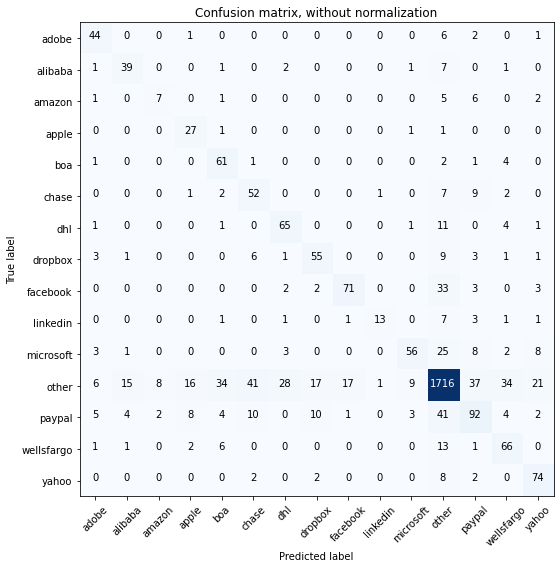

Acc     =  0.792
Pre     =  0.81
Rec     =  0.792
F1      =  0.795

Bal_Acc =  0.691
Bal_Pre =  0.64
Bal_Rec =  0.691
Bal_F1  =  0.665

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        54
     alibaba       0.64      0.75      0.69        52
      amazon       0.41      0.32      0.36        22
       apple       0.49      0.90      0.64        30
         boa       0.54      0.87      0.67        70
       chase       0.46      0.70      0.56        74
         dhl       0.64      0.77      0.70        84
     dropbox       0.64      0.69      0.66        80
    facebook       0.79      0.62      0.70       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.79      0.53      0.63       106
       other       0.91      0.86      0.88      2000
      paypal       0.55      0.49      0.52       186
  wellsfargo       0.55      0.73      0.63        90
       yahoo       0.65      0.84      0.73        88

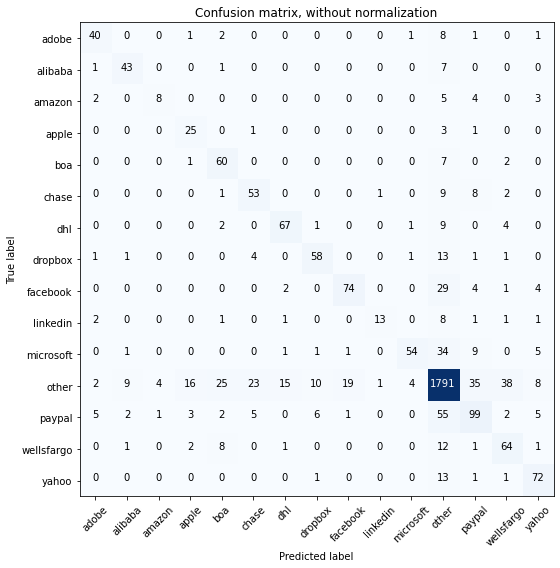

Acc     =  0.819
Pre     =  0.825
Rec     =  0.819
F1      =  0.818

Bal_Acc =  0.696
Bal_Pre =  0.711
Bal_Rec =  0.696
Bal_F1  =  0.703

              precision    recall  f1-score   support

       adobe       0.75      0.74      0.75        54
     alibaba       0.75      0.83      0.79        52
      amazon       0.62      0.36      0.46        22
       apple       0.52      0.83      0.64        30
         boa       0.59      0.86      0.70        70
       chase       0.62      0.72      0.66        74
         dhl       0.77      0.80      0.78        84
     dropbox       0.75      0.72      0.74        80
    facebook       0.78      0.65      0.71       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.89      0.51      0.65       106
       other       0.89      0.90      0.89      2000
      paypal       0.60      0.53      0.56       186
  wellsfargo       0.55      0.71      0.62        90
       yahoo       0.72      0.82      0.77        

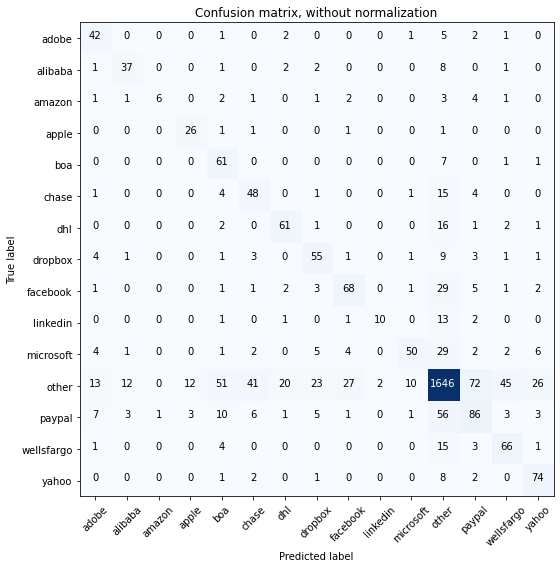

Acc     =  0.759
Pre     =  0.783
Rec     =  0.759
F1      =  0.763

Bal_Acc =  0.656
Bal_Pre =  0.642
Bal_Rec =  0.656
Bal_F1  =  0.649

              precision    recall  f1-score   support

       adobe       0.56      0.78      0.65        54
     alibaba       0.67      0.71      0.69        52
      amazon       0.86      0.27      0.41        22
       apple       0.63      0.87      0.73        30
         boa       0.43      0.87      0.58        70
       chase       0.46      0.65      0.54        74
         dhl       0.69      0.73      0.71        84
     dropbox       0.57      0.69      0.62        80
    facebook       0.65      0.60      0.62       114
    linkedin       0.83      0.36      0.50        28
   microsoft       0.77      0.47      0.58       106
       other       0.88      0.82      0.85      2000
      paypal       0.46      0.46      0.46       186
  wellsfargo       0.53      0.73      0.62        90
       yahoo       0.64      0.84      0.73        

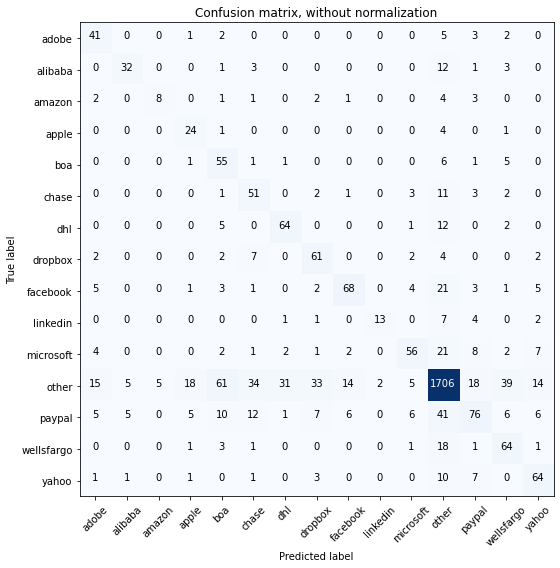

Acc     =  0.774
Pre     =  0.8
Rec     =  0.774
F1      =  0.78

Bal_Acc =  0.655
Bal_Pre =  0.623
Bal_Rec =  0.655
Bal_F1  =  0.639

              precision    recall  f1-score   support

       adobe       0.55      0.76      0.64        54
     alibaba       0.74      0.62      0.67        52
      amazon       0.62      0.36      0.46        22
       apple       0.46      0.80      0.59        30
         boa       0.37      0.79      0.51        70
       chase       0.45      0.69      0.55        74
         dhl       0.64      0.76      0.70        84
     dropbox       0.54      0.76      0.64        80
    facebook       0.74      0.60      0.66       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.72      0.53      0.61       106
       other       0.91      0.85      0.88      2000
      paypal       0.59      0.41      0.48       186
  wellsfargo       0.50      0.71      0.59        90
       yahoo       0.63      0.73      0.68        88


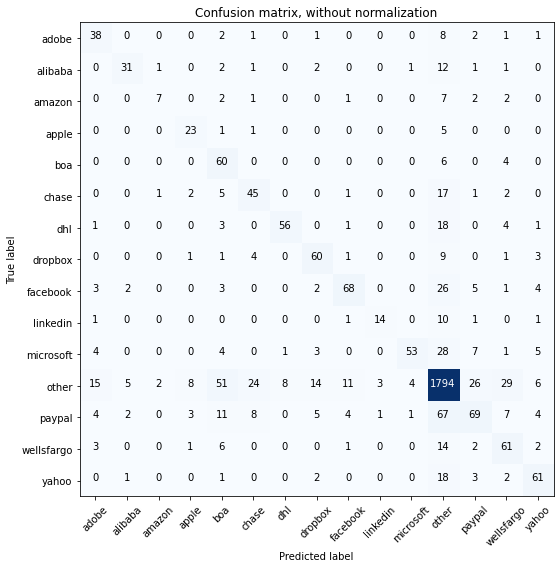

Acc     =  0.793
Pre     =  0.804
Rec     =  0.793
F1      =  0.791

Bal_Acc =  0.633
Bal_Pre =  0.675
Bal_Rec =  0.633
Bal_F1  =  0.653

              precision    recall  f1-score   support

       adobe       0.55      0.70      0.62        54
     alibaba       0.76      0.60      0.67        52
      amazon       0.64      0.32      0.42        22
       apple       0.61      0.77      0.68        30
         boa       0.39      0.86      0.54        70
       chase       0.53      0.61      0.57        74
         dhl       0.86      0.67      0.75        84
     dropbox       0.67      0.75      0.71        80
    facebook       0.76      0.60      0.67       114
    linkedin       0.78      0.50      0.61        28
   microsoft       0.90      0.50      0.64       106
       other       0.88      0.90      0.89      2000
      paypal       0.58      0.37      0.45       186
  wellsfargo       0.53      0.68      0.59        90
       yahoo       0.69      0.69      0.69        

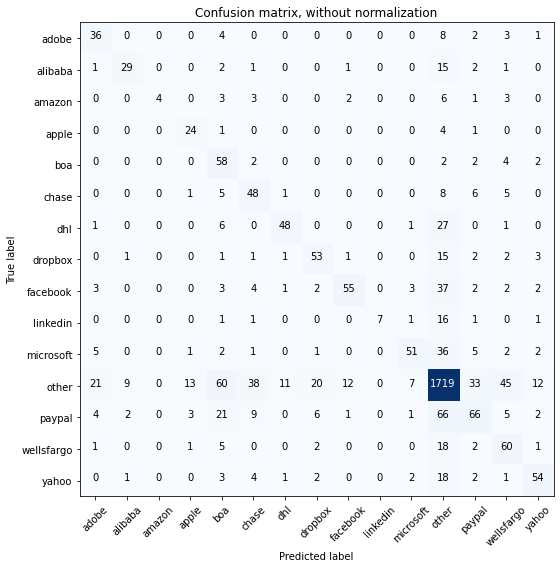

Acc     =  0.751
Pre     =  0.775
Rec     =  0.751
F1      =  0.751

Bal_Acc =  0.575
Bal_Pre =  0.662
Bal_Rec =  0.575
Bal_F1  =  0.615

              precision    recall  f1-score   support

       adobe       0.50      0.67      0.57        54
     alibaba       0.69      0.56      0.62        52
      amazon       1.00      0.18      0.31        22
       apple       0.56      0.80      0.66        30
         boa       0.33      0.83      0.47        70
       chase       0.43      0.65      0.52        74
         dhl       0.76      0.57      0.65        84
     dropbox       0.62      0.66      0.64        80
    facebook       0.76      0.48      0.59       114
    linkedin       1.00      0.25      0.40        28
   microsoft       0.77      0.48      0.59       106
       other       0.86      0.86      0.86      2000
      paypal       0.52      0.35      0.42       186
  wellsfargo       0.45      0.67      0.54        90
       yahoo       0.68      0.61      0.64        

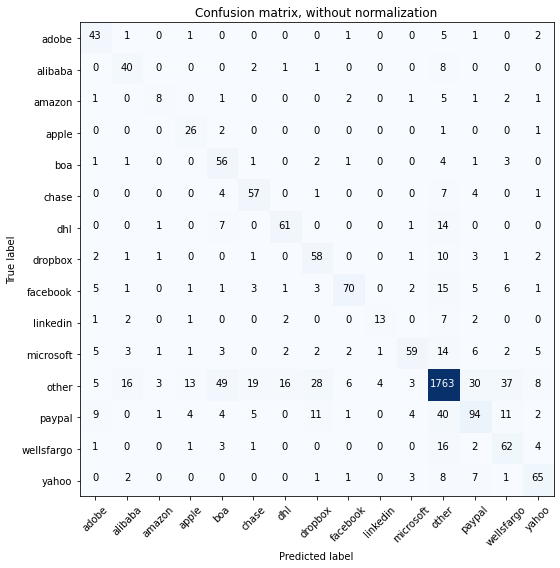

Acc     =  0.804
Pre     =  0.822
Rec     =  0.804
F1      =  0.808

Bal_Acc =  0.684
Bal_Pre =  0.646
Bal_Rec =  0.684
Bal_F1  =  0.664

              precision    recall  f1-score   support

       adobe       0.59      0.80      0.68        54
     alibaba       0.60      0.77      0.67        52
      amazon       0.53      0.36      0.43        22
       apple       0.54      0.87      0.67        30
         boa       0.43      0.80      0.56        70
       chase       0.64      0.77      0.70        74
         dhl       0.73      0.73      0.73        84
     dropbox       0.54      0.72      0.62        80
    facebook       0.83      0.61      0.71       114
    linkedin       0.72      0.46      0.57        28
   microsoft       0.80      0.56      0.66       106
       other       0.92      0.88      0.90      2000
      paypal       0.60      0.51      0.55       186
  wellsfargo       0.50      0.69      0.58        90
       yahoo       0.71      0.74      0.72        

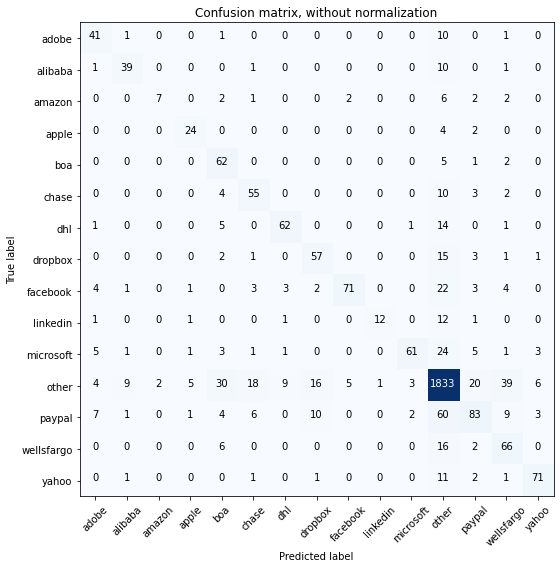

Acc     =  0.827
Pre     =  0.835
Rec     =  0.827
F1      =  0.824

Bal_Acc =  0.682
Bal_Pre =  0.744
Bal_Rec =  0.682
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.64      0.76      0.69        54
     alibaba       0.74      0.75      0.74        52
      amazon       0.78      0.32      0.45        22
       apple       0.73      0.80      0.76        30
         boa       0.52      0.89      0.66        70
       chase       0.63      0.74      0.68        74
         dhl       0.82      0.74      0.78        84
     dropbox       0.66      0.71      0.69        80
    facebook       0.91      0.62      0.74       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.91      0.58      0.71       106
       other       0.89      0.92      0.90      2000
      paypal       0.65      0.45      0.53       186
  wellsfargo       0.51      0.73      0.60        90
       yahoo       0.85      0.81      0.83        

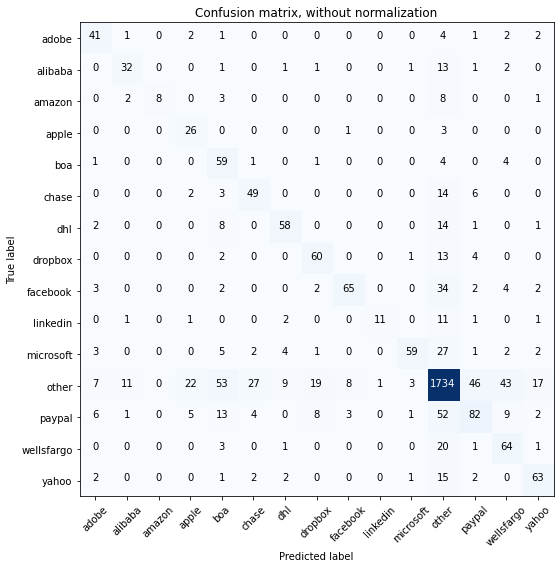

Acc     =  0.783
Pre     =  0.805
Rec     =  0.783
F1      =  0.786

Bal_Acc =  0.654
Bal_Pre =  0.692
Bal_Rec =  0.654
Bal_F1  =  0.672

              precision    recall  f1-score   support

       adobe       0.63      0.76      0.69        54
     alibaba       0.67      0.62      0.64        52
      amazon       1.00      0.36      0.53        22
       apple       0.45      0.87      0.59        30
         boa       0.38      0.84      0.53        70
       chase       0.58      0.66      0.62        74
         dhl       0.75      0.69      0.72        84
     dropbox       0.65      0.75      0.70        80
    facebook       0.84      0.57      0.68       114
    linkedin       0.92      0.39      0.55        28
   microsoft       0.89      0.56      0.69       106
       other       0.88      0.87      0.87      2000
      paypal       0.55      0.44      0.49       186
  wellsfargo       0.49      0.71      0.58        90
       yahoo       0.68      0.72      0.70        

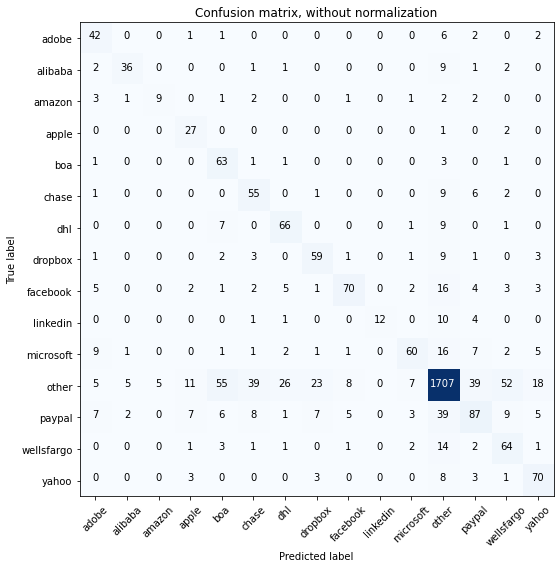

Acc     =  0.788
Pre     =  0.816
Rec     =  0.788
F1      =  0.795

Bal_Acc =  0.692
Bal_Pre =  0.658
Bal_Rec =  0.692
Bal_F1  =  0.675

              precision    recall  f1-score   support

       adobe       0.55      0.78      0.65        54
     alibaba       0.80      0.69      0.74        52
      amazon       0.64      0.41      0.50        22
       apple       0.52      0.90      0.66        30
         boa       0.45      0.90      0.60        70
       chase       0.48      0.74      0.59        74
         dhl       0.63      0.79      0.70        84
     dropbox       0.62      0.74      0.67        80
    facebook       0.80      0.61      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.78      0.57      0.66       106
       other       0.92      0.85      0.88      2000
      paypal       0.55      0.47      0.51       186
  wellsfargo       0.46      0.71      0.56        90
       yahoo       0.65      0.80      0.72        

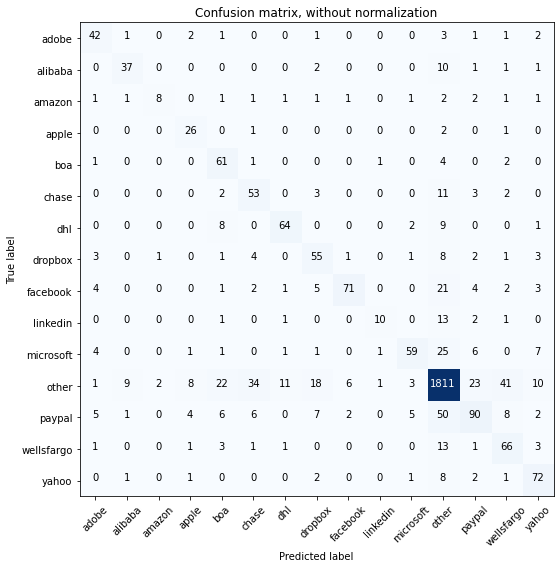

Acc     =  0.82
Pre     =  0.831
Rec     =  0.82
F1      =  0.82

Bal_Acc =  0.682
Bal_Pre =  0.696
Bal_Rec =  0.682
Bal_F1  =  0.689

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.74      0.71      0.73        52
      amazon       0.73      0.36      0.48        22
       apple       0.60      0.87      0.71        30
         boa       0.56      0.87      0.69        70
       chase       0.51      0.72      0.60        74
         dhl       0.80      0.76      0.78        84
     dropbox       0.58      0.69      0.63        80
    facebook       0.88      0.62      0.73       114
    linkedin       0.77      0.36      0.49        28
   microsoft       0.82      0.56      0.66       106
       other       0.91      0.91      0.91      2000
      paypal       0.66      0.48      0.56       186
  wellsfargo       0.52      0.73      0.61        90
       yahoo       0.69      0.82      0.75        88


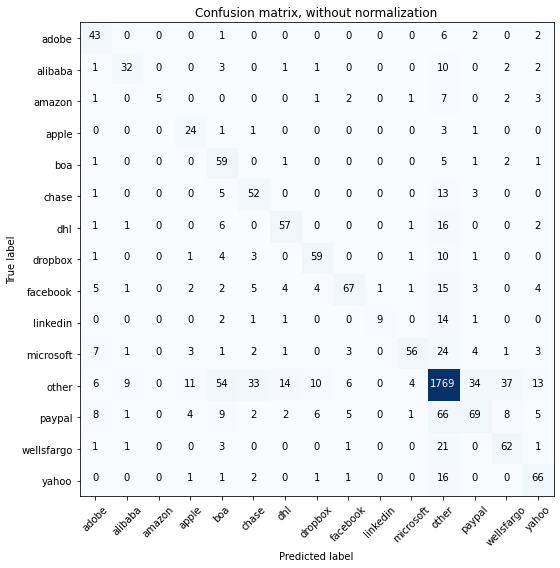

Acc     =  0.789
Pre     =  0.806
Rec     =  0.789
F1      =  0.788

Bal_Acc =  0.635
Bal_Pre =  0.688
Bal_Rec =  0.635
Bal_F1  =  0.66

              precision    recall  f1-score   support

       adobe       0.57      0.80      0.66        54
     alibaba       0.70      0.62      0.65        52
      amazon       1.00      0.23      0.37        22
       apple       0.52      0.80      0.63        30
         boa       0.39      0.84      0.53        70
       chase       0.51      0.70      0.59        74
         dhl       0.70      0.68      0.69        84
     dropbox       0.72      0.74      0.73        80
    facebook       0.79      0.59      0.67       114
    linkedin       0.90      0.32      0.47        28
   microsoft       0.86      0.53      0.65       106
       other       0.89      0.88      0.89      2000
      paypal       0.58      0.37      0.45       186
  wellsfargo       0.54      0.69      0.61        90
       yahoo       0.65      0.75      0.69        8

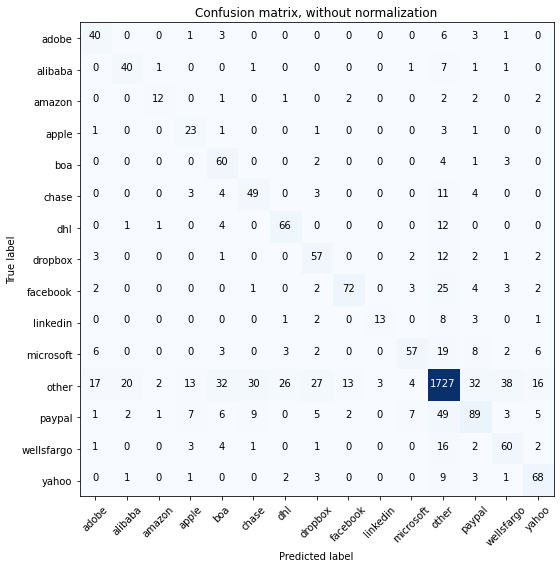

Acc     =  0.79
Pre     =  0.807
Rec     =  0.79
F1      =  0.794

Bal_Acc =  0.684
Bal_Pre =  0.643
Bal_Rec =  0.684
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.56      0.74      0.64        54
     alibaba       0.62      0.77      0.69        52
      amazon       0.71      0.55      0.62        22
       apple       0.45      0.77      0.57        30
         boa       0.50      0.86      0.63        70
       chase       0.54      0.66      0.59        74
         dhl       0.67      0.79      0.72        84
     dropbox       0.54      0.71      0.62        80
    facebook       0.81      0.63      0.71       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.77      0.54      0.63       106
       other       0.90      0.86      0.88      2000
      paypal       0.57      0.48      0.52       186
  wellsfargo       0.53      0.67      0.59        90
       yahoo       0.65      0.77      0.71        88

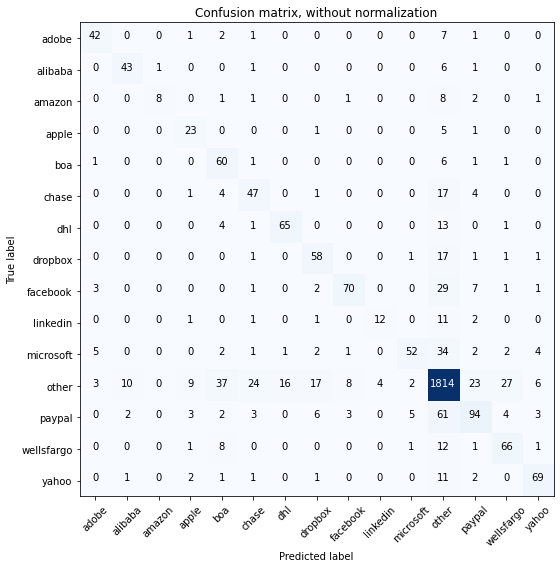

Acc     =  0.82
Pre     =  0.826
Rec     =  0.82
F1      =  0.817

Bal_Acc =  0.679
Bal_Pre =  0.729
Bal_Rec =  0.679
Bal_F1  =  0.703

              precision    recall  f1-score   support

       adobe       0.78      0.78      0.78        54
     alibaba       0.77      0.83      0.80        52
      amazon       0.89      0.36      0.52        22
       apple       0.56      0.77      0.65        30
         boa       0.50      0.86      0.63        70
       chase       0.56      0.64      0.59        74
         dhl       0.79      0.77      0.78        84
     dropbox       0.65      0.72      0.69        80
    facebook       0.84      0.61      0.71       114
    linkedin       0.75      0.43      0.55        28
   microsoft       0.85      0.49      0.62       106
       other       0.88      0.91      0.90      2000
      paypal       0.66      0.51      0.57       186
  wellsfargo       0.64      0.73      0.68        90
       yahoo       0.80      0.78      0.79        88

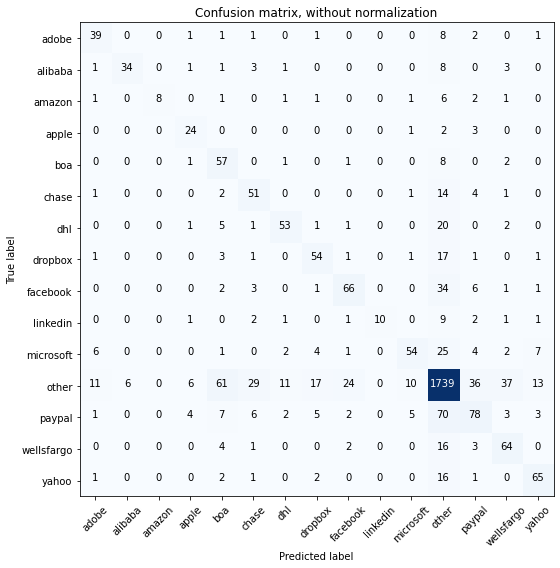

Acc     =  0.778
Pre     =  0.792
Rec     =  0.778
F1      =  0.779

Bal_Acc =  0.636
Bal_Pre =  0.696
Bal_Rec =  0.636
Bal_F1  =  0.665

              precision    recall  f1-score   support

       adobe       0.63      0.72      0.67        54
     alibaba       0.85      0.65      0.74        52
      amazon       1.00      0.36      0.53        22
       apple       0.62      0.80      0.70        30
         boa       0.39      0.81      0.53        70
       chase       0.52      0.69      0.59        74
         dhl       0.74      0.63      0.68        84
     dropbox       0.63      0.68      0.65        80
    facebook       0.67      0.58      0.62       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.74      0.51      0.60       106
       other       0.87      0.87      0.87      2000
      paypal       0.55      0.42      0.48       186
  wellsfargo       0.55      0.71      0.62        90
       yahoo       0.71      0.74      0.72        

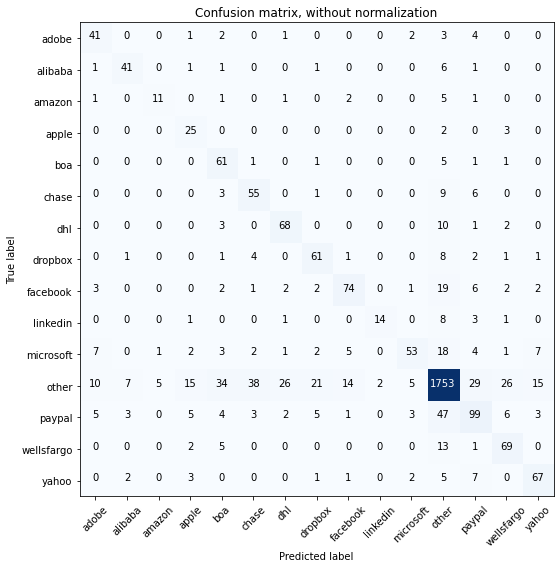

Acc     =  0.81
Pre     =  0.826
Rec     =  0.81
F1      =  0.813

Bal_Acc =  0.71
Bal_Pre =  0.672
Bal_Rec =  0.71
Bal_F1  =  0.69

              precision    recall  f1-score   support

       adobe       0.60      0.76      0.67        54
     alibaba       0.76      0.79      0.77        52
      amazon       0.65      0.50      0.56        22
       apple       0.45      0.83      0.59        30
         boa       0.51      0.87      0.64        70
       chase       0.53      0.74      0.62        74
         dhl       0.67      0.81      0.73        84
     dropbox       0.64      0.76      0.70        80
    facebook       0.76      0.65      0.70       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.80      0.50      0.62       106
       other       0.92      0.88      0.90      2000
      paypal       0.60      0.53      0.56       186
  wellsfargo       0.62      0.77      0.68        90
       yahoo       0.71      0.76      0.73        88

 

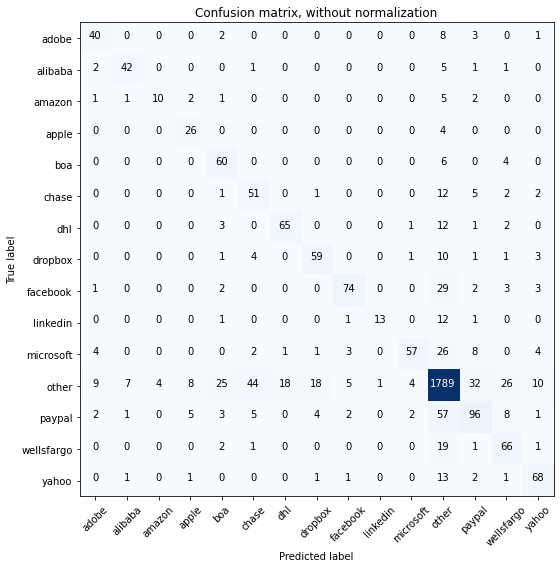

Acc     =  0.817
Pre     =  0.826
Rec     =  0.817
F1      =  0.817

Bal_Acc =  0.7
Bal_Pre =  0.723
Bal_Rec =  0.7
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.68      0.74      0.71        54
     alibaba       0.81      0.81      0.81        52
      amazon       0.71      0.45      0.56        22
       apple       0.62      0.87      0.72        30
         boa       0.59      0.86      0.70        70
       chase       0.47      0.69      0.56        74
         dhl       0.77      0.77      0.77        84
     dropbox       0.70      0.74      0.72        80
    facebook       0.86      0.65      0.74       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.88      0.54      0.67       106
       other       0.89      0.89      0.89      2000
      paypal       0.62      0.52      0.56       186
  wellsfargo       0.58      0.73      0.65        90
       yahoo       0.73      0.77      0.75        88



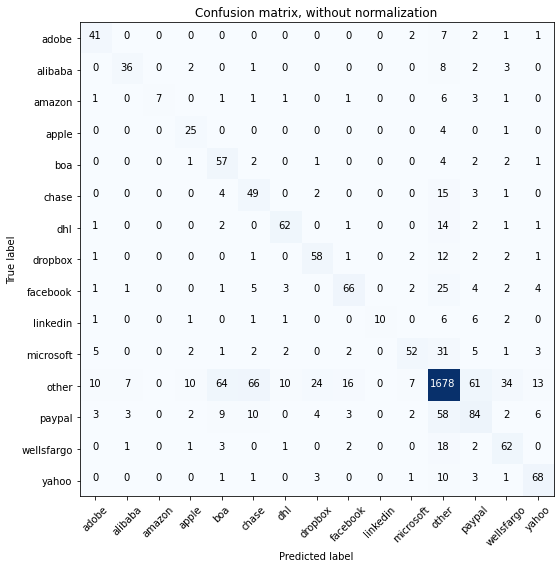

Acc     =  0.765
Pre     =  0.792
Rec     =  0.765
F1      =  0.771

Bal_Acc =  0.648
Bal_Pre =  0.678
Bal_Rec =  0.648
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.64      0.76      0.69        54
     alibaba       0.75      0.69      0.72        52
      amazon       1.00      0.32      0.48        22
       apple       0.57      0.83      0.68        30
         boa       0.40      0.81      0.54        70
       chase       0.35      0.66      0.46        74
         dhl       0.78      0.74      0.76        84
     dropbox       0.63      0.72      0.67        80
    facebook       0.72      0.58      0.64       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.76      0.49      0.60       106
       other       0.89      0.84      0.86      2000
      paypal       0.46      0.45      0.46       186
  wellsfargo       0.53      0.69      0.60        90
       yahoo       0.69      0.77      0.73        

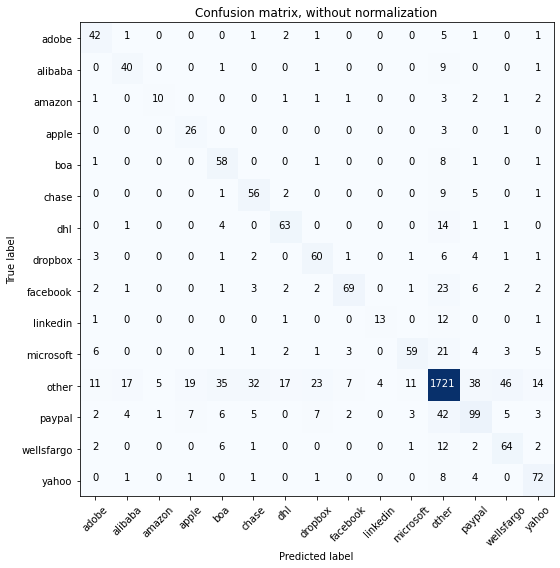

Acc     =  0.797
Pre     =  0.814
Rec     =  0.797
F1      =  0.8

Bal_Acc =  0.7
Bal_Pre =  0.651
Bal_Rec =  0.7
Bal_F1  =  0.675

              precision    recall  f1-score   support

       adobe       0.59      0.78      0.67        54
     alibaba       0.62      0.77      0.68        52
      amazon       0.62      0.45      0.53        22
       apple       0.49      0.87      0.63        30
         boa       0.51      0.83      0.63        70
       chase       0.55      0.76      0.64        74
         dhl       0.70      0.75      0.72        84
     dropbox       0.61      0.75      0.67        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.76      0.46      0.58        28
   microsoft       0.78      0.56      0.65       106
       other       0.91      0.86      0.88      2000
      paypal       0.59      0.53      0.56       186
  wellsfargo       0.52      0.71      0.60        90
       yahoo       0.68      0.82      0.74        88

  

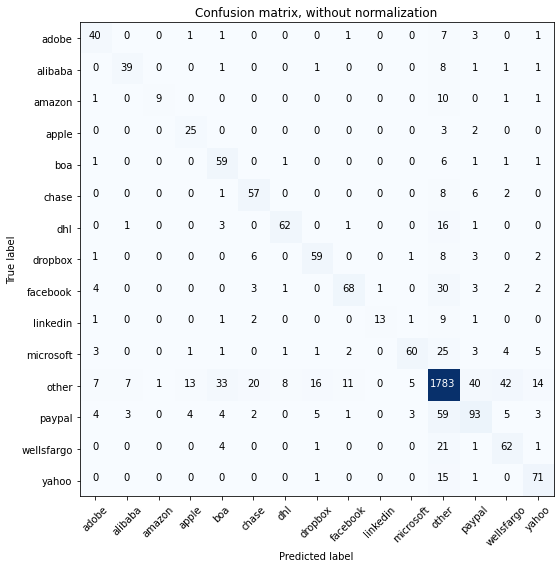

Acc     =  0.812
Pre     =  0.821
Rec     =  0.812
F1      =  0.812

Bal_Acc =  0.689
Bal_Pre =  0.727
Bal_Rec =  0.689
Bal_F1  =  0.707

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.78      0.75      0.76        52
      amazon       0.90      0.41      0.56        22
       apple       0.57      0.83      0.68        30
         boa       0.55      0.84      0.66        70
       chase       0.63      0.77      0.70        74
         dhl       0.85      0.74      0.79        84
     dropbox       0.70      0.74      0.72        80
    facebook       0.81      0.60      0.69       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.86      0.57      0.68       106
       other       0.89      0.89      0.89      2000
      paypal       0.58      0.50      0.54       186
  wellsfargo       0.52      0.69      0.59        90
       yahoo       0.70      0.81      0.75        

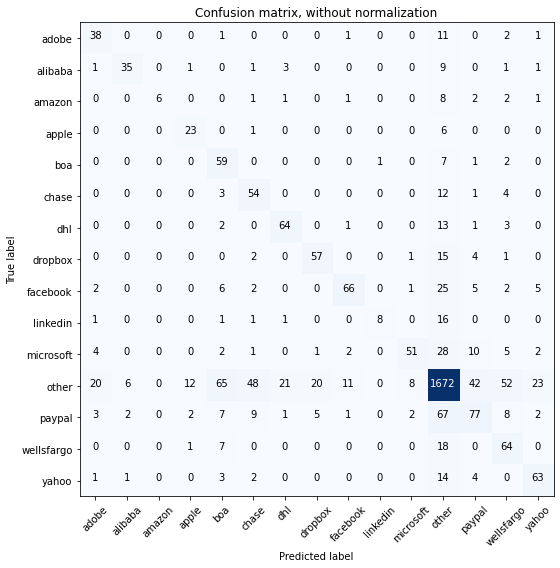

Acc     =  0.759
Pre     =  0.786
Rec     =  0.759
F1      =  0.763

Bal_Acc =  0.632
Bal_Pre =  0.674
Bal_Rec =  0.632
Bal_F1  =  0.652

              precision    recall  f1-score   support

       adobe       0.54      0.70      0.61        54
     alibaba       0.80      0.67      0.73        52
      amazon       1.00      0.27      0.43        22
       apple       0.59      0.77      0.67        30
         boa       0.38      0.84      0.52        70
       chase       0.44      0.73      0.55        74
         dhl       0.70      0.76      0.73        84
     dropbox       0.69      0.71      0.70        80
    facebook       0.80      0.58      0.67       114
    linkedin       0.89      0.29      0.43        28
   microsoft       0.81      0.48      0.60       106
       other       0.87      0.84      0.85      2000
      paypal       0.52      0.41      0.46       186
  wellsfargo       0.44      0.71      0.54        90
       yahoo       0.64      0.72      0.68        

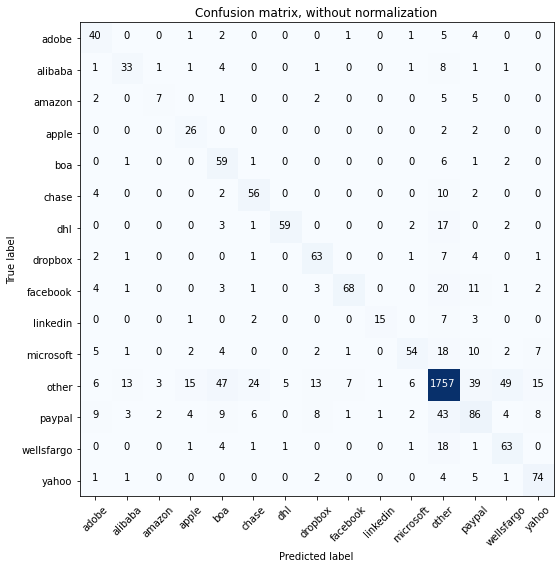

Acc     =  0.799
Pre     =  0.82
Rec     =  0.799
F1      =  0.803

Bal_Acc =  0.678
Bal_Pre =  0.664
Bal_Rec =  0.678
Bal_F1  =  0.671

              precision    recall  f1-score   support

       adobe       0.54      0.74      0.62        54
     alibaba       0.61      0.63      0.62        52
      amazon       0.54      0.32      0.40        22
       apple       0.51      0.87      0.64        30
         boa       0.43      0.84      0.57        70
       chase       0.60      0.76      0.67        74
         dhl       0.91      0.70      0.79        84
     dropbox       0.67      0.79      0.72        80
    facebook       0.87      0.60      0.71       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.79      0.51      0.62       106
       other       0.91      0.88      0.89      2000
      paypal       0.49      0.46      0.48       186
  wellsfargo       0.50      0.70      0.59        90
       yahoo       0.69      0.84      0.76        8

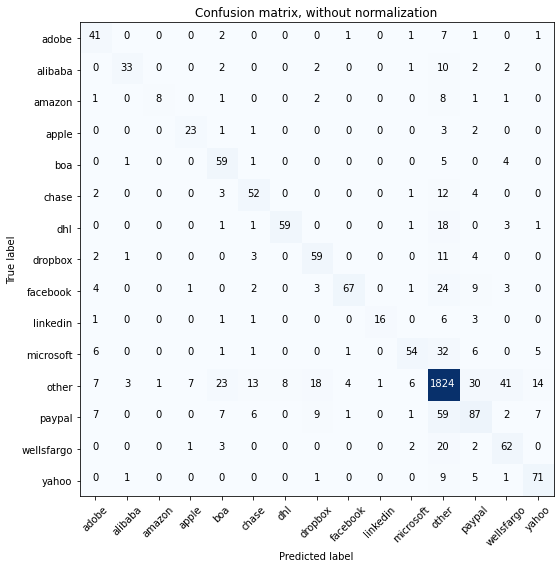

Acc     =  0.817
Pre     =  0.824
Rec     =  0.817
F1      =  0.815

Bal_Acc =  0.67
Bal_Pre =  0.738
Bal_Rec =  0.67
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.58      0.76      0.66        54
     alibaba       0.85      0.63      0.73        52
      amazon       0.89      0.36      0.52        22
       apple       0.72      0.77      0.74        30
         boa       0.57      0.84      0.68        70
       chase       0.64      0.70      0.67        74
         dhl       0.88      0.70      0.78        84
     dropbox       0.63      0.74      0.68        80
    facebook       0.91      0.59      0.71       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.79      0.51      0.62       106
       other       0.89      0.91      0.90      2000
      paypal       0.56      0.47      0.51       186
  wellsfargo       0.52      0.69      0.59        90
       yahoo       0.72      0.81      0.76        88

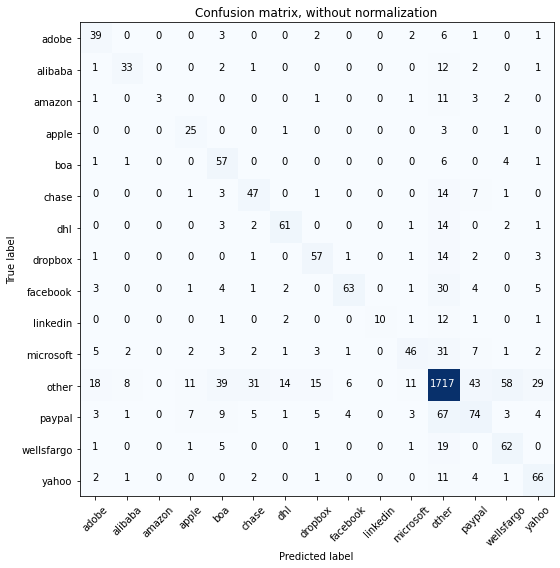

Acc     =  0.767
Pre     =  0.784
Rec     =  0.767
F1      =  0.766

Bal_Acc =  0.617
Bal_Pre =  0.67
Bal_Rec =  0.617
Bal_F1  =  0.642

              precision    recall  f1-score   support

       adobe       0.52      0.72      0.60        54
     alibaba       0.72      0.63      0.67        52
      amazon       1.00      0.14      0.24        22
       apple       0.52      0.83      0.64        30
         boa       0.44      0.81      0.57        70
       chase       0.51      0.64      0.57        74
         dhl       0.74      0.73      0.73        84
     dropbox       0.66      0.71      0.69        80
    facebook       0.84      0.55      0.67       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.68      0.43      0.53       106
       other       0.87      0.86      0.87      2000
      paypal       0.50      0.40      0.44       186
  wellsfargo       0.46      0.69      0.55        90
       yahoo       0.58      0.75      0.65        8

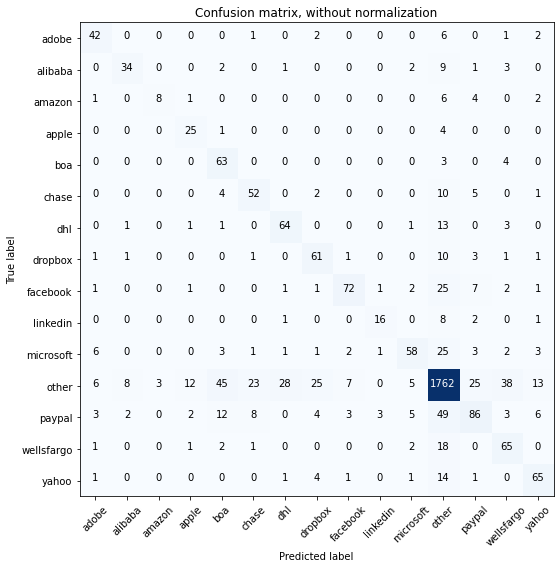

Acc     =  0.803
Pre     =  0.815
Rec     =  0.803
F1      =  0.804

Bal_Acc =  0.687
Bal_Pre =  0.678
Bal_Rec =  0.687
Bal_F1  =  0.682

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.74      0.65      0.69        52
      amazon       0.73      0.36      0.48        22
       apple       0.58      0.83      0.68        30
         boa       0.47      0.90      0.62        70
       chase       0.60      0.70      0.65        74
         dhl       0.66      0.76      0.71        84
     dropbox       0.61      0.76      0.68        80
    facebook       0.84      0.63      0.72       114
    linkedin       0.76      0.57      0.65        28
   microsoft       0.76      0.55      0.64       106
       other       0.90      0.88      0.89      2000
      paypal       0.63      0.46      0.53       186
  wellsfargo       0.53      0.72      0.61        90
       yahoo       0.68      0.74      0.71        

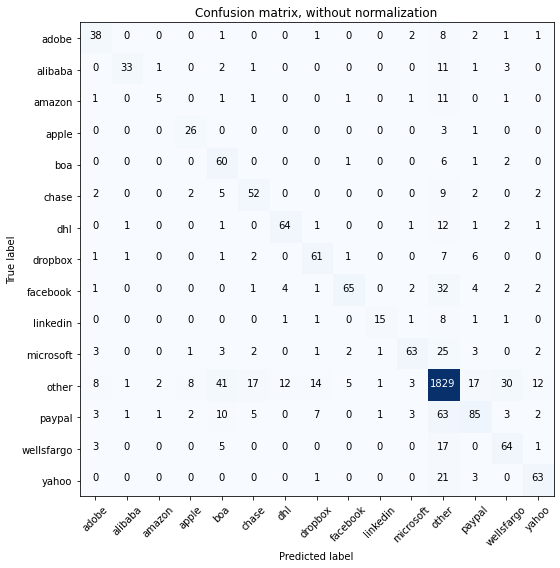

Acc     =  0.82
Pre     =  0.825
Rec     =  0.82
F1      =  0.816

Bal_Acc =  0.668
Bal_Pre =  0.716
Bal_Rec =  0.668
Bal_F1  =  0.691

              precision    recall  f1-score   support

       adobe       0.63      0.70      0.67        54
     alibaba       0.89      0.63      0.74        52
      amazon       0.56      0.23      0.32        22
       apple       0.67      0.87      0.75        30
         boa       0.46      0.86      0.60        70
       chase       0.64      0.70      0.67        74
         dhl       0.79      0.76      0.78        84
     dropbox       0.69      0.76      0.73        80
    facebook       0.87      0.57      0.69       114
    linkedin       0.83      0.54      0.65        28
   microsoft       0.83      0.59      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.67      0.46      0.54       186
  wellsfargo       0.59      0.71      0.64        90
       yahoo       0.73      0.72      0.72        88

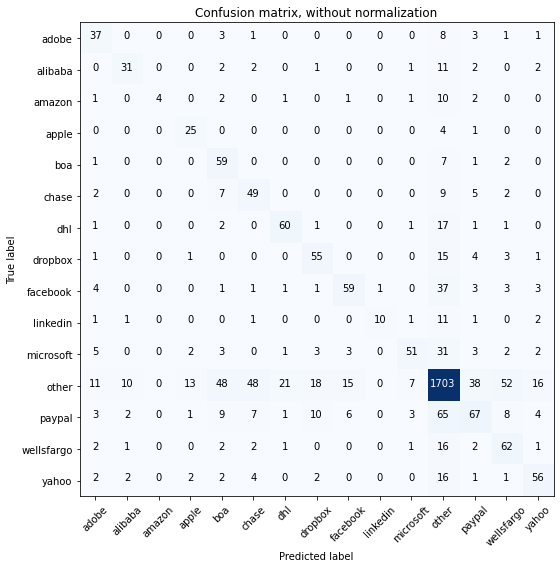

Acc     =  0.756
Pre     =  0.775
Rec     =  0.756
F1      =  0.756

Bal_Acc =  0.606
Bal_Pre =  0.649
Bal_Rec =  0.606
Bal_F1  =  0.627

              precision    recall  f1-score   support

       adobe       0.52      0.69      0.59        54
     alibaba       0.66      0.60      0.63        52
      amazon       1.00      0.18      0.31        22
       apple       0.57      0.83      0.68        30
         boa       0.42      0.84      0.56        70
       chase       0.43      0.66      0.52        74
         dhl       0.70      0.71      0.71        84
     dropbox       0.60      0.69      0.64        80
    facebook       0.70      0.52      0.60       114
    linkedin       0.91      0.36      0.51        28
   microsoft       0.77      0.48      0.59       106
       other       0.87      0.85      0.86      2000
      paypal       0.50      0.36      0.42       186
  wellsfargo       0.45      0.69      0.55        90
       yahoo       0.64      0.64      0.64        

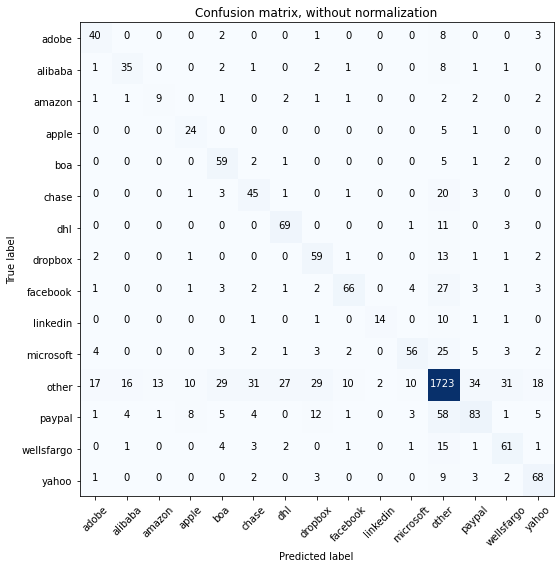

Acc     =  0.783
Pre     =  0.796
Rec     =  0.783
F1      =  0.785

Bal_Acc =  0.667
Bal_Pre =  0.63
Bal_Rec =  0.667
Bal_F1  =  0.648

              precision    recall  f1-score   support

       adobe       0.59      0.74      0.66        54
     alibaba       0.61      0.67      0.64        52
      amazon       0.39      0.41      0.40        22
       apple       0.53      0.80      0.64        30
         boa       0.53      0.84      0.65        70
       chase       0.48      0.61      0.54        74
         dhl       0.66      0.82      0.73        84
     dropbox       0.52      0.74      0.61        80
    facebook       0.79      0.58      0.67       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.75      0.53      0.62       106
       other       0.89      0.86      0.87      2000
      paypal       0.60      0.45      0.51       186
  wellsfargo       0.57      0.68      0.62        90
       yahoo       0.65      0.77      0.71        8

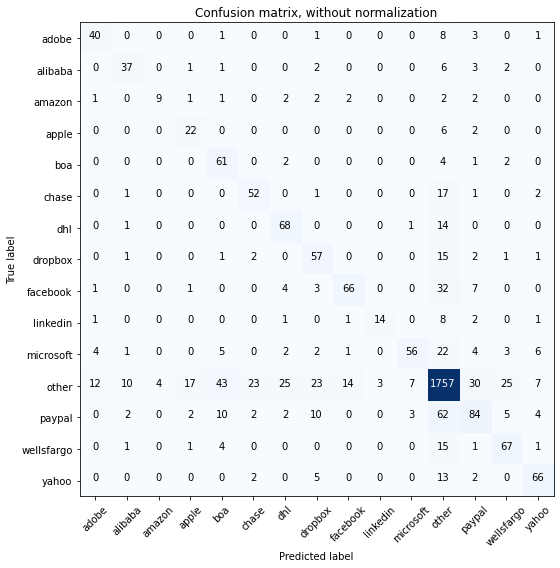

Acc     =  0.798
Pre     =  0.808
Rec     =  0.798
F1      =  0.798

Bal_Acc =  0.675
Bal_Pre =  0.676
Bal_Rec =  0.675
Bal_F1  =  0.675

              precision    recall  f1-score   support

       adobe       0.68      0.74      0.71        54
     alibaba       0.69      0.71      0.70        52
      amazon       0.69      0.41      0.51        22
       apple       0.49      0.73      0.59        30
         boa       0.48      0.87      0.62        70
       chase       0.64      0.70      0.67        74
         dhl       0.64      0.81      0.72        84
     dropbox       0.54      0.71      0.61        80
    facebook       0.79      0.58      0.67       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.84      0.53      0.65       106
       other       0.89      0.88      0.88      2000
      paypal       0.58      0.45      0.51       186
  wellsfargo       0.64      0.74      0.69        90
       yahoo       0.74      0.75      0.75        

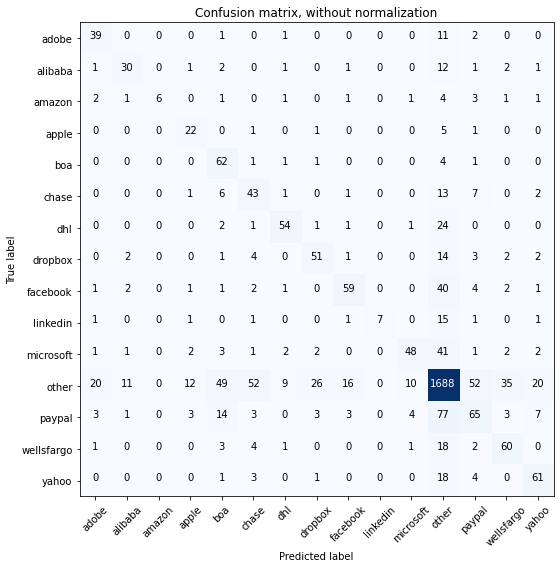

Acc     =  0.746
Pre     =  0.761
Rec     =  0.746
F1      =  0.745

Bal_Acc =  0.588
Bal_Pre =  0.65
Bal_Rec =  0.588
Bal_F1  =  0.617

              precision    recall  f1-score   support

       adobe       0.57      0.72      0.63        54
     alibaba       0.62      0.58      0.60        52
      amazon       1.00      0.27      0.43        22
       apple       0.51      0.73      0.60        30
         boa       0.42      0.89      0.57        70
       chase       0.37      0.58      0.45        74
         dhl       0.75      0.64      0.69        84
     dropbox       0.59      0.64      0.61        80
    facebook       0.70      0.52      0.60       114
    linkedin       1.00      0.25      0.40        28
   microsoft       0.74      0.45      0.56       106
       other       0.85      0.84      0.85      2000
      paypal       0.44      0.35      0.39       186
  wellsfargo       0.56      0.67      0.61        90
       yahoo       0.62      0.69      0.66        8

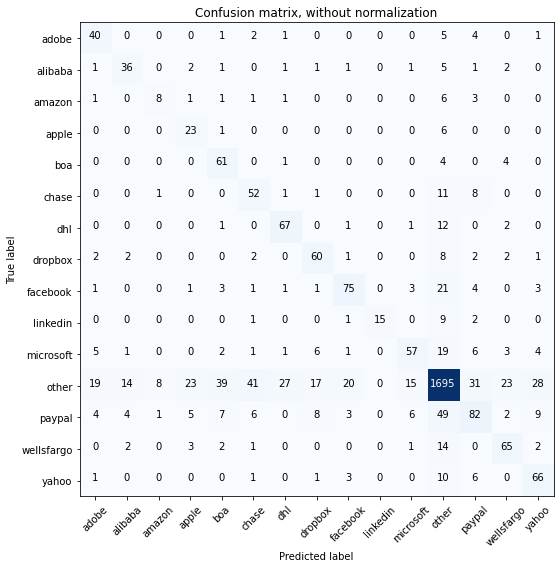

Acc     =  0.78
Pre     =  0.799
Rec     =  0.78
F1      =  0.785

Bal_Acc =  0.678
Bal_Pre =  0.622
Bal_Rec =  0.678
Bal_F1  =  0.649

              precision    recall  f1-score   support

       adobe       0.54      0.74      0.62        54
     alibaba       0.61      0.69      0.65        52
      amazon       0.44      0.36      0.40        22
       apple       0.40      0.77      0.52        30
         boa       0.51      0.87      0.65        70
       chase       0.48      0.70      0.57        74
         dhl       0.66      0.80      0.72        84
     dropbox       0.63      0.75      0.69        80
    facebook       0.71      0.66      0.68       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.68      0.54      0.60       106
       other       0.90      0.85      0.88      2000
      paypal       0.55      0.44      0.49       186
  wellsfargo       0.63      0.72      0.67        90
       yahoo       0.58      0.75      0.65        88

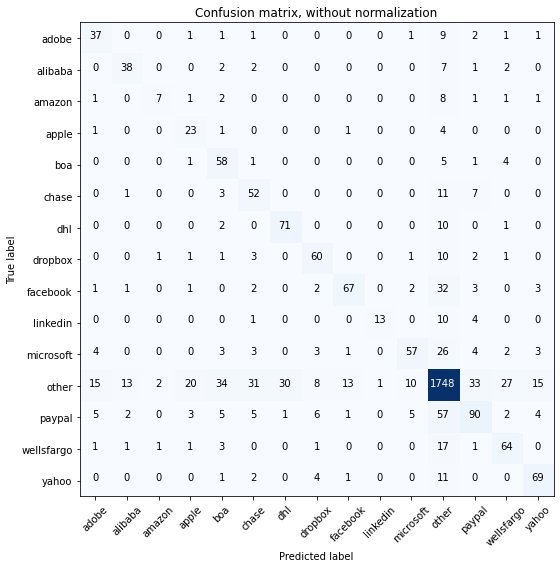

Acc     =  0.797
Pre     =  0.808
Rec     =  0.797
F1      =  0.798

Bal_Acc =  0.671
Bal_Pre =  0.669
Bal_Rec =  0.671
Bal_F1  =  0.67

              precision    recall  f1-score   support

       adobe       0.57      0.69      0.62        54
     alibaba       0.68      0.73      0.70        52
      amazon       0.64      0.32      0.42        22
       apple       0.44      0.77      0.56        30
         boa       0.50      0.83      0.62        70
       chase       0.50      0.70      0.59        74
         dhl       0.70      0.85      0.76        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.80      0.59      0.68       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.75      0.54      0.63       106
       other       0.89      0.87      0.88      2000
      paypal       0.60      0.48      0.54       186
  wellsfargo       0.61      0.71      0.66        90
       yahoo       0.72      0.78      0.75        8

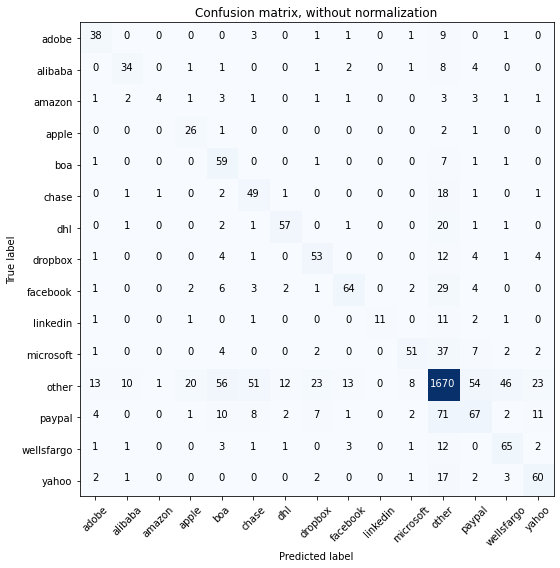

Acc     =  0.75
Pre     =  0.771
Rec     =  0.75
F1      =  0.752

Bal_Acc =  0.619
Bal_Pre =  0.633
Bal_Rec =  0.619
Bal_F1  =  0.626

              precision    recall  f1-score   support

       adobe       0.59      0.70      0.64        54
     alibaba       0.68      0.65      0.67        52
      amazon       0.67      0.18      0.29        22
       apple       0.50      0.87      0.63        30
         boa       0.39      0.84      0.53        70
       chase       0.41      0.66      0.51        74
         dhl       0.76      0.68      0.72        84
     dropbox       0.58      0.66      0.62        80
    facebook       0.74      0.56      0.64       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.76      0.48      0.59       106
       other       0.87      0.83      0.85      2000
      paypal       0.44      0.36      0.40       186
  wellsfargo       0.52      0.72      0.61        90
       yahoo       0.58      0.68      0.62        88

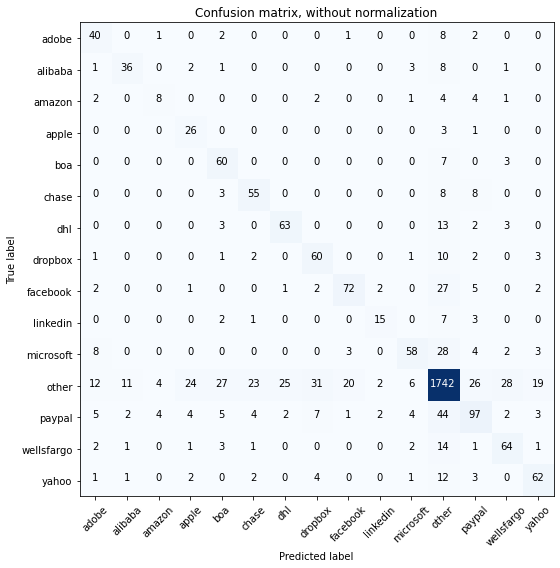

Acc     =  0.799
Pre     =  0.81
Rec     =  0.799
F1      =  0.801

Bal_Acc =  0.686
Bal_Pre =  0.641
Bal_Rec =  0.686
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.54      0.74      0.62        54
     alibaba       0.71      0.69      0.70        52
      amazon       0.47      0.36      0.41        22
       apple       0.43      0.87      0.58        30
         boa       0.56      0.86      0.68        70
       chase       0.62      0.74      0.68        74
         dhl       0.69      0.75      0.72        84
     dropbox       0.57      0.75      0.65        80
    facebook       0.74      0.63      0.68       114
    linkedin       0.71      0.54      0.61        28
   microsoft       0.76      0.55      0.64       106
       other       0.90      0.87      0.89      2000
      paypal       0.61      0.52      0.56       186
  wellsfargo       0.62      0.71      0.66        90
       yahoo       0.67      0.70      0.69        8

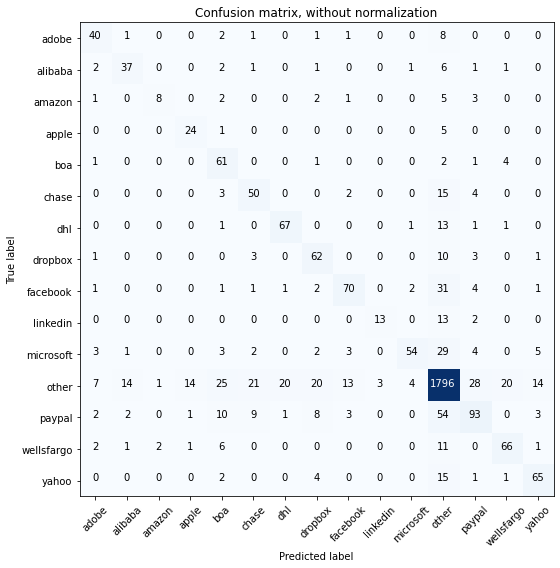

Acc     =  0.814
Pre     =  0.821
Rec     =  0.814
F1      =  0.812

Bal_Acc =  0.68
Bal_Pre =  0.699
Bal_Rec =  0.68
Bal_F1  =  0.689

              precision    recall  f1-score   support

       adobe       0.67      0.74      0.70        54
     alibaba       0.66      0.71      0.69        52
      amazon       0.73      0.36      0.48        22
       apple       0.60      0.80      0.69        30
         boa       0.51      0.87      0.65        70
       chase       0.57      0.68      0.62        74
         dhl       0.75      0.80      0.77        84
     dropbox       0.60      0.78      0.68        80
    facebook       0.75      0.61      0.68       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.87      0.51      0.64       106
       other       0.89      0.90      0.90      2000
      paypal       0.64      0.50      0.56       186
  wellsfargo       0.71      0.73      0.72        90
       yahoo       0.72      0.74      0.73        88

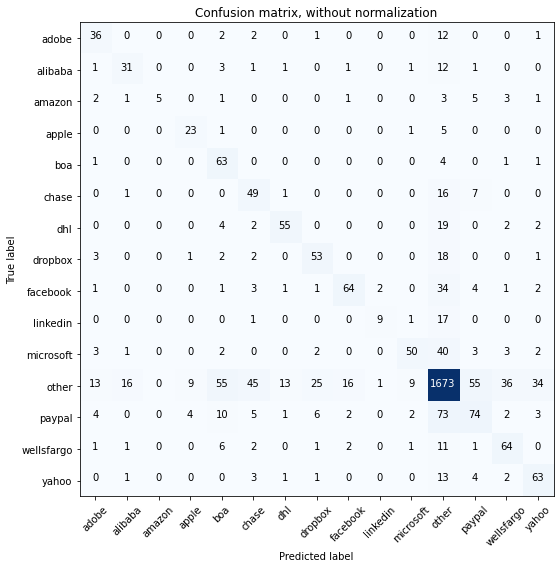

Acc     =  0.751
Pre     =  0.769
Rec     =  0.751
F1      =  0.752

Bal_Acc =  0.61
Bal_Pre =  0.646
Bal_Rec =  0.61
Bal_F1  =  0.627

              precision    recall  f1-score   support

       adobe       0.55      0.67      0.61        54
     alibaba       0.60      0.60      0.60        52
      amazon       1.00      0.23      0.37        22
       apple       0.62      0.77      0.69        30
         boa       0.42      0.90      0.57        70
       chase       0.43      0.66      0.52        74
         dhl       0.75      0.65      0.70        84
     dropbox       0.59      0.66      0.62        80
    facebook       0.74      0.56      0.64       114
    linkedin       0.75      0.32      0.45        28
   microsoft       0.77      0.47      0.58       106
       other       0.86      0.84      0.85      2000
      paypal       0.48      0.40      0.44       186
  wellsfargo       0.56      0.71      0.63        90
       yahoo       0.57      0.72      0.64        88

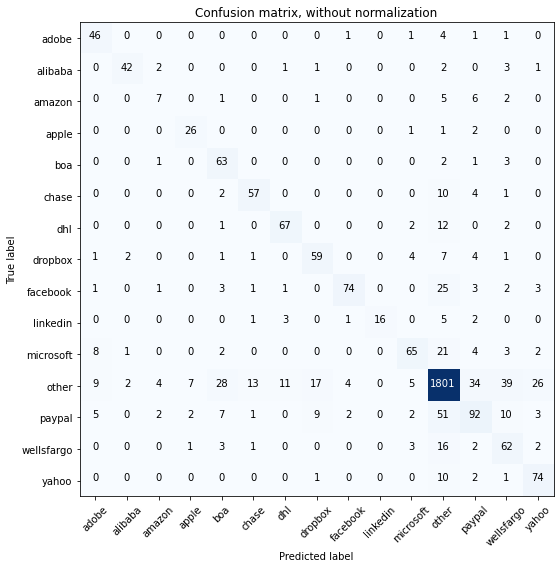

Acc     =  0.829
Pre     =  0.839
Rec     =  0.829
F1      =  0.83

Bal_Acc =  0.721
Bal_Pre =  0.721
Bal_Rec =  0.721
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        54
     alibaba       0.89      0.81      0.85        52
      amazon       0.41      0.32      0.36        22
       apple       0.72      0.87      0.79        30
         boa       0.57      0.90      0.70        70
       chase       0.76      0.77      0.77        74
         dhl       0.81      0.80      0.80        84
     dropbox       0.67      0.74      0.70        80
    facebook       0.90      0.65      0.76       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.78      0.61      0.69       106
       other       0.91      0.90      0.91      2000
      paypal       0.59      0.49      0.54       186
  wellsfargo       0.48      0.69      0.56        90
       yahoo       0.67      0.84      0.74        8

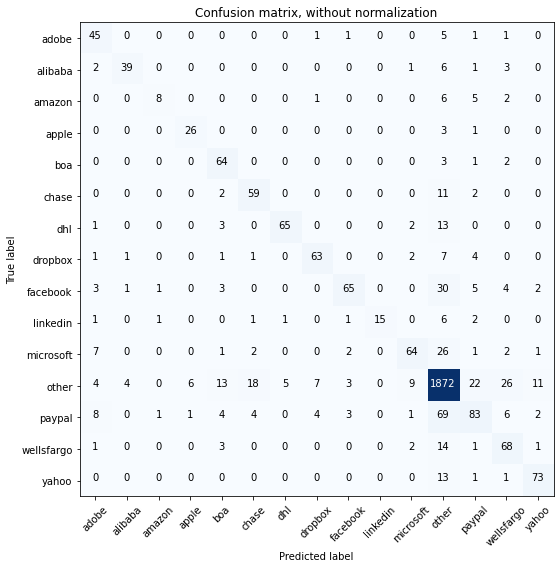

Acc     =  0.848
Pre     =  0.848
Rec     =  0.848
F1      =  0.843

Bal_Acc =  0.718
Bal_Pre =  0.781
Bal_Rec =  0.718
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.62      0.83      0.71        54
     alibaba       0.87      0.75      0.80        52
      amazon       0.73      0.36      0.48        22
       apple       0.79      0.87      0.83        30
         boa       0.68      0.91      0.78        70
       chase       0.69      0.80      0.74        74
         dhl       0.92      0.77      0.84        84
     dropbox       0.83      0.79      0.81        80
    facebook       0.87      0.57      0.69       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.79      0.60      0.68       106
       other       0.90      0.94      0.92      2000
      paypal       0.64      0.45      0.53       186
  wellsfargo       0.59      0.76      0.66        90
       yahoo       0.81      0.83      0.82        

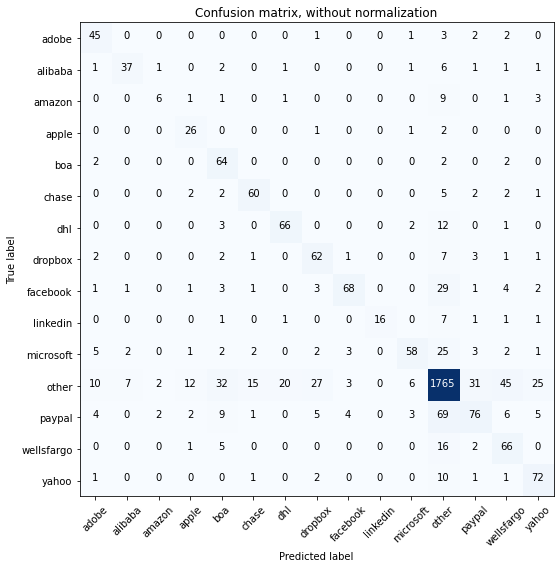

Acc     =  0.808
Pre     =  0.821
Rec     =  0.808
F1      =  0.807

Bal_Acc =  0.702
Bal_Pre =  0.696
Bal_Rec =  0.702
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.63      0.83      0.72        54
     alibaba       0.79      0.71      0.75        52
      amazon       0.55      0.27      0.36        22
       apple       0.57      0.87      0.68        30
         boa       0.51      0.91      0.65        70
       chase       0.74      0.81      0.77        74
         dhl       0.74      0.79      0.76        84
     dropbox       0.60      0.78      0.68        80
    facebook       0.86      0.60      0.70       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.81      0.55      0.65       106
       other       0.90      0.88      0.89      2000
      paypal       0.62      0.41      0.49       186
  wellsfargo       0.49      0.73      0.59        90
       yahoo       0.64      0.82      0.72        

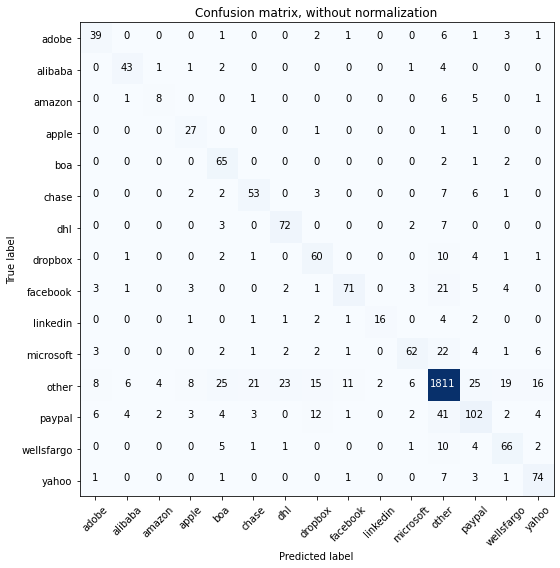

Acc     =  0.835
Pre     =  0.842
Rec     =  0.835
F1      =  0.835

Bal_Acc =  0.725
Bal_Pre =  0.702
Bal_Rec =  0.725
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.65      0.72      0.68        54
     alibaba       0.77      0.83      0.80        52
      amazon       0.53      0.36      0.43        22
       apple       0.60      0.90      0.72        30
         boa       0.58      0.93      0.71        70
       chase       0.65      0.72      0.68        74
         dhl       0.71      0.86      0.78        84
     dropbox       0.61      0.75      0.67        80
    facebook       0.82      0.62      0.71       114
    linkedin       0.89      0.57      0.70        28
   microsoft       0.81      0.58      0.68       106
       other       0.92      0.91      0.91      2000
      paypal       0.63      0.55      0.58       186
  wellsfargo       0.66      0.73      0.69        90
       yahoo       0.70      0.84      0.77        

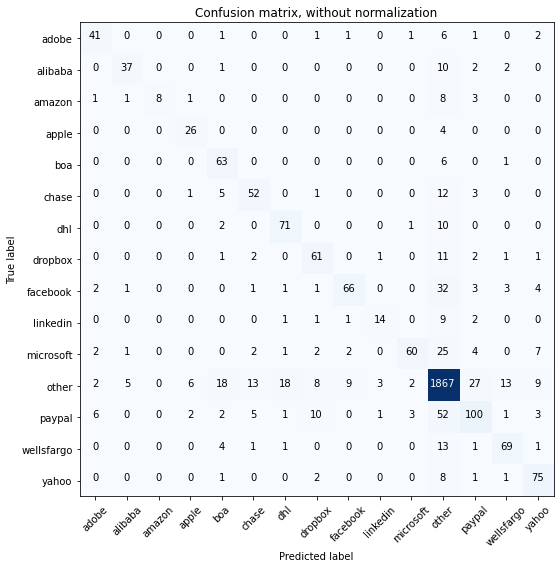

Acc     =  0.848
Pre     =  0.849
Rec     =  0.848
F1      =  0.843

Bal_Acc =  0.71
Bal_Pre =  0.775
Bal_Rec =  0.71
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.76      0.76      0.76        54
     alibaba       0.82      0.71      0.76        52
      amazon       1.00      0.36      0.53        22
       apple       0.72      0.87      0.79        30
         boa       0.64      0.90      0.75        70
       chase       0.68      0.70      0.69        74
         dhl       0.76      0.85      0.80        84
     dropbox       0.70      0.76      0.73        80
    facebook       0.84      0.58      0.68       114
    linkedin       0.74      0.50      0.60        28
   microsoft       0.90      0.57      0.69       106
       other       0.90      0.93      0.92      2000
      paypal       0.67      0.54      0.60       186
  wellsfargo       0.76      0.77      0.76        90
       yahoo       0.74      0.85      0.79        88

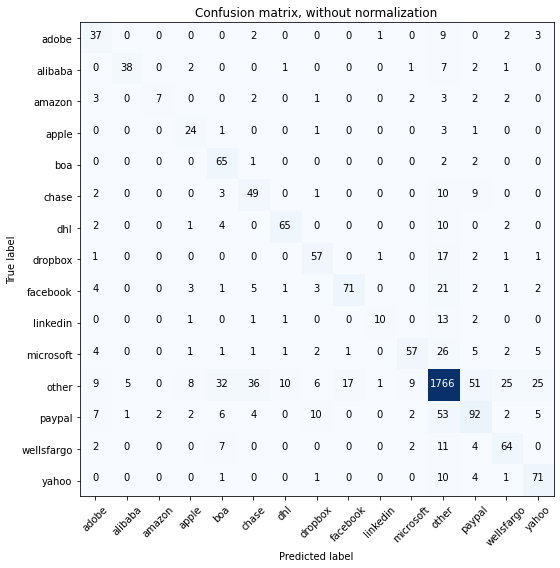

Acc     =  0.803
Pre     =  0.815
Rec     =  0.803
F1      =  0.804

Bal_Acc =  0.668
Bal_Pre =  0.686
Bal_Rec =  0.668
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.52      0.69      0.59        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.78      0.32      0.45        22
       apple       0.57      0.80      0.67        30
         boa       0.54      0.93      0.68        70
       chase       0.49      0.66      0.56        74
         dhl       0.82      0.77      0.80        84
     dropbox       0.70      0.71      0.70        80
    facebook       0.80      0.62      0.70       114
    linkedin       0.77      0.36      0.49        28
   microsoft       0.78      0.54      0.64       106
       other       0.90      0.88      0.89      2000
      paypal       0.52      0.49      0.51       186
  wellsfargo       0.62      0.71      0.66        90
       yahoo       0.63      0.81      0.71        

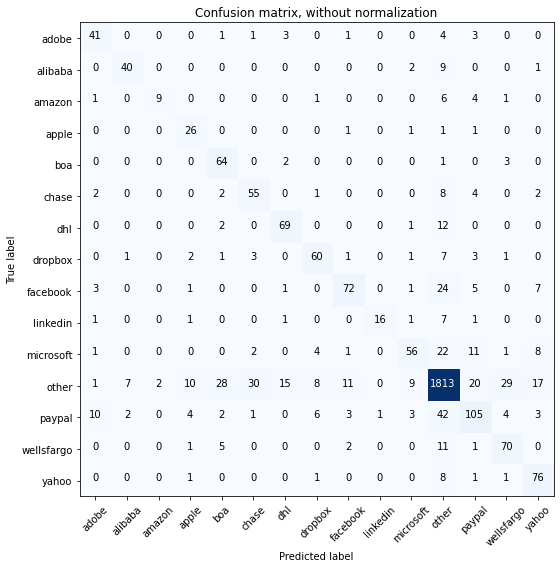

Acc     =  0.836
Pre     =  0.842
Rec     =  0.836
F1      =  0.835

Bal_Acc =  0.725
Bal_Pre =  0.728
Bal_Rec =  0.725
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.68      0.76      0.72        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.82      0.41      0.55        22
       apple       0.57      0.87      0.68        30
         boa       0.61      0.91      0.73        70
       chase       0.60      0.74      0.66        74
         dhl       0.76      0.82      0.79        84
     dropbox       0.74      0.75      0.75        80
    facebook       0.78      0.63      0.70       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.75      0.53      0.62       106
       other       0.92      0.91      0.91      2000
      paypal       0.66      0.56      0.61       186
  wellsfargo       0.64      0.78      0.70        90
       yahoo       0.67      0.86      0.75        

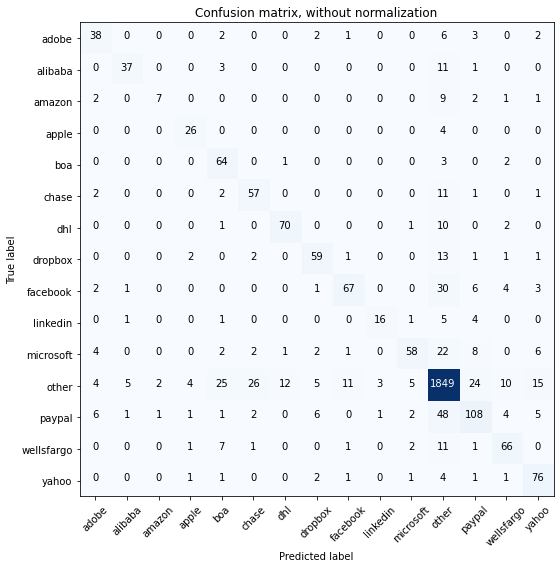

Acc     =  0.844
Pre     =  0.846
Rec     =  0.844
F1      =  0.841

Bal_Acc =  0.711
Bal_Pre =  0.745
Bal_Rec =  0.711
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.66      0.70      0.68        54
     alibaba       0.82      0.71      0.76        52
      amazon       0.70      0.32      0.44        22
       apple       0.74      0.87      0.80        30
         boa       0.59      0.91      0.72        70
       chase       0.63      0.77      0.70        74
         dhl       0.83      0.83      0.83        84
     dropbox       0.77      0.74      0.75        80
    facebook       0.81      0.59      0.68       114
    linkedin       0.80      0.57      0.67        28
   microsoft       0.83      0.55      0.66       106
       other       0.91      0.92      0.92      2000
      paypal       0.68      0.58      0.62       186
  wellsfargo       0.73      0.73      0.73        90
       yahoo       0.69      0.86      0.77        

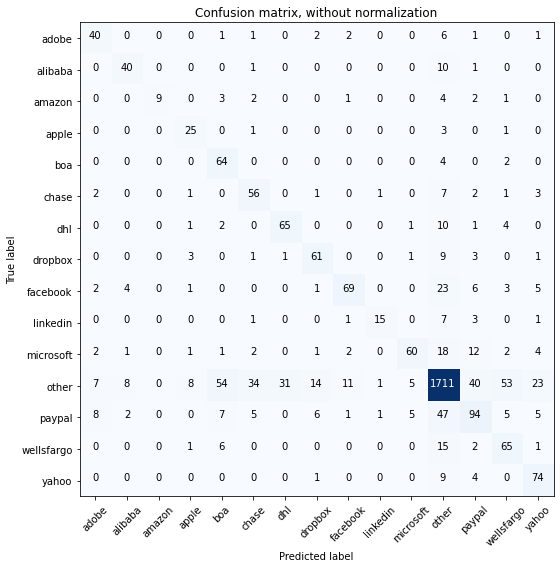

Acc     =  0.795
Pre     =  0.818
Rec     =  0.795
F1      =  0.8

Bal_Acc =  0.706
Bal_Pre =  0.692
Bal_Rec =  0.706
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.66      0.74      0.70        54
     alibaba       0.73      0.77      0.75        52
      amazon       1.00      0.41      0.58        22
       apple       0.61      0.83      0.70        30
         boa       0.46      0.91      0.62        70
       chase       0.54      0.76      0.63        74
         dhl       0.67      0.77      0.72        84
     dropbox       0.70      0.76      0.73        80
    facebook       0.79      0.61      0.69       114
    linkedin       0.83      0.54      0.65        28
   microsoft       0.83      0.57      0.67       106
       other       0.91      0.86      0.88      2000
      paypal       0.55      0.51      0.53       186
  wellsfargo       0.47      0.72      0.57        90
       yahoo       0.63      0.84      0.72        88

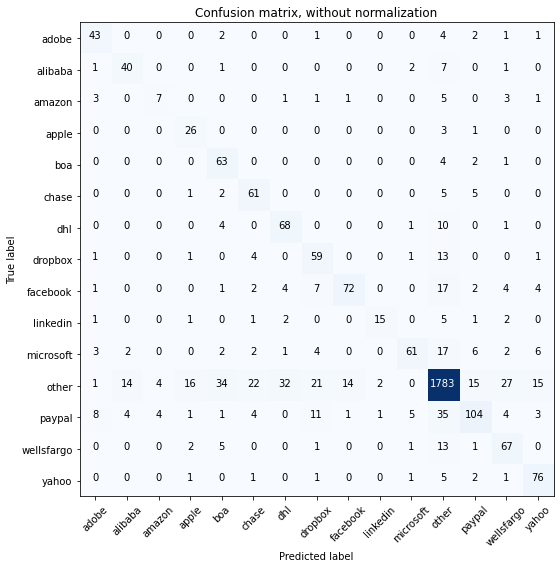

Acc     =  0.827
Pre     =  0.842
Rec     =  0.827
F1      =  0.829

Bal_Acc =  0.722
Bal_Pre =  0.679
Bal_Rec =  0.722
Bal_F1  =  0.7

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.67      0.77      0.71        52
      amazon       0.47      0.32      0.38        22
       apple       0.53      0.87      0.66        30
         boa       0.55      0.90      0.68        70
       chase       0.63      0.82      0.71        74
         dhl       0.63      0.81      0.71        84
     dropbox       0.56      0.74      0.63        80
    facebook       0.82      0.63      0.71       114
    linkedin       0.83      0.54      0.65        28
   microsoft       0.85      0.58      0.69       106
       other       0.93      0.89      0.91      2000
      paypal       0.74      0.56      0.64       186
  wellsfargo       0.59      0.74      0.66        90
       yahoo       0.71      0.86      0.78        88

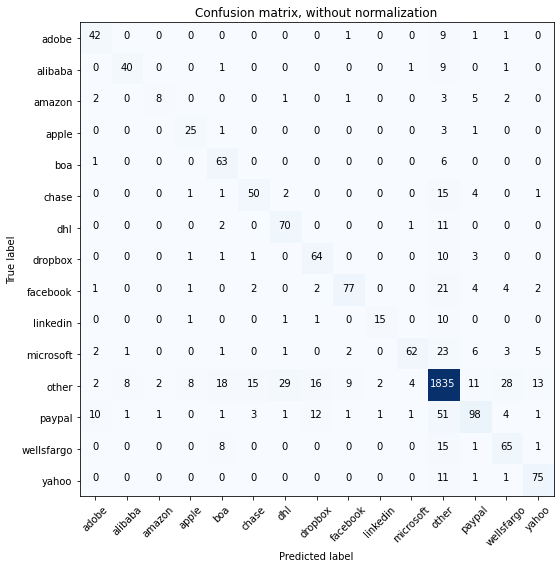

Acc     =  0.841
Pre     =  0.845
Rec     =  0.841
F1      =  0.839

Bal_Acc =  0.718
Bal_Pre =  0.744
Bal_Rec =  0.718
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.73      0.36      0.48        22
       apple       0.68      0.83      0.75        30
         boa       0.65      0.90      0.75        70
       chase       0.70      0.68      0.69        74
         dhl       0.67      0.83      0.74        84
     dropbox       0.67      0.80      0.73        80
    facebook       0.85      0.68      0.75       114
    linkedin       0.83      0.54      0.65        28
   microsoft       0.90      0.58      0.71       106
       other       0.90      0.92      0.91      2000
      paypal       0.73      0.53      0.61       186
  wellsfargo       0.60      0.72      0.65        90
       yahoo       0.77      0.85      0.81        

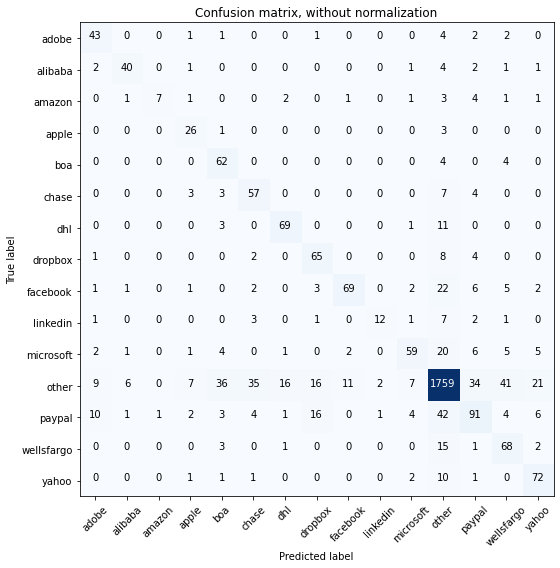

Acc     =  0.812
Pre     =  0.828
Rec     =  0.812
F1      =  0.814

Bal_Acc =  0.705
Bal_Pre =  0.695
Bal_Rec =  0.705
Bal_F1  =  0.7

              precision    recall  f1-score   support

       adobe       0.62      0.80      0.70        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.88      0.32      0.47        22
       apple       0.59      0.87      0.70        30
         boa       0.53      0.89      0.66        70
       chase       0.55      0.77      0.64        74
         dhl       0.77      0.82      0.79        84
     dropbox       0.64      0.81      0.71        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.80      0.43      0.56        28
   microsoft       0.76      0.56      0.64       106
       other       0.92      0.88      0.90      2000
      paypal       0.58      0.49      0.53       186
  wellsfargo       0.52      0.76      0.61        90
       yahoo       0.65      0.82      0.73        88

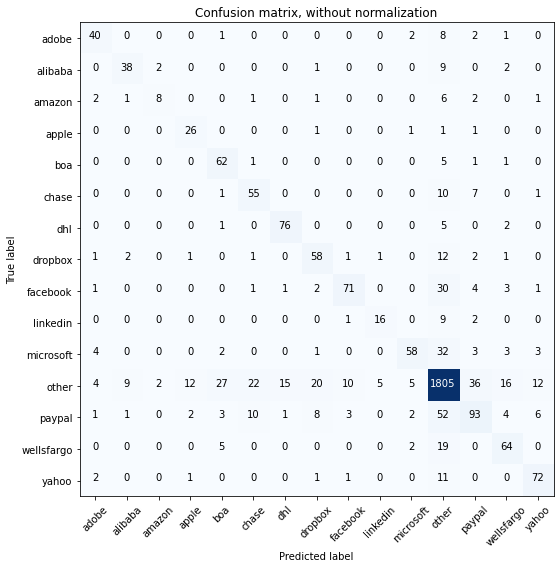

Acc     =  0.826
Pre     =  0.828
Rec     =  0.826
F1      =  0.824

Bal_Acc =  0.709
Bal_Pre =  0.713
Bal_Rec =  0.709
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.73      0.74      0.73        54
     alibaba       0.75      0.73      0.74        52
      amazon       0.67      0.36      0.47        22
       apple       0.62      0.87      0.72        30
         boa       0.61      0.89      0.72        70
       chase       0.60      0.74      0.67        74
         dhl       0.82      0.90      0.86        84
     dropbox       0.62      0.72      0.67        80
    facebook       0.82      0.62      0.71       114
    linkedin       0.73      0.57      0.64        28
   microsoft       0.83      0.55      0.66       106
       other       0.90      0.90      0.90      2000
      paypal       0.61      0.50      0.55       186
  wellsfargo       0.66      0.71      0.68        90
       yahoo       0.75      0.82      0.78        

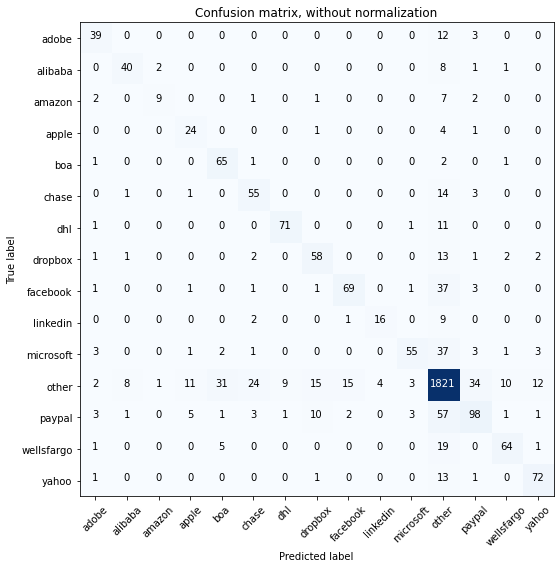

Acc     =  0.83
Pre     =  0.832
Rec     =  0.83
F1      =  0.827

Bal_Acc =  0.707
Bal_Pre =  0.745
Bal_Rec =  0.707
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.71      0.72      0.72        54
     alibaba       0.78      0.77      0.78        52
      amazon       0.75      0.41      0.53        22
       apple       0.56      0.80      0.66        30
         boa       0.62      0.93      0.75        70
       chase       0.61      0.74      0.67        74
         dhl       0.88      0.85      0.86        84
     dropbox       0.67      0.72      0.69        80
    facebook       0.79      0.61      0.69       114
    linkedin       0.80      0.57      0.67        28
   microsoft       0.87      0.52      0.65       106
       other       0.88      0.91      0.90      2000
      paypal       0.65      0.53      0.58       186
  wellsfargo       0.80      0.71      0.75        90
       yahoo       0.79      0.82      0.80        88

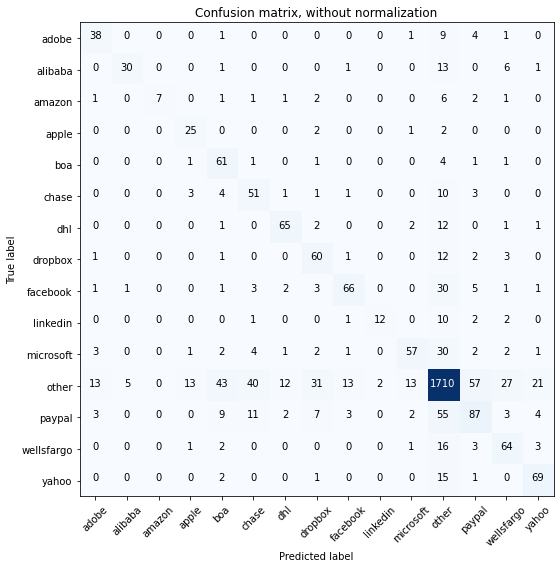

Acc     =  0.78
Pre     =  0.798
Rec     =  0.78
F1      =  0.783

Bal_Acc =  0.659
Bal_Pre =  0.685
Bal_Rec =  0.659
Bal_F1  =  0.672

              precision    recall  f1-score   support

       adobe       0.63      0.70      0.67        54
     alibaba       0.83      0.58      0.68        52
      amazon       1.00      0.32      0.48        22
       apple       0.57      0.83      0.68        30
         boa       0.47      0.87      0.61        70
       chase       0.46      0.69      0.55        74
         dhl       0.77      0.77      0.77        84
     dropbox       0.54      0.75      0.63        80
    facebook       0.76      0.58      0.66       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.74      0.54      0.62       106
       other       0.88      0.85      0.87      2000
      paypal       0.51      0.47      0.49       186
  wellsfargo       0.57      0.71      0.63        90
       yahoo       0.68      0.78      0.73        88

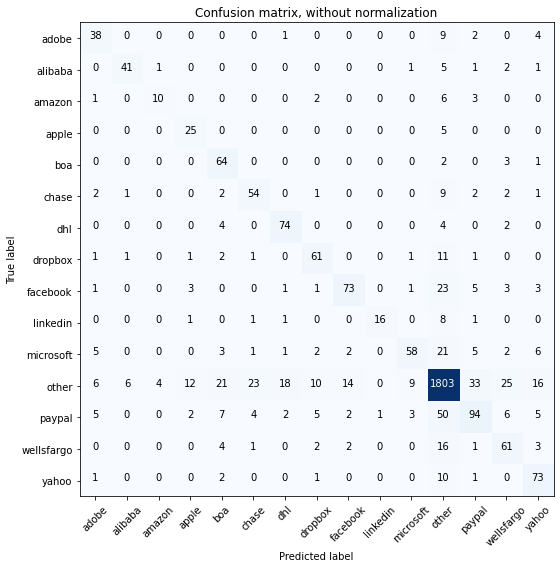

Acc     =  0.827
Pre     =  0.833
Rec     =  0.827
F1      =  0.826

Bal_Acc =  0.716
Bal_Pre =  0.712
Bal_Rec =  0.716
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.63      0.70      0.67        54
     alibaba       0.84      0.79      0.81        52
      amazon       0.67      0.45      0.54        22
       apple       0.57      0.83      0.68        30
         boa       0.59      0.91      0.72        70
       chase       0.64      0.73      0.68        74
         dhl       0.76      0.88      0.81        84
     dropbox       0.72      0.76      0.74        80
    facebook       0.78      0.64      0.71       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.79      0.55      0.65       106
       other       0.91      0.90      0.91      2000
      paypal       0.63      0.51      0.56       186
  wellsfargo       0.58      0.68      0.62        90
       yahoo       0.65      0.83      0.73        

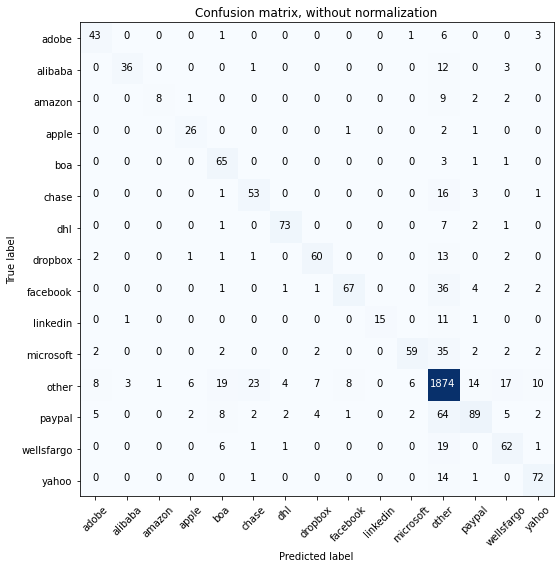

Acc     =  0.845
Pre     =  0.847
Rec     =  0.845
F1      =  0.839

Bal_Acc =  0.706
Bal_Pre =  0.799
Bal_Rec =  0.706
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.72      0.80      0.75        54
     alibaba       0.90      0.69      0.78        52
      amazon       0.89      0.36      0.52        22
       apple       0.72      0.87      0.79        30
         boa       0.62      0.93      0.74        70
       chase       0.65      0.72      0.68        74
         dhl       0.90      0.87      0.88        84
     dropbox       0.81      0.75      0.78        80
    facebook       0.87      0.59      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.87      0.56      0.68       106
       other       0.88      0.94      0.91      2000
      paypal       0.74      0.48      0.58       186
  wellsfargo       0.64      0.69      0.66        90
       yahoo       0.77      0.82      0.80        8

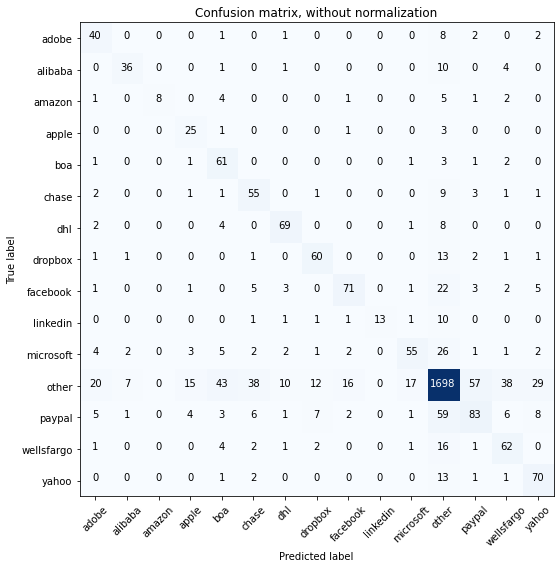

Acc     =  0.782
Pre     =  0.802
Rec     =  0.782
F1      =  0.785

Bal_Acc =  0.68
Bal_Pre =  0.682
Bal_Rec =  0.68
Bal_F1  =  0.681

              precision    recall  f1-score   support

       adobe       0.51      0.74      0.61        54
     alibaba       0.77      0.69      0.73        52
      amazon       1.00      0.36      0.53        22
       apple       0.50      0.83      0.62        30
         boa       0.47      0.87      0.61        70
       chase       0.49      0.74      0.59        74
         dhl       0.78      0.82      0.80        84
     dropbox       0.71      0.75      0.73        80
    facebook       0.76      0.62      0.68       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.71      0.52      0.60       106
       other       0.89      0.85      0.87      2000
      paypal       0.54      0.45      0.49       186
  wellsfargo       0.52      0.69      0.59        90
       yahoo       0.59      0.80      0.68        88

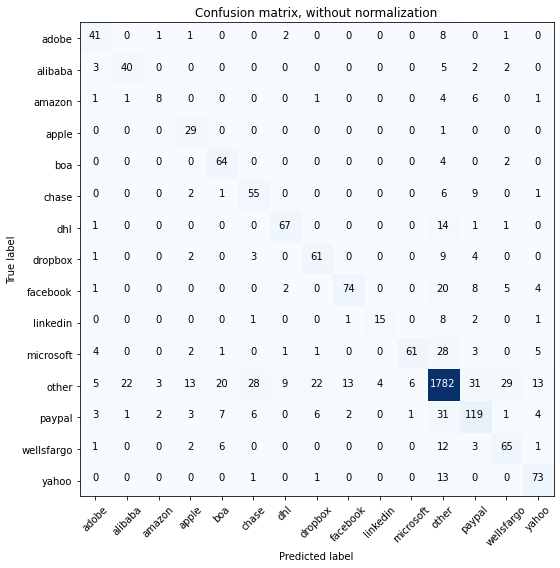

Acc     =  0.83
Pre     =  0.841
Rec     =  0.83
F1      =  0.831

Bal_Acc =  0.728
Bal_Pre =  0.7
Bal_Rec =  0.728
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.67      0.76      0.71        54
     alibaba       0.62      0.77      0.69        52
      amazon       0.57      0.36      0.44        22
       apple       0.54      0.97      0.69        30
         boa       0.65      0.91      0.76        70
       chase       0.59      0.74      0.65        74
         dhl       0.83      0.80      0.81        84
     dropbox       0.66      0.76      0.71        80
    facebook       0.82      0.65      0.73       114
    linkedin       0.79      0.54      0.64        28
   microsoft       0.90      0.58      0.70       106
       other       0.92      0.89      0.90      2000
      paypal       0.63      0.64      0.64       186
  wellsfargo       0.61      0.72      0.66        90
       yahoo       0.71      0.83      0.76        88



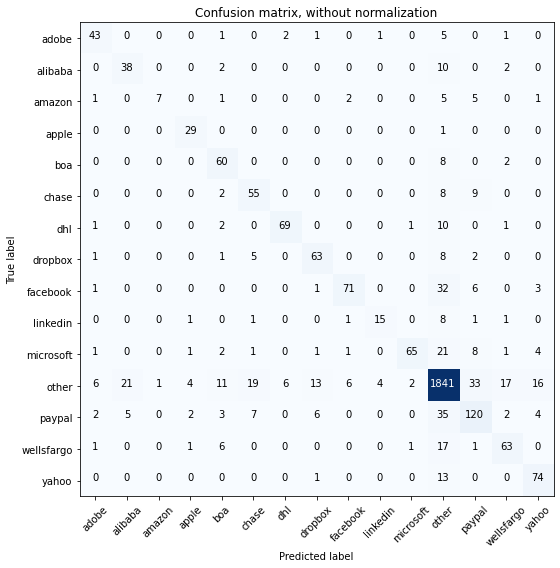

Acc     =  0.849
Pre     =  0.854
Rec     =  0.849
F1      =  0.848

Bal_Acc =  0.727
Bal_Pre =  0.763
Bal_Rec =  0.727
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.75      0.80      0.77        54
     alibaba       0.59      0.73      0.66        52
      amazon       0.88      0.32      0.47        22
       apple       0.76      0.97      0.85        30
         boa       0.66      0.86      0.75        70
       chase       0.62      0.74      0.68        74
         dhl       0.90      0.82      0.86        84
     dropbox       0.73      0.79      0.76        80
    facebook       0.88      0.62      0.73       114
    linkedin       0.75      0.54      0.63        28
   microsoft       0.94      0.61      0.74       106
       other       0.91      0.92      0.92      2000
      paypal       0.65      0.65      0.65       186
  wellsfargo       0.70      0.70      0.70        90
       yahoo       0.73      0.84      0.78        

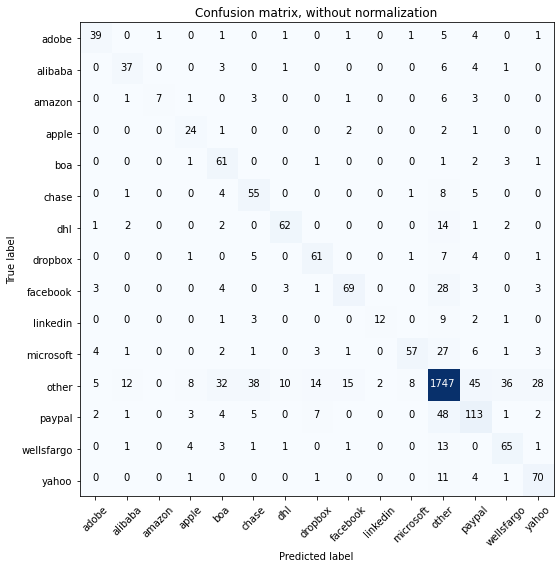

Acc     =  0.805
Pre     =  0.821
Rec     =  0.805
F1      =  0.808

Bal_Acc =  0.682
Bal_Pre =  0.699
Bal_Rec =  0.682
Bal_F1  =  0.69

              precision    recall  f1-score   support

       adobe       0.72      0.72      0.72        54
     alibaba       0.66      0.71      0.69        52
      amazon       0.88      0.32      0.47        22
       apple       0.56      0.80      0.66        30
         boa       0.52      0.87      0.65        70
       chase       0.50      0.74      0.59        74
         dhl       0.79      0.74      0.77        84
     dropbox       0.69      0.76      0.73        80
    facebook       0.77      0.61      0.68       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.84      0.54      0.66       106
       other       0.90      0.87      0.89      2000
      paypal       0.57      0.61      0.59       186
  wellsfargo       0.59      0.72      0.65        90
       yahoo       0.64      0.80      0.71        8

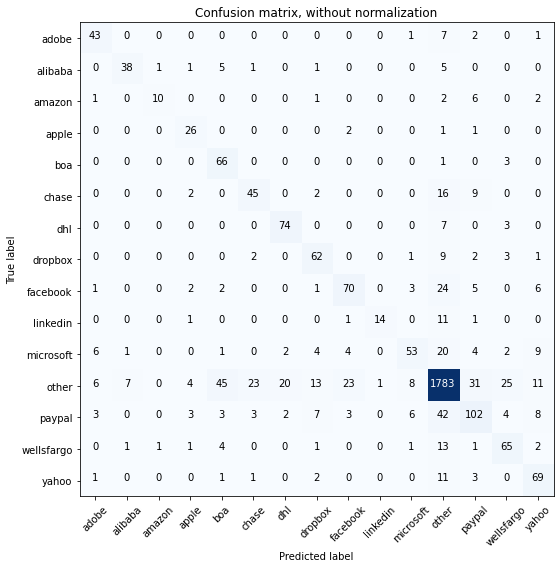

Acc     =  0.819
Pre     =  0.828
Rec     =  0.819
F1      =  0.819

Bal_Acc =  0.708
Bal_Pre =  0.71
Bal_Rec =  0.708
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.70      0.80      0.75        54
     alibaba       0.81      0.73      0.77        52
      amazon       0.83      0.45      0.59        22
       apple       0.65      0.87      0.74        30
         boa       0.52      0.94      0.67        70
       chase       0.60      0.61      0.60        74
         dhl       0.76      0.88      0.81        84
     dropbox       0.66      0.78      0.71        80
    facebook       0.68      0.61      0.65       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.73      0.50      0.59       106
       other       0.91      0.89      0.90      2000
      paypal       0.61      0.55      0.58       186
  wellsfargo       0.62      0.72      0.67        90
       yahoo       0.63      0.78      0.70        8

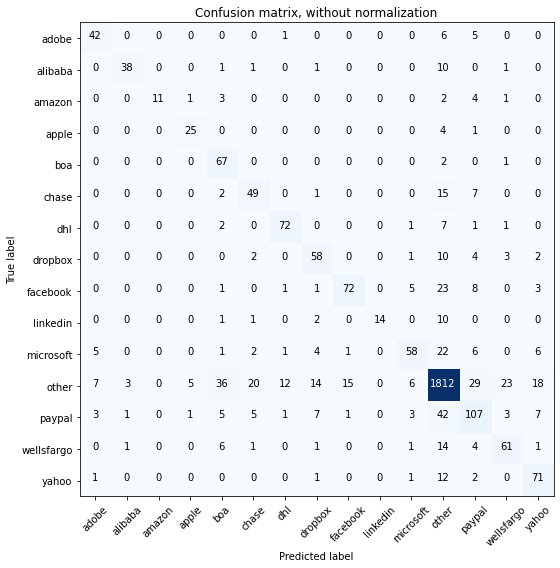

Acc     =  0.831
Pre     =  0.839
Rec     =  0.831
F1      =  0.831

Bal_Acc =  0.713
Bal_Pre =  0.759
Bal_Rec =  0.713
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        54
     alibaba       0.88      0.73      0.80        52
      amazon       1.00      0.50      0.67        22
       apple       0.78      0.83      0.81        30
         boa       0.54      0.96      0.69        70
       chase       0.60      0.66      0.63        74
         dhl       0.82      0.86      0.84        84
     dropbox       0.64      0.72      0.68        80
    facebook       0.81      0.63      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.76      0.55      0.64       106
       other       0.91      0.91      0.91      2000
      paypal       0.60      0.58      0.59       186
  wellsfargo       0.65      0.68      0.66        90
       yahoo       0.66      0.81      0.72        

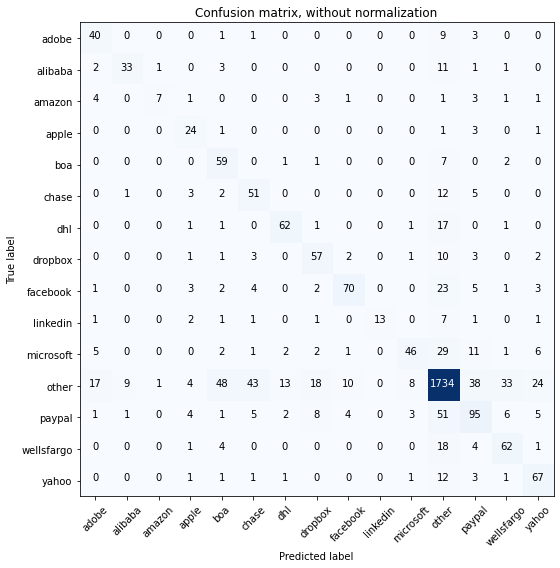

Acc     =  0.786
Pre     =  0.804
Rec     =  0.786
F1      =  0.788

Bal_Acc =  0.654
Bal_Pre =  0.673
Bal_Rec =  0.654
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.56      0.74      0.64        54
     alibaba       0.75      0.63      0.69        52
      amazon       0.78      0.32      0.45        22
       apple       0.53      0.80      0.64        30
         boa       0.46      0.84      0.60        70
       chase       0.46      0.69      0.55        74
         dhl       0.77      0.74      0.75        84
     dropbox       0.61      0.71      0.66        80
    facebook       0.80      0.61      0.69       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.77      0.43      0.55       106
       other       0.89      0.87      0.88      2000
      paypal       0.54      0.51      0.53       186
  wellsfargo       0.57      0.69      0.62        90
       yahoo       0.60      0.76      0.67        

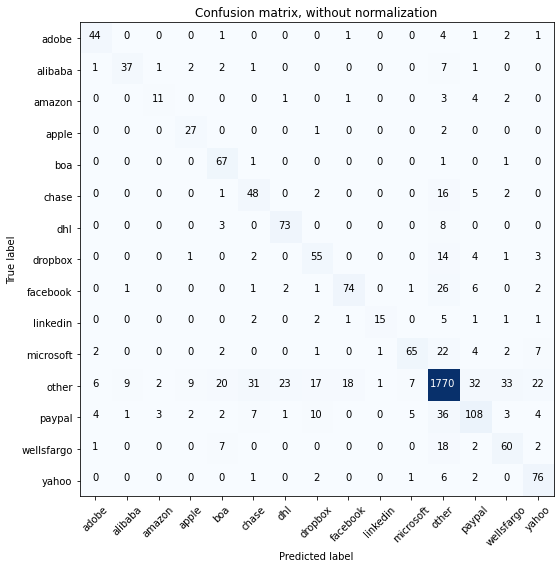

Acc     =  0.822
Pre     =  0.832
Rec     =  0.822
F1      =  0.823

Bal_Acc =  0.726
Bal_Pre =  0.704
Bal_Rec =  0.726
Bal_F1  =  0.715

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        54
     alibaba       0.77      0.71      0.74        52
      amazon       0.65      0.50      0.56        22
       apple       0.66      0.90      0.76        30
         boa       0.64      0.96      0.77        70
       chase       0.51      0.65      0.57        74
         dhl       0.73      0.87      0.79        84
     dropbox       0.60      0.69      0.64        80
    facebook       0.78      0.65      0.71       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.82      0.61      0.70       106
       other       0.91      0.89      0.90      2000
      paypal       0.64      0.58      0.61       186
  wellsfargo       0.56      0.67      0.61        90
       yahoo       0.64      0.86      0.74        

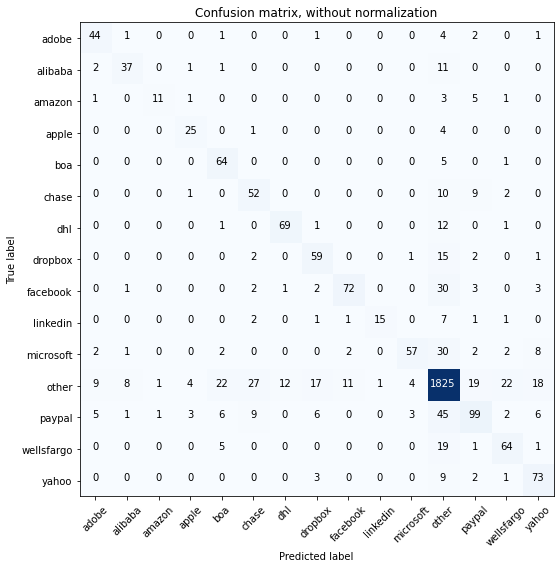

Acc     =  0.834
Pre     =  0.839
Rec     =  0.834
F1      =  0.832

Bal_Acc =  0.715
Bal_Pre =  0.749
Bal_Rec =  0.715
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.70      0.81      0.75        54
     alibaba       0.76      0.71      0.73        52
      amazon       0.85      0.50      0.63        22
       apple       0.71      0.83      0.77        30
         boa       0.63      0.91      0.74        70
       chase       0.55      0.70      0.62        74
         dhl       0.84      0.82      0.83        84
     dropbox       0.66      0.74      0.69        80
    facebook       0.84      0.63      0.72       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.88      0.54      0.67       106
       other       0.90      0.91      0.91      2000
      paypal       0.68      0.53      0.60       186
  wellsfargo       0.66      0.71      0.68        90
       yahoo       0.66      0.83      0.73        

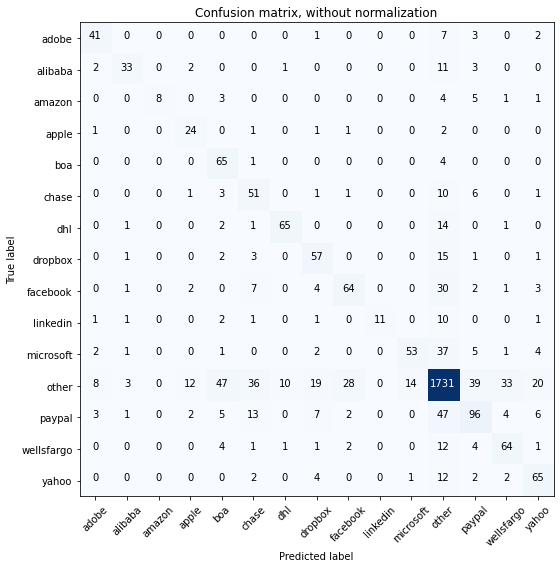

Acc     =  0.789
Pre     =  0.806
Rec     =  0.789
F1      =  0.791

Bal_Acc =  0.663
Bal_Pre =  0.701
Bal_Rec =  0.663
Bal_F1  =  0.681

              precision    recall  f1-score   support

       adobe       0.71      0.76      0.73        54
     alibaba       0.79      0.63      0.70        52
      amazon       1.00      0.36      0.53        22
       apple       0.56      0.80      0.66        30
         boa       0.49      0.93      0.64        70
       chase       0.44      0.69      0.53        74
         dhl       0.84      0.77      0.81        84
     dropbox       0.58      0.71      0.64        80
    facebook       0.65      0.56      0.60       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.78      0.50      0.61       106
       other       0.89      0.87      0.88      2000
      paypal       0.58      0.52      0.55       186
  wellsfargo       0.60      0.71      0.65        90
       yahoo       0.62      0.74      0.67        

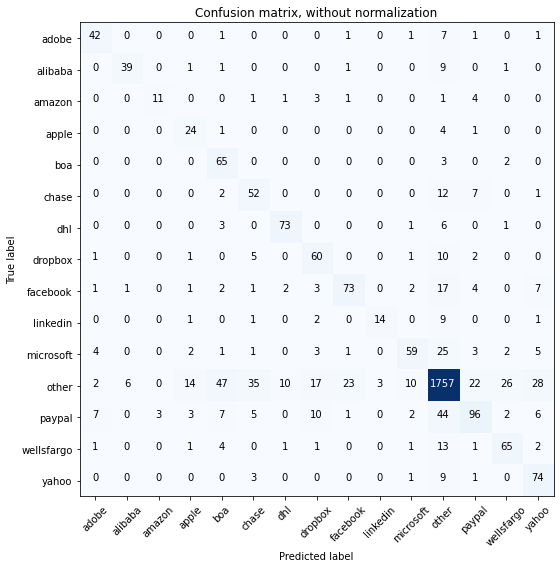

Acc     =  0.814
Pre     =  0.829
Rec     =  0.814
F1      =  0.816

Bal_Acc =  0.716
Bal_Pre =  0.695
Bal_Rec =  0.716
Bal_F1  =  0.705

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        54
     alibaba       0.85      0.75      0.80        52
      amazon       0.79      0.50      0.61        22
       apple       0.50      0.80      0.62        30
         boa       0.49      0.93      0.64        70
       chase       0.50      0.70      0.58        74
         dhl       0.84      0.87      0.85        84
     dropbox       0.61      0.75      0.67        80
    facebook       0.72      0.64      0.68       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.76      0.56      0.64       106
       other       0.91      0.88      0.90      2000
      paypal       0.68      0.52      0.59       186
  wellsfargo       0.66      0.72      0.69        90
       yahoo       0.59      0.84      0.69        

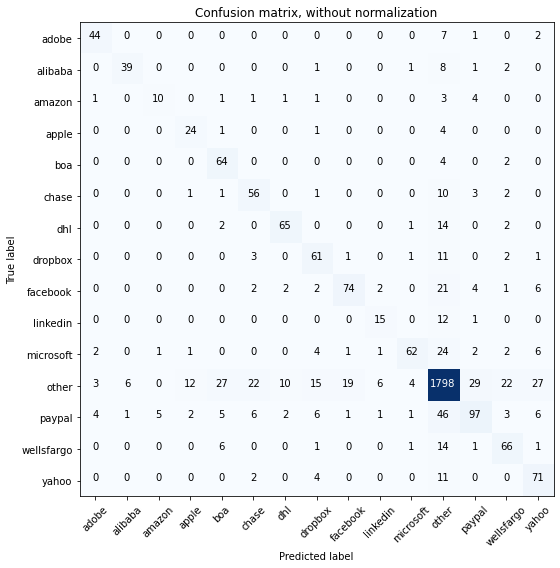

Acc     =  0.827
Pre     =  0.834
Rec     =  0.827
F1      =  0.827

Bal_Acc =  0.717
Bal_Pre =  0.706
Bal_Rec =  0.717
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.81      0.81      0.81        54
     alibaba       0.85      0.75      0.80        52
      amazon       0.62      0.45      0.53        22
       apple       0.60      0.80      0.69        30
         boa       0.60      0.91      0.72        70
       chase       0.61      0.76      0.67        74
         dhl       0.81      0.77      0.79        84
     dropbox       0.63      0.76      0.69        80
    facebook       0.77      0.65      0.70       114
    linkedin       0.60      0.54      0.57        28
   microsoft       0.87      0.58      0.70       106
       other       0.90      0.90      0.90      2000
      paypal       0.68      0.52      0.59       186
  wellsfargo       0.63      0.73      0.68        90
       yahoo       0.59      0.81      0.68        

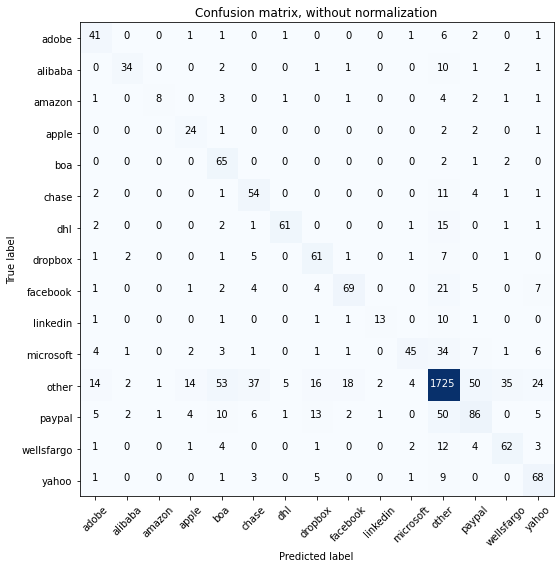

Acc     =  0.785
Pre     =  0.808
Rec     =  0.785
F1      =  0.788

Bal_Acc =  0.667
Bal_Pre =  0.669
Bal_Rec =  0.667
Bal_F1  =  0.668

              precision    recall  f1-score   support

       adobe       0.55      0.76      0.64        54
     alibaba       0.83      0.65      0.73        52
      amazon       0.80      0.36      0.50        22
       apple       0.51      0.80      0.62        30
         boa       0.43      0.93      0.59        70
       chase       0.49      0.73      0.58        74
         dhl       0.88      0.73      0.80        84
     dropbox       0.59      0.76      0.67        80
    facebook       0.73      0.61      0.66       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.82      0.42      0.56       106
       other       0.90      0.86      0.88      2000
      paypal       0.52      0.46      0.49       186
  wellsfargo       0.58      0.69      0.63        90
       yahoo       0.57      0.77      0.66        

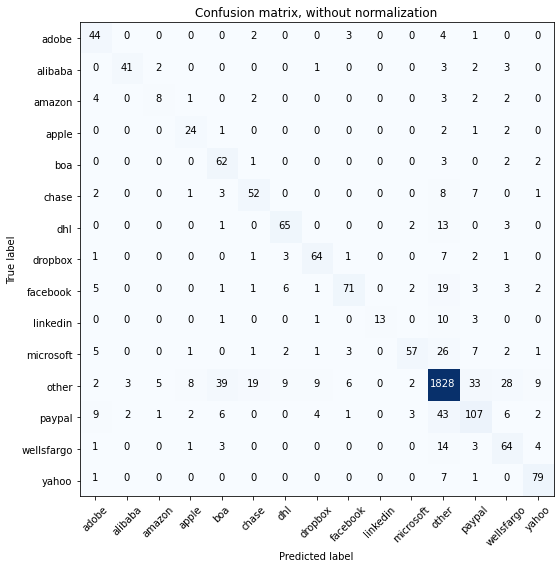

Acc     =  0.838
Pre     =  0.847
Rec     =  0.838
F1      =  0.838

Bal_Acc =  0.71
Bal_Pre =  0.729
Bal_Rec =  0.71
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.50      0.36      0.42        22
       apple       0.63      0.80      0.71        30
         boa       0.53      0.89      0.66        70
       chase       0.66      0.70      0.68        74
         dhl       0.76      0.77      0.77        84
     dropbox       0.79      0.80      0.80        80
    facebook       0.84      0.62      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.86      0.54      0.66       106
       other       0.92      0.91      0.92      2000
      paypal       0.62      0.58      0.60       186
  wellsfargo       0.55      0.71      0.62        90
       yahoo       0.79      0.90      0.84        88

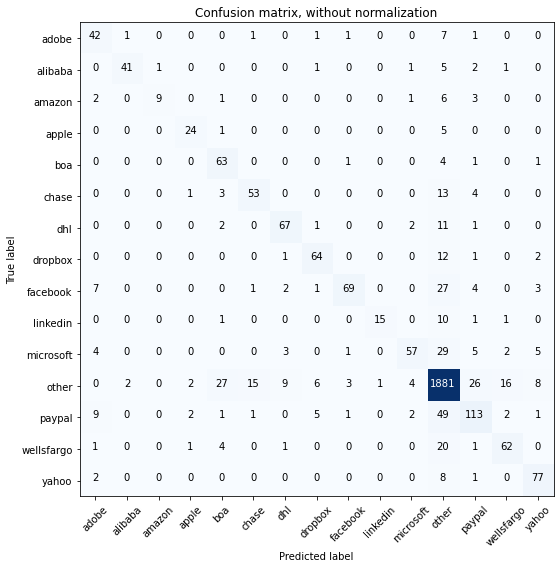

Acc     =  0.857
Pre     =  0.859
Rec     =  0.857
F1      =  0.853

Bal_Acc =  0.719
Bal_Pre =  0.804
Bal_Rec =  0.719
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.63      0.78      0.69        54
     alibaba       0.93      0.79      0.85        52
      amazon       0.90      0.41      0.56        22
       apple       0.80      0.80      0.80        30
         boa       0.61      0.90      0.73        70
       chase       0.75      0.72      0.73        74
         dhl       0.81      0.80      0.80        84
     dropbox       0.81      0.80      0.81        80
    facebook       0.91      0.61      0.73       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.85      0.54      0.66       106
       other       0.90      0.94      0.92      2000
      paypal       0.69      0.61      0.65       186
  wellsfargo       0.74      0.69      0.71        90
       yahoo       0.79      0.88      0.83        

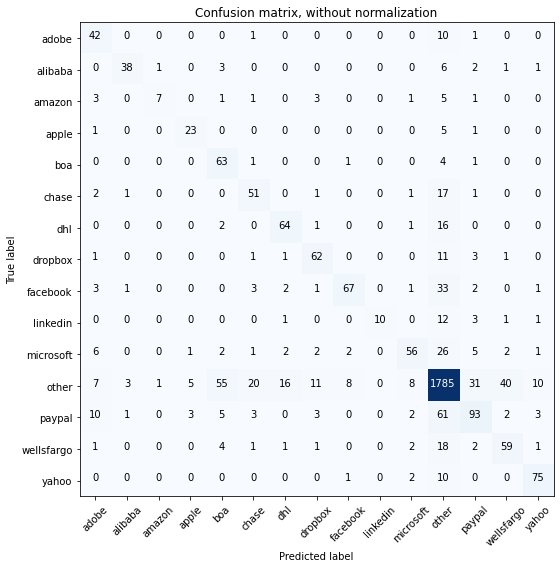

Acc     =  0.811
Pre     =  0.82
Rec     =  0.811
F1      =  0.809

Bal_Acc =  0.673
Bal_Pre =  0.73
Bal_Rec =  0.673
Bal_F1  =  0.7

              precision    recall  f1-score   support

       adobe       0.55      0.78      0.65        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.78      0.32      0.45        22
       apple       0.72      0.77      0.74        30
         boa       0.47      0.90      0.61        70
       chase       0.61      0.69      0.65        74
         dhl       0.74      0.76      0.75        84
     dropbox       0.73      0.78      0.75        80
    facebook       0.85      0.59      0.69       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.76      0.53      0.62       106
       other       0.88      0.89      0.89      2000
      paypal       0.64      0.50      0.56       186
  wellsfargo       0.56      0.66      0.60        90
       yahoo       0.81      0.85      0.83        88



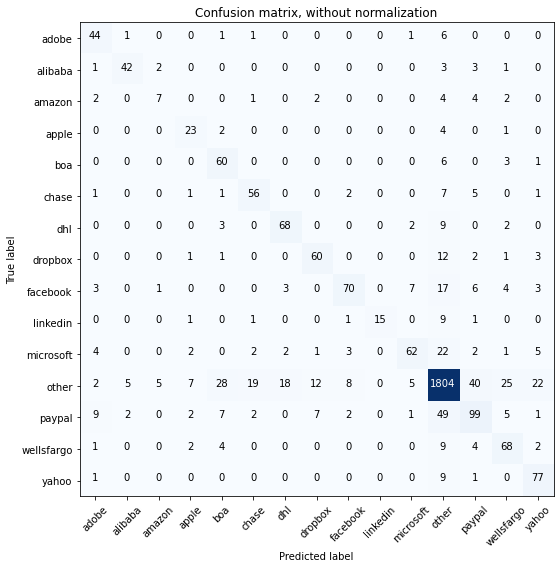

Acc     =  0.83
Pre     =  0.837
Rec     =  0.83
F1      =  0.83

Bal_Acc =  0.712
Bal_Pre =  0.71
Bal_Rec =  0.712
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        54
     alibaba       0.84      0.81      0.82        52
      amazon       0.47      0.32      0.38        22
       apple       0.59      0.77      0.67        30
         boa       0.56      0.86      0.68        70
       chase       0.68      0.76      0.72        74
         dhl       0.75      0.81      0.78        84
     dropbox       0.73      0.75      0.74        80
    facebook       0.81      0.61      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.79      0.58      0.67       106
       other       0.92      0.90      0.91      2000
      paypal       0.59      0.53      0.56       186
  wellsfargo       0.60      0.76      0.67        90
       yahoo       0.67      0.88      0.76        88



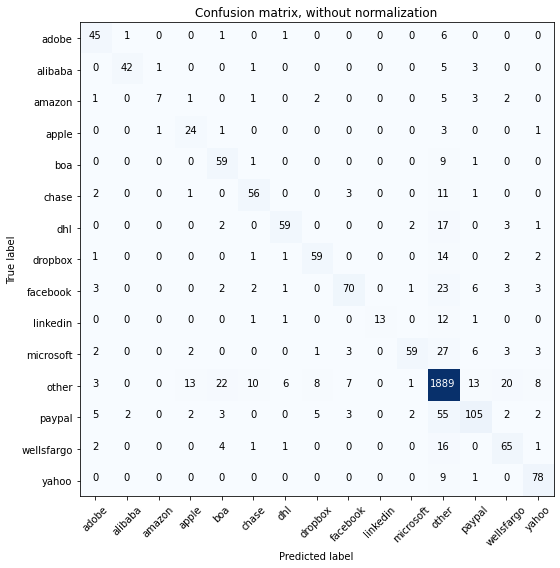

Acc     =  0.854
Pre     =  0.857
Rec     =  0.854
F1      =  0.85

Bal_Acc =  0.703
Bal_Pre =  0.786
Bal_Rec =  0.703
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.70      0.83      0.76        54
     alibaba       0.93      0.81      0.87        52
      amazon       0.78      0.32      0.45        22
       apple       0.56      0.80      0.66        30
         boa       0.63      0.84      0.72        70
       chase       0.76      0.76      0.76        74
         dhl       0.84      0.70      0.77        84
     dropbox       0.79      0.74      0.76        80
    facebook       0.81      0.61      0.70       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.91      0.56      0.69       106
       other       0.90      0.94      0.92      2000
      paypal       0.75      0.56      0.64       186
  wellsfargo       0.65      0.72      0.68        90
       yahoo       0.79      0.89      0.83        8

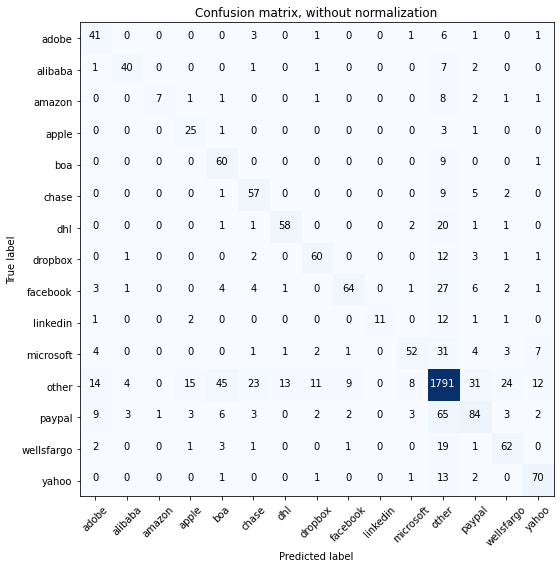

Acc     =  0.806
Pre     =  0.815
Rec     =  0.806
F1      =  0.804

Bal_Acc =  0.668
Bal_Pre =  0.721
Bal_Rec =  0.668
Bal_F1  =  0.693

              precision    recall  f1-score   support

       adobe       0.55      0.76      0.64        54
     alibaba       0.82      0.77      0.79        52
      amazon       0.88      0.32      0.47        22
       apple       0.53      0.83      0.65        30
         boa       0.49      0.86      0.62        70
       chase       0.59      0.77      0.67        74
         dhl       0.79      0.69      0.74        84
     dropbox       0.76      0.75      0.75        80
    facebook       0.83      0.56      0.67       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.76      0.49      0.60       106
       other       0.88      0.90      0.89      2000
      paypal       0.58      0.45      0.51       186
  wellsfargo       0.62      0.69      0.65        90
       yahoo       0.73      0.80      0.76        

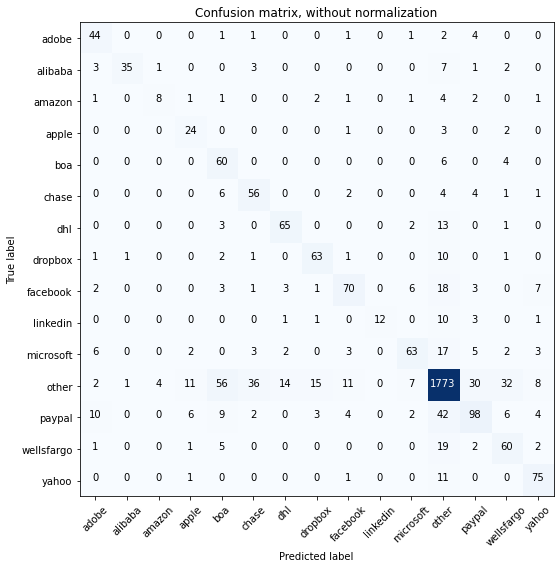

Acc     =  0.814
Pre     =  0.832
Rec     =  0.814
F1      =  0.817

Bal_Acc =  0.693
Bal_Pre =  0.701
Bal_Rec =  0.693
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        54
     alibaba       0.95      0.67      0.79        52
      amazon       0.62      0.36      0.46        22
       apple       0.52      0.80      0.63        30
         boa       0.41      0.86      0.56        70
       chase       0.54      0.76      0.63        74
         dhl       0.76      0.77      0.77        84
     dropbox       0.74      0.79      0.76        80
    facebook       0.74      0.61      0.67       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.77      0.59      0.67       106
       other       0.91      0.89      0.90      2000
      paypal       0.64      0.53      0.58       186
  wellsfargo       0.54      0.67      0.60        90
       yahoo       0.74      0.85      0.79        

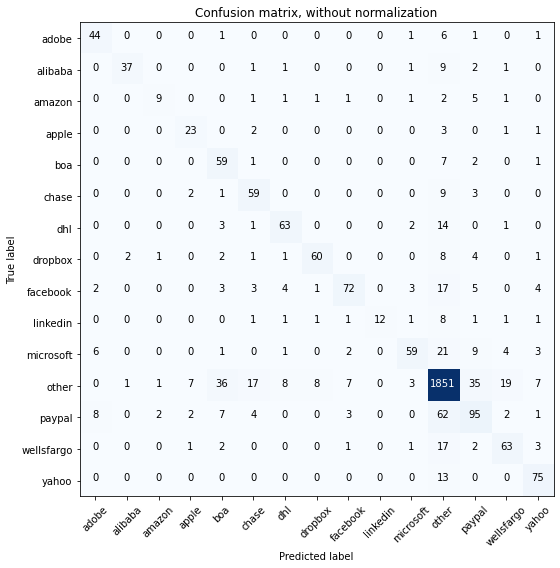

Acc     =  0.839
Pre     =  0.843
Rec     =  0.839
F1      =  0.836

Bal_Acc =  0.697
Bal_Pre =  0.758
Bal_Rec =  0.697
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        54
     alibaba       0.93      0.71      0.80        52
      amazon       0.69      0.41      0.51        22
       apple       0.66      0.77      0.71        30
         boa       0.51      0.84      0.64        70
       chase       0.65      0.80      0.72        74
         dhl       0.79      0.75      0.77        84
     dropbox       0.85      0.75      0.79        80
    facebook       0.83      0.63      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.82      0.56      0.66       106
       other       0.90      0.93      0.91      2000
      paypal       0.58      0.51      0.54       186
  wellsfargo       0.68      0.70      0.69        90
       yahoo       0.77      0.85      0.81        

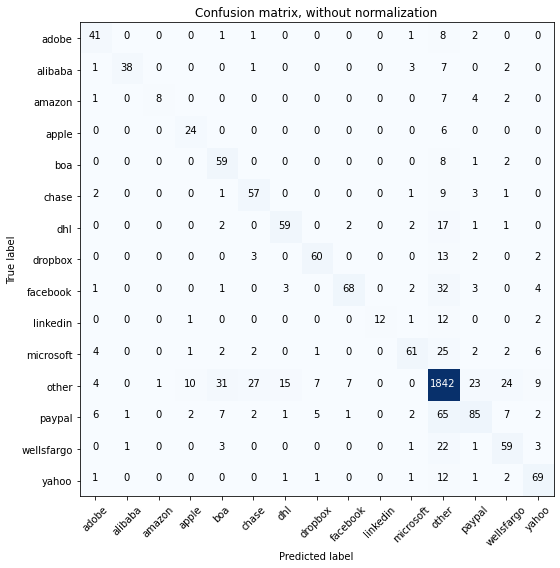

Acc     =  0.826
Pre     =  0.83
Rec     =  0.826
F1      =  0.822

Bal_Acc =  0.676
Bal_Pre =  0.759
Bal_Rec =  0.676
Bal_F1  =  0.715

              precision    recall  f1-score   support

       adobe       0.67      0.76      0.71        54
     alibaba       0.95      0.73      0.83        52
      amazon       0.89      0.36      0.52        22
       apple       0.63      0.80      0.71        30
         boa       0.55      0.84      0.67        70
       chase       0.61      0.77      0.68        74
         dhl       0.75      0.70      0.72        84
     dropbox       0.81      0.75      0.78        80
    facebook       0.87      0.60      0.71       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.81      0.58      0.67       106
       other       0.88      0.92      0.90      2000
      paypal       0.66      0.46      0.54       186
  wellsfargo       0.58      0.66      0.61        90
       yahoo       0.71      0.78      0.75        8

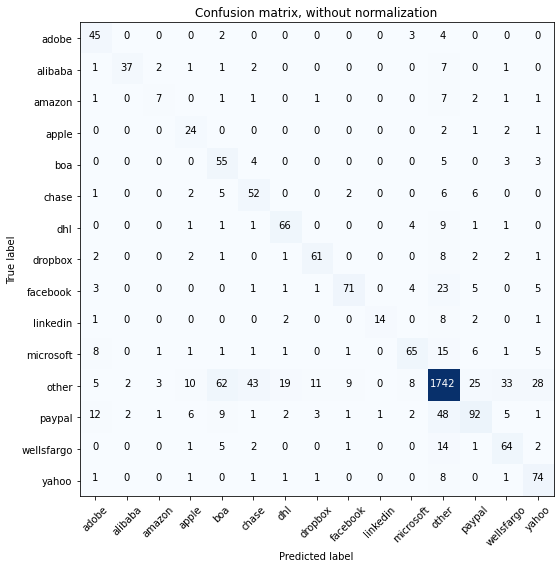

Acc     =  0.802
Pre     =  0.825
Rec     =  0.802
F1      =  0.807

Bal_Acc =  0.69
Bal_Pre =  0.671
Bal_Rec =  0.69
Bal_F1  =  0.68

              precision    recall  f1-score   support

       adobe       0.56      0.83      0.67        54
     alibaba       0.90      0.71      0.80        52
      amazon       0.50      0.32      0.39        22
       apple       0.49      0.80      0.61        30
         boa       0.38      0.79      0.52        70
       chase       0.48      0.70      0.57        74
         dhl       0.71      0.79      0.75        84
     dropbox       0.78      0.76      0.77        80
    facebook       0.84      0.62      0.71       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.76      0.61      0.68       106
       other       0.91      0.87      0.89      2000
      paypal       0.64      0.49      0.56       186
  wellsfargo       0.56      0.71      0.63        90
       yahoo       0.61      0.84      0.70        88


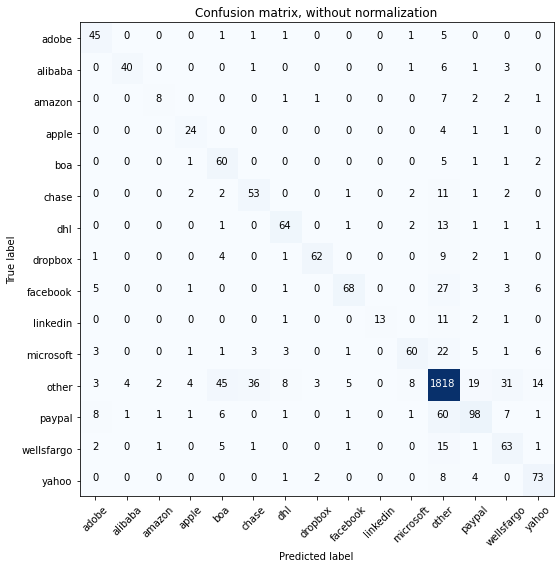

Acc     =  0.828
Pre     =  0.839
Rec     =  0.828
F1      =  0.828

Bal_Acc =  0.698
Bal_Pre =  0.744
Bal_Rec =  0.698
Bal_F1  =  0.72

              precision    recall  f1-score   support

       adobe       0.67      0.83      0.74        54
     alibaba       0.89      0.77      0.82        52
      amazon       0.67      0.36      0.47        22
       apple       0.71      0.80      0.75        30
         boa       0.48      0.86      0.62        70
       chase       0.56      0.72      0.63        74
         dhl       0.78      0.76      0.77        84
     dropbox       0.91      0.78      0.84        80
    facebook       0.87      0.60      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.80      0.57      0.66       106
       other       0.90      0.91      0.90      2000
      paypal       0.70      0.53      0.60       186
  wellsfargo       0.54      0.70      0.61        90
       yahoo       0.70      0.83      0.76        8

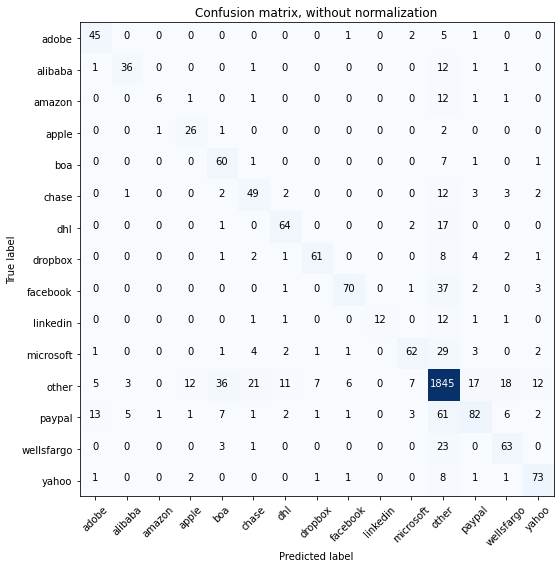

Acc     =  0.83
Pre     =  0.833
Rec     =  0.83
F1      =  0.824

Bal_Acc =  0.682
Bal_Pre =  0.752
Bal_Rec =  0.682
Bal_F1  =  0.715

              precision    recall  f1-score   support

       adobe       0.68      0.83      0.75        54
     alibaba       0.80      0.69      0.74        52
      amazon       0.75      0.27      0.40        22
       apple       0.62      0.87      0.72        30
         boa       0.54      0.86      0.66        70
       chase       0.60      0.66      0.63        74
         dhl       0.76      0.76      0.76        84
     dropbox       0.86      0.76      0.81        80
    facebook       0.88      0.61      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.81      0.58      0.68       106
       other       0.88      0.92      0.90      2000
      paypal       0.70      0.44      0.54       186
  wellsfargo       0.66      0.70      0.68        90
       yahoo       0.76      0.83      0.79        88

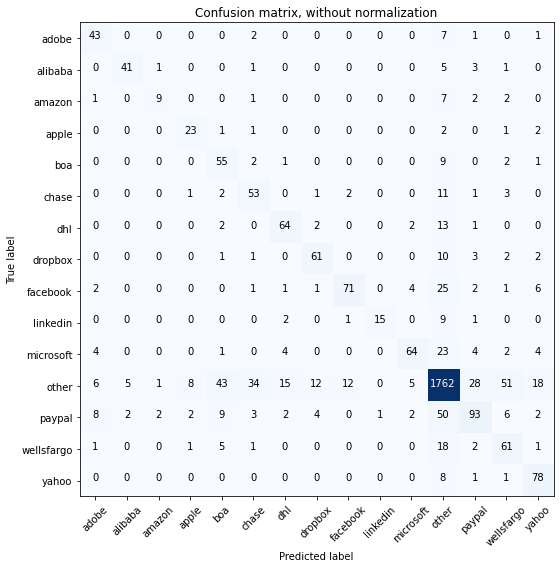

Acc     =  0.81
Pre     =  0.824
Rec     =  0.81
F1      =  0.812

Bal_Acc =  0.7
Bal_Pre =  0.708
Bal_Rec =  0.7
Bal_F1  =  0.704

              precision    recall  f1-score   support

       adobe       0.66      0.80      0.72        54
     alibaba       0.85      0.79      0.82        52
      amazon       0.69      0.41      0.51        22
       apple       0.66      0.77      0.71        30
         boa       0.46      0.79      0.58        70
       chase       0.53      0.72      0.61        74
         dhl       0.72      0.76      0.74        84
     dropbox       0.75      0.76      0.76        80
    facebook       0.83      0.62      0.71       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.83      0.60      0.70       106
       other       0.90      0.88      0.89      2000
      paypal       0.65      0.50      0.57       186
  wellsfargo       0.46      0.68      0.55        90
       yahoo       0.68      0.89      0.77        88

  

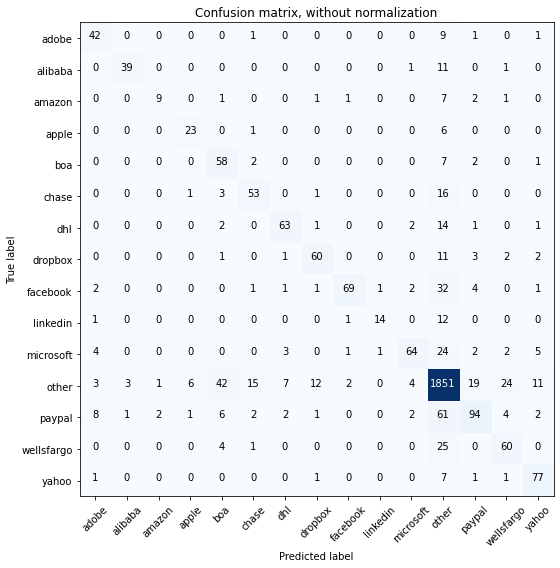

Acc     =  0.837
Pre     =  0.841
Rec     =  0.837
F1      =  0.833

Bal_Acc =  0.695
Bal_Pre =  0.769
Bal_Rec =  0.695
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.91      0.75      0.82        52
      amazon       0.75      0.41      0.53        22
       apple       0.74      0.77      0.75        30
         boa       0.50      0.83      0.62        70
       chase       0.70      0.72      0.71        74
         dhl       0.82      0.75      0.78        84
     dropbox       0.77      0.75      0.76        80
    facebook       0.93      0.61      0.73       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.60      0.71       106
       other       0.88      0.93      0.90      2000
      paypal       0.73      0.51      0.60       186
  wellsfargo       0.63      0.67      0.65        90
       yahoo       0.76      0.88      0.81        8

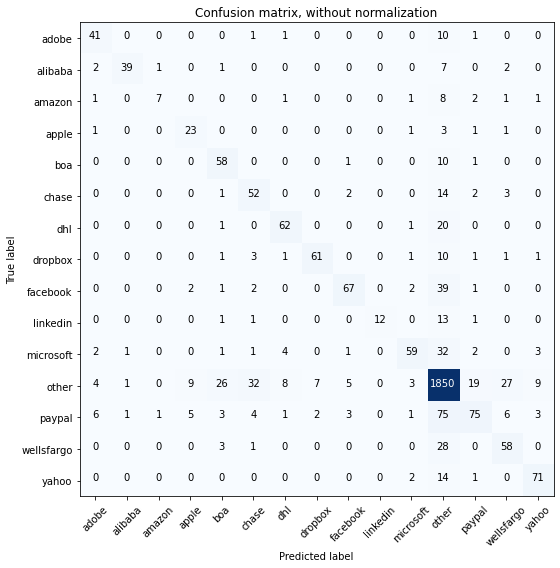

Acc     =  0.824
Pre     =  0.826
Rec     =  0.824
F1      =  0.817

Bal_Acc =  0.665
Bal_Pre =  0.764
Bal_Rec =  0.665
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.72      0.76      0.74        54
     alibaba       0.93      0.75      0.83        52
      amazon       0.78      0.32      0.45        22
       apple       0.59      0.77      0.67        30
         boa       0.60      0.83      0.69        70
       chase       0.54      0.70      0.61        74
         dhl       0.79      0.74      0.77        84
     dropbox       0.87      0.76      0.81        80
    facebook       0.85      0.59      0.69       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.83      0.56      0.67       106
       other       0.87      0.93      0.90      2000
      paypal       0.70      0.40      0.51       186
  wellsfargo       0.59      0.64      0.61        90
       yahoo       0.81      0.81      0.81        

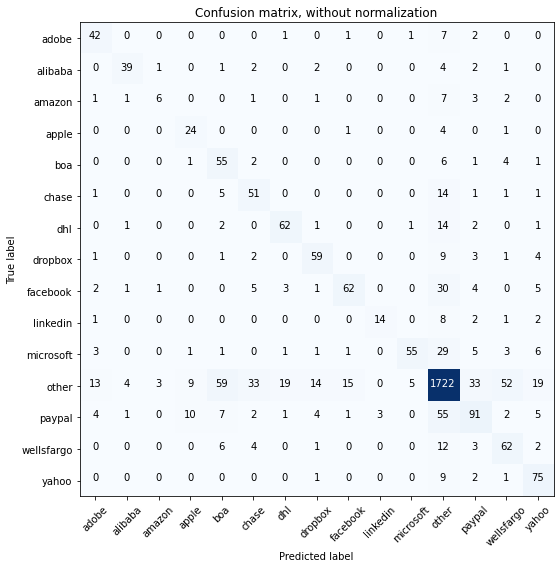

Acc     =  0.786
Pre     =  0.806
Rec     =  0.786
F1      =  0.789

Bal_Acc =  0.667
Bal_Pre =  0.659
Bal_Rec =  0.667
Bal_F1  =  0.663

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        54
     alibaba       0.83      0.75      0.79        52
      amazon       0.55      0.27      0.36        22
       apple       0.53      0.80      0.64        30
         boa       0.40      0.79      0.53        70
       chase       0.50      0.69      0.58        74
         dhl       0.71      0.74      0.73        84
     dropbox       0.69      0.74      0.72        80
    facebook       0.77      0.54      0.64       114
    linkedin       0.82      0.50      0.62        28
   microsoft       0.89      0.52      0.65       106
       other       0.89      0.86      0.88      2000
      paypal       0.59      0.49      0.54       186
  wellsfargo       0.47      0.69      0.56        90
       yahoo       0.62      0.85      0.72        

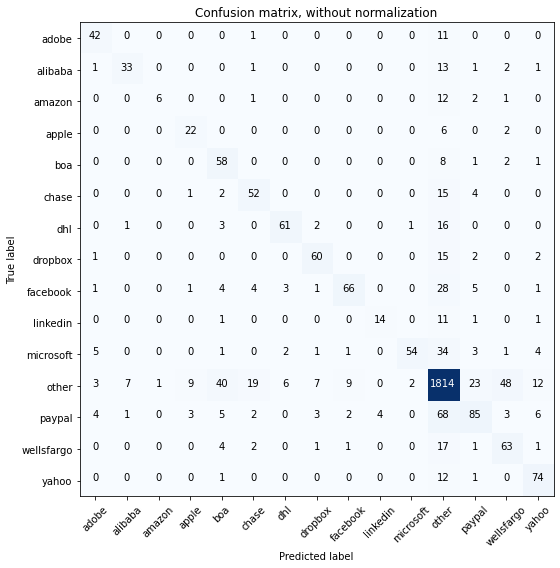

Acc     =  0.814
Pre     =  0.821
Rec     =  0.814
F1      =  0.81

Bal_Acc =  0.661
Bal_Pre =  0.739
Bal_Rec =  0.661
Bal_F1  =  0.698

              precision    recall  f1-score   support

       adobe       0.74      0.78      0.76        54
     alibaba       0.79      0.63      0.70        52
      amazon       0.86      0.27      0.41        22
       apple       0.61      0.73      0.67        30
         boa       0.49      0.83      0.61        70
       chase       0.63      0.70      0.67        74
         dhl       0.85      0.73      0.78        84
     dropbox       0.80      0.75      0.77        80
    facebook       0.84      0.58      0.68       114
    linkedin       0.78      0.50      0.61        28
   microsoft       0.95      0.51      0.66       106
       other       0.87      0.91      0.89      2000
      paypal       0.66      0.46      0.54       186
  wellsfargo       0.52      0.70      0.59        90
       yahoo       0.72      0.84      0.77        8

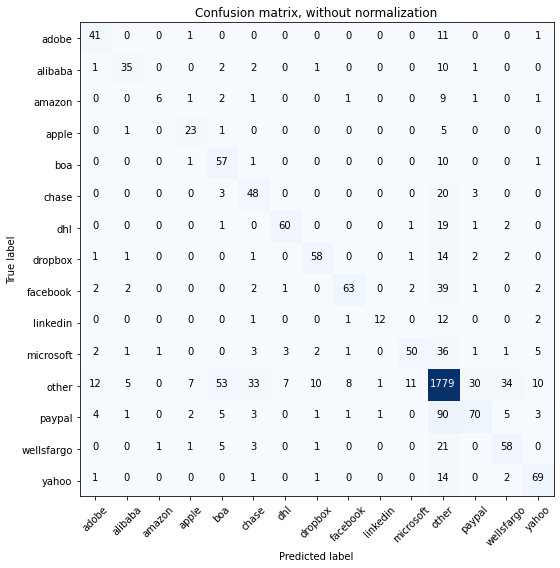

Acc     =  0.789
Pre     =  0.795
Rec     =  0.789
F1      =  0.784

Bal_Acc =  0.635
Bal_Pre =  0.706
Bal_Rec =  0.635
Bal_F1  =  0.669

              precision    recall  f1-score   support

       adobe       0.64      0.76      0.69        54
     alibaba       0.76      0.67      0.71        52
      amazon       0.75      0.27      0.40        22
       apple       0.64      0.77      0.70        30
         boa       0.44      0.81      0.57        70
       chase       0.48      0.65      0.55        74
         dhl       0.85      0.71      0.77        84
     dropbox       0.78      0.72      0.75        80
    facebook       0.84      0.55      0.67       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.77      0.47      0.58       106
       other       0.85      0.89      0.87      2000
      paypal       0.64      0.38      0.47       186
  wellsfargo       0.56      0.64      0.60        90
       yahoo       0.73      0.78      0.76        

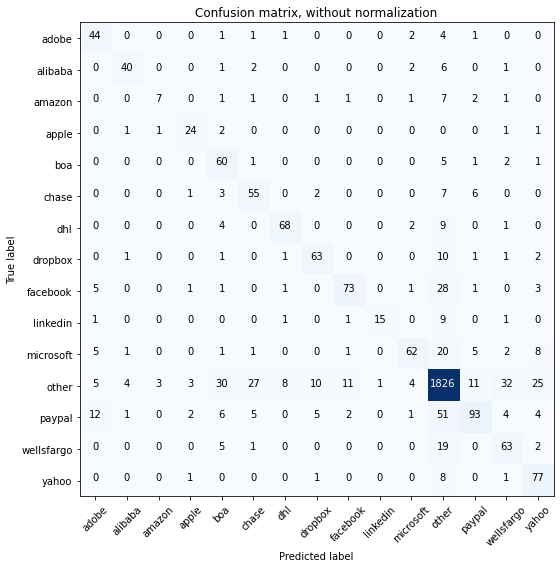

Acc     =  0.835
Pre     =  0.845
Rec     =  0.835
F1      =  0.834

Bal_Acc =  0.71
Bal_Pre =  0.734
Bal_Rec =  0.71
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.64      0.32      0.42        22
       apple       0.75      0.80      0.77        30
         boa       0.52      0.86      0.65        70
       chase       0.59      0.74      0.65        74
         dhl       0.85      0.81      0.83        84
     dropbox       0.77      0.79      0.78        80
    facebook       0.82      0.64      0.72       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.83      0.58      0.69       106
       other       0.91      0.91      0.91      2000
      paypal       0.77      0.50      0.61       186
  wellsfargo       0.57      0.70      0.63        90
       yahoo       0.63      0.88      0.73        88

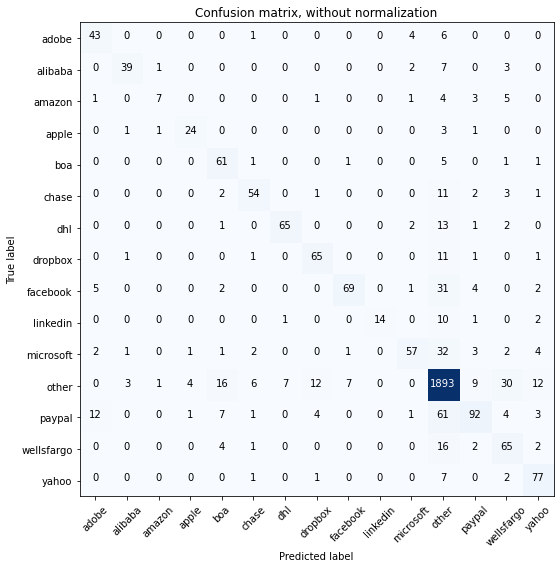

Acc     =  0.853
Pre     =  0.855
Rec     =  0.853
F1      =  0.847

Bal_Acc =  0.702
Bal_Pre =  0.789
Bal_Rec =  0.702
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       0.87      0.75      0.80        52
      amazon       0.70      0.32      0.44        22
       apple       0.80      0.80      0.80        30
         boa       0.65      0.87      0.74        70
       chase       0.79      0.73      0.76        74
         dhl       0.89      0.77      0.83        84
     dropbox       0.77      0.81      0.79        80
    facebook       0.88      0.61      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.84      0.54      0.66       106
       other       0.90      0.95      0.92      2000
      paypal       0.77      0.49      0.60       186
  wellsfargo       0.56      0.72      0.63        90
       yahoo       0.73      0.88      0.80        

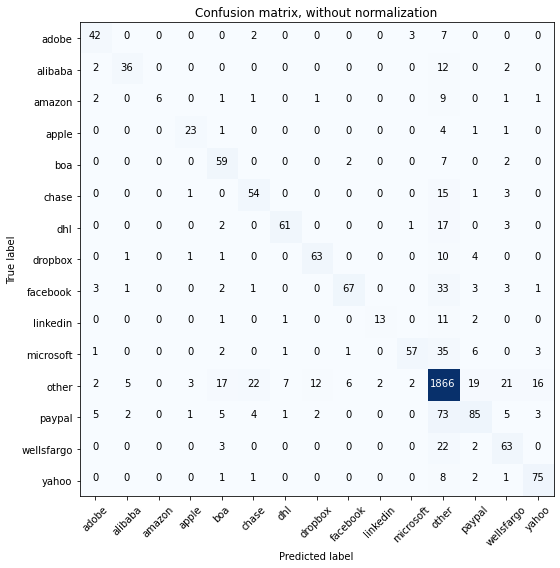

Acc     =  0.835
Pre     =  0.837
Rec     =  0.835
F1      =  0.828

Bal_Acc =  0.675
Bal_Pre =  0.788
Bal_Rec =  0.675
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.74      0.78      0.76        54
     alibaba       0.80      0.69      0.74        52
      amazon       1.00      0.27      0.43        22
       apple       0.79      0.77      0.78        30
         boa       0.62      0.84      0.72        70
       chase       0.64      0.73      0.68        74
         dhl       0.86      0.73      0.79        84
     dropbox       0.81      0.79      0.80        80
    facebook       0.88      0.59      0.71       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.90      0.54      0.67       106
       other       0.88      0.93      0.90      2000
      paypal       0.68      0.46      0.55       186
  wellsfargo       0.60      0.70      0.65        90
       yahoo       0.76      0.85      0.80        

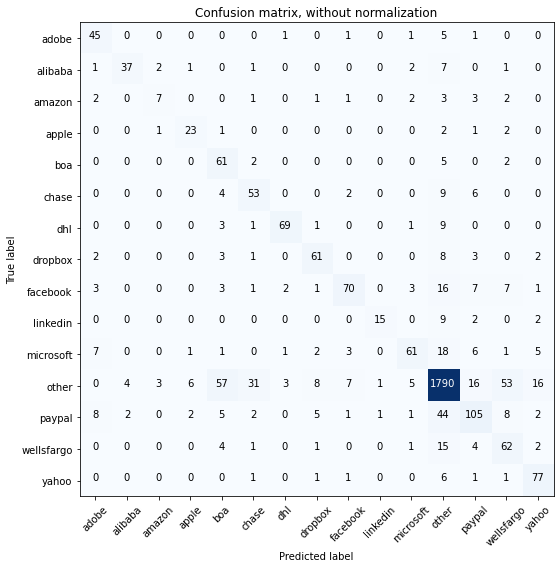

Acc     =  0.824
Pre     =  0.842
Rec     =  0.824
F1      =  0.828

Bal_Acc =  0.703
Bal_Pre =  0.711
Bal_Rec =  0.703
Bal_F1  =  0.707

              precision    recall  f1-score   support

       adobe       0.66      0.83      0.74        54
     alibaba       0.86      0.71      0.78        52
      amazon       0.54      0.32      0.40        22
       apple       0.70      0.77      0.73        30
         boa       0.43      0.87      0.58        70
       chase       0.56      0.72      0.63        74
         dhl       0.91      0.82      0.86        84
     dropbox       0.75      0.76      0.76        80
    facebook       0.81      0.61      0.70       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.79      0.58      0.67       106
       other       0.92      0.90      0.91      2000
      paypal       0.68      0.56      0.62       186
  wellsfargo       0.45      0.69      0.54        90
       yahoo       0.72      0.88      0.79        

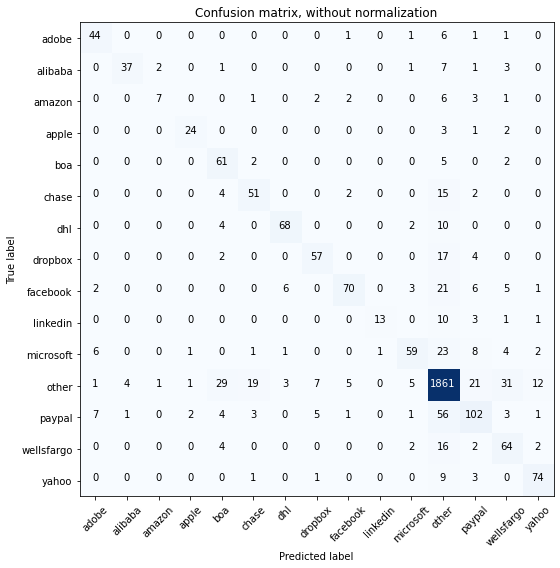

Acc     =  0.842
Pre     =  0.845
Rec     =  0.842
F1      =  0.839

Bal_Acc =  0.693
Bal_Pre =  0.769
Bal_Rec =  0.693
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        54
     alibaba       0.88      0.71      0.79        52
      amazon       0.70      0.32      0.44        22
       apple       0.86      0.80      0.83        30
         boa       0.56      0.87      0.68        70
       chase       0.65      0.69      0.67        74
         dhl       0.87      0.81      0.84        84
     dropbox       0.79      0.71      0.75        80
    facebook       0.86      0.61      0.72       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.80      0.56      0.66       106
       other       0.90      0.93      0.92      2000
      paypal       0.65      0.55      0.59       186
  wellsfargo       0.55      0.71      0.62        90
       yahoo       0.80      0.84      0.82        

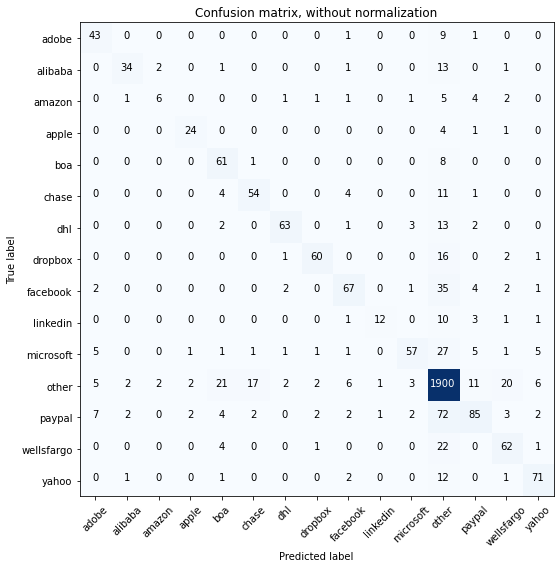

Acc     =  0.844
Pre     =  0.842
Rec     =  0.844
F1      =  0.837

Bal_Acc =  0.672
Bal_Pre =  0.776
Bal_Rec =  0.672
Bal_F1  =  0.72

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.85      0.65      0.74        52
      amazon       0.60      0.27      0.37        22
       apple       0.83      0.80      0.81        30
         boa       0.62      0.87      0.72        70
       chase       0.72      0.73      0.72        74
         dhl       0.90      0.75      0.82        84
     dropbox       0.90      0.75      0.82        80
    facebook       0.77      0.59      0.67       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.85      0.54      0.66       106
       other       0.88      0.95      0.91      2000
      paypal       0.73      0.46      0.56       186
  wellsfargo       0.65      0.69      0.67        90
       yahoo       0.81      0.81      0.81        8

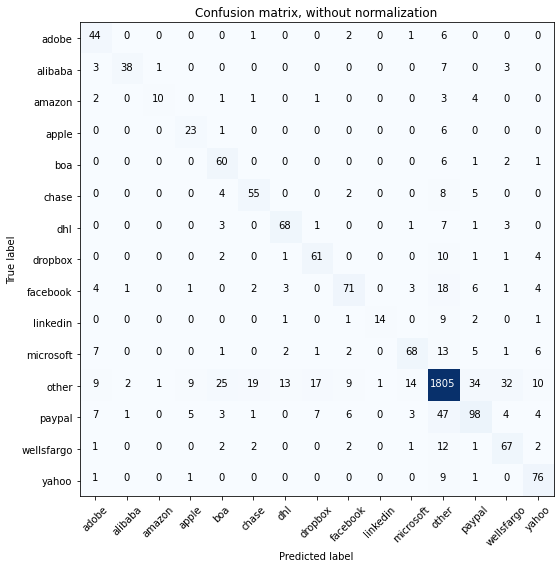

Acc     =  0.831
Pre     =  0.839
Rec     =  0.831
F1      =  0.831

Bal_Acc =  0.716
Bal_Pre =  0.725
Bal_Rec =  0.716
Bal_F1  =  0.72

              precision    recall  f1-score   support

       adobe       0.56      0.81      0.67        54
     alibaba       0.90      0.73      0.81        52
      amazon       0.83      0.45      0.59        22
       apple       0.59      0.77      0.67        30
         boa       0.59      0.86      0.70        70
       chase       0.68      0.74      0.71        74
         dhl       0.77      0.81      0.79        84
     dropbox       0.69      0.76      0.73        80
    facebook       0.75      0.62      0.68       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.75      0.64      0.69       106
       other       0.92      0.90      0.91      2000
      paypal       0.62      0.53      0.57       186
  wellsfargo       0.59      0.74      0.66        90
       yahoo       0.70      0.86      0.78        8

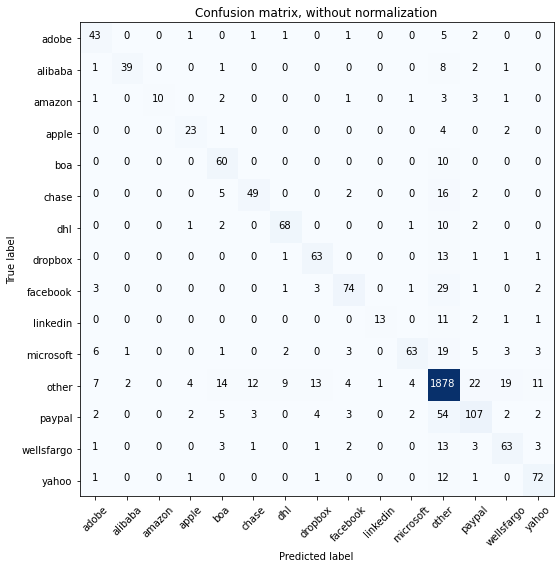

Acc     =  0.853
Pre     =  0.854
Rec     =  0.853
F1      =  0.849

Bal_Acc =  0.708
Bal_Pre =  0.795
Bal_Rec =  0.708
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.66      0.80      0.72        54
     alibaba       0.93      0.75      0.83        52
      amazon       1.00      0.45      0.62        22
       apple       0.72      0.77      0.74        30
         boa       0.64      0.86      0.73        70
       chase       0.74      0.66      0.70        74
         dhl       0.83      0.81      0.82        84
     dropbox       0.74      0.79      0.76        80
    facebook       0.82      0.65      0.73       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.88      0.59      0.71       106
       other       0.90      0.94      0.92      2000
      paypal       0.70      0.58      0.63       186
  wellsfargo       0.68      0.70      0.69        90
       yahoo       0.76      0.82      0.79        

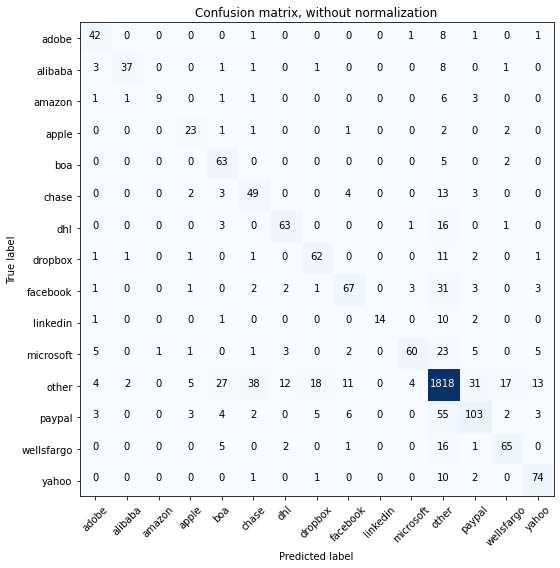

Acc     =  0.828
Pre     =  0.834
Rec     =  0.828
F1      =  0.826

Bal_Acc =  0.695
Bal_Pre =  0.753
Bal_Rec =  0.695
Bal_F1  =  0.723

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.90      0.71      0.80        52
      amazon       0.90      0.41      0.56        22
       apple       0.64      0.77      0.70        30
         boa       0.58      0.90      0.70        70
       chase       0.50      0.66      0.57        74
         dhl       0.77      0.75      0.76        84
     dropbox       0.70      0.78      0.74        80
    facebook       0.73      0.59      0.65       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.87      0.57      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.66      0.55      0.60       186
  wellsfargo       0.72      0.72      0.72        90
       yahoo       0.74      0.84      0.79        

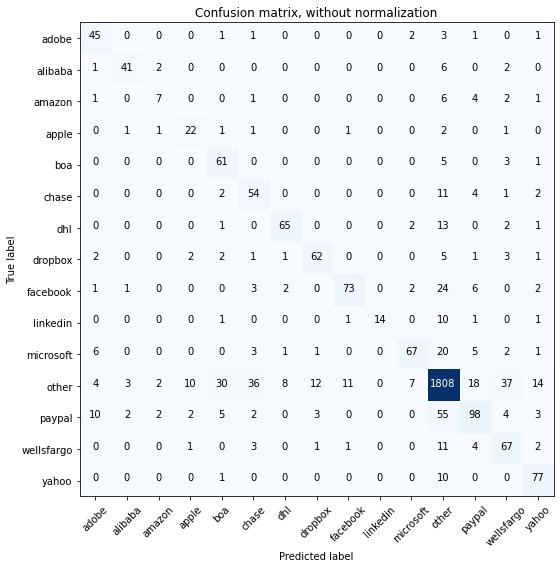

Acc     =  0.832
Pre     =  0.842
Rec     =  0.832
F1      =  0.832

Bal_Acc =  0.71
Bal_Pre =  0.723
Bal_Rec =  0.71
Bal_F1  =  0.716

              precision    recall  f1-score   support

       adobe       0.64      0.83      0.73        54
     alibaba       0.85      0.79      0.82        52
      amazon       0.50      0.32      0.39        22
       apple       0.59      0.73      0.66        30
         boa       0.58      0.87      0.70        70
       chase       0.51      0.73      0.60        74
         dhl       0.84      0.77      0.81        84
     dropbox       0.78      0.78      0.78        80
    facebook       0.84      0.64      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.84      0.63      0.72       106
       other       0.91      0.90      0.91      2000
      paypal       0.69      0.53      0.60       186
  wellsfargo       0.54      0.74      0.63        90
       yahoo       0.72      0.88      0.79        88

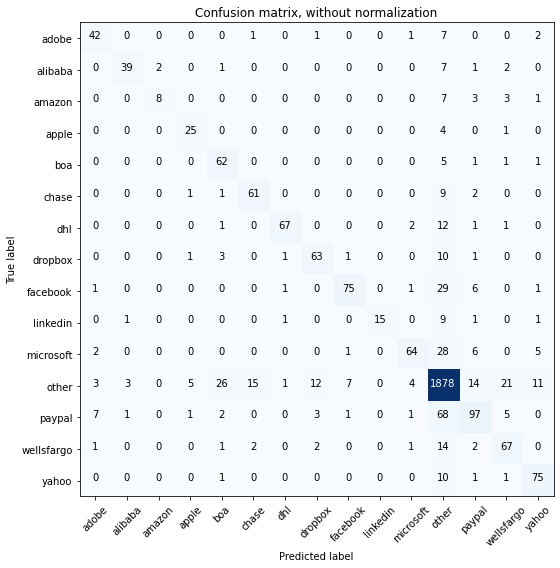

Acc     =  0.857
Pre     =  0.858
Rec     =  0.857
F1      =  0.853

Bal_Acc =  0.725
Bal_Pre =  0.807
Bal_Rec =  0.725
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        54
     alibaba       0.89      0.75      0.81        52
      amazon       0.80      0.36      0.50        22
       apple       0.76      0.83      0.79        30
         boa       0.63      0.89      0.74        70
       chase       0.77      0.82      0.80        74
         dhl       0.94      0.80      0.86        84
     dropbox       0.78      0.79      0.78        80
    facebook       0.88      0.66      0.75       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.86      0.60      0.71       106
       other       0.90      0.94      0.92      2000
      paypal       0.71      0.52      0.60       186
  wellsfargo       0.66      0.74      0.70        90
       yahoo       0.77      0.85      0.81        

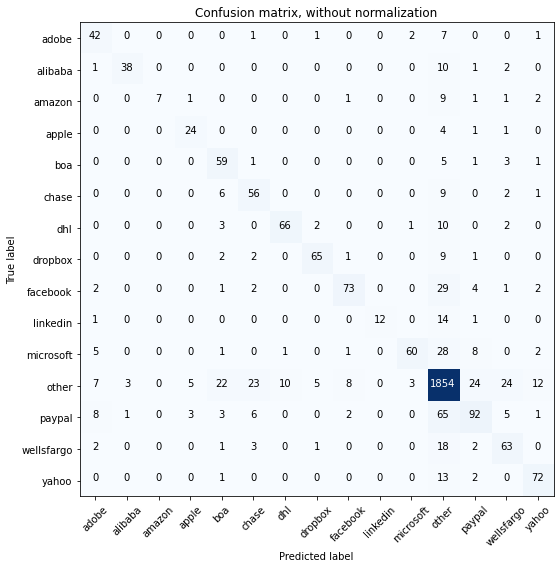

Acc     =  0.839
Pre     =  0.844
Rec     =  0.839
F1      =  0.835

Bal_Acc =  0.693
Bal_Pre =  0.791
Bal_Rec =  0.693
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.62      0.78      0.69        54
     alibaba       0.90      0.73      0.81        52
      amazon       1.00      0.32      0.48        22
       apple       0.73      0.80      0.76        30
         boa       0.60      0.84      0.70        70
       chase       0.60      0.76      0.67        74
         dhl       0.86      0.79      0.82        84
     dropbox       0.88      0.81      0.84        80
    facebook       0.85      0.64      0.73       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.91      0.57      0.70       106
       other       0.89      0.93      0.91      2000
      paypal       0.67      0.49      0.57       186
  wellsfargo       0.61      0.70      0.65        90
       yahoo       0.77      0.82      0.79        

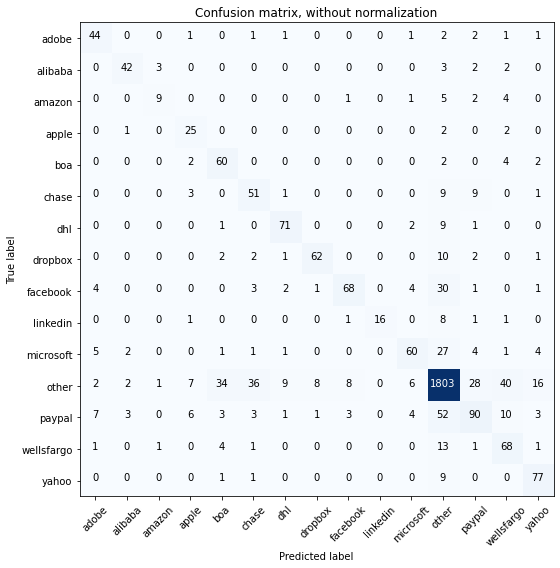

Acc     =  0.827
Pre     =  0.837
Rec     =  0.827
F1      =  0.827

Bal_Acc =  0.719
Bal_Pre =  0.725
Bal_Rec =  0.719
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.70      0.81      0.75        54
     alibaba       0.84      0.81      0.82        52
      amazon       0.64      0.41      0.50        22
       apple       0.56      0.83      0.67        30
         boa       0.57      0.86      0.68        70
       chase       0.52      0.69      0.59        74
         dhl       0.82      0.85      0.83        84
     dropbox       0.86      0.78      0.82        80
    facebook       0.84      0.60      0.70       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.77      0.57      0.65       106
       other       0.91      0.90      0.91      2000
      paypal       0.63      0.48      0.55       186
  wellsfargo       0.51      0.76      0.61        90
       yahoo       0.72      0.88      0.79        

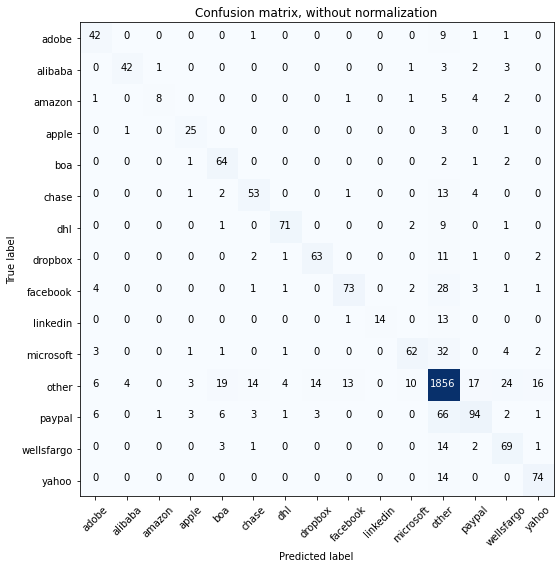

Acc     =  0.848
Pre     =  0.848
Rec     =  0.848
F1      =  0.844

Bal_Acc =  0.721
Bal_Pre =  0.786
Bal_Rec =  0.721
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.89      0.81      0.85        52
      amazon       0.80      0.36      0.50        22
       apple       0.74      0.83      0.78        30
         boa       0.67      0.91      0.77        70
       chase       0.71      0.72      0.71        74
         dhl       0.90      0.85      0.87        84
     dropbox       0.79      0.79      0.79        80
    facebook       0.82      0.64      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.79      0.58      0.67       106
       other       0.89      0.93      0.91      2000
      paypal       0.73      0.51      0.60       186
  wellsfargo       0.63      0.77      0.69        90
       yahoo       0.76      0.84      0.80        

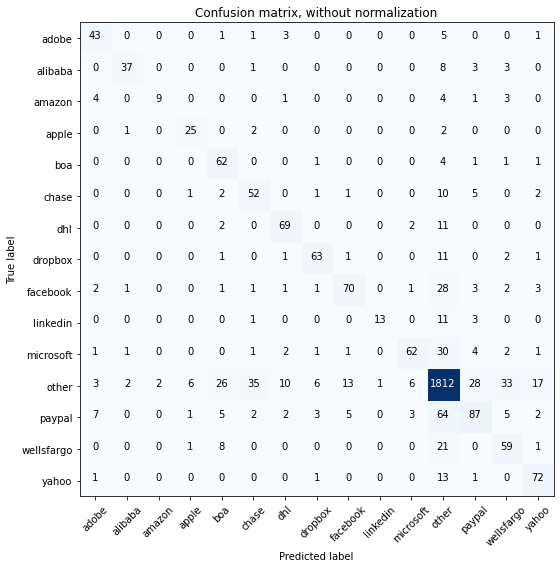

Acc     =  0.824
Pre     =  0.828
Rec     =  0.824
F1      =  0.821

Bal_Acc =  0.697
Bal_Pre =  0.744
Bal_Rec =  0.697
Bal_F1  =  0.72

              precision    recall  f1-score   support

       adobe       0.70      0.80      0.75        54
     alibaba       0.88      0.71      0.79        52
      amazon       0.82      0.41      0.55        22
       apple       0.74      0.83      0.78        30
         boa       0.57      0.89      0.70        70
       chase       0.54      0.70      0.61        74
         dhl       0.78      0.82      0.80        84
     dropbox       0.82      0.79      0.80        80
    facebook       0.77      0.61      0.68       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.84      0.58      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.64      0.47      0.54       186
  wellsfargo       0.54      0.66      0.59        90
       yahoo       0.71      0.82      0.76        8

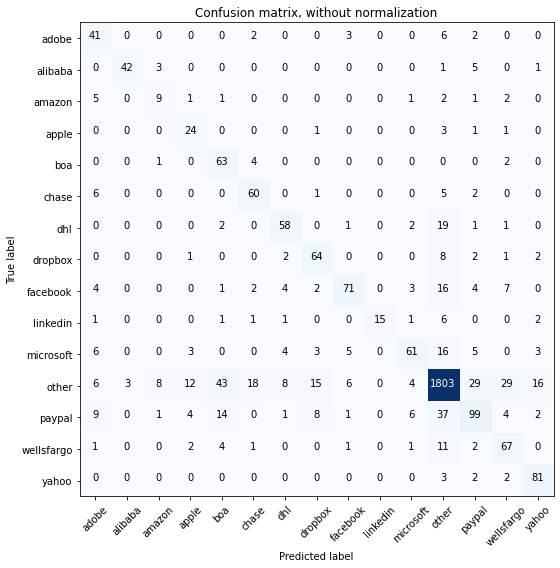

Acc     =  0.831
Pre     =  0.846
Rec     =  0.831
F1      =  0.834

Bal_Acc =  0.721
Bal_Pre =  0.697
Bal_Rec =  0.721
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.52      0.76      0.62        54
     alibaba       0.93      0.81      0.87        52
      amazon       0.41      0.41      0.41        22
       apple       0.51      0.80      0.62        30
         boa       0.49      0.90      0.63        70
       chase       0.68      0.81      0.74        74
         dhl       0.74      0.69      0.72        84
     dropbox       0.68      0.80      0.74        80
    facebook       0.81      0.62      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.77      0.58      0.66       106
       other       0.93      0.90      0.92      2000
      paypal       0.64      0.53      0.58       186
  wellsfargo       0.58      0.74      0.65        90
       yahoo       0.76      0.92      0.83        

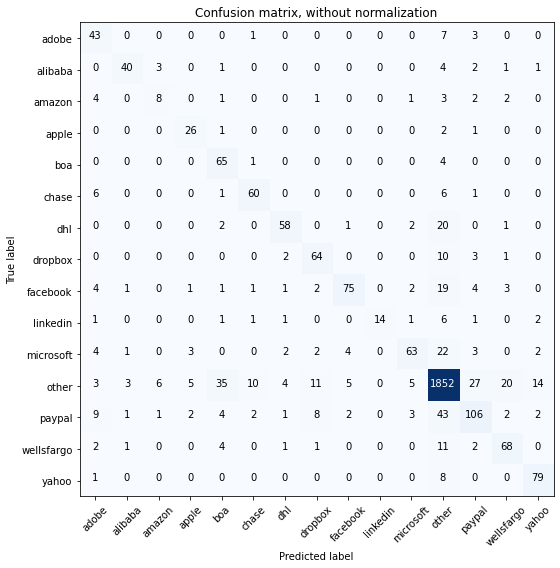

Acc     =  0.852
Pre     =  0.857
Rec     =  0.852
F1      =  0.85

Bal_Acc =  0.728
Bal_Pre =  0.748
Bal_Rec =  0.728
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.56      0.80      0.66        54
     alibaba       0.85      0.77      0.81        52
      amazon       0.44      0.36      0.40        22
       apple       0.70      0.87      0.78        30
         boa       0.56      0.93      0.70        70
       chase       0.79      0.81      0.80        74
         dhl       0.83      0.69      0.75        84
     dropbox       0.72      0.80      0.76        80
    facebook       0.86      0.66      0.75       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.82      0.59      0.69       106
       other       0.92      0.93      0.92      2000
      paypal       0.68      0.57      0.62       186
  wellsfargo       0.69      0.76      0.72        90
       yahoo       0.79      0.90      0.84        8

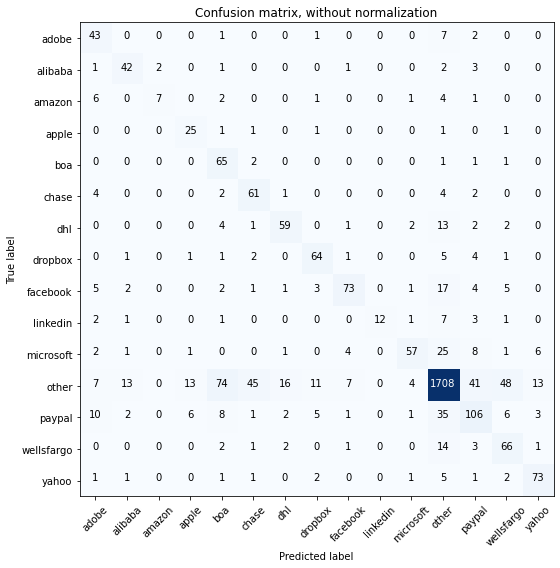

Acc     =  0.8
Pre     =  0.832
Rec     =  0.8
F1      =  0.807

Bal_Acc =  0.707
Bal_Pre =  0.687
Bal_Rec =  0.707
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.53      0.80      0.64        54
     alibaba       0.67      0.81      0.73        52
      amazon       0.78      0.32      0.45        22
       apple       0.54      0.83      0.66        30
         boa       0.39      0.93      0.55        70
       chase       0.53      0.82      0.64        74
         dhl       0.72      0.70      0.71        84
     dropbox       0.73      0.80      0.76        80
    facebook       0.82      0.64      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.84      0.54      0.66       106
       other       0.92      0.85      0.89      2000
      paypal       0.59      0.57      0.58       186
  wellsfargo       0.49      0.73      0.59        90
       yahoo       0.76      0.83      0.79        88



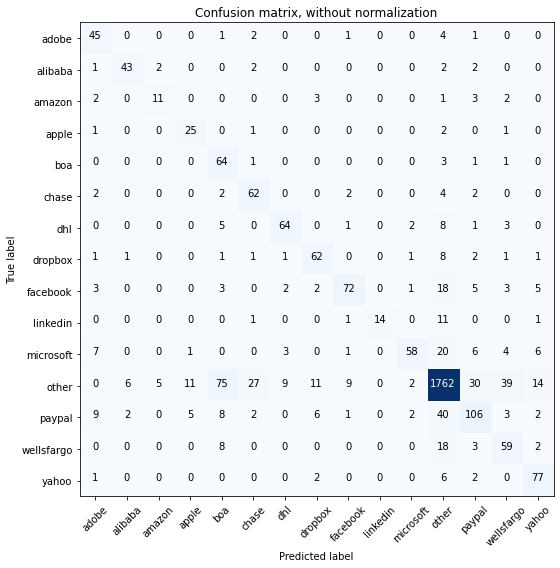

Acc     =  0.82
Pre     =  0.844
Rec     =  0.82
F1      =  0.825

Bal_Acc =  0.73
Bal_Pre =  0.713
Bal_Rec =  0.73
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.62      0.83      0.71        54
     alibaba       0.83      0.83      0.83        52
      amazon       0.61      0.50      0.55        22
       apple       0.60      0.83      0.69        30
         boa       0.38      0.91      0.54        70
       chase       0.63      0.84      0.72        74
         dhl       0.81      0.76      0.79        84
     dropbox       0.72      0.78      0.75        80
    facebook       0.82      0.63      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.55      0.67       106
       other       0.92      0.88      0.90      2000
      paypal       0.65      0.57      0.61       186
  wellsfargo       0.51      0.66      0.57        90
       yahoo       0.71      0.88      0.79        88



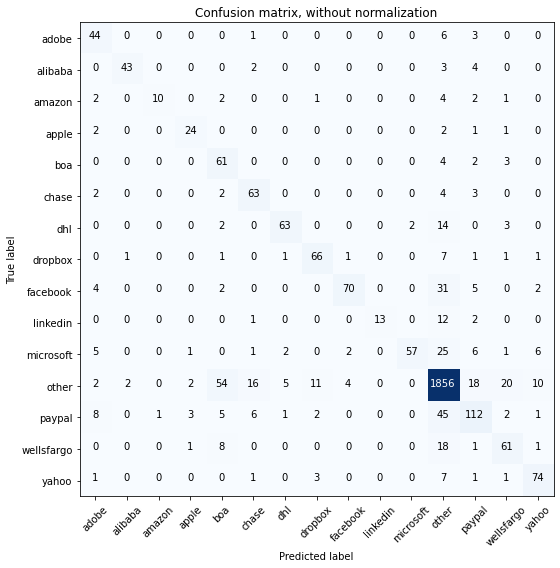

Acc     =  0.85
Pre     =  0.863
Rec     =  0.85
F1      =  0.85

Bal_Acc =  0.724
Bal_Pre =  0.798
Bal_Rec =  0.724
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        54
     alibaba       0.93      0.83      0.88        52
      amazon       0.91      0.45      0.61        22
       apple       0.77      0.80      0.79        30
         boa       0.45      0.87      0.59        70
       chase       0.69      0.85      0.76        74
         dhl       0.88      0.75      0.81        84
     dropbox       0.80      0.82      0.81        80
    facebook       0.91      0.61      0.73       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.97      0.54      0.69       106
       other       0.91      0.93      0.92      2000
      paypal       0.70      0.60      0.65       186
  wellsfargo       0.65      0.68      0.66        90
       yahoo       0.78      0.84      0.81        88


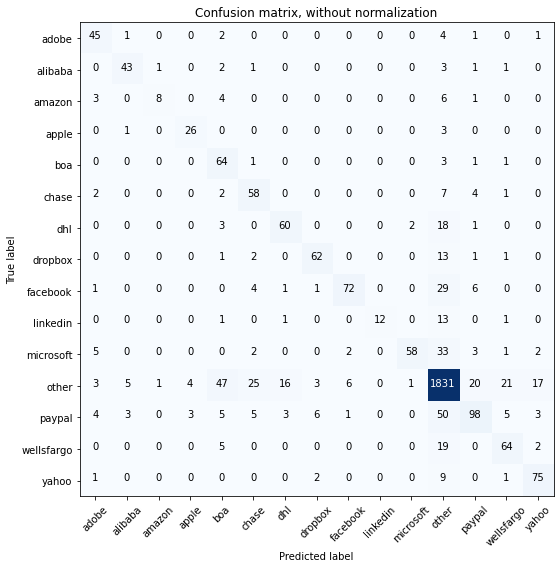

Acc     =  0.837
Pre     =  0.848
Rec     =  0.837
F1      =  0.835

Bal_Acc =  0.713
Bal_Pre =  0.774
Bal_Rec =  0.713
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.70      0.83      0.76        54
     alibaba       0.81      0.83      0.82        52
      amazon       0.80      0.36      0.50        22
       apple       0.79      0.87      0.83        30
         boa       0.47      0.91      0.62        70
       chase       0.59      0.78      0.67        74
         dhl       0.74      0.71      0.73        84
     dropbox       0.84      0.78      0.81        80
    facebook       0.89      0.63      0.74       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.95      0.55      0.69       106
       other       0.90      0.92      0.91      2000
      paypal       0.72      0.53      0.61       186
  wellsfargo       0.66      0.71      0.68        90
       yahoo       0.75      0.85      0.80        

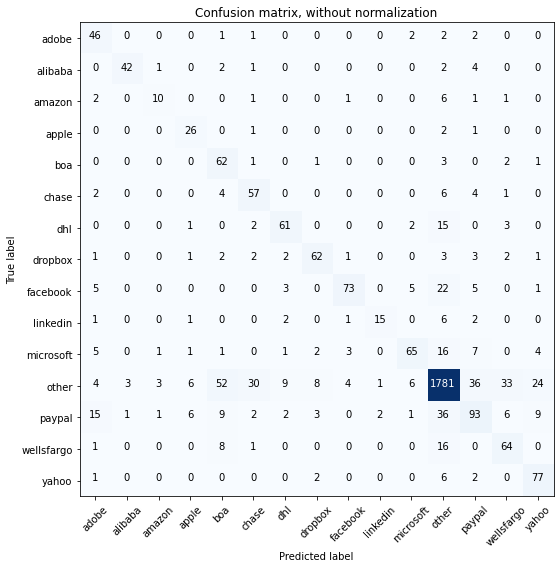

Acc     =  0.823
Pre     =  0.842
Rec     =  0.823
F1      =  0.827

Bal_Acc =  0.727
Bal_Pre =  0.702
Bal_Rec =  0.727
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.55      0.85      0.67        54
     alibaba       0.91      0.81      0.86        52
      amazon       0.62      0.45      0.53        22
       apple       0.62      0.87      0.72        30
         boa       0.44      0.89      0.59        70
       chase       0.58      0.77      0.66        74
         dhl       0.76      0.73      0.74        84
     dropbox       0.79      0.78      0.78        80
    facebook       0.88      0.64      0.74       114
    linkedin       0.83      0.54      0.65        28
   microsoft       0.80      0.61      0.70       106
       other       0.93      0.89      0.91      2000
      paypal       0.58      0.50      0.54       186
  wellsfargo       0.57      0.71      0.63        90
       yahoo       0.66      0.88      0.75        

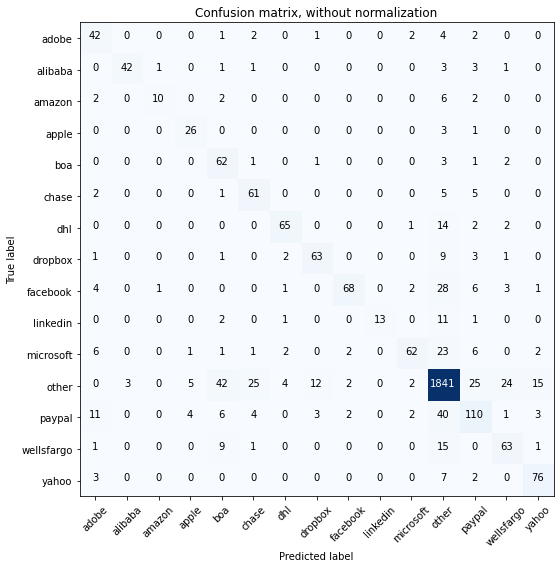

Acc     =  0.846
Pre     =  0.858
Rec     =  0.846
F1      =  0.846

Bal_Acc =  0.727
Bal_Pre =  0.775
Bal_Rec =  0.727
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.58      0.78      0.67        54
     alibaba       0.93      0.81      0.87        52
      amazon       0.83      0.45      0.59        22
       apple       0.72      0.87      0.79        30
         boa       0.48      0.89      0.63        70
       chase       0.64      0.82      0.72        74
         dhl       0.87      0.77      0.82        84
     dropbox       0.79      0.79      0.79        80
    facebook       0.92      0.60      0.72       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.58      0.70       106
       other       0.92      0.92      0.92      2000
      paypal       0.65      0.59      0.62       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.78      0.86      0.82        8

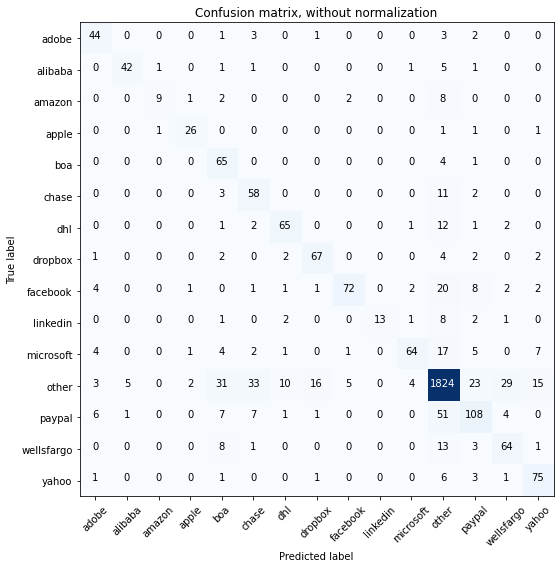

Acc     =  0.843
Pre     =  0.856
Rec     =  0.843
F1      =  0.844

Bal_Acc =  0.732
Bal_Pre =  0.77
Bal_Rec =  0.732
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.70      0.81      0.75        54
     alibaba       0.88      0.81      0.84        52
      amazon       0.82      0.41      0.55        22
       apple       0.84      0.87      0.85        30
         boa       0.51      0.93      0.66        70
       chase       0.54      0.78      0.64        74
         dhl       0.79      0.77      0.78        84
     dropbox       0.77      0.84      0.80        80
    facebook       0.90      0.63      0.74       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.88      0.60      0.72       106
       other       0.92      0.91      0.91      2000
      paypal       0.67      0.58      0.62       186
  wellsfargo       0.62      0.71      0.66        90
       yahoo       0.73      0.85      0.79        8

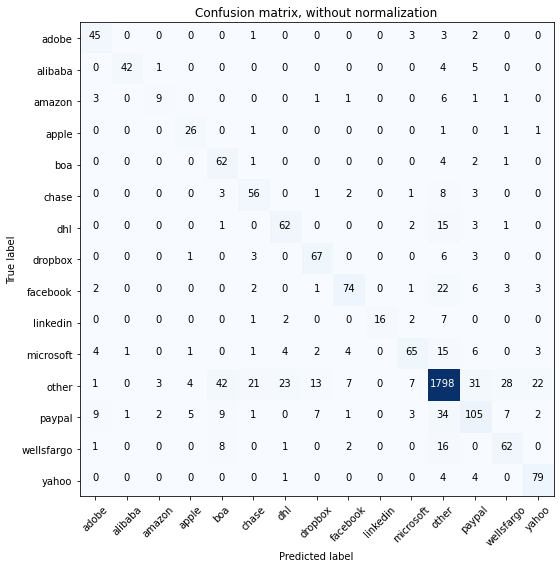

Acc     =  0.834
Pre     =  0.845
Rec     =  0.834
F1      =  0.836

Bal_Acc =  0.735
Bal_Pre =  0.728
Bal_Rec =  0.735
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.69      0.83      0.76        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.60      0.41      0.49        22
       apple       0.70      0.87      0.78        30
         boa       0.50      0.89      0.64        70
       chase       0.64      0.76      0.69        74
         dhl       0.67      0.74      0.70        84
     dropbox       0.73      0.84      0.78        80
    facebook       0.81      0.65      0.72       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.77      0.61      0.68       106
       other       0.93      0.90      0.91      2000
      paypal       0.61      0.56      0.59       186
  wellsfargo       0.60      0.69      0.64        90
       yahoo       0.72      0.90      0.80        

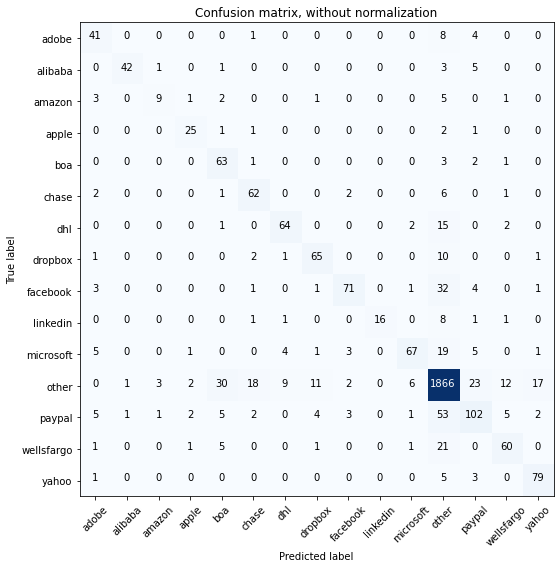

Acc     =  0.855
Pre     =  0.858
Rec     =  0.855
F1      =  0.852

Bal_Acc =  0.733
Bal_Pre =  0.782
Bal_Rec =  0.733
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.66      0.76      0.71        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.64      0.41      0.50        22
       apple       0.78      0.83      0.81        30
         boa       0.58      0.90      0.70        70
       chase       0.70      0.84      0.76        74
         dhl       0.81      0.76      0.79        84
     dropbox       0.77      0.81      0.79        80
    facebook       0.88      0.62      0.73       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.86      0.63      0.73       106
       other       0.91      0.93      0.92      2000
      paypal       0.68      0.55      0.61       186
  wellsfargo       0.72      0.67      0.69        90
       yahoo       0.78      0.90      0.84        

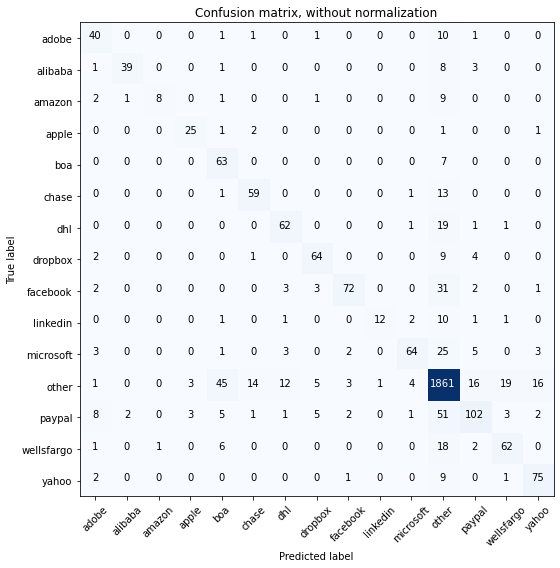

Acc     =  0.847
Pre     =  0.853
Rec     =  0.847
F1      =  0.844

Bal_Acc =  0.707
Bal_Pre =  0.794
Bal_Rec =  0.707
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.93      0.75      0.83        52
      amazon       0.89      0.36      0.52        22
       apple       0.81      0.83      0.82        30
         boa       0.50      0.90      0.64        70
       chase       0.76      0.80      0.78        74
         dhl       0.76      0.74      0.75        84
     dropbox       0.81      0.80      0.81        80
    facebook       0.90      0.63      0.74       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.88      0.60      0.72       106
       other       0.89      0.93      0.91      2000
      paypal       0.74      0.55      0.63       186
  wellsfargo       0.71      0.69      0.70        90
       yahoo       0.77      0.85      0.81        

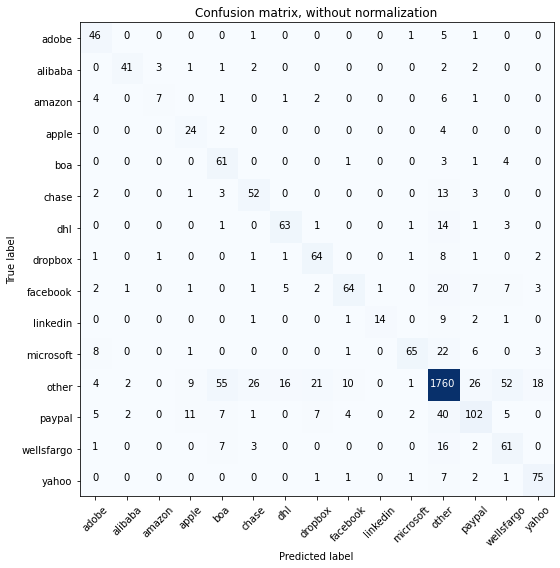

Acc     =  0.812
Pre     =  0.832
Rec     =  0.812
F1      =  0.816

Bal_Acc =  0.701
Bal_Pre =  0.697
Bal_Rec =  0.701
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.63      0.85      0.72        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.64      0.32      0.42        22
       apple       0.50      0.80      0.62        30
         boa       0.44      0.87      0.59        70
       chase       0.59      0.70      0.64        74
         dhl       0.73      0.75      0.74        84
     dropbox       0.65      0.80      0.72        80
    facebook       0.78      0.56      0.65       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.90      0.61      0.73       106
       other       0.91      0.88      0.90      2000
      paypal       0.65      0.55      0.59       186
  wellsfargo       0.46      0.68      0.54        90
       yahoo       0.74      0.85      0.79        

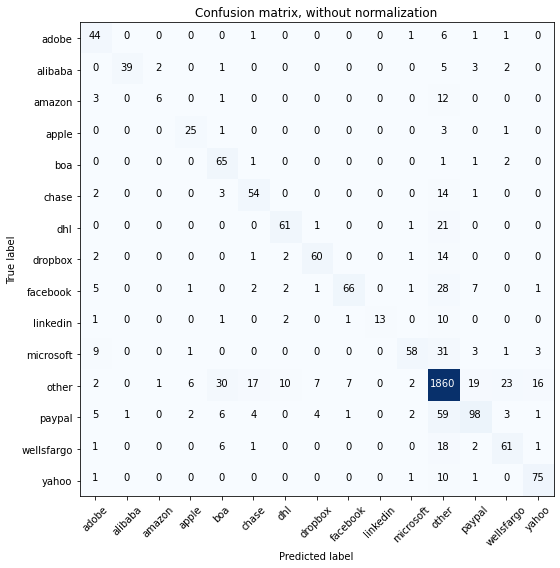

Acc     =  0.84
Pre     =  0.844
Rec     =  0.84
F1      =  0.835

Bal_Acc =  0.692
Bal_Pre =  0.771
Bal_Rec =  0.692
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.68        54
     alibaba       0.97      0.75      0.85        52
      amazon       0.67      0.27      0.39        22
       apple       0.71      0.83      0.77        30
         boa       0.57      0.93      0.71        70
       chase       0.67      0.73      0.70        74
         dhl       0.79      0.73      0.76        84
     dropbox       0.82      0.75      0.78        80
    facebook       0.88      0.58      0.70       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.55      0.67       106
       other       0.89      0.93      0.91      2000
      paypal       0.72      0.53      0.61       186
  wellsfargo       0.65      0.68      0.66        90
       yahoo       0.77      0.85      0.81        88

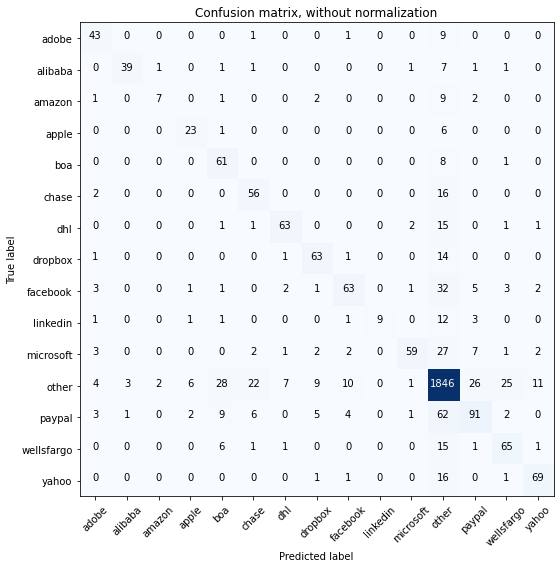

Acc     =  0.831
Pre     =  0.833
Rec     =  0.831
F1      =  0.825

Bal_Acc =  0.676
Bal_Pre =  0.764
Bal_Rec =  0.676
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.70      0.80      0.75        54
     alibaba       0.91      0.75      0.82        52
      amazon       0.70      0.32      0.44        22
       apple       0.70      0.77      0.73        30
         boa       0.55      0.87      0.68        70
       chase       0.62      0.76      0.68        74
         dhl       0.84      0.75      0.79        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.76      0.55      0.64       114
    linkedin       1.00      0.32      0.49        28
   microsoft       0.91      0.56      0.69       106
       other       0.88      0.92      0.90      2000
      paypal       0.67      0.49      0.57       186
  wellsfargo       0.65      0.72      0.68        90
       yahoo       0.80      0.78      0.79        

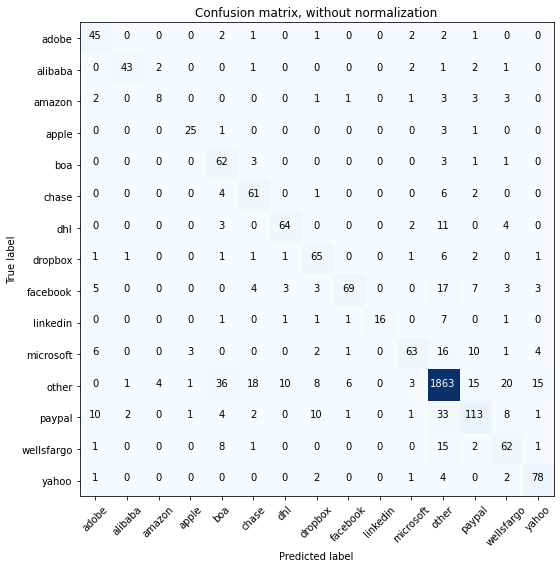

Acc     =  0.857
Pre     =  0.866
Rec     =  0.857
F1      =  0.857

Bal_Acc =  0.735
Bal_Pre =  0.755
Bal_Rec =  0.735
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.63      0.83      0.72        54
     alibaba       0.91      0.83      0.87        52
      amazon       0.57      0.36      0.44        22
       apple       0.83      0.83      0.83        30
         boa       0.51      0.89      0.65        70
       chase       0.66      0.82      0.73        74
         dhl       0.81      0.76      0.79        84
     dropbox       0.69      0.81      0.75        80
    facebook       0.87      0.61      0.72       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.83      0.59      0.69       106
       other       0.94      0.93      0.93      2000
      paypal       0.71      0.61      0.66       186
  wellsfargo       0.58      0.69      0.63        90
       yahoo       0.76      0.89      0.82        

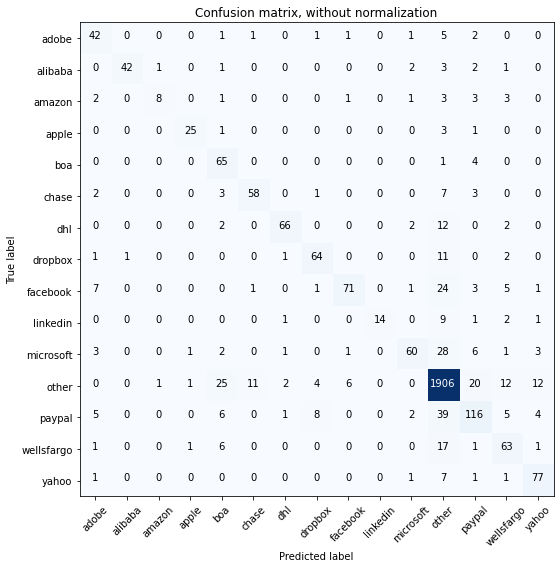

Acc     =  0.87
Pre     =  0.874
Rec     =  0.87
F1      =  0.867

Bal_Acc =  0.728
Bal_Pre =  0.816
Bal_Rec =  0.728
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.66      0.78      0.71        54
     alibaba       0.98      0.81      0.88        52
      amazon       0.80      0.36      0.50        22
       apple       0.89      0.83      0.86        30
         boa       0.58      0.93      0.71        70
       chase       0.82      0.78      0.80        74
         dhl       0.92      0.79      0.85        84
     dropbox       0.81      0.80      0.81        80
    facebook       0.89      0.62      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.86      0.57      0.68       106
       other       0.92      0.95      0.94      2000
      paypal       0.71      0.62      0.66       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.78      0.88      0.82        88

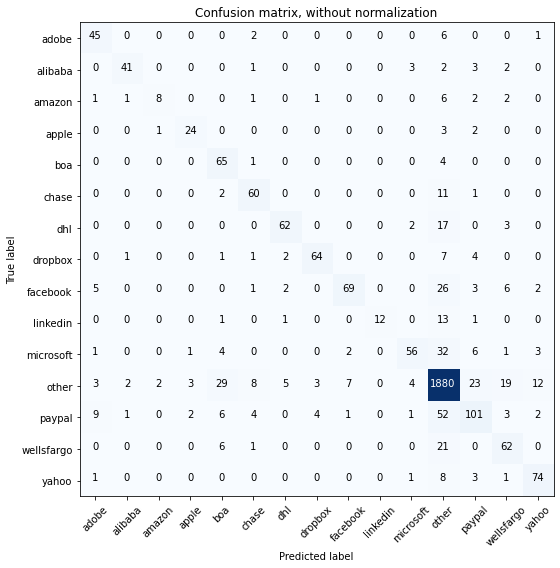

Acc     =  0.852
Pre     =  0.855
Rec     =  0.852
F1      =  0.848

Bal_Acc =  0.709
Bal_Pre =  0.792
Bal_Rec =  0.709
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.69      0.83      0.76        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.73      0.36      0.48        22
       apple       0.80      0.80      0.80        30
         boa       0.57      0.93      0.71        70
       chase       0.75      0.81      0.78        74
         dhl       0.86      0.74      0.79        84
     dropbox       0.89      0.80      0.84        80
    facebook       0.87      0.61      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.84      0.53      0.65       106
       other       0.90      0.94      0.92      2000
      paypal       0.68      0.54      0.60       186
  wellsfargo       0.63      0.69      0.66        90
       yahoo       0.79      0.84      0.81        

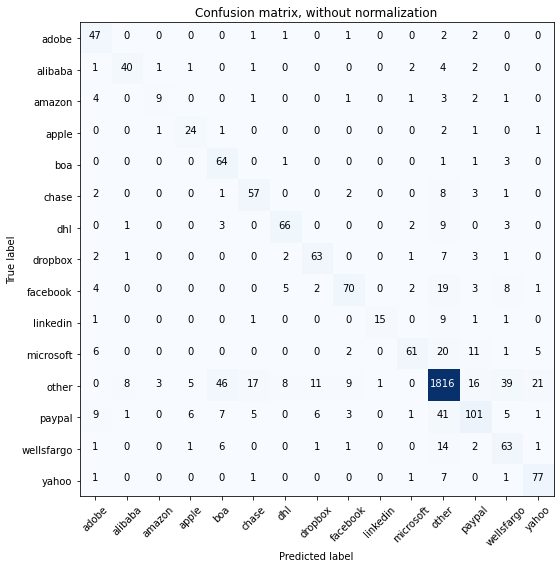

Acc     =  0.836
Pre     =  0.849
Rec     =  0.836
F1      =  0.837

Bal_Acc =  0.724
Bal_Pre =  0.721
Bal_Rec =  0.724
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.60      0.87      0.71        54
     alibaba       0.78      0.77      0.78        52
      amazon       0.64      0.41      0.50        22
       apple       0.65      0.80      0.72        30
         boa       0.50      0.91      0.65        70
       chase       0.68      0.77      0.72        74
         dhl       0.80      0.79      0.79        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.79      0.61      0.69       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.86      0.58      0.69       106
       other       0.93      0.91      0.92      2000
      paypal       0.68      0.54      0.60       186
  wellsfargo       0.50      0.70      0.58        90
       yahoo       0.72      0.88      0.79        

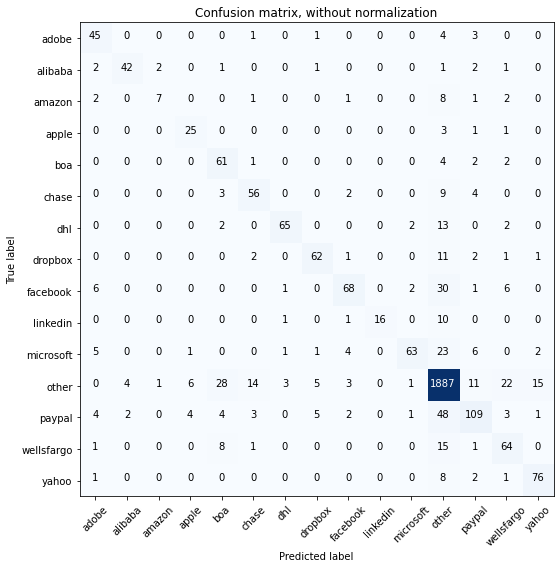

Acc     =  0.86
Pre     =  0.864
Rec     =  0.86
F1      =  0.857

Bal_Acc =  0.722
Bal_Pre =  0.786
Bal_Rec =  0.722
Bal_F1  =  0.753

              precision    recall  f1-score   support

       adobe       0.68      0.83      0.75        54
     alibaba       0.88      0.81      0.84        52
      amazon       0.70      0.32      0.44        22
       apple       0.69      0.83      0.76        30
         boa       0.57      0.87      0.69        70
       chase       0.71      0.76      0.73        74
         dhl       0.92      0.77      0.84        84
     dropbox       0.83      0.78      0.80        80
    facebook       0.83      0.60      0.69       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.91      0.59      0.72       106
       other       0.91      0.94      0.93      2000
      paypal       0.75      0.59      0.66       186
  wellsfargo       0.61      0.71      0.66        90
       yahoo       0.80      0.86      0.83        88

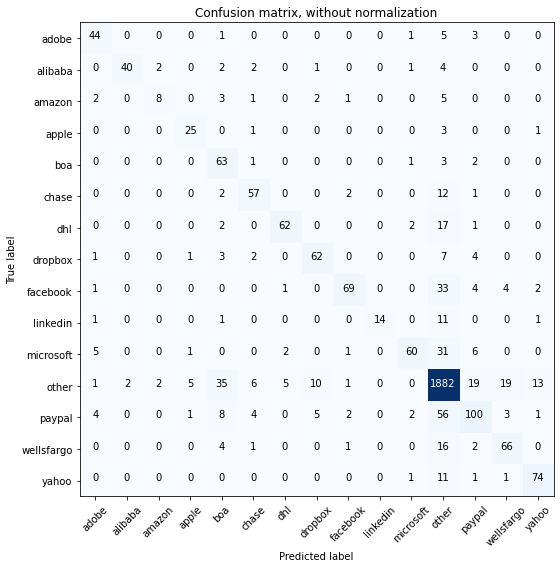

Acc     =  0.853
Pre     =  0.858
Rec     =  0.853
F1      =  0.849

Bal_Acc =  0.713
Bal_Pre =  0.796
Bal_Rec =  0.713
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.75      0.81      0.78        54
     alibaba       0.95      0.77      0.85        52
      amazon       0.67      0.36      0.47        22
       apple       0.76      0.83      0.79        30
         boa       0.51      0.90      0.65        70
       chase       0.76      0.77      0.77        74
         dhl       0.89      0.74      0.81        84
     dropbox       0.78      0.78      0.78        80
    facebook       0.90      0.61      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.57      0.69       106
       other       0.90      0.94      0.92      2000
      paypal       0.70      0.54      0.61       186
  wellsfargo       0.71      0.73      0.72        90
       yahoo       0.80      0.84      0.82        

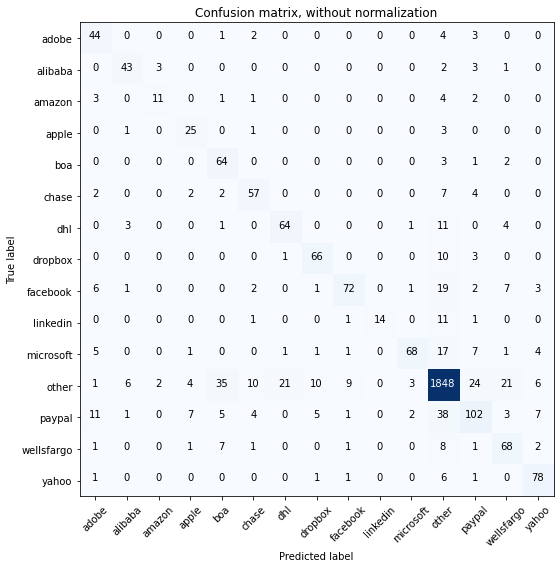

Acc     =  0.853
Pre     =  0.86
Rec     =  0.853
F1      =  0.852

Bal_Acc =  0.742
Bal_Pre =  0.749
Bal_Rec =  0.742
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.59      0.81      0.69        54
     alibaba       0.78      0.83      0.80        52
      amazon       0.69      0.50      0.58        22
       apple       0.62      0.83      0.71        30
         boa       0.55      0.91      0.69        70
       chase       0.72      0.77      0.75        74
         dhl       0.74      0.76      0.75        84
     dropbox       0.79      0.82      0.80        80
    facebook       0.84      0.63      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.91      0.64      0.75       106
       other       0.93      0.92      0.93      2000
      paypal       0.66      0.55      0.60       186
  wellsfargo       0.64      0.76      0.69        90
       yahoo       0.78      0.89      0.83        8

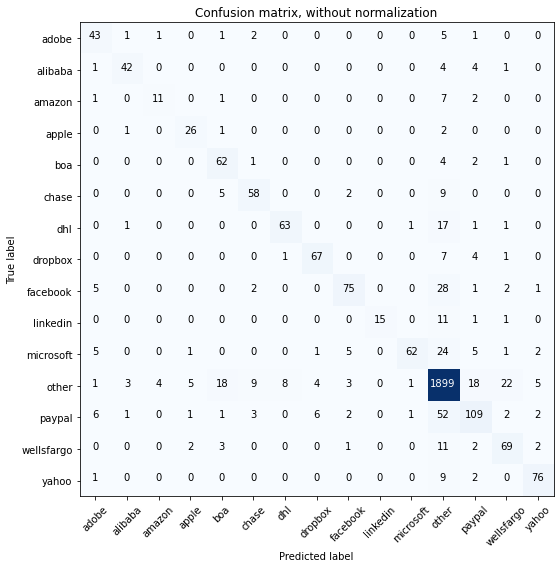

Acc     =  0.87
Pre     =  0.871
Rec     =  0.87
F1      =  0.866

Bal_Acc =  0.745
Bal_Pre =  0.809
Bal_Rec =  0.745
Bal_F1  =  0.776

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.69      0.50      0.58        22
       apple       0.74      0.87      0.80        30
         boa       0.67      0.89      0.77        70
       chase       0.77      0.78      0.78        74
         dhl       0.88      0.75      0.81        84
     dropbox       0.86      0.84      0.85        80
    facebook       0.85      0.66      0.74       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.95      0.58      0.73       106
       other       0.91      0.95      0.93      2000
      paypal       0.72      0.59      0.64       186
  wellsfargo       0.68      0.77      0.72        90
       yahoo       0.86      0.86      0.86        88

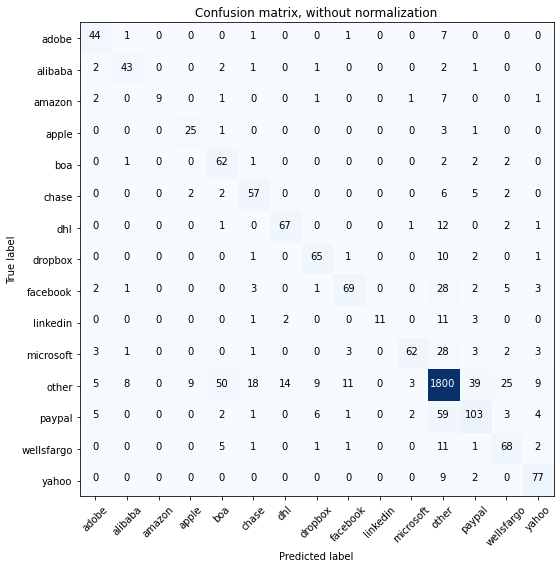

Acc     =  0.832
Pre     =  0.842
Rec     =  0.832
F1      =  0.832

Bal_Acc =  0.721
Bal_Pre =  0.768
Bal_Rec =  0.721
Bal_F1  =  0.744

              precision    recall  f1-score   support

       adobe       0.70      0.81      0.75        54
     alibaba       0.78      0.83      0.80        52
      amazon       1.00      0.41      0.58        22
       apple       0.69      0.83      0.76        30
         boa       0.49      0.89      0.63        70
       chase       0.66      0.77      0.71        74
         dhl       0.81      0.80      0.80        84
     dropbox       0.77      0.81      0.79        80
    facebook       0.79      0.61      0.69       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.90      0.58      0.71       106
       other       0.90      0.90      0.90      2000
      paypal       0.63      0.55      0.59       186
  wellsfargo       0.62      0.76      0.68        90
       yahoo       0.76      0.88      0.81        

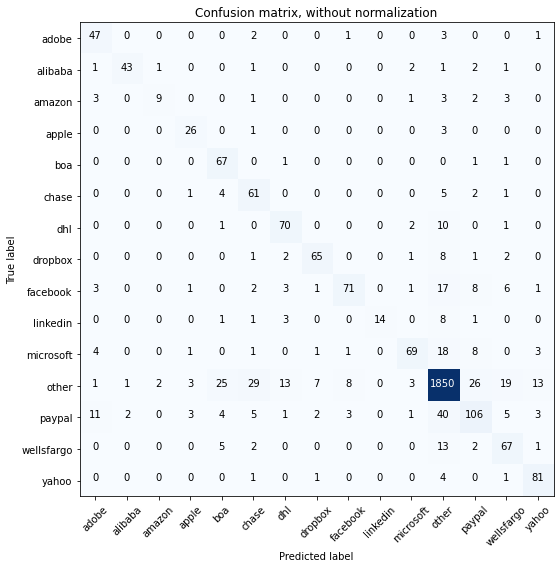

Acc     =  0.86
Pre     =  0.868
Rec     =  0.86
F1      =  0.859

Bal_Acc =  0.756
Bal_Pre =  0.774
Bal_Rec =  0.756
Bal_F1  =  0.765

              precision    recall  f1-score   support

       adobe       0.67      0.87      0.76        54
     alibaba       0.93      0.83      0.88        52
      amazon       0.75      0.41      0.53        22
       apple       0.74      0.87      0.80        30
         boa       0.63      0.96      0.76        70
       chase       0.56      0.82      0.67        74
         dhl       0.75      0.83      0.79        84
     dropbox       0.84      0.81      0.83        80
    facebook       0.85      0.62      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.86      0.65      0.74       106
       other       0.93      0.93      0.93      2000
      paypal       0.67      0.57      0.61       186
  wellsfargo       0.63      0.74      0.68        90
       yahoo       0.79      0.92      0.85        88

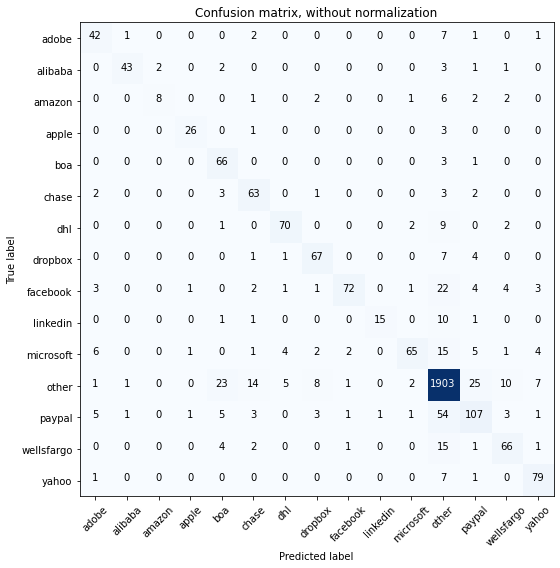

Acc     =  0.875
Pre     =  0.877
Rec     =  0.875
F1      =  0.871

Bal_Acc =  0.749
Bal_Pre =  0.818
Bal_Rec =  0.749
Bal_F1  =  0.782

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.93      0.83      0.88        52
      amazon       0.80      0.36      0.50        22
       apple       0.90      0.87      0.88        30
         boa       0.63      0.94      0.75        70
       chase       0.69      0.85      0.76        74
         dhl       0.86      0.83      0.85        84
     dropbox       0.80      0.84      0.82        80
    facebook       0.94      0.63      0.75       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.90      0.61      0.73       106
       other       0.92      0.95      0.94      2000
      paypal       0.69      0.58      0.63       186
  wellsfargo       0.74      0.73      0.74        90
       yahoo       0.82      0.90      0.86        

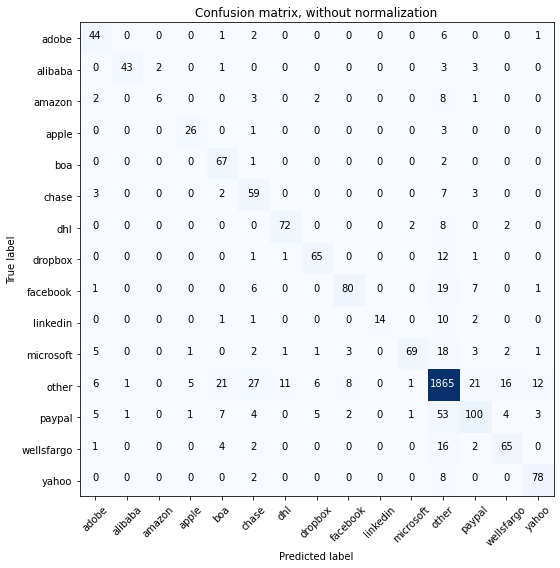

Acc     =  0.862
Pre     =  0.868
Rec     =  0.862
F1      =  0.86

Bal_Acc =  0.742
Bal_Pre =  0.797
Bal_Rec =  0.742
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.96      0.83      0.89        52
      amazon       0.75      0.27      0.40        22
       apple       0.79      0.87      0.83        30
         boa       0.64      0.96      0.77        70
       chase       0.53      0.80      0.64        74
         dhl       0.85      0.86      0.85        84
     dropbox       0.82      0.81      0.82        80
    facebook       0.86      0.70      0.77       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.95      0.65      0.77       106
       other       0.92      0.93      0.92      2000
      paypal       0.70      0.54      0.61       186
  wellsfargo       0.73      0.72      0.73        90
       yahoo       0.81      0.89      0.85        8

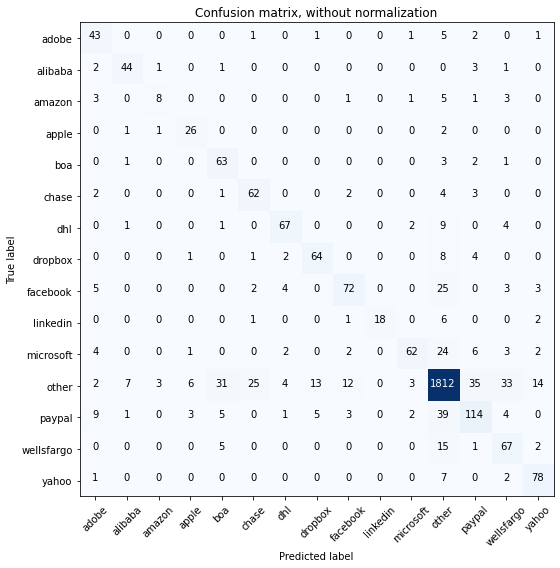

Acc     =  0.845
Pre     =  0.854
Rec     =  0.845
F1      =  0.845

Bal_Acc =  0.748
Bal_Pre =  0.743
Bal_Rec =  0.748
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.61      0.80      0.69        54
     alibaba       0.80      0.85      0.82        52
      amazon       0.62      0.36      0.46        22
       apple       0.70      0.87      0.78        30
         boa       0.59      0.90      0.71        70
       chase       0.67      0.84      0.75        74
         dhl       0.84      0.80      0.82        84
     dropbox       0.77      0.80      0.79        80
    facebook       0.77      0.63      0.70       114
    linkedin       1.00      0.64      0.78        28
   microsoft       0.87      0.58      0.70       106
       other       0.92      0.91      0.91      2000
      paypal       0.67      0.61      0.64       186
  wellsfargo       0.55      0.74      0.64        90
       yahoo       0.76      0.89      0.82        

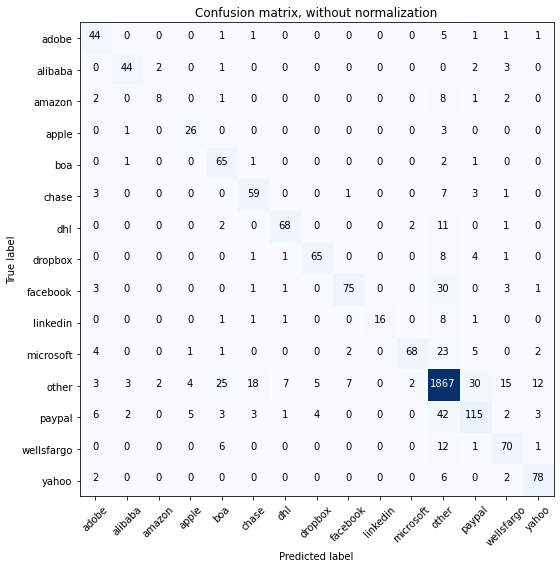

Acc     =  0.867
Pre     =  0.872
Rec     =  0.867
F1      =  0.865

Bal_Acc =  0.755
Bal_Pre =  0.793
Bal_Rec =  0.755
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.86      0.85      0.85        52
      amazon       0.67      0.36      0.47        22
       apple       0.72      0.87      0.79        30
         boa       0.61      0.93      0.74        70
       chase       0.69      0.80      0.74        74
         dhl       0.86      0.81      0.83        84
     dropbox       0.88      0.81      0.84        80
    facebook       0.88      0.66      0.75       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.94      0.64      0.76       106
       other       0.92      0.93      0.93      2000
      paypal       0.70      0.62      0.66       186
  wellsfargo       0.69      0.78      0.73        90
       yahoo       0.80      0.89      0.84        

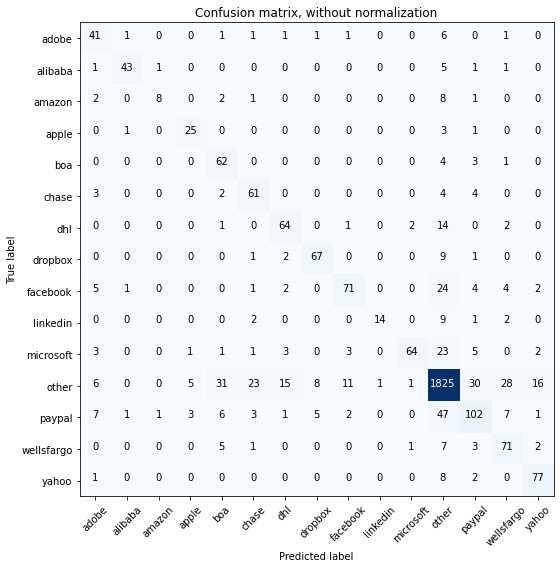

Acc     =  0.843
Pre     =  0.852
Rec     =  0.843
F1      =  0.842

Bal_Acc =  0.73
Bal_Pre =  0.761
Bal_Rec =  0.73
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.59      0.76      0.67        54
     alibaba       0.91      0.83      0.87        52
      amazon       0.80      0.36      0.50        22
       apple       0.74      0.83      0.78        30
         boa       0.56      0.89      0.69        70
       chase       0.64      0.82      0.72        74
         dhl       0.73      0.76      0.74        84
     dropbox       0.83      0.84      0.83        80
    facebook       0.80      0.62      0.70       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.94      0.60      0.74       106
       other       0.91      0.91      0.91      2000
      paypal       0.65      0.55      0.59       186
  wellsfargo       0.61      0.79      0.69        90
       yahoo       0.77      0.88      0.82        88

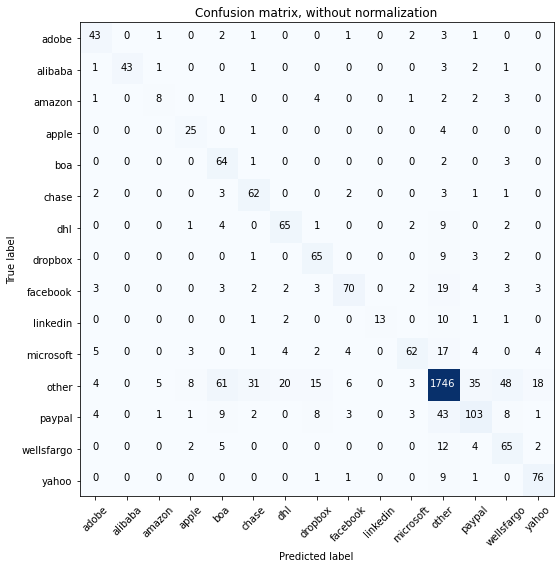

Acc     =  0.815
Pre     =  0.839
Rec     =  0.815
F1      =  0.82

Bal_Acc =  0.722
Bal_Pre =  0.705
Bal_Rec =  0.722
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       1.00      0.83      0.91        52
      amazon       0.50      0.36      0.42        22
       apple       0.62      0.83      0.71        30
         boa       0.42      0.91      0.58        70
       chase       0.60      0.84      0.70        74
         dhl       0.70      0.77      0.73        84
     dropbox       0.66      0.81      0.73        80
    facebook       0.80      0.61      0.70       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.83      0.58      0.69       106
       other       0.92      0.87      0.90      2000
      paypal       0.64      0.55      0.59       186
  wellsfargo       0.47      0.72      0.57        90
       yahoo       0.73      0.86      0.79        8

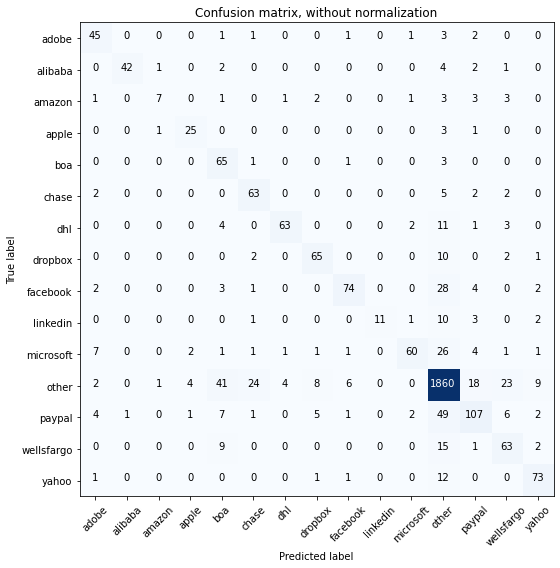

Acc     =  0.852
Pre     =  0.862
Rec     =  0.852
F1      =  0.851

Bal_Acc =  0.719
Bal_Pre =  0.788
Bal_Rec =  0.719
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.70      0.83      0.76        54
     alibaba       0.98      0.81      0.88        52
      amazon       0.70      0.32      0.44        22
       apple       0.78      0.83      0.81        30
         boa       0.49      0.93      0.64        70
       chase       0.66      0.85      0.75        74
         dhl       0.91      0.75      0.82        84
     dropbox       0.79      0.81      0.80        80
    facebook       0.87      0.65      0.74       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.90      0.57      0.69       106
       other       0.91      0.93      0.92      2000
      paypal       0.72      0.58      0.64       186
  wellsfargo       0.61      0.70      0.65        90
       yahoo       0.79      0.83      0.81        

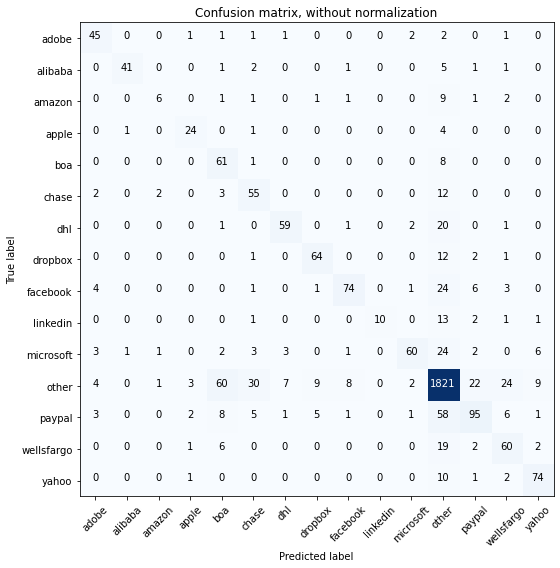

Acc     =  0.828
Pre     =  0.84
Rec     =  0.828
F1      =  0.827

Bal_Acc =  0.688
Bal_Pre =  0.757
Bal_Rec =  0.688
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.74      0.83      0.78        54
     alibaba       0.95      0.79      0.86        52
      amazon       0.60      0.27      0.37        22
       apple       0.75      0.80      0.77        30
         boa       0.42      0.87      0.57        70
       chase       0.54      0.74      0.62        74
         dhl       0.83      0.70      0.76        84
     dropbox       0.80      0.80      0.80        80
    facebook       0.85      0.65      0.74       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.88      0.57      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.71      0.51      0.59       186
  wellsfargo       0.59      0.67      0.62        90
       yahoo       0.80      0.84      0.82        8

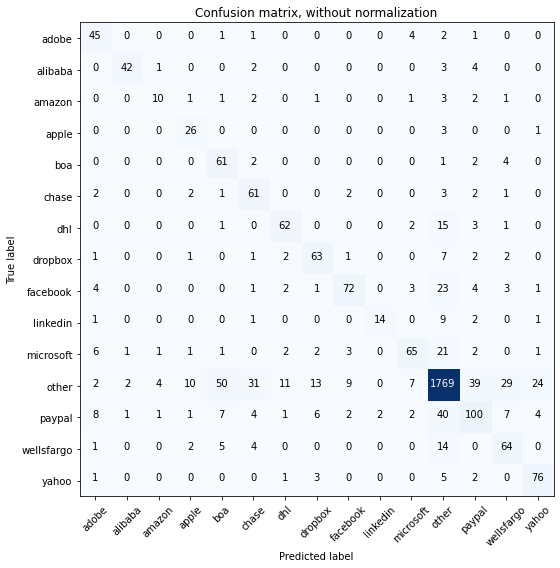

Acc     =  0.822
Pre     =  0.837
Rec     =  0.822
F1      =  0.825

Bal_Acc =  0.728
Bal_Pre =  0.699
Bal_Rec =  0.728
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.63      0.83      0.72        54
     alibaba       0.91      0.81      0.86        52
      amazon       0.59      0.45      0.51        22
       apple       0.59      0.87      0.70        30
         boa       0.48      0.87      0.62        70
       chase       0.55      0.82      0.66        74
         dhl       0.77      0.74      0.75        84
     dropbox       0.71      0.79      0.75        80
    facebook       0.81      0.63      0.71       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.77      0.61      0.68       106
       other       0.92      0.88      0.90      2000
      paypal       0.61      0.54      0.57       186
  wellsfargo       0.57      0.71      0.63        90
       yahoo       0.70      0.86      0.78        

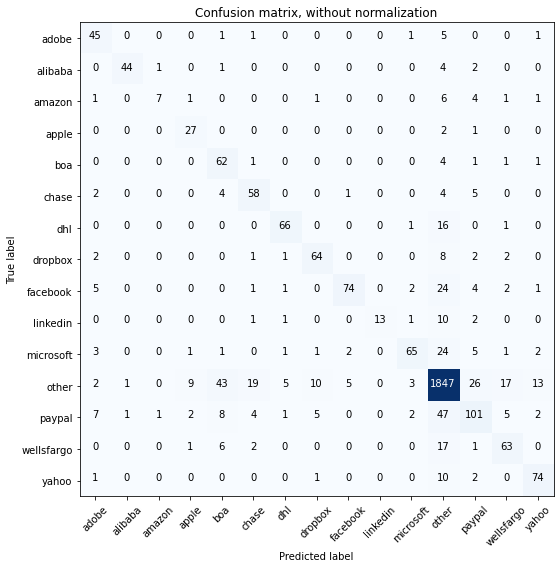

Acc     =  0.848
Pre     =  0.856
Rec     =  0.848
F1      =  0.847

Bal_Acc =  0.726
Bal_Pre =  0.776
Bal_Rec =  0.726
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.66      0.83      0.74        54
     alibaba       0.96      0.85      0.90        52
      amazon       0.78      0.32      0.45        22
       apple       0.66      0.90      0.76        30
         boa       0.49      0.89      0.63        70
       chase       0.66      0.78      0.72        74
         dhl       0.87      0.79      0.82        84
     dropbox       0.78      0.80      0.79        80
    facebook       0.90      0.65      0.76       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.61      0.72       106
       other       0.91      0.92      0.92      2000
      paypal       0.65      0.54      0.59       186
  wellsfargo       0.68      0.70      0.69        90
       yahoo       0.78      0.84      0.81        8

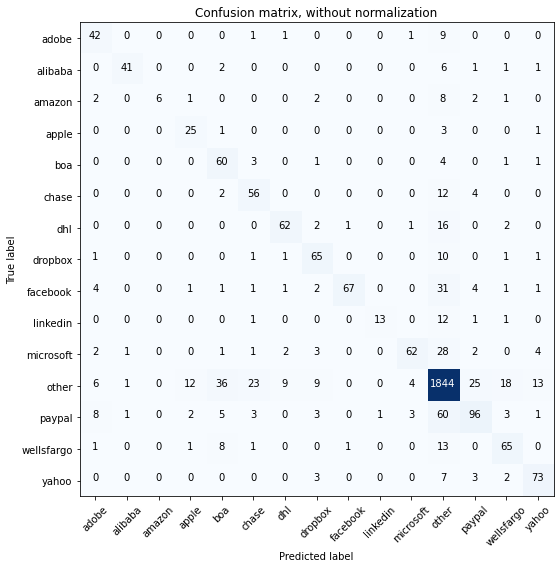

Acc     =  0.837
Pre     =  0.846
Rec     =  0.837
F1      =  0.834

Bal_Acc =  0.698
Bal_Pre =  0.776
Bal_Rec =  0.698
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        54
     alibaba       0.93      0.79      0.85        52
      amazon       1.00      0.27      0.43        22
       apple       0.60      0.83      0.69        30
         boa       0.52      0.86      0.65        70
       chase       0.62      0.76      0.68        74
         dhl       0.82      0.74      0.78        84
     dropbox       0.72      0.81      0.76        80
    facebook       0.97      0.59      0.73       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.87      0.58      0.70       106
       other       0.89      0.92      0.91      2000
      paypal       0.70      0.52      0.59       186
  wellsfargo       0.68      0.72      0.70        90
       yahoo       0.76      0.83      0.79        

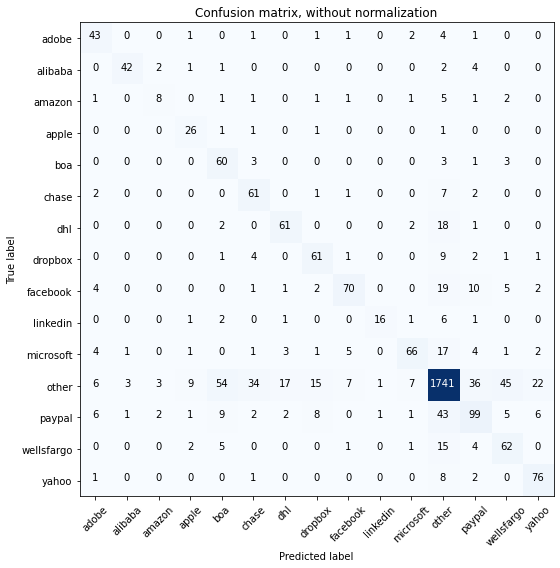

Acc     =  0.81
Pre     =  0.829
Rec     =  0.81
F1      =  0.814

Bal_Acc =  0.718
Bal_Pre =  0.686
Bal_Rec =  0.718
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.64      0.80      0.71        54
     alibaba       0.89      0.81      0.85        52
      amazon       0.53      0.36      0.43        22
       apple       0.62      0.87      0.72        30
         boa       0.44      0.86      0.58        70
       chase       0.55      0.82      0.66        74
         dhl       0.72      0.73      0.72        84
     dropbox       0.67      0.76      0.71        80
    facebook       0.80      0.61      0.70       114
    linkedin       0.89      0.57      0.70        28
   microsoft       0.81      0.62      0.71       106
       other       0.92      0.87      0.89      2000
      paypal       0.59      0.53      0.56       186
  wellsfargo       0.50      0.69      0.58        90
       yahoo       0.70      0.86      0.77        88

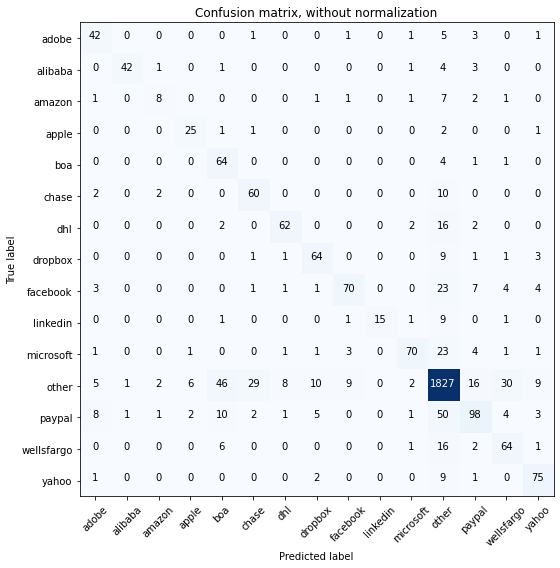

Acc     =  0.84
Pre     =  0.849
Rec     =  0.84
F1      =  0.84

Bal_Acc =  0.724
Bal_Pre =  0.754
Bal_Rec =  0.724
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.67      0.78      0.72        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.57      0.36      0.44        22
       apple       0.74      0.83      0.78        30
         boa       0.49      0.91      0.64        70
       chase       0.63      0.81      0.71        74
         dhl       0.84      0.74      0.78        84
     dropbox       0.76      0.80      0.78        80
    facebook       0.82      0.61      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.88      0.66      0.75       106
       other       0.91      0.91      0.91      2000
      paypal       0.70      0.53      0.60       186
  wellsfargo       0.60      0.71      0.65        90
       yahoo       0.77      0.85      0.81        88


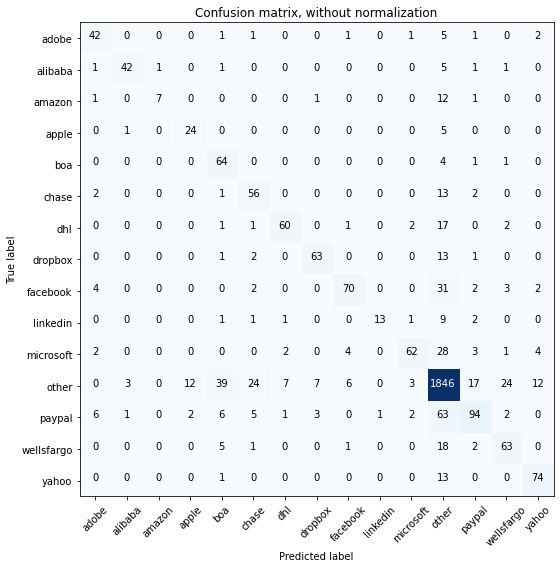

Acc     =  0.838
Pre     =  0.844
Rec     =  0.838
F1      =  0.834

Bal_Acc =  0.701
Bal_Pre =  0.777
Bal_Rec =  0.701
Bal_F1  =  0.737

              precision    recall  f1-score   support

       adobe       0.72      0.78      0.75        54
     alibaba       0.89      0.81      0.85        52
      amazon       0.88      0.32      0.47        22
       apple       0.63      0.80      0.71        30
         boa       0.53      0.91      0.67        70
       chase       0.60      0.76      0.67        74
         dhl       0.85      0.71      0.77        84
     dropbox       0.85      0.79      0.82        80
    facebook       0.84      0.61      0.71       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.87      0.58      0.70       106
       other       0.89      0.92      0.90      2000
      paypal       0.74      0.51      0.60       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.79      0.84      0.81        

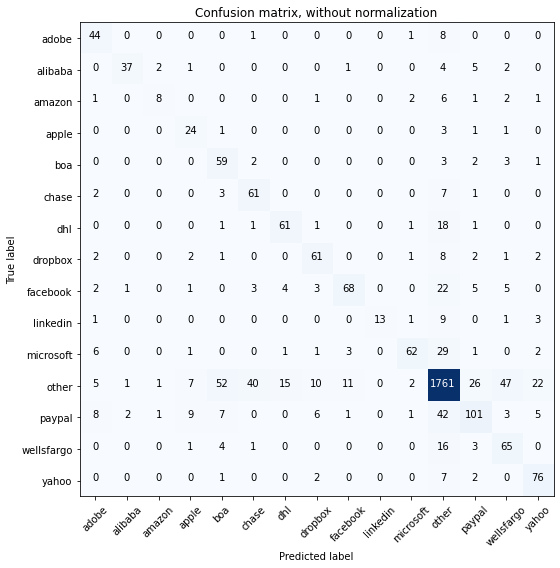

Acc     =  0.813
Pre     =  0.832
Rec     =  0.813
F1      =  0.815

Bal_Acc =  0.7
Bal_Pre =  0.709
Bal_Rec =  0.7
Bal_F1  =  0.704

              precision    recall  f1-score   support

       adobe       0.62      0.81      0.70        54
     alibaba       0.90      0.71      0.80        52
      amazon       0.67      0.36      0.47        22
       apple       0.52      0.80      0.63        30
         boa       0.46      0.84      0.59        70
       chase       0.56      0.82      0.67        74
         dhl       0.75      0.73      0.74        84
     dropbox       0.72      0.76      0.74        80
    facebook       0.81      0.60      0.69       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.58      0.70       106
       other       0.91      0.88      0.89      2000
      paypal       0.67      0.54      0.60       186
  wellsfargo       0.50      0.72      0.59        90
       yahoo       0.68      0.86      0.76        88



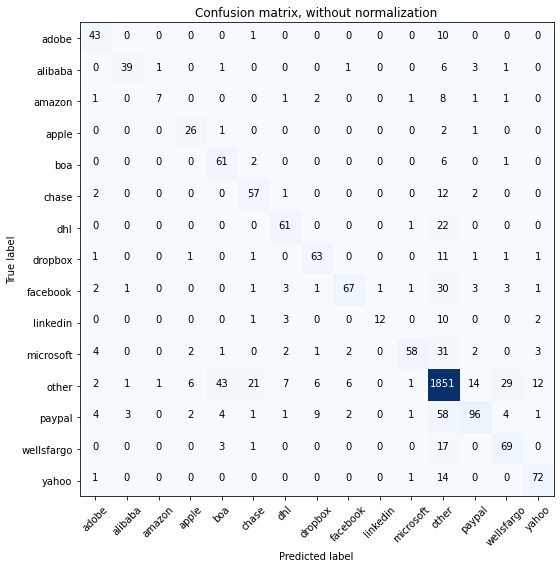

Acc     =  0.839
Pre     =  0.845
Rec     =  0.839
F1      =  0.834

Bal_Acc =  0.698
Bal_Pre =  0.773
Bal_Rec =  0.698
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.72      0.80      0.75        54
     alibaba       0.89      0.75      0.81        52
      amazon       0.78      0.32      0.45        22
       apple       0.70      0.87      0.78        30
         boa       0.54      0.87      0.66        70
       chase       0.66      0.77      0.71        74
         dhl       0.77      0.73      0.75        84
     dropbox       0.77      0.79      0.78        80
    facebook       0.86      0.59      0.70       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.91      0.55      0.68       106
       other       0.89      0.93      0.91      2000
      paypal       0.78      0.52      0.62       186
  wellsfargo       0.63      0.77      0.69        90
       yahoo       0.78      0.82      0.80        

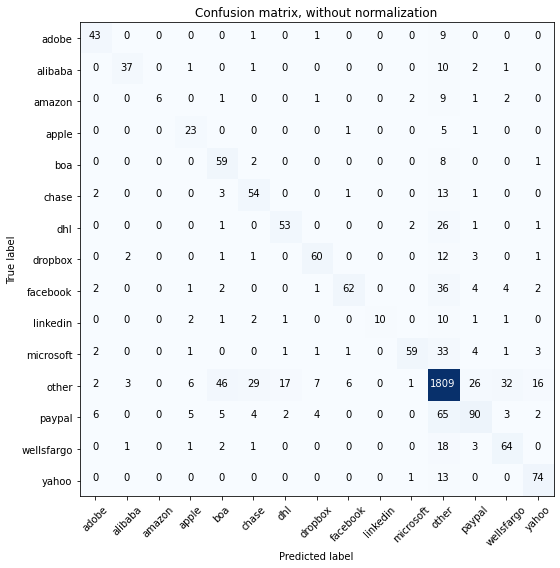

Acc     =  0.813
Pre     =  0.823
Rec     =  0.813
F1      =  0.809

Bal_Acc =  0.66
Bal_Pre =  0.76
Bal_Rec =  0.66
Bal_F1  =  0.706

              precision    recall  f1-score   support

       adobe       0.75      0.80      0.77        54
     alibaba       0.86      0.71      0.78        52
      amazon       1.00      0.27      0.43        22
       apple       0.57      0.77      0.66        30
         boa       0.49      0.84      0.62        70
       chase       0.57      0.73      0.64        74
         dhl       0.72      0.63      0.67        84
     dropbox       0.80      0.75      0.77        80
    facebook       0.87      0.54      0.67       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.91      0.56      0.69       106
       other       0.87      0.90      0.89      2000
      paypal       0.66      0.48      0.56       186
  wellsfargo       0.59      0.71      0.65        90
       yahoo       0.74      0.84      0.79        88


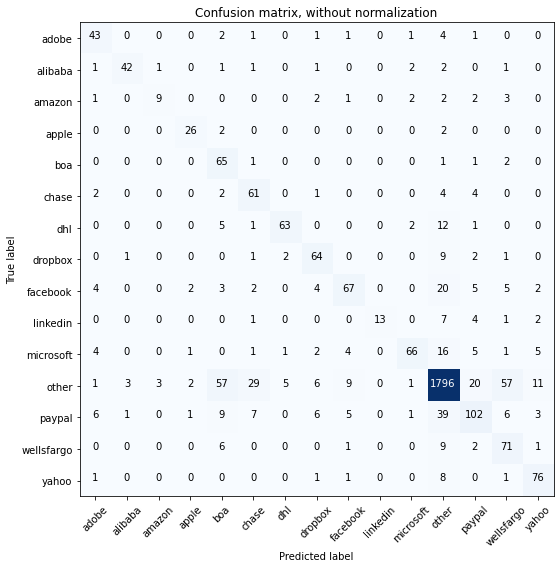

Acc     =  0.833
Pre     =  0.855
Rec     =  0.833
F1      =  0.837

Bal_Acc =  0.73
Bal_Pre =  0.746
Bal_Rec =  0.73
Bal_F1  =  0.738

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       0.89      0.81      0.85        52
      amazon       0.69      0.41      0.51        22
       apple       0.81      0.87      0.84        30
         boa       0.43      0.93      0.59        70
       chase       0.58      0.82      0.68        74
         dhl       0.89      0.75      0.81        84
     dropbox       0.73      0.80      0.76        80
    facebook       0.75      0.59      0.66       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.88      0.62      0.73       106
       other       0.93      0.90      0.91      2000
      paypal       0.68      0.55      0.61       186
  wellsfargo       0.48      0.79      0.59        90
       yahoo       0.76      0.86      0.81        88

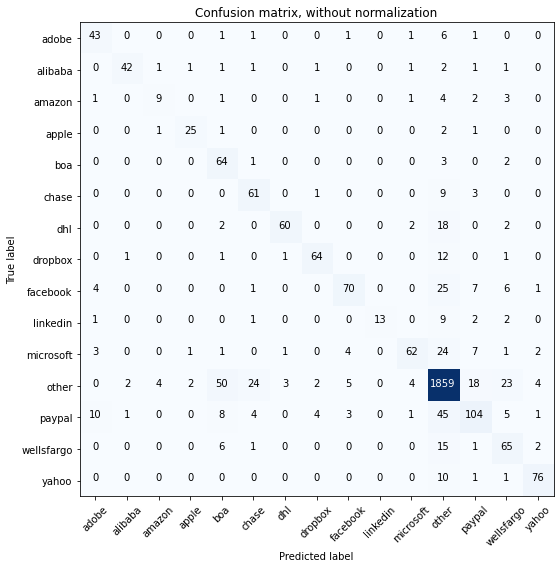

Acc     =  0.85
Pre     =  0.86
Rec     =  0.85
F1      =  0.849

Bal_Acc =  0.722
Bal_Pre =  0.784
Bal_Rec =  0.722
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.91      0.81      0.86        52
      amazon       0.60      0.41      0.49        22
       apple       0.86      0.83      0.85        30
         boa       0.47      0.91      0.62        70
       chase       0.64      0.82      0.72        74
         dhl       0.92      0.71      0.81        84
     dropbox       0.88      0.80      0.84        80
    facebook       0.84      0.61      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.86      0.58      0.70       106
       other       0.91      0.93      0.92      2000
      paypal       0.70      0.56      0.62       186
  wellsfargo       0.58      0.72      0.64        90
       yahoo       0.88      0.86      0.87        88


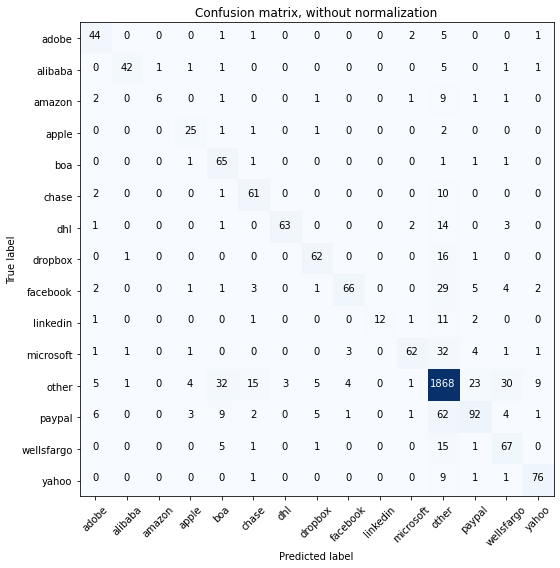

Acc     =  0.848
Pre     =  0.855
Rec     =  0.848
F1      =  0.844

Bal_Acc =  0.709
Bal_Pre =  0.8
Bal_Rec =  0.709
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.93      0.81      0.87        52
      amazon       0.86      0.27      0.41        22
       apple       0.69      0.83      0.76        30
         boa       0.55      0.93      0.69        70
       chase       0.70      0.82      0.76        74
         dhl       0.95      0.75      0.84        84
     dropbox       0.82      0.78      0.79        80
    facebook       0.89      0.58      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.89      0.58      0.70       106
       other       0.89      0.93      0.91      2000
      paypal       0.70      0.49      0.58       186
  wellsfargo       0.59      0.74      0.66        90
       yahoo       0.84      0.86      0.85        88

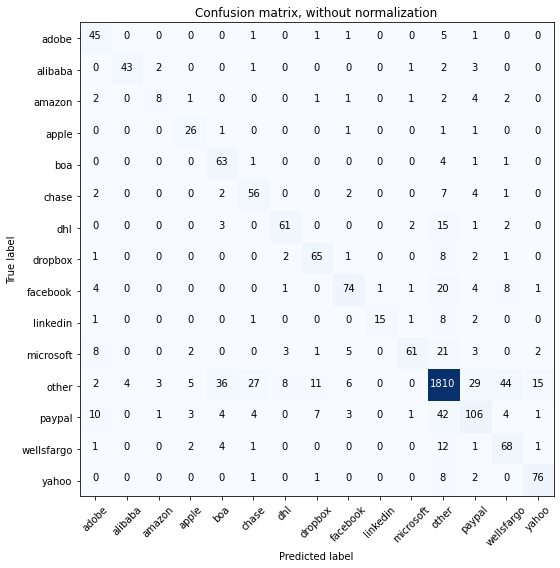

Acc     =  0.837
Pre     =  0.849
Rec     =  0.837
F1      =  0.838

Bal_Acc =  0.729
Bal_Pre =  0.731
Bal_Rec =  0.729
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.59      0.83      0.69        54
     alibaba       0.91      0.83      0.87        52
      amazon       0.57      0.36      0.44        22
       apple       0.67      0.87      0.75        30
         boa       0.56      0.90      0.69        70
       chase       0.60      0.76      0.67        74
         dhl       0.81      0.73      0.77        84
     dropbox       0.75      0.81      0.78        80
    facebook       0.79      0.65      0.71       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.90      0.58      0.70       106
       other       0.92      0.91      0.91      2000
      paypal       0.65      0.57      0.61       186
  wellsfargo       0.52      0.76      0.62        90
       yahoo       0.79      0.86      0.83        8

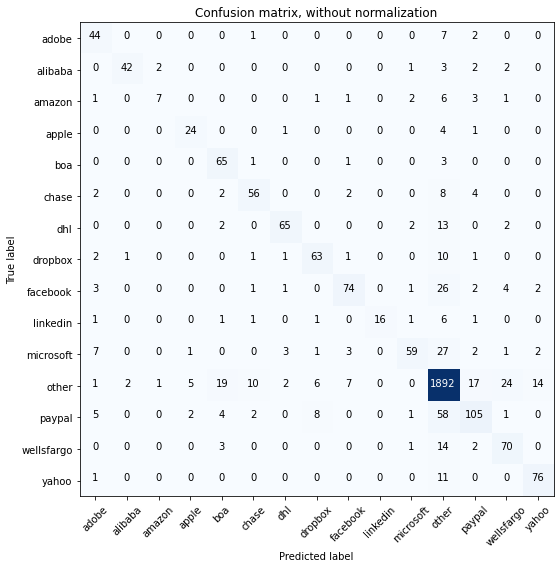

Acc     =  0.864
Pre     =  0.864
Rec     =  0.864
F1      =  0.859

Bal_Acc =  0.728
Bal_Pre =  0.799
Bal_Rec =  0.728
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.93      0.81      0.87        52
      amazon       0.70      0.32      0.44        22
       apple       0.75      0.80      0.77        30
         boa       0.68      0.93      0.78        70
       chase       0.77      0.76      0.76        74
         dhl       0.89      0.77      0.83        84
     dropbox       0.79      0.79      0.79        80
    facebook       0.83      0.65      0.73       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.87      0.56      0.68       106
       other       0.91      0.95      0.93      2000
      paypal       0.74      0.56      0.64       186
  wellsfargo       0.67      0.78      0.72        90
       yahoo       0.81      0.86      0.84        

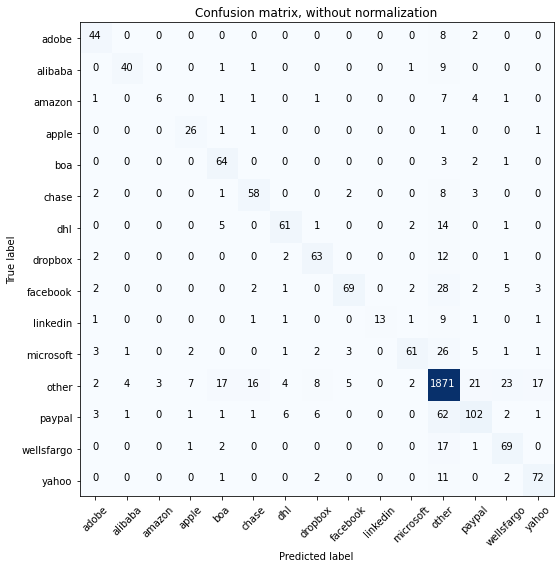

Acc     =  0.851
Pre     =  0.852
Rec     =  0.851
F1      =  0.846

Bal_Acc =  0.71
Bal_Pre =  0.78
Bal_Rec =  0.71
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.67      0.27      0.39        22
       apple       0.70      0.87      0.78        30
         boa       0.68      0.91      0.78        70
       chase       0.72      0.78      0.75        74
         dhl       0.80      0.73      0.76        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.87      0.61      0.72       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.88      0.58      0.70       106
       other       0.90      0.94      0.92      2000
      paypal       0.71      0.55      0.62       186
  wellsfargo       0.65      0.77      0.70        90
       yahoo       0.75      0.82      0.78        88


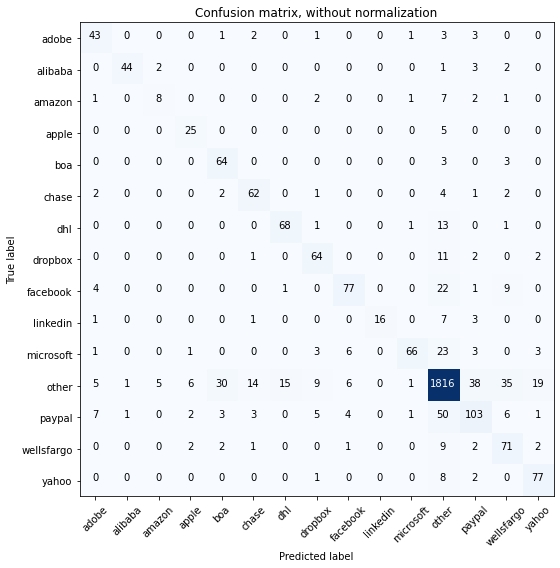

Acc     =  0.846
Pre     =  0.854
Rec     =  0.846
F1      =  0.846

Bal_Acc =  0.746
Bal_Pre =  0.757
Bal_Rec =  0.746
Bal_F1  =  0.751

              precision    recall  f1-score   support

       adobe       0.67      0.80      0.73        54
     alibaba       0.96      0.85      0.90        52
      amazon       0.53      0.36      0.43        22
       apple       0.69      0.83      0.76        30
         boa       0.63      0.91      0.74        70
       chase       0.74      0.84      0.78        74
         dhl       0.81      0.81      0.81        84
     dropbox       0.74      0.80      0.77        80
    facebook       0.82      0.68      0.74       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.93      0.62      0.75       106
       other       0.92      0.91      0.91      2000
      paypal       0.63      0.55      0.59       186
  wellsfargo       0.55      0.79      0.65        90
       yahoo       0.74      0.88      0.80        

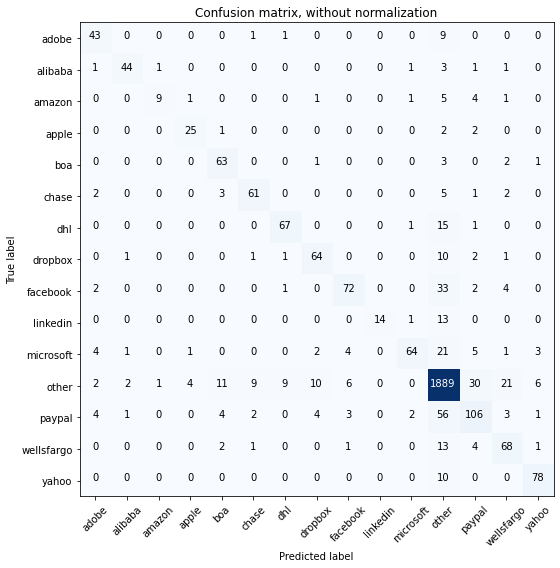

Acc     =  0.866
Pre     =  0.866
Rec     =  0.866
F1      =  0.863

Bal_Acc =  0.74
Bal_Pre =  0.82
Bal_Rec =  0.74
Bal_F1  =  0.778

              precision    recall  f1-score   support

       adobe       0.74      0.80      0.77        54
     alibaba       0.90      0.85      0.87        52
      amazon       0.82      0.41      0.55        22
       apple       0.81      0.83      0.82        30
         boa       0.75      0.90      0.82        70
       chase       0.81      0.82      0.82        74
         dhl       0.85      0.80      0.82        84
     dropbox       0.78      0.80      0.79        80
    facebook       0.84      0.63      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.91      0.60      0.73       106
       other       0.91      0.94      0.92      2000
      paypal       0.67      0.57      0.62       186
  wellsfargo       0.65      0.76      0.70        90
       yahoo       0.87      0.89      0.88        88


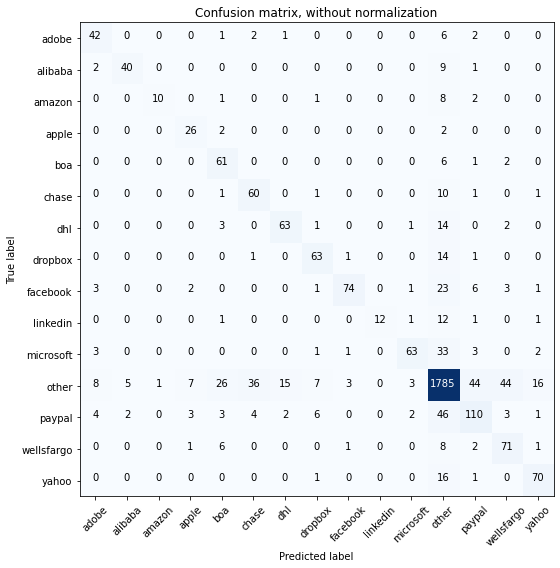

Acc     =  0.828
Pre     =  0.84
Rec     =  0.828
F1      =  0.829

Bal_Acc =  0.722
Bal_Pre =  0.765
Bal_Rec =  0.722
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.85      0.77      0.81        52
      amazon       0.91      0.45      0.61        22
       apple       0.67      0.87      0.75        30
         boa       0.58      0.87      0.70        70
       chase       0.58      0.81      0.68        74
         dhl       0.78      0.75      0.76        84
     dropbox       0.77      0.79      0.78        80
    facebook       0.93      0.65      0.76       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.89      0.59      0.71       106
       other       0.90      0.89      0.89      2000
      paypal       0.63      0.59      0.61       186
  wellsfargo       0.57      0.79      0.66        90
       yahoo       0.75      0.80      0.77        8

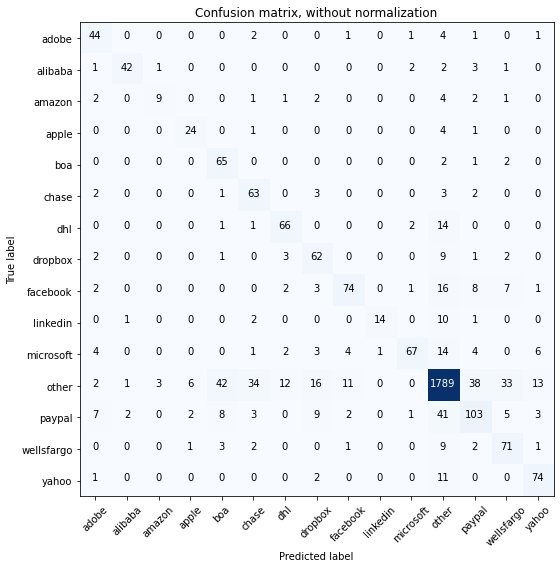

Acc     =  0.834
Pre     =  0.849
Rec     =  0.834
F1      =  0.836

Bal_Acc =  0.735
Bal_Pre =  0.733
Bal_Rec =  0.735
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.91      0.81      0.86        52
      amazon       0.69      0.41      0.51        22
       apple       0.73      0.80      0.76        30
         boa       0.54      0.93      0.68        70
       chase       0.57      0.85      0.68        74
         dhl       0.77      0.79      0.78        84
     dropbox       0.62      0.78      0.69        80
    facebook       0.80      0.65      0.71       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.91      0.63      0.74       106
       other       0.93      0.89      0.91      2000
      paypal       0.62      0.55      0.58       186
  wellsfargo       0.58      0.79      0.67        90
       yahoo       0.75      0.84      0.79        

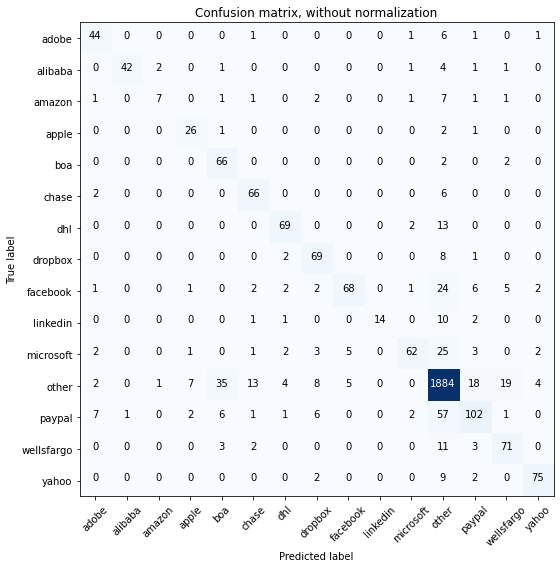

Acc     =  0.866
Pre     =  0.869
Rec     =  0.866
F1      =  0.862

Bal_Acc =  0.743
Bal_Pre =  0.804
Bal_Rec =  0.743
Bal_F1  =  0.772

              precision    recall  f1-score   support

       adobe       0.75      0.81      0.78        54
     alibaba       0.98      0.81      0.88        52
      amazon       0.70      0.32      0.44        22
       apple       0.70      0.87      0.78        30
         boa       0.58      0.94      0.72        70
       chase       0.75      0.89      0.81        74
         dhl       0.85      0.82      0.84        84
     dropbox       0.75      0.86      0.80        80
    facebook       0.87      0.60      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.58      0.70       106
       other       0.91      0.94      0.93      2000
      paypal       0.72      0.55      0.62       186
  wellsfargo       0.71      0.79      0.75        90
       yahoo       0.89      0.85      0.87        

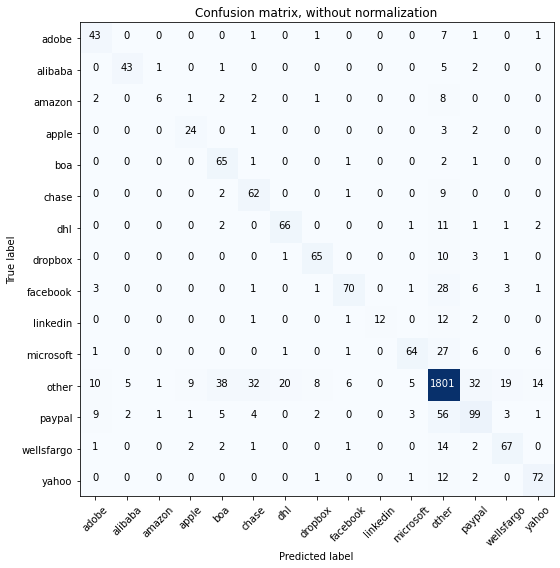

Acc     =  0.831
Pre     =  0.839
Rec     =  0.831
F1      =  0.83

Bal_Acc =  0.713
Bal_Pre =  0.747
Bal_Rec =  0.713
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.62      0.80      0.70        54
     alibaba       0.86      0.83      0.84        52
      amazon       0.67      0.27      0.39        22
       apple       0.65      0.80      0.72        30
         boa       0.56      0.93      0.70        70
       chase       0.58      0.84      0.69        74
         dhl       0.75      0.79      0.77        84
     dropbox       0.82      0.81      0.82        80
    facebook       0.86      0.61      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.85      0.60      0.71       106
       other       0.90      0.90      0.90      2000
      paypal       0.62      0.53      0.57       186
  wellsfargo       0.71      0.74      0.73        90
       yahoo       0.74      0.82      0.78        88

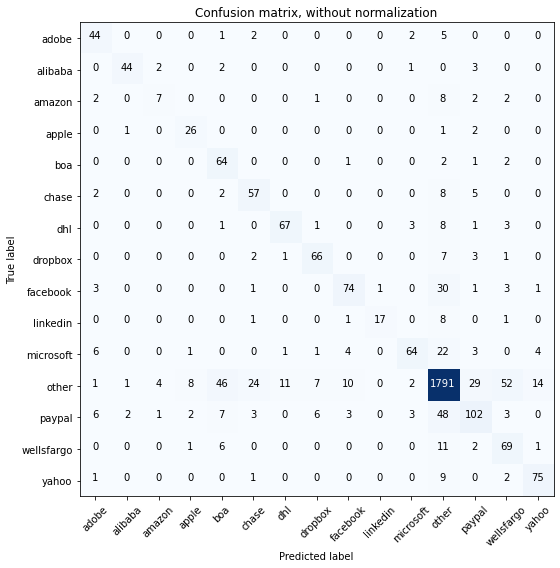

Acc     =  0.834
Pre     =  0.847
Rec     =  0.834
F1      =  0.836

Bal_Acc =  0.738
Bal_Pre =  0.734
Bal_Rec =  0.738
Bal_F1  =  0.736

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.92      0.85      0.88        52
      amazon       0.50      0.32      0.39        22
       apple       0.68      0.87      0.76        30
         boa       0.50      0.91      0.64        70
       chase       0.63      0.77      0.69        74
         dhl       0.84      0.80      0.82        84
     dropbox       0.80      0.82      0.81        80
    facebook       0.80      0.65      0.71       114
    linkedin       0.94      0.61      0.74        28
   microsoft       0.85      0.60      0.71       106
       other       0.91      0.90      0.91      2000
      paypal       0.66      0.55      0.60       186
  wellsfargo       0.50      0.77      0.61        90
       yahoo       0.79      0.85      0.82        

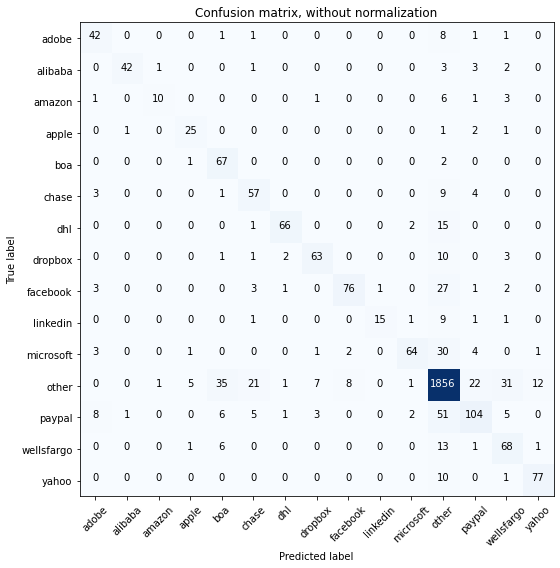

Acc     =  0.855
Pre     =  0.863
Rec     =  0.855
F1      =  0.854

Bal_Acc =  0.74
Bal_Pre =  0.8
Bal_Rec =  0.74
Bal_F1  =  0.769

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.83      0.45      0.59        22
       apple       0.76      0.83      0.79        30
         boa       0.57      0.96      0.72        70
       chase       0.63      0.77      0.69        74
         dhl       0.93      0.79      0.85        84
     dropbox       0.84      0.79      0.81        80
    facebook       0.88      0.67      0.76       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.91      0.60      0.73       106
       other       0.91      0.93      0.92      2000
      paypal       0.72      0.56      0.63       186
  wellsfargo       0.58      0.76      0.65        90
       yahoo       0.85      0.88      0.86        88



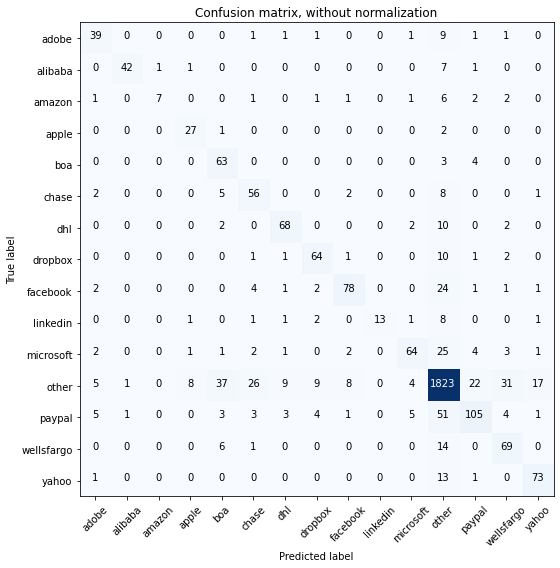

Acc     =  0.842
Pre     =  0.85
Rec     =  0.842
F1      =  0.841

Bal_Acc =  0.723
Bal_Pre =  0.772
Bal_Rec =  0.723
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.68      0.72      0.70        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.88      0.32      0.47        22
       apple       0.71      0.90      0.79        30
         boa       0.53      0.90      0.67        70
       chase       0.58      0.76      0.66        74
         dhl       0.80      0.81      0.80        84
     dropbox       0.77      0.80      0.79        80
    facebook       0.84      0.68      0.75       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.82      0.60      0.70       106
       other       0.91      0.91      0.91      2000
      paypal       0.74      0.56      0.64       186
  wellsfargo       0.60      0.77      0.67        90
       yahoo       0.77      0.83      0.80        8

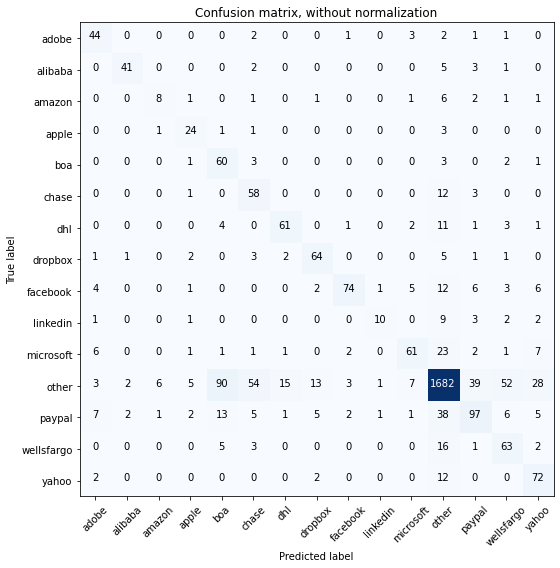

Acc     =  0.786
Pre     =  0.822
Rec     =  0.786
F1      =  0.795

Bal_Acc =  0.693
Bal_Pre =  0.661
Bal_Rec =  0.693
Bal_F1  =  0.677

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.50      0.36      0.42        22
       apple       0.62      0.80      0.70        30
         boa       0.34      0.86      0.49        70
       chase       0.44      0.78      0.56        74
         dhl       0.76      0.73      0.74        84
     dropbox       0.74      0.80      0.77        80
    facebook       0.89      0.65      0.75       114
    linkedin       0.77      0.36      0.49        28
   microsoft       0.76      0.58      0.66       106
       other       0.91      0.84      0.88      2000
      paypal       0.61      0.52      0.56       186
  wellsfargo       0.46      0.70      0.56        90
       yahoo       0.58      0.82      0.68        

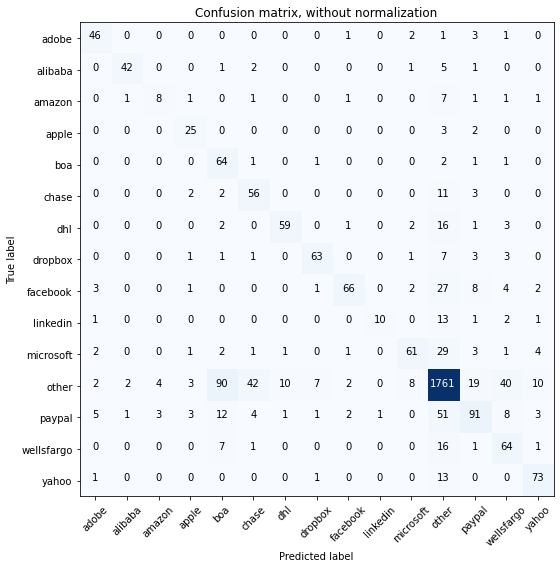

Acc     =  0.809
Pre     =  0.833
Rec     =  0.809
F1      =  0.813

Bal_Acc =  0.696
Bal_Pre =  0.724
Bal_Rec =  0.696
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.77      0.85      0.81        54
     alibaba       0.91      0.81      0.86        52
      amazon       0.53      0.36      0.43        22
       apple       0.68      0.83      0.75        30
         boa       0.35      0.91      0.51        70
       chase       0.51      0.76      0.61        74
         dhl       0.83      0.70      0.76        84
     dropbox       0.85      0.79      0.82        80
    facebook       0.89      0.58      0.70       114
    linkedin       0.91      0.36      0.51        28
   microsoft       0.79      0.58      0.67       106
       other       0.90      0.88      0.89      2000
      paypal       0.66      0.49      0.56       186
  wellsfargo       0.50      0.71      0.59        90
       yahoo       0.77      0.83      0.80        8

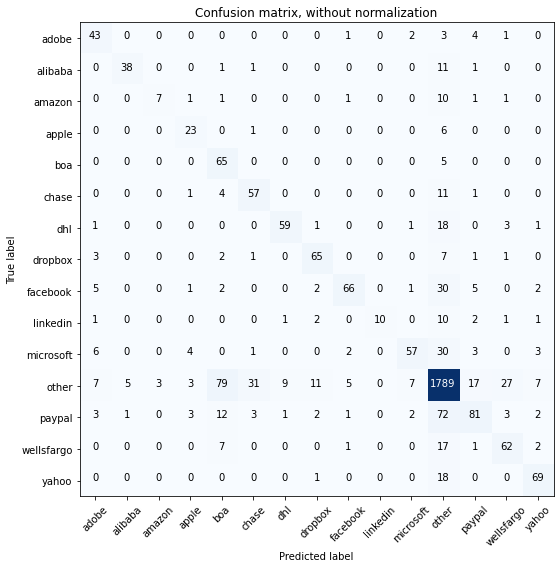

Acc     =  0.809
Pre     =  0.825
Rec     =  0.809
F1      =  0.808

Bal_Acc =  0.673
Bal_Pre =  0.739
Bal_Rec =  0.673
Bal_F1  =  0.704

              precision    recall  f1-score   support

       adobe       0.62      0.80      0.70        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.70      0.32      0.44        22
       apple       0.64      0.77      0.70        30
         boa       0.38      0.93      0.53        70
       chase       0.60      0.77      0.67        74
         dhl       0.84      0.70      0.77        84
     dropbox       0.77      0.81      0.79        80
    facebook       0.86      0.58      0.69       114
    linkedin       1.00      0.36      0.53        28
   microsoft       0.81      0.54      0.65       106
       other       0.88      0.89      0.89      2000
      paypal       0.69      0.44      0.53       186
  wellsfargo       0.63      0.69      0.66        90
       yahoo       0.79      0.78      0.79        

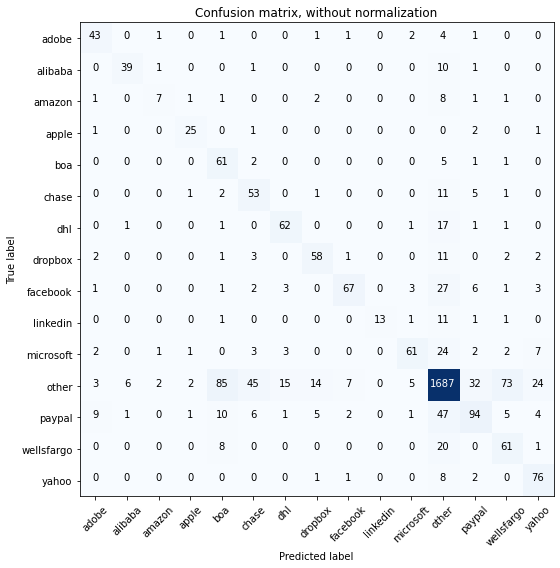

Acc     =  0.782
Pre     =  0.813
Rec     =  0.782
F1      =  0.789

Bal_Acc =  0.684
Bal_Pre =  0.695
Bal_Rec =  0.684
Bal_F1  =  0.689

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.83      0.75      0.79        52
      amazon       0.58      0.32      0.41        22
       apple       0.81      0.83      0.82        30
         boa       0.35      0.87      0.50        70
       chase       0.46      0.72      0.56        74
         dhl       0.74      0.74      0.74        84
     dropbox       0.71      0.72      0.72        80
    facebook       0.85      0.59      0.69       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.82      0.58      0.68       106
       other       0.89      0.84      0.87      2000
      paypal       0.63      0.51      0.56       186
  wellsfargo       0.41      0.68      0.51        90
       yahoo       0.64      0.86      0.74        

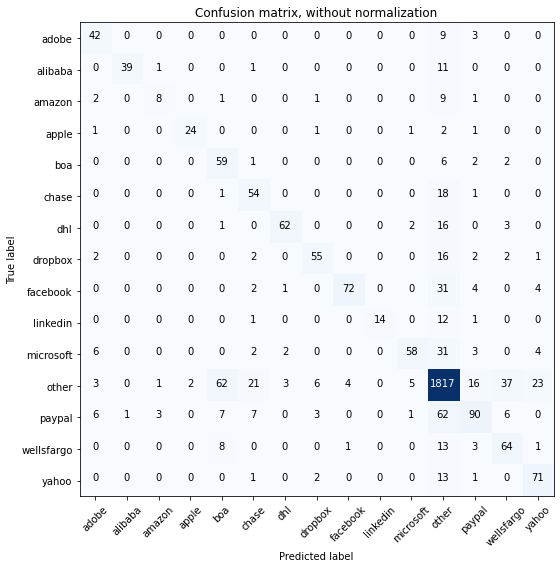

Acc     =  0.822
Pre     =  0.835
Rec     =  0.822
F1      =  0.821

Bal_Acc =  0.685
Bal_Pre =  0.77
Bal_Rec =  0.685
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.97      0.75      0.85        52
      amazon       0.62      0.36      0.46        22
       apple       0.92      0.80      0.86        30
         boa       0.42      0.84      0.56        70
       chase       0.59      0.73      0.65        74
         dhl       0.91      0.74      0.82        84
     dropbox       0.81      0.69      0.74        80
    facebook       0.94      0.63      0.75       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.87      0.55      0.67       106
       other       0.88      0.91      0.89      2000
      paypal       0.70      0.48      0.57       186
  wellsfargo       0.56      0.71      0.63        90
       yahoo       0.68      0.81      0.74        8

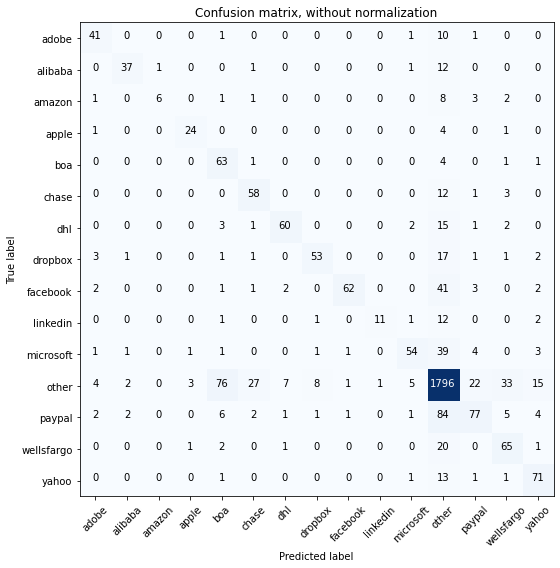

Acc     =  0.805
Pre     =  0.819
Rec     =  0.805
F1      =  0.801

Bal_Acc =  0.659
Bal_Pre =  0.766
Bal_Rec =  0.659
Bal_F1  =  0.708

              precision    recall  f1-score   support

       adobe       0.75      0.76      0.75        54
     alibaba       0.86      0.71      0.78        52
      amazon       0.86      0.27      0.41        22
       apple       0.83      0.80      0.81        30
         boa       0.40      0.90      0.56        70
       chase       0.62      0.78      0.69        74
         dhl       0.85      0.71      0.77        84
     dropbox       0.83      0.66      0.74        80
    facebook       0.95      0.54      0.69       114
    linkedin       0.92      0.39      0.55        28
   microsoft       0.82      0.51      0.63       106
       other       0.86      0.90      0.88      2000
      paypal       0.68      0.41      0.51       186
  wellsfargo       0.57      0.72      0.64        90
       yahoo       0.70      0.81      0.75        

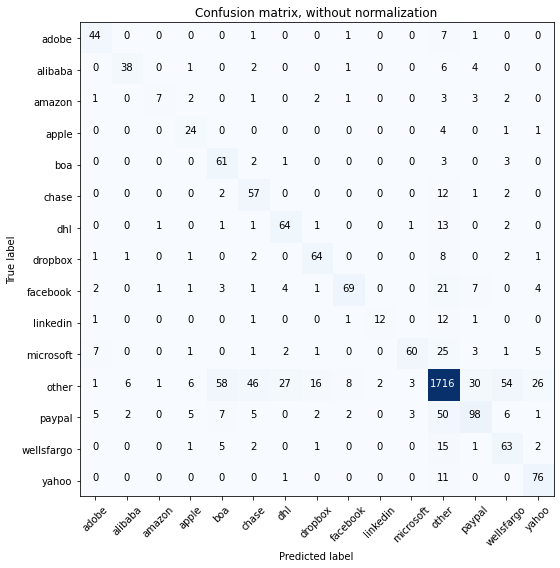

Acc     =  0.797
Pre     =  0.821
Rec     =  0.797
F1      =  0.801

Bal_Acc =  0.694
Bal_Pre =  0.689
Bal_Rec =  0.694
Bal_F1  =  0.691

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        54
     alibaba       0.81      0.73      0.77        52
      amazon       0.70      0.32      0.44        22
       apple       0.57      0.80      0.67        30
         boa       0.45      0.87      0.59        70
       chase       0.47      0.77      0.58        74
         dhl       0.65      0.76      0.70        84
     dropbox       0.73      0.80      0.76        80
    facebook       0.83      0.61      0.70       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.90      0.57      0.69       106
       other       0.90      0.86      0.88      2000
      paypal       0.66      0.53      0.59       186
  wellsfargo       0.46      0.70      0.56        90
       yahoo       0.66      0.86      0.75        

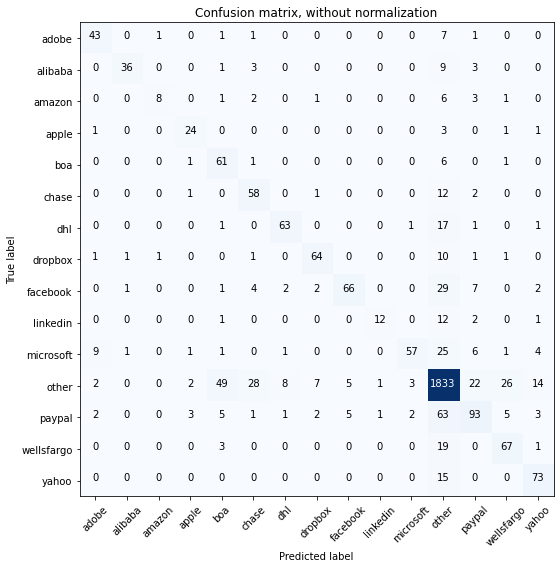

Acc     =  0.831
Pre     =  0.839
Rec     =  0.831
F1      =  0.828

Bal_Acc =  0.693
Bal_Pre =  0.768
Bal_Rec =  0.693
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.74      0.80      0.77        54
     alibaba       0.92      0.69      0.79        52
      amazon       0.80      0.36      0.50        22
       apple       0.75      0.80      0.77        30
         boa       0.49      0.87      0.63        70
       chase       0.59      0.78      0.67        74
         dhl       0.84      0.75      0.79        84
     dropbox       0.83      0.80      0.82        80
    facebook       0.87      0.58      0.69       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.90      0.54      0.67       106
       other       0.89      0.92      0.90      2000
      paypal       0.66      0.50      0.57       186
  wellsfargo       0.65      0.74      0.69        90
       yahoo       0.73      0.83      0.78        

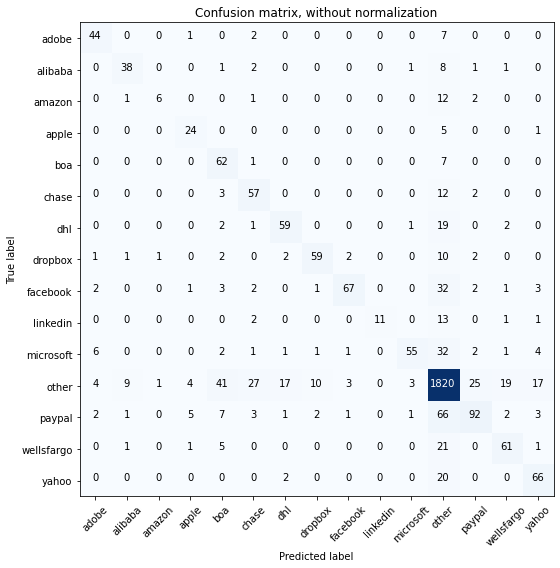

Acc     =  0.819
Pre     =  0.828
Rec     =  0.819
F1      =  0.815

Bal_Acc =  0.67
Bal_Pre =  0.752
Bal_Rec =  0.67
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.75      0.81      0.78        54
     alibaba       0.75      0.73      0.74        52
      amazon       0.75      0.27      0.40        22
       apple       0.67      0.80      0.73        30
         boa       0.48      0.89      0.63        70
       chase       0.58      0.77      0.66        74
         dhl       0.72      0.70      0.71        84
     dropbox       0.81      0.74      0.77        80
    facebook       0.91      0.59      0.71       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.90      0.52      0.66       106
       other       0.87      0.91      0.89      2000
      paypal       0.72      0.49      0.59       186
  wellsfargo       0.69      0.68      0.69        90
       yahoo       0.69      0.75      0.72        88

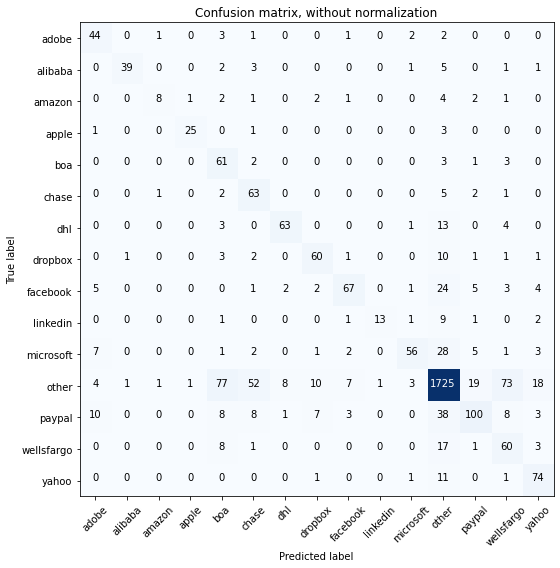

Acc     =  0.799
Pre     =  0.835
Rec     =  0.799
F1      =  0.807

Bal_Acc =  0.698
Bal_Pre =  0.727
Bal_Rec =  0.698
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.62      0.81      0.70        54
     alibaba       0.95      0.75      0.84        52
      amazon       0.73      0.36      0.48        22
       apple       0.93      0.83      0.88        30
         boa       0.36      0.87      0.51        70
       chase       0.46      0.85      0.60        74
         dhl       0.85      0.75      0.80        84
     dropbox       0.72      0.75      0.74        80
    facebook       0.81      0.59      0.68       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.85      0.53      0.65       106
       other       0.91      0.86      0.89      2000
      paypal       0.73      0.54      0.62       186
  wellsfargo       0.38      0.67      0.49        90
       yahoo       0.68      0.84      0.75        

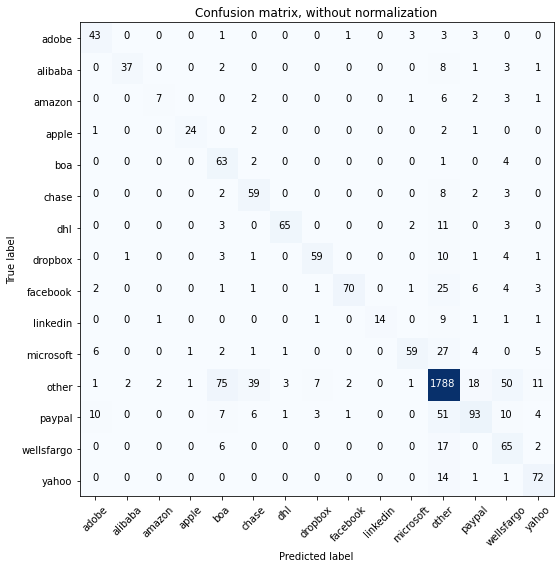

Acc     =  0.818
Pre     =  0.846
Rec     =  0.818
F1      =  0.822

Bal_Acc =  0.696
Bal_Pre =  0.764
Bal_Rec =  0.696
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.68      0.80      0.74        54
     alibaba       0.93      0.71      0.80        52
      amazon       0.70      0.32      0.44        22
       apple       0.92      0.80      0.86        30
         boa       0.38      0.90      0.54        70
       chase       0.52      0.80      0.63        74
         dhl       0.93      0.77      0.84        84
     dropbox       0.83      0.74      0.78        80
    facebook       0.95      0.61      0.74       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.56      0.68       106
       other       0.90      0.89      0.90      2000
      paypal       0.70      0.50      0.58       186
  wellsfargo       0.43      0.72      0.54        90
       yahoo       0.71      0.82      0.76        

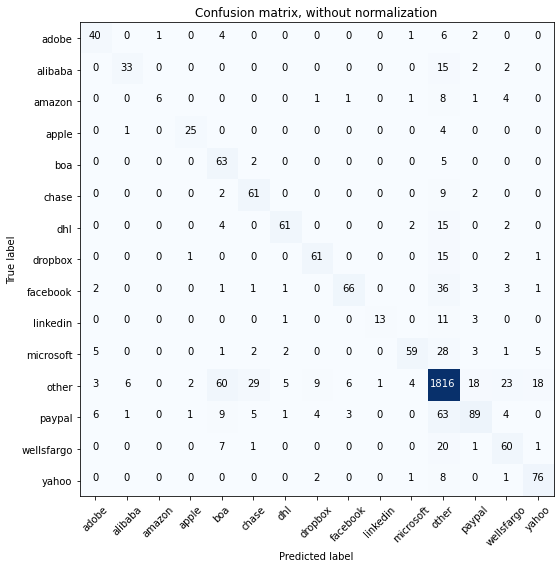

Acc     =  0.822
Pre     =  0.834
Rec     =  0.822
F1      =  0.819

Bal_Acc =  0.681
Bal_Pre =  0.767
Bal_Rec =  0.681
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.71      0.74      0.73        54
     alibaba       0.80      0.63      0.71        52
      amazon       0.86      0.27      0.41        22
       apple       0.86      0.83      0.85        30
         boa       0.42      0.90      0.57        70
       chase       0.60      0.82      0.70        74
         dhl       0.86      0.73      0.79        84
     dropbox       0.79      0.76      0.78        80
    facebook       0.87      0.58      0.69       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.87      0.56      0.68       106
       other       0.88      0.91      0.89      2000
      paypal       0.72      0.48      0.57       186
  wellsfargo       0.59      0.67      0.62        90
       yahoo       0.75      0.86      0.80        

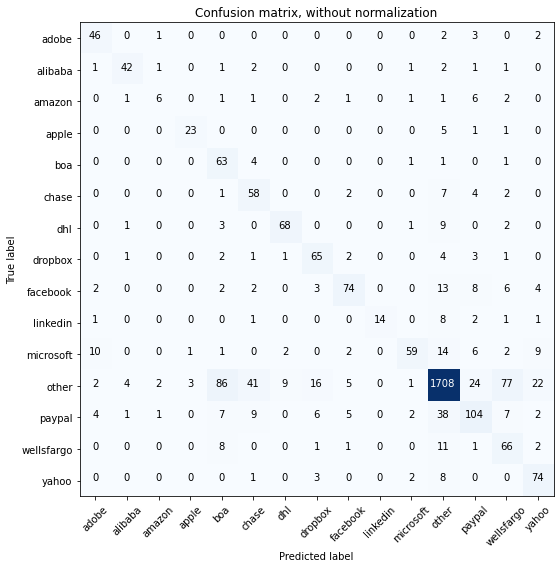

Acc     =  0.802
Pre     =  0.842
Rec     =  0.802
F1      =  0.813

Bal_Acc =  0.713
Bal_Pre =  0.705
Bal_Rec =  0.713
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.70      0.85      0.77        54
     alibaba       0.84      0.81      0.82        52
      amazon       0.55      0.27      0.36        22
       apple       0.85      0.77      0.81        30
         boa       0.36      0.90      0.51        70
       chase       0.48      0.78      0.60        74
         dhl       0.85      0.81      0.83        84
     dropbox       0.68      0.81      0.74        80
    facebook       0.80      0.65      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.87      0.56      0.68       106
       other       0.93      0.85      0.89      2000
      paypal       0.64      0.56      0.60       186
  wellsfargo       0.39      0.73      0.51        90
       yahoo       0.64      0.84      0.73        

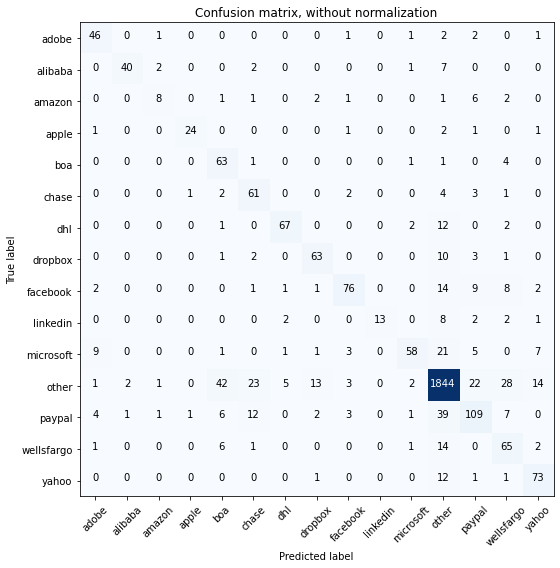

Acc     =  0.848
Pre     =  0.86
Rec     =  0.848
F1      =  0.849

Bal_Acc =  0.722
Bal_Pre =  0.766
Bal_Rec =  0.722
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.72      0.85      0.78        54
     alibaba       0.93      0.77      0.84        52
      amazon       0.62      0.36      0.46        22
       apple       0.92      0.80      0.86        30
         boa       0.51      0.90      0.65        70
       chase       0.59      0.82      0.69        74
         dhl       0.88      0.80      0.84        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.84      0.67      0.75       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.55      0.67       106
       other       0.93      0.92      0.92      2000
      paypal       0.67      0.59      0.62       186
  wellsfargo       0.54      0.72      0.62        90
       yahoo       0.72      0.83      0.77        8

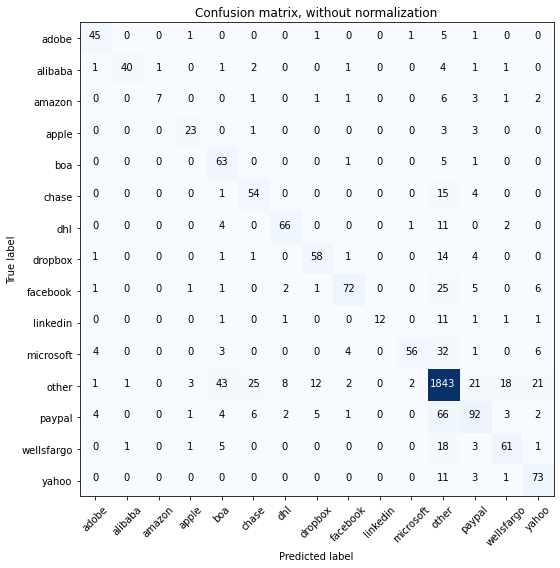

Acc     =  0.833
Pre     =  0.841
Rec     =  0.833
F1      =  0.83

Bal_Acc =  0.689
Bal_Pre =  0.783
Bal_Rec =  0.689
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.79      0.83      0.81        54
     alibaba       0.95      0.77      0.85        52
      amazon       0.88      0.32      0.47        22
       apple       0.77      0.77      0.77        30
         boa       0.50      0.90      0.64        70
       chase       0.60      0.73      0.66        74
         dhl       0.84      0.79      0.81        84
     dropbox       0.74      0.72      0.73        80
    facebook       0.87      0.63      0.73       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.93      0.53      0.67       106
       other       0.89      0.92      0.91      2000
      paypal       0.64      0.49      0.56       186
  wellsfargo       0.69      0.68      0.69        90
       yahoo       0.65      0.83      0.73        8

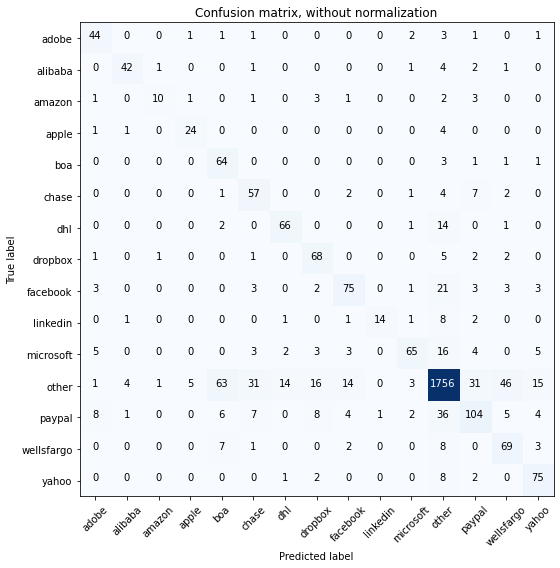

Acc     =  0.823
Pre     =  0.844
Rec     =  0.823
F1      =  0.827

Bal_Acc =  0.735
Bal_Pre =  0.722
Bal_Rec =  0.735
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.77      0.45      0.57        22
       apple       0.77      0.80      0.79        30
         boa       0.44      0.91      0.60        70
       chase       0.54      0.77      0.63        74
         dhl       0.79      0.79      0.79        84
     dropbox       0.67      0.85      0.75        80
    facebook       0.74      0.66      0.69       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.84      0.61      0.71       106
       other       0.93      0.88      0.90      2000
      paypal       0.64      0.56      0.60       186
  wellsfargo       0.53      0.77      0.63        90
       yahoo       0.70      0.85      0.77        

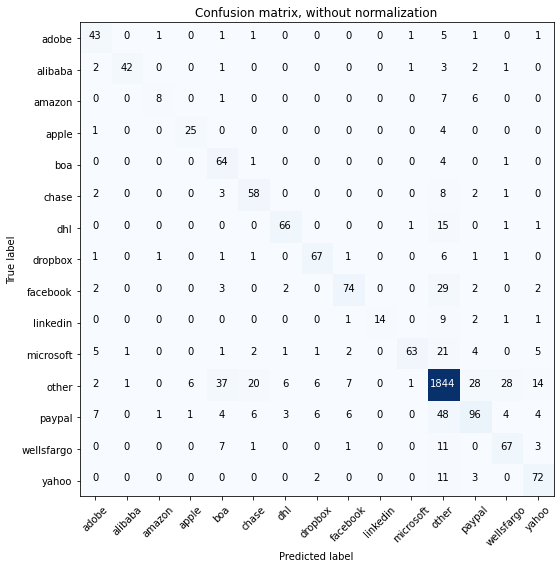

Acc     =  0.846
Pre     =  0.853
Rec     =  0.846
F1      =  0.844

Bal_Acc =  0.724
Bal_Pre =  0.773
Bal_Rec =  0.724
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.66      0.80      0.72        54
     alibaba       0.95      0.81      0.88        52
      amazon       0.73      0.36      0.48        22
       apple       0.78      0.83      0.81        30
         boa       0.52      0.91      0.66        70
       chase       0.64      0.78      0.71        74
         dhl       0.85      0.79      0.81        84
     dropbox       0.82      0.84      0.83        80
    facebook       0.80      0.65      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.94      0.59      0.73       106
       other       0.91      0.92      0.92      2000
      paypal       0.65      0.52      0.58       186
  wellsfargo       0.64      0.74      0.69        90
       yahoo       0.70      0.82      0.75        

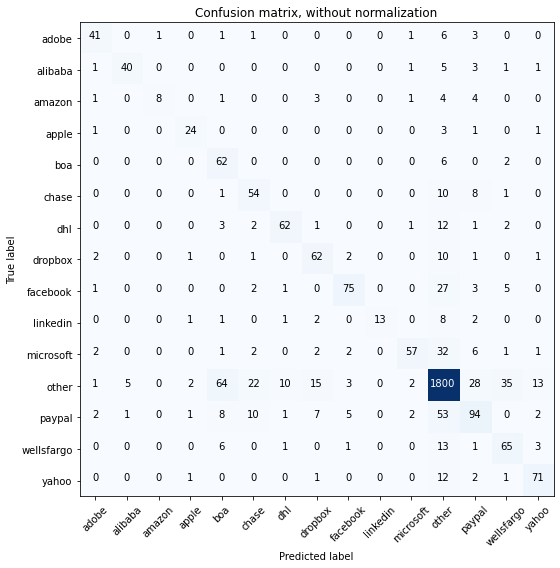

Acc     =  0.821
Pre     =  0.836
Rec     =  0.821
F1      =  0.822

Bal_Acc =  0.694
Bal_Pre =  0.759
Bal_Rec =  0.694
Bal_F1  =  0.725

              precision    recall  f1-score   support

       adobe       0.79      0.76      0.77        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.89      0.36      0.52        22
       apple       0.80      0.80      0.80        30
         boa       0.42      0.89      0.57        70
       chase       0.57      0.73      0.64        74
         dhl       0.82      0.74      0.78        84
     dropbox       0.67      0.78      0.72        80
    facebook       0.85      0.66      0.74       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.88      0.54      0.67       106
       other       0.90      0.90      0.90      2000
      paypal       0.60      0.51      0.55       186
  wellsfargo       0.58      0.72      0.64        90
       yahoo       0.76      0.81      0.78        

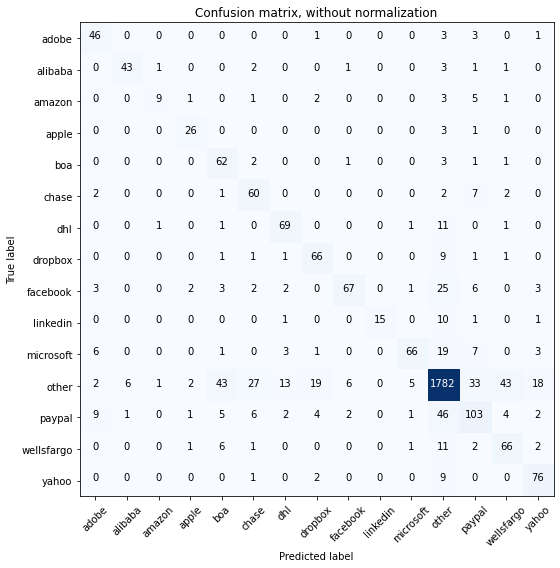

Acc     =  0.83
Pre     =  0.845
Rec     =  0.83
F1      =  0.832

Bal_Acc =  0.739
Bal_Pre =  0.743
Bal_Rec =  0.739
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.68      0.85      0.75        54
     alibaba       0.86      0.83      0.84        52
      amazon       0.75      0.41      0.53        22
       apple       0.79      0.87      0.83        30
         boa       0.50      0.89      0.64        70
       chase       0.58      0.81      0.68        74
         dhl       0.76      0.82      0.79        84
     dropbox       0.69      0.82      0.75        80
    facebook       0.87      0.59      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.88      0.62      0.73       106
       other       0.92      0.89      0.90      2000
      paypal       0.60      0.55      0.58       186
  wellsfargo       0.55      0.73      0.63        90
       yahoo       0.72      0.86      0.78        88

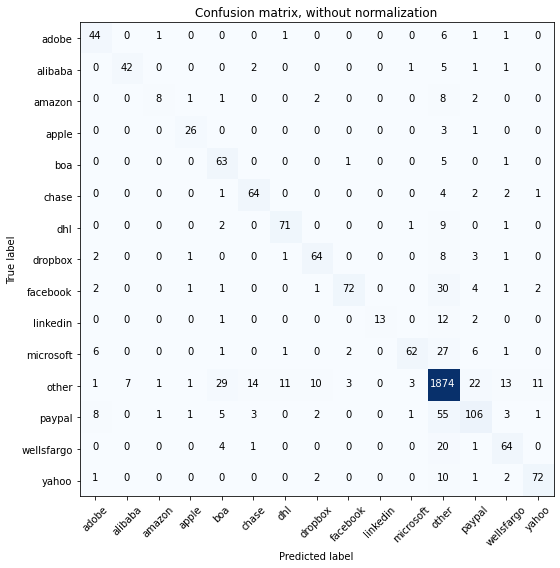

Acc     =  0.859
Pre     =  0.862
Rec     =  0.859
F1      =  0.856

Bal_Acc =  0.732
Bal_Pre =  0.803
Bal_Rec =  0.732
Bal_F1  =  0.766

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.73      0.36      0.48        22
       apple       0.84      0.87      0.85        30
         boa       0.58      0.90      0.71        70
       chase       0.76      0.86      0.81        74
         dhl       0.84      0.85      0.84        84
     dropbox       0.79      0.80      0.80        80
    facebook       0.92      0.63      0.75       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.91      0.58      0.71       106
       other       0.90      0.94      0.92      2000
      paypal       0.70      0.57      0.63       186
  wellsfargo       0.70      0.71      0.71        90
       yahoo       0.83      0.82      0.82        

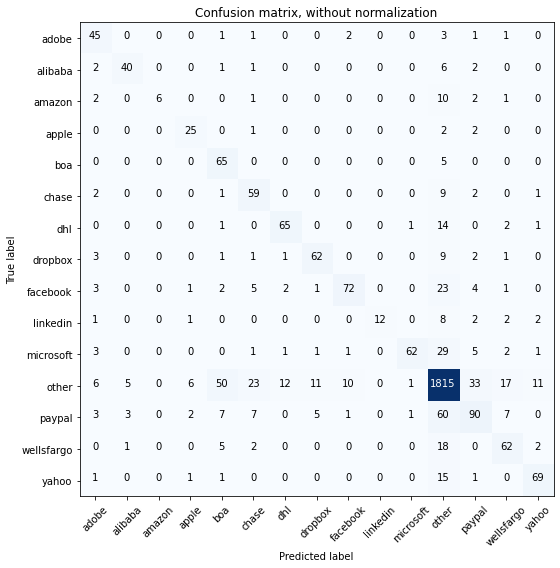

Acc     =  0.828
Pre     =  0.84
Rec     =  0.828
F1      =  0.826

Bal_Acc =  0.7
Bal_Pre =  0.768
Bal_Rec =  0.7
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.63      0.83      0.72        54
     alibaba       0.82      0.77      0.79        52
      amazon       1.00      0.27      0.43        22
       apple       0.69      0.83      0.76        30
         boa       0.48      0.93      0.63        70
       chase       0.58      0.80      0.67        74
         dhl       0.80      0.77      0.79        84
     dropbox       0.78      0.78      0.78        80
    facebook       0.84      0.63      0.72       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.95      0.58      0.73       106
       other       0.90      0.91      0.90      2000
      paypal       0.62      0.48      0.54       186
  wellsfargo       0.65      0.69      0.67        90
       yahoo       0.79      0.78      0.79        88

 

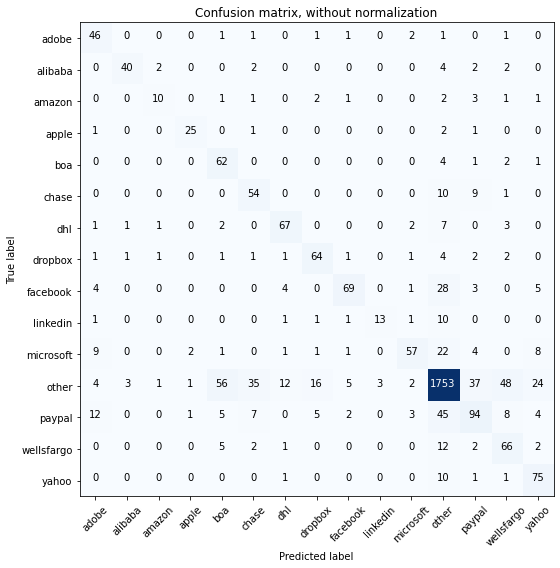

Acc     =  0.811
Pre     =  0.831
Rec     =  0.811
F1      =  0.814

Bal_Acc =  0.713
Bal_Pre =  0.704
Bal_Rec =  0.713
Bal_F1  =  0.708

              precision    recall  f1-score   support

       adobe       0.58      0.85      0.69        54
     alibaba       0.89      0.77      0.82        52
      amazon       0.67      0.45      0.54        22
       apple       0.86      0.83      0.85        30
         boa       0.46      0.89      0.61        70
       chase       0.52      0.73      0.61        74
         dhl       0.76      0.80      0.78        84
     dropbox       0.71      0.80      0.75        80
    facebook       0.85      0.61      0.71       114
    linkedin       0.81      0.46      0.59        28
   microsoft       0.83      0.54      0.65       106
       other       0.92      0.88      0.90      2000
      paypal       0.59      0.51      0.54       186
  wellsfargo       0.49      0.73      0.59        90
       yahoo       0.62      0.85      0.72        

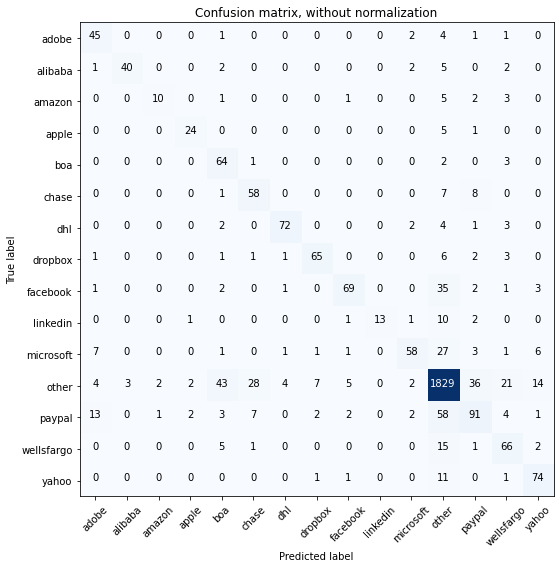

Acc     =  0.838
Pre     =  0.846
Rec     =  0.838
F1      =  0.836

Bal_Acc =  0.721
Bal_Pre =  0.773
Bal_Rec =  0.721
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.62      0.83      0.71        54
     alibaba       0.93      0.77      0.84        52
      amazon       0.77      0.45      0.57        22
       apple       0.83      0.80      0.81        30
         boa       0.51      0.91      0.65        70
       chase       0.60      0.78      0.68        74
         dhl       0.91      0.86      0.88        84
     dropbox       0.86      0.81      0.83        80
    facebook       0.86      0.61      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.84      0.55      0.66       106
       other       0.90      0.91      0.91      2000
      paypal       0.61      0.49      0.54       186
  wellsfargo       0.61      0.73      0.66        90
       yahoo       0.74      0.84      0.79        

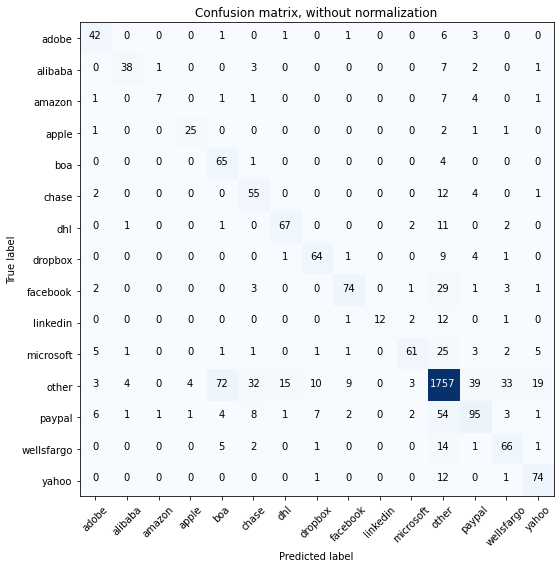

Acc     =  0.813
Pre     =  0.829
Rec     =  0.813
F1      =  0.815

Bal_Acc =  0.703
Bal_Pre =  0.742
Bal_Rec =  0.703
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.84      0.73      0.78        52
      amazon       0.78      0.32      0.45        22
       apple       0.83      0.83      0.83        30
         boa       0.43      0.93      0.59        70
       chase       0.52      0.74      0.61        74
         dhl       0.79      0.80      0.79        84
     dropbox       0.76      0.80      0.78        80
    facebook       0.83      0.65      0.73       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.86      0.58      0.69       106
       other       0.90      0.88      0.89      2000
      paypal       0.61      0.51      0.55       186
  wellsfargo       0.58      0.73      0.65        90
       yahoo       0.71      0.84      0.77        

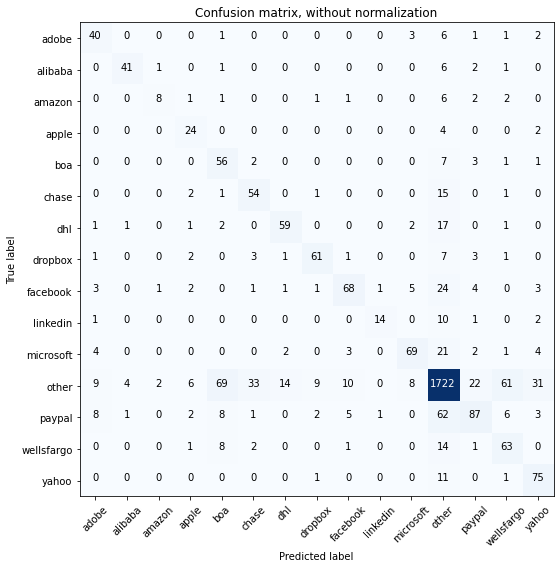

Acc     =  0.793
Pre     =  0.814
Rec     =  0.793
F1      =  0.797

Bal_Acc =  0.688
Bal_Pre =  0.686
Bal_Rec =  0.688
Bal_F1  =  0.687

              precision    recall  f1-score   support

       adobe       0.60      0.74      0.66        54
     alibaba       0.87      0.79      0.83        52
      amazon       0.67      0.36      0.47        22
       apple       0.59      0.80      0.68        30
         boa       0.38      0.80      0.52        70
       chase       0.56      0.73      0.64        74
         dhl       0.77      0.70      0.73        84
     dropbox       0.80      0.76      0.78        80
    facebook       0.76      0.60      0.67       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.79      0.65      0.72       106
       other       0.89      0.86      0.88      2000
      paypal       0.68      0.47      0.55       186
  wellsfargo       0.45      0.70      0.55        90
       yahoo       0.61      0.85      0.71        

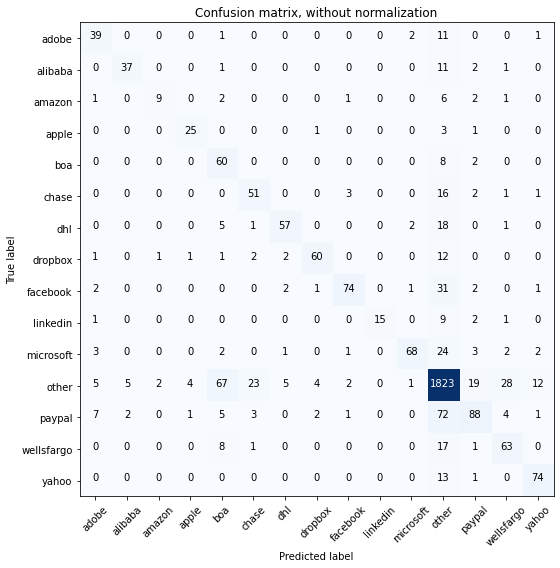

Acc     =  0.826
Pre     =  0.838
Rec     =  0.826
F1      =  0.825

Bal_Acc =  0.694
Bal_Pre =  0.776
Bal_Rec =  0.694
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.66      0.72      0.69        54
     alibaba       0.84      0.71      0.77        52
      amazon       0.75      0.41      0.53        22
       apple       0.81      0.83      0.82        30
         boa       0.39      0.86      0.54        70
       chase       0.63      0.69      0.66        74
         dhl       0.85      0.68      0.75        84
     dropbox       0.88      0.75      0.81        80
    facebook       0.90      0.65      0.76       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.92      0.64      0.76       106
       other       0.88      0.91      0.89      2000
      paypal       0.70      0.47      0.57       186
  wellsfargo       0.62      0.70      0.66        90
       yahoo       0.80      0.84      0.82        

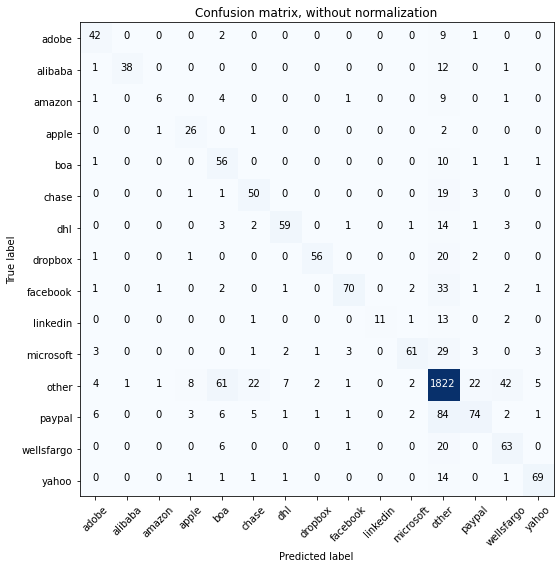

Acc     =  0.813
Pre     =  0.826
Rec     =  0.813
F1      =  0.81

Bal_Acc =  0.66
Bal_Pre =  0.765
Bal_Rec =  0.66
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.70      0.78      0.74        54
     alibaba       0.97      0.73      0.84        52
      amazon       0.67      0.27      0.39        22
       apple       0.65      0.87      0.74        30
         boa       0.39      0.80      0.53        70
       chase       0.60      0.68      0.64        74
         dhl       0.83      0.70      0.76        84
     dropbox       0.93      0.70      0.80        80
    facebook       0.90      0.61      0.73       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.88      0.58      0.70       106
       other       0.86      0.91      0.89      2000
      paypal       0.69      0.40      0.50       186
  wellsfargo       0.53      0.70      0.61        90
       yahoo       0.86      0.78      0.82        88


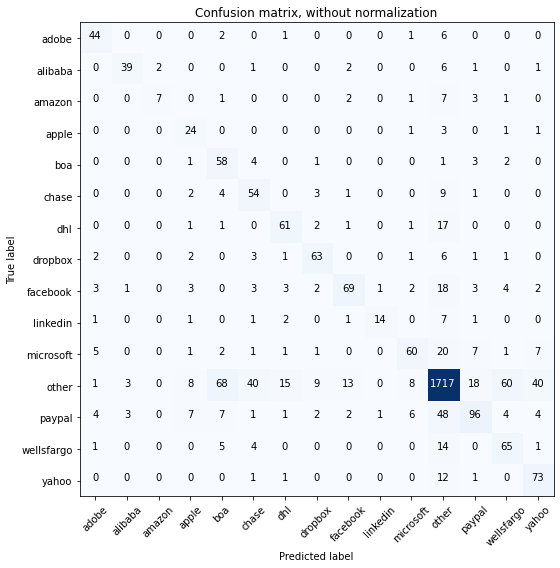

Acc     =  0.794
Pre     =  0.821
Rec     =  0.794
F1      =  0.8

Bal_Acc =  0.69
Bal_Pre =  0.679
Bal_Rec =  0.69
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.85      0.75      0.80        52
      amazon       0.78      0.32      0.45        22
       apple       0.48      0.80      0.60        30
         boa       0.39      0.83      0.53        70
       chase       0.48      0.73      0.58        74
         dhl       0.71      0.73      0.72        84
     dropbox       0.76      0.79      0.77        80
    facebook       0.76      0.61      0.67       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.74      0.57      0.64       106
       other       0.91      0.86      0.88      2000
      paypal       0.71      0.52      0.60       186
  wellsfargo       0.47      0.72      0.57        90
       yahoo       0.57      0.83      0.67        88



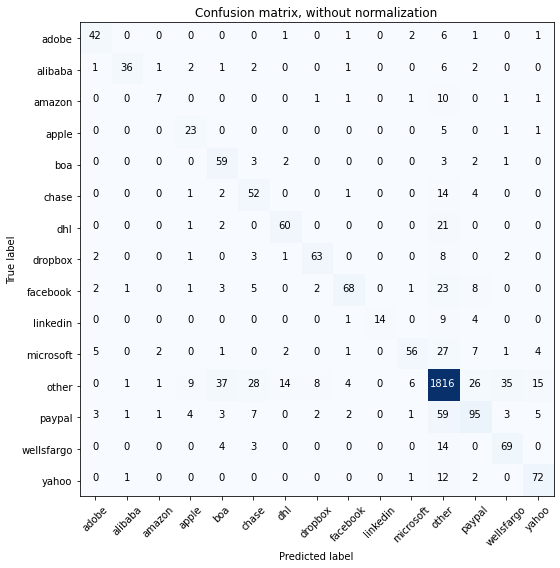

Acc     =  0.823
Pre     =  0.83
Rec     =  0.823
F1      =  0.821

Bal_Acc =  0.682
Bal_Pre =  0.729
Bal_Rec =  0.682
Bal_F1  =  0.705

              precision    recall  f1-score   support

       adobe       0.76      0.78      0.77        54
     alibaba       0.90      0.69      0.78        52
      amazon       0.58      0.32      0.41        22
       apple       0.55      0.77      0.64        30
         boa       0.53      0.84      0.65        70
       chase       0.50      0.70      0.59        74
         dhl       0.75      0.71      0.73        84
     dropbox       0.83      0.79      0.81        80
    facebook       0.85      0.60      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.82      0.53      0.64       106
       other       0.89      0.91      0.90      2000
      paypal       0.63      0.51      0.56       186
  wellsfargo       0.61      0.77      0.68        90
       yahoo       0.73      0.82      0.77        8

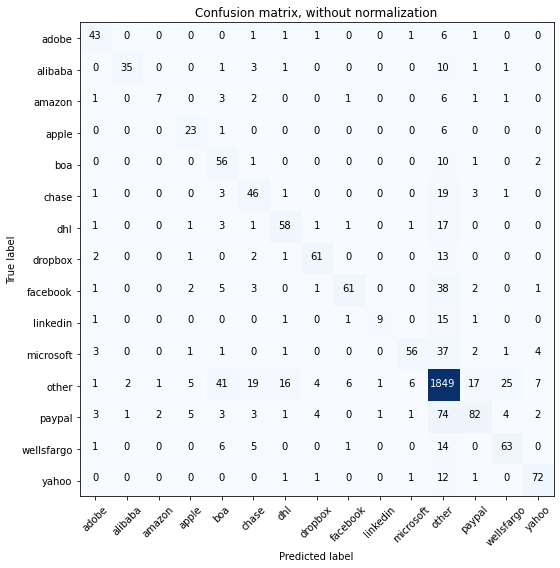

Acc     =  0.819
Pre     =  0.824
Rec     =  0.819
F1      =  0.813

Bal_Acc =  0.646
Bal_Pre =  0.74
Bal_Rec =  0.646
Bal_F1  =  0.69

              precision    recall  f1-score   support

       adobe       0.74      0.80      0.77        54
     alibaba       0.92      0.67      0.78        52
      amazon       0.70      0.32      0.44        22
       apple       0.61      0.77      0.68        30
         boa       0.46      0.80      0.58        70
       chase       0.53      0.62      0.57        74
         dhl       0.71      0.69      0.70        84
     dropbox       0.84      0.76      0.80        80
    facebook       0.86      0.54      0.66       114
    linkedin       0.82      0.32      0.46        28
   microsoft       0.85      0.53      0.65       106
       other       0.87      0.92      0.90      2000
      paypal       0.73      0.44      0.55       186
  wellsfargo       0.66      0.70      0.68        90
       yahoo       0.82      0.82      0.82        88

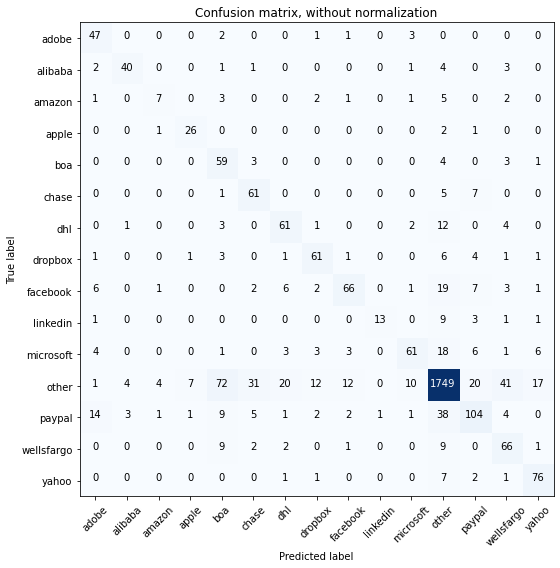

Acc     =  0.811
Pre     =  0.836
Rec     =  0.811
F1      =  0.817

Bal_Acc =  0.709
Bal_Pre =  0.685
Bal_Rec =  0.709
Bal_F1  =  0.697

              precision    recall  f1-score   support

       adobe       0.61      0.87      0.72        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.50      0.32      0.39        22
       apple       0.74      0.87      0.80        30
         boa       0.36      0.84      0.51        70
       chase       0.58      0.82      0.68        74
         dhl       0.64      0.73      0.68        84
     dropbox       0.72      0.76      0.74        80
    facebook       0.76      0.58      0.66       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.76      0.58      0.66       106
       other       0.93      0.87      0.90      2000
      paypal       0.68      0.56      0.61       186
  wellsfargo       0.51      0.73      0.60        90
       yahoo       0.73      0.86      0.79        

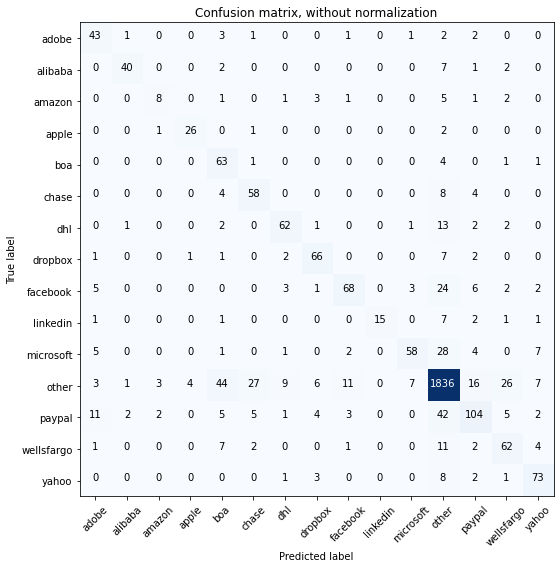

Acc     =  0.839
Pre     =  0.848
Rec     =  0.839
F1      =  0.839

Bal_Acc =  0.715
Bal_Pre =  0.742
Bal_Rec =  0.715
Bal_F1  =  0.728

              precision    recall  f1-score   support

       adobe       0.61      0.80      0.69        54
     alibaba       0.89      0.77      0.82        52
      amazon       0.57      0.36      0.44        22
       apple       0.84      0.87      0.85        30
         boa       0.47      0.90      0.62        70
       chase       0.61      0.78      0.69        74
         dhl       0.78      0.74      0.76        84
     dropbox       0.79      0.82      0.80        80
    facebook       0.78      0.60      0.68       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.83      0.55      0.66       106
       other       0.92      0.92      0.92      2000
      paypal       0.70      0.56      0.62       186
  wellsfargo       0.60      0.69      0.64        90
       yahoo       0.75      0.83      0.79        

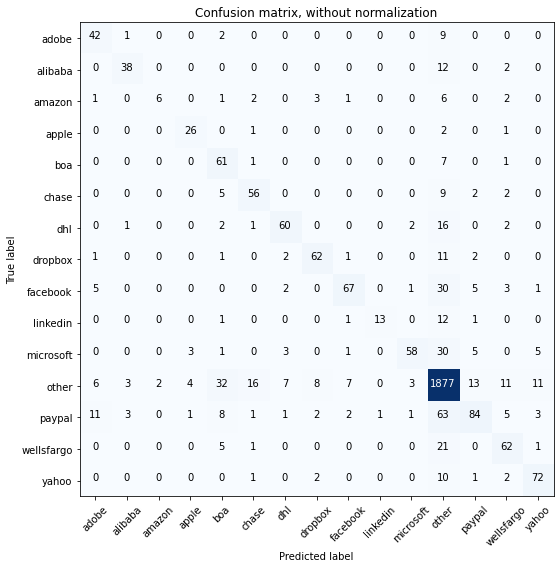

Acc     =  0.84
Pre     =  0.843
Rec     =  0.84
F1      =  0.833

Bal_Acc =  0.684
Bal_Pre =  0.768
Bal_Rec =  0.684
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        54
     alibaba       0.83      0.73      0.78        52
      amazon       0.75      0.27      0.40        22
       apple       0.76      0.87      0.81        30
         boa       0.51      0.87      0.65        70
       chase       0.70      0.76      0.73        74
         dhl       0.80      0.71      0.75        84
     dropbox       0.81      0.78      0.79        80
    facebook       0.84      0.59      0.69       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.89      0.55      0.68       106
       other       0.89      0.94      0.91      2000
      paypal       0.74      0.45      0.56       186
  wellsfargo       0.67      0.69      0.68        90
       yahoo       0.77      0.82      0.80        88

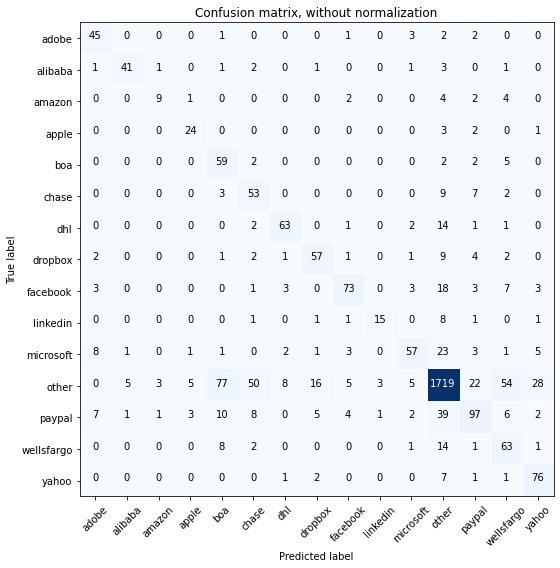

Acc     =  0.796
Pre     =  0.826
Rec     =  0.796
F1      =  0.804

Bal_Acc =  0.701
Bal_Pre =  0.679
Bal_Rec =  0.701
Bal_F1  =  0.69

              precision    recall  f1-score   support

       adobe       0.68      0.83      0.75        54
     alibaba       0.85      0.79      0.82        52
      amazon       0.64      0.41      0.50        22
       apple       0.71      0.80      0.75        30
         boa       0.37      0.84      0.51        70
       chase       0.43      0.72      0.54        74
         dhl       0.81      0.75      0.78        84
     dropbox       0.69      0.71      0.70        80
    facebook       0.80      0.64      0.71       114
    linkedin       0.79      0.54      0.64        28
   microsoft       0.76      0.54      0.63       106
       other       0.92      0.86      0.89      2000
      paypal       0.66      0.52      0.58       186
  wellsfargo       0.43      0.70      0.53        90
       yahoo       0.65      0.86      0.74        8

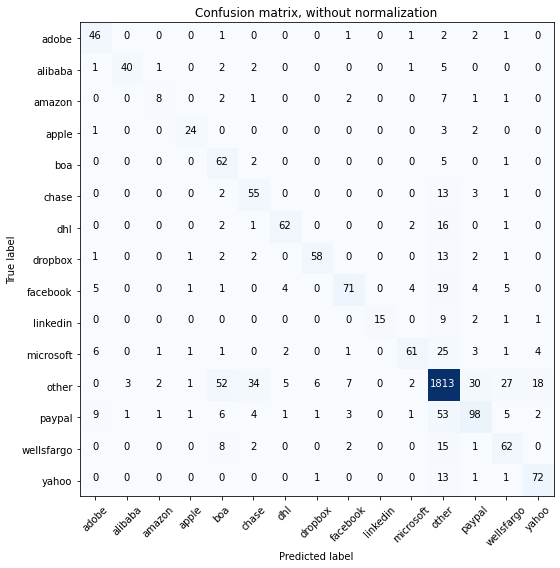

Acc     =  0.827
Pre     =  0.84
Rec     =  0.827
F1      =  0.828

Bal_Acc =  0.703
Bal_Pre =  0.75
Bal_Rec =  0.703
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.67      0.85      0.75        54
     alibaba       0.91      0.77      0.83        52
      amazon       0.62      0.36      0.46        22
       apple       0.83      0.80      0.81        30
         boa       0.44      0.89      0.59        70
       chase       0.53      0.74      0.62        74
         dhl       0.84      0.74      0.78        84
     dropbox       0.88      0.72      0.79        80
    facebook       0.82      0.62      0.71       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.85      0.58      0.69       106
       other       0.90      0.91      0.90      2000
      paypal       0.66      0.53      0.59       186
  wellsfargo       0.57      0.69      0.63        90
       yahoo       0.74      0.82      0.78        88

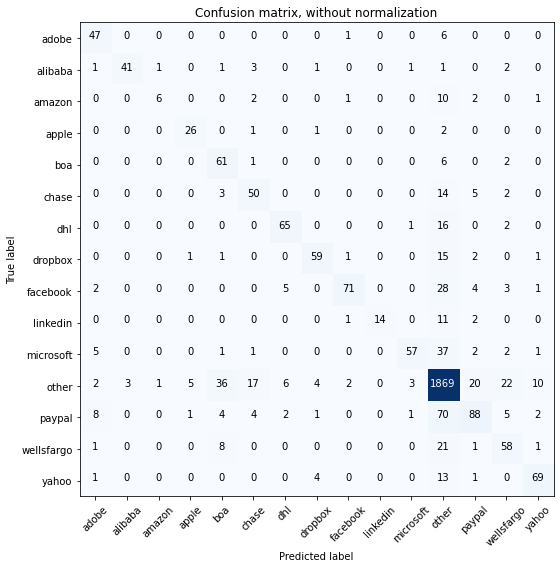

Acc     =  0.839
Pre     =  0.843
Rec     =  0.839
F1      =  0.833

Bal_Acc =  0.69
Bal_Pre =  0.787
Bal_Rec =  0.69
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.70      0.87      0.78        54
     alibaba       0.93      0.79      0.85        52
      amazon       0.75      0.27      0.40        22
       apple       0.79      0.87      0.83        30
         boa       0.53      0.87      0.66        70
       chase       0.63      0.68      0.65        74
         dhl       0.83      0.77      0.80        84
     dropbox       0.84      0.74      0.79        80
    facebook       0.92      0.62      0.74       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.90      0.54      0.67       106
       other       0.88      0.93      0.91      2000
      paypal       0.69      0.47      0.56       186
  wellsfargo       0.59      0.64      0.62        90
       yahoo       0.80      0.78      0.79        88

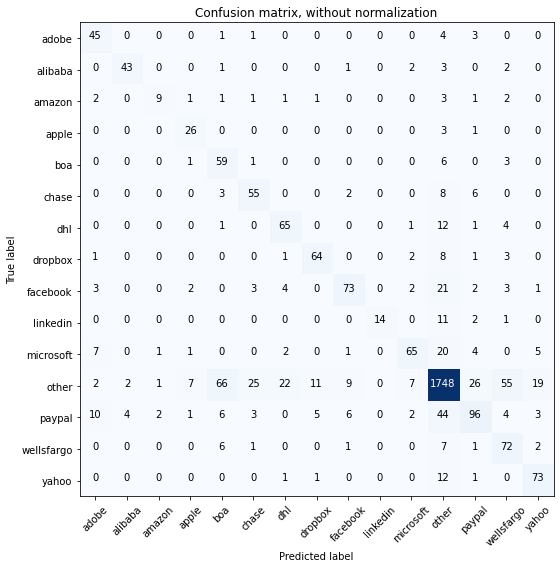

Acc     =  0.814
Pre     =  0.835
Rec     =  0.814
F1      =  0.819

Bal_Acc =  0.725
Bal_Pre =  0.714
Bal_Rec =  0.725
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.64      0.83      0.73        54
     alibaba       0.88      0.83      0.85        52
      amazon       0.69      0.41      0.51        22
       apple       0.67      0.87      0.75        30
         boa       0.41      0.84      0.55        70
       chase       0.61      0.74      0.67        74
         dhl       0.68      0.77      0.72        84
     dropbox       0.78      0.80      0.79        80
    facebook       0.78      0.64      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.80      0.61      0.70       106
       other       0.92      0.87      0.89      2000
      paypal       0.66      0.52      0.58       186
  wellsfargo       0.48      0.80      0.60        90
       yahoo       0.71      0.83      0.76        

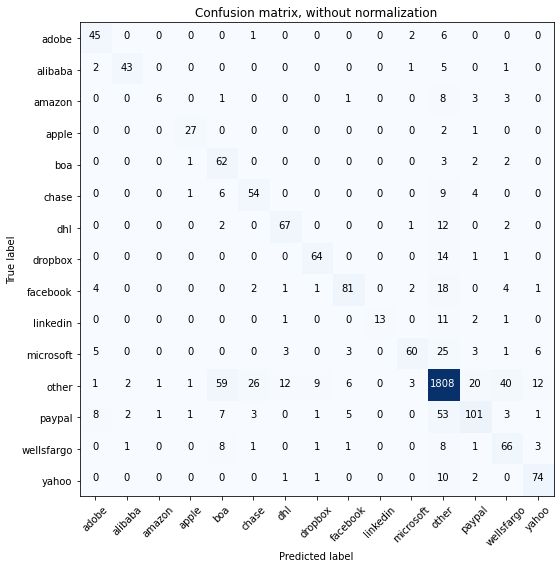

Acc     =  0.835
Pre     =  0.85
Rec     =  0.835
F1      =  0.836

Bal_Acc =  0.721
Bal_Pre =  0.767
Bal_Rec =  0.721
Bal_F1  =  0.743

              precision    recall  f1-score   support

       adobe       0.69      0.83      0.76        54
     alibaba       0.90      0.83      0.86        52
      amazon       0.75      0.27      0.40        22
       apple       0.87      0.90      0.89        30
         boa       0.43      0.89      0.58        70
       chase       0.62      0.73      0.67        74
         dhl       0.79      0.80      0.79        84
     dropbox       0.83      0.80      0.82        80
    facebook       0.84      0.71      0.77       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.87      0.57      0.69       106
       other       0.91      0.90      0.91      2000
      paypal       0.72      0.54      0.62       186
  wellsfargo       0.53      0.73      0.62        90
       yahoo       0.76      0.84      0.80        8

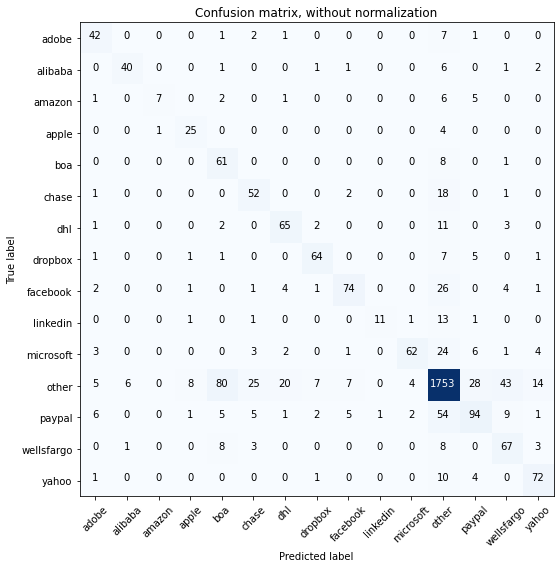

Acc     =  0.809
Pre     =  0.829
Rec     =  0.809
F1      =  0.812

Bal_Acc =  0.695
Bal_Pre =  0.731
Bal_Rec =  0.695
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.67      0.78      0.72        54
     alibaba       0.85      0.77      0.81        52
      amazon       0.88      0.32      0.47        22
       apple       0.68      0.83      0.75        30
         boa       0.38      0.87      0.53        70
       chase       0.57      0.70      0.63        74
         dhl       0.69      0.77      0.73        84
     dropbox       0.82      0.80      0.81        80
    facebook       0.82      0.65      0.73       114
    linkedin       0.92      0.39      0.55        28
   microsoft       0.90      0.58      0.71       106
       other       0.90      0.88      0.89      2000
      paypal       0.65      0.51      0.57       186
  wellsfargo       0.52      0.74      0.61        90
       yahoo       0.73      0.82      0.77        

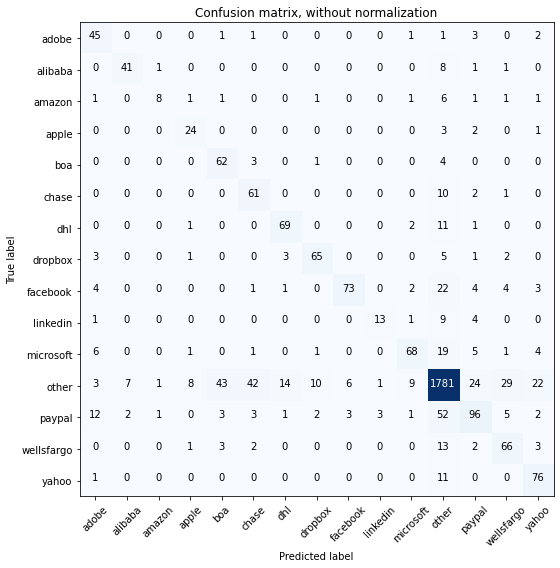

Acc     =  0.828
Pre     =  0.839
Rec     =  0.828
F1      =  0.829

Bal_Acc =  0.725
Bal_Pre =  0.717
Bal_Rec =  0.725
Bal_F1  =  0.721

              precision    recall  f1-score   support

       adobe       0.59      0.83      0.69        54
     alibaba       0.82      0.79      0.80        52
      amazon       0.73      0.36      0.48        22
       apple       0.65      0.80      0.72        30
         boa       0.55      0.89      0.68        70
       chase       0.54      0.82      0.65        74
         dhl       0.78      0.82      0.80        84
     dropbox       0.81      0.81      0.81        80
    facebook       0.89      0.64      0.74       114
    linkedin       0.76      0.46      0.58        28
   microsoft       0.80      0.64      0.71       106
       other       0.91      0.89      0.90      2000
      paypal       0.66      0.52      0.58       186
  wellsfargo       0.60      0.73      0.66        90
       yahoo       0.67      0.86      0.75        

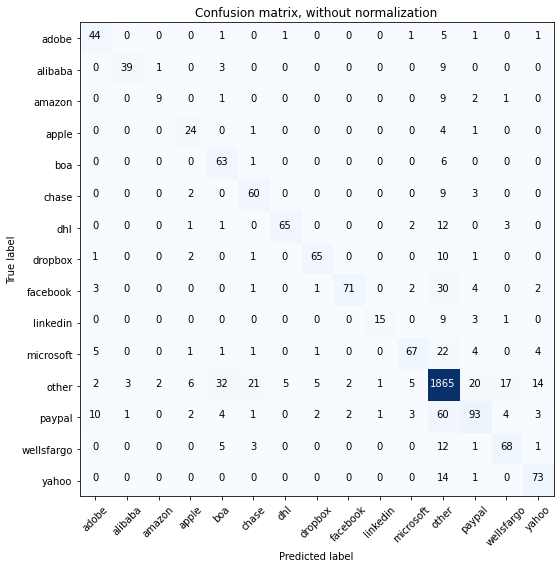

Acc     =  0.852
Pre     =  0.856
Rec     =  0.852
F1      =  0.848

Bal_Acc =  0.725
Bal_Pre =  0.781
Bal_Rec =  0.725
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.68      0.81      0.74        54
     alibaba       0.91      0.75      0.82        52
      amazon       0.75      0.41      0.53        22
       apple       0.63      0.80      0.71        30
         boa       0.57      0.90      0.70        70
       chase       0.67      0.81      0.73        74
         dhl       0.92      0.77      0.84        84
     dropbox       0.88      0.81      0.84        80
    facebook       0.95      0.62      0.75       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.84      0.63      0.72       106
       other       0.90      0.93      0.92      2000
      paypal       0.69      0.50      0.58       186
  wellsfargo       0.72      0.76      0.74        90
       yahoo       0.74      0.83      0.78        

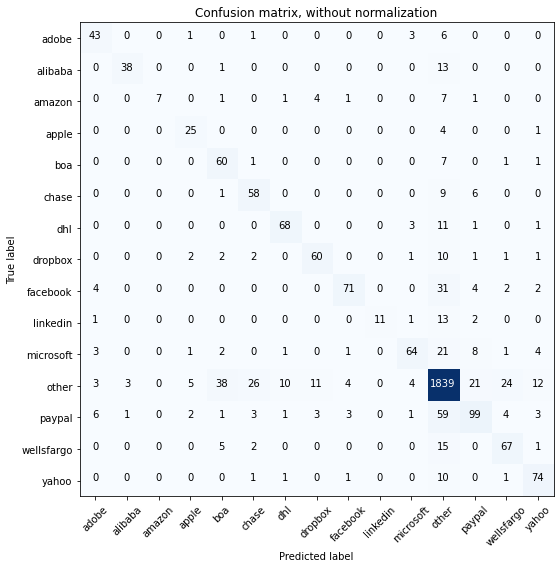

Acc     =  0.84
Pre     =  0.846
Rec     =  0.84
F1      =  0.836

Bal_Acc =  0.702
Bal_Pre =  0.785
Bal_Rec =  0.702
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.72      0.80      0.75        54
     alibaba       0.90      0.73      0.81        52
      amazon       1.00      0.32      0.48        22
       apple       0.69      0.83      0.76        30
         boa       0.54      0.86      0.66        70
       chase       0.62      0.78      0.69        74
         dhl       0.83      0.81      0.82        84
     dropbox       0.77      0.75      0.76        80
    facebook       0.88      0.62      0.73       114
    linkedin       1.00      0.39      0.56        28
   microsoft       0.83      0.60      0.70       106
       other       0.89      0.92      0.91      2000
      paypal       0.69      0.53      0.60       186
  wellsfargo       0.66      0.74      0.70        90
       yahoo       0.74      0.84      0.79        88

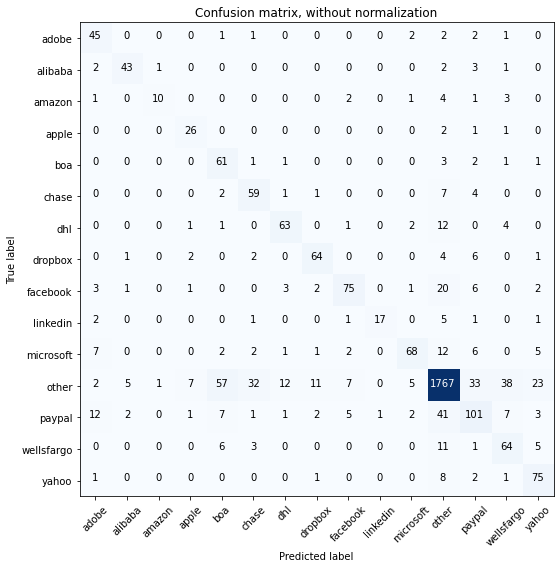

Acc     =  0.825
Pre     =  0.844
Rec     =  0.825
F1      =  0.829

Bal_Acc =  0.74
Bal_Pre =  0.721
Bal_Rec =  0.74
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.60      0.83      0.70        54
     alibaba       0.83      0.83      0.83        52
      amazon       0.83      0.45      0.59        22
       apple       0.68      0.87      0.76        30
         boa       0.45      0.87      0.59        70
       chase       0.58      0.80      0.67        74
         dhl       0.77      0.75      0.76        84
     dropbox       0.78      0.80      0.79        80
    facebook       0.81      0.66      0.72       114
    linkedin       0.94      0.61      0.74        28
   microsoft       0.84      0.64      0.73       106
       other       0.93      0.88      0.91      2000
      paypal       0.60      0.54      0.57       186
  wellsfargo       0.53      0.71      0.61        90
       yahoo       0.65      0.85      0.74        88


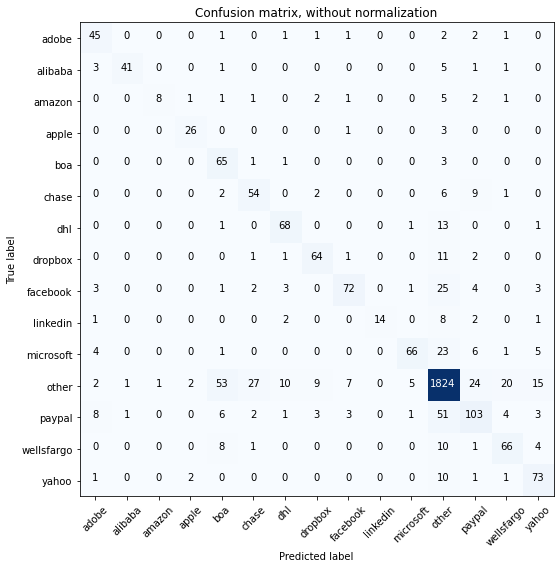

Acc     =  0.841
Pre     =  0.853
Rec     =  0.841
F1      =  0.841

Bal_Acc =  0.727
Bal_Pre =  0.778
Bal_Rec =  0.727
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.67      0.83      0.74        54
     alibaba       0.95      0.79      0.86        52
      amazon       0.89      0.36      0.52        22
       apple       0.84      0.87      0.85        30
         boa       0.46      0.93      0.62        70
       chase       0.61      0.73      0.66        74
         dhl       0.78      0.81      0.80        84
     dropbox       0.79      0.80      0.80        80
    facebook       0.84      0.63      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.62      0.73       106
       other       0.91      0.91      0.91      2000
      paypal       0.66      0.55      0.60       186
  wellsfargo       0.69      0.73      0.71        90
       yahoo       0.70      0.83      0.76        

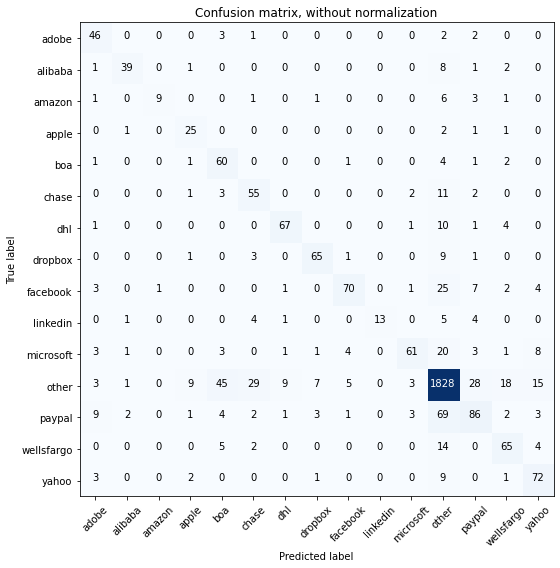

Acc     =  0.832
Pre     =  0.841
Rec     =  0.832
F1      =  0.83

Bal_Acc =  0.708
Bal_Pre =  0.754
Bal_Rec =  0.708
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.65      0.85      0.74        54
     alibaba       0.87      0.75      0.80        52
      amazon       0.90      0.41      0.56        22
       apple       0.61      0.83      0.70        30
         boa       0.49      0.86      0.62        70
       chase       0.57      0.74      0.64        74
         dhl       0.84      0.80      0.82        84
     dropbox       0.83      0.81      0.82        80
    facebook       0.85      0.61      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.86      0.58      0.69       106
       other       0.90      0.91      0.91      2000
      paypal       0.61      0.46      0.53       186
  wellsfargo       0.66      0.72      0.69        90
       yahoo       0.68      0.82      0.74        88

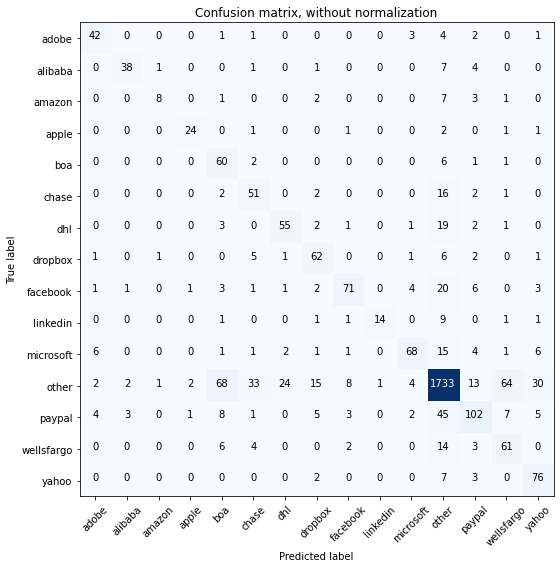

Acc     =  0.801
Pre     =  0.826
Rec     =  0.801
F1      =  0.807

Bal_Acc =  0.691
Bal_Pre =  0.708
Bal_Rec =  0.691
Bal_F1  =  0.699

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.73      0.36      0.48        22
       apple       0.86      0.80      0.83        30
         boa       0.39      0.86      0.54        70
       chase       0.50      0.69      0.58        74
         dhl       0.66      0.65      0.66        84
     dropbox       0.65      0.78      0.71        80
    facebook       0.81      0.62      0.70       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.82      0.64      0.72       106
       other       0.91      0.87      0.89      2000
      paypal       0.69      0.55      0.61       186
  wellsfargo       0.44      0.68      0.53        90
       yahoo       0.61      0.86      0.72        

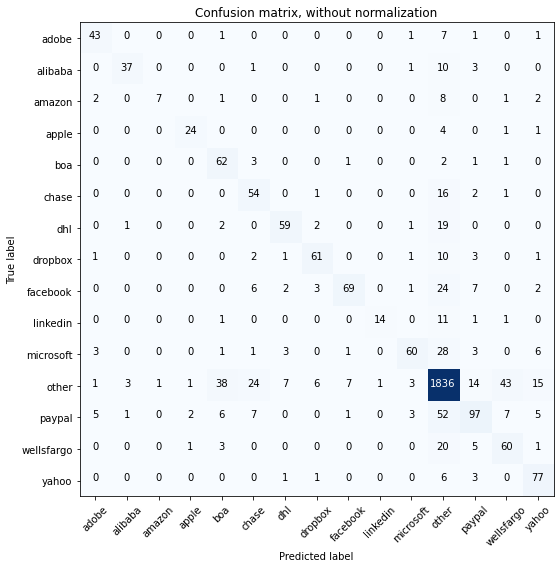

Acc     =  0.832
Pre     =  0.84
Rec     =  0.832
F1      =  0.829

Bal_Acc =  0.691
Bal_Pre =  0.771
Bal_Rec =  0.691
Bal_F1  =  0.729

              precision    recall  f1-score   support

       adobe       0.78      0.80      0.79        54
     alibaba       0.88      0.71      0.79        52
      amazon       0.88      0.32      0.47        22
       apple       0.86      0.80      0.83        30
         boa       0.54      0.89      0.67        70
       chase       0.55      0.73      0.63        74
         dhl       0.81      0.70      0.75        84
     dropbox       0.81      0.76      0.79        80
    facebook       0.87      0.61      0.72       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.85      0.57      0.68       106
       other       0.89      0.92      0.91      2000
      paypal       0.69      0.52      0.60       186
  wellsfargo       0.52      0.67      0.59        90
       yahoo       0.69      0.88      0.77        8

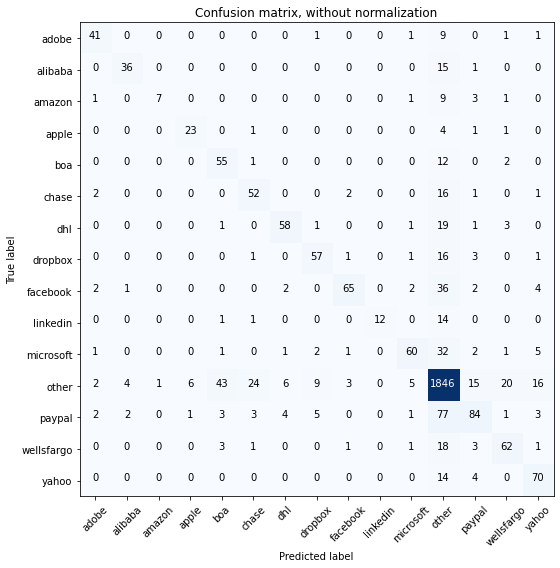

Acc     =  0.821
Pre     =  0.824
Rec     =  0.821
F1      =  0.815

Bal_Acc =  0.657
Bal_Pre =  0.775
Bal_Rec =  0.657
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.80      0.76      0.78        54
     alibaba       0.84      0.69      0.76        52
      amazon       0.88      0.32      0.47        22
       apple       0.77      0.77      0.77        30
         boa       0.51      0.79      0.62        70
       chase       0.62      0.70      0.66        74
         dhl       0.82      0.69      0.75        84
     dropbox       0.76      0.71      0.74        80
    facebook       0.89      0.57      0.70       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.82      0.57      0.67       106
       other       0.86      0.92      0.89      2000
      paypal       0.70      0.45      0.55       186
  wellsfargo       0.67      0.69      0.68        90
       yahoo       0.69      0.80      0.74        

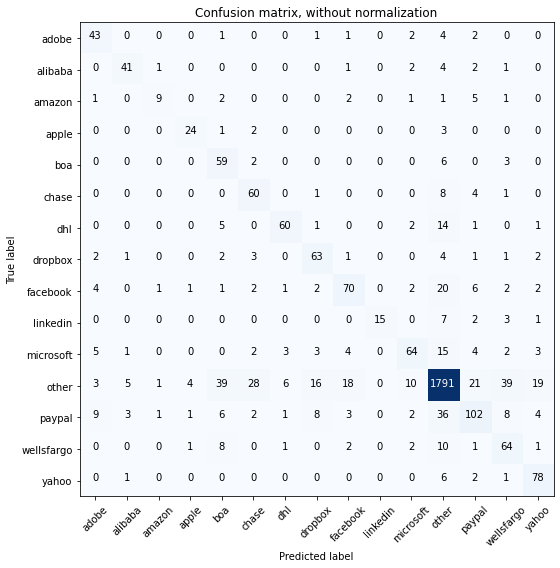

Acc     =  0.826
Pre     =  0.841
Rec     =  0.826
F1      =  0.829

Bal_Acc =  0.716
Bal_Pre =  0.713
Bal_Rec =  0.716
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.64      0.80      0.71        54
     alibaba       0.79      0.79      0.79        52
      amazon       0.69      0.41      0.51        22
       apple       0.77      0.80      0.79        30
         boa       0.48      0.84      0.61        70
       chase       0.59      0.81      0.69        74
         dhl       0.83      0.71      0.77        84
     dropbox       0.66      0.79      0.72        80
    facebook       0.69      0.61      0.65       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.74      0.60      0.66       106
       other       0.93      0.90      0.91      2000
      paypal       0.67      0.55      0.60       186
  wellsfargo       0.51      0.71      0.59        90
       yahoo       0.70      0.89      0.78        

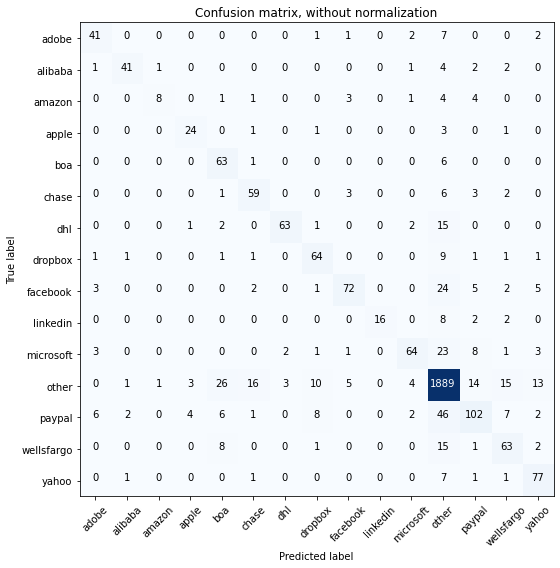

Acc     =  0.86
Pre     =  0.862
Rec     =  0.86
F1      =  0.856

Bal_Acc =  0.722
Bal_Pre =  0.789
Bal_Rec =  0.722
Bal_F1  =  0.754

              precision    recall  f1-score   support

       adobe       0.75      0.76      0.75        54
     alibaba       0.89      0.79      0.84        52
      amazon       0.80      0.36      0.50        22
       apple       0.75      0.80      0.77        30
         boa       0.58      0.90      0.71        70
       chase       0.71      0.80      0.75        74
         dhl       0.93      0.75      0.83        84
     dropbox       0.73      0.80      0.76        80
    facebook       0.85      0.63      0.72       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.84      0.60      0.70       106
       other       0.91      0.94      0.93      2000
      paypal       0.71      0.55      0.62       186
  wellsfargo       0.65      0.70      0.67        90
       yahoo       0.73      0.88      0.80        88

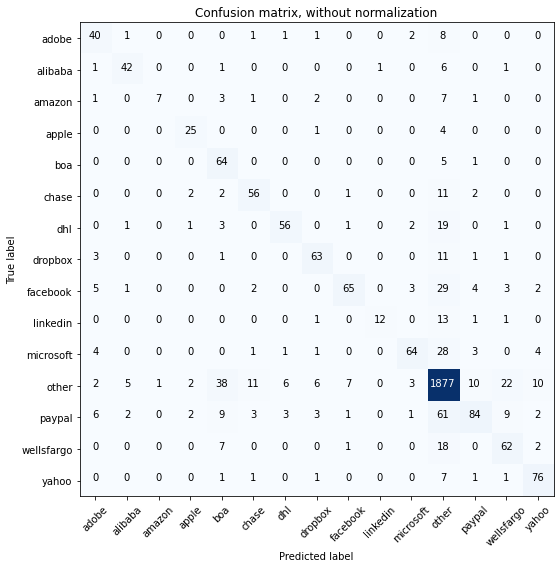

Acc     =  0.842
Pre     =  0.848
Rec     =  0.842
F1      =  0.837

Bal_Acc =  0.691
Bal_Pre =  0.779
Bal_Rec =  0.691
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.65      0.74      0.69        54
     alibaba       0.81      0.81      0.81        52
      amazon       0.88      0.32      0.47        22
       apple       0.78      0.83      0.81        30
         boa       0.50      0.91      0.64        70
       chase       0.74      0.76      0.75        74
         dhl       0.84      0.67      0.74        84
     dropbox       0.80      0.79      0.79        80
    facebook       0.86      0.57      0.68       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.85      0.60      0.71       106
       other       0.89      0.94      0.91      2000
      paypal       0.78      0.45      0.57       186
  wellsfargo       0.61      0.69      0.65        90
       yahoo       0.79      0.86      0.83        

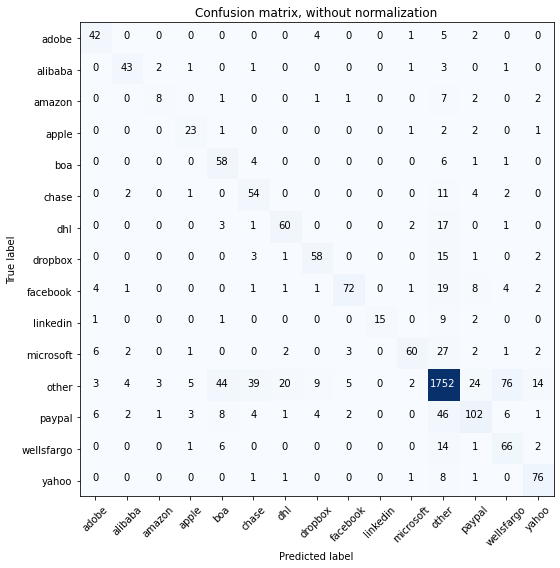

Acc     =  0.809
Pre     =  0.829
Rec     =  0.809
F1      =  0.813

Bal_Acc =  0.699
Bal_Pre =  0.707
Bal_Rec =  0.699
Bal_F1  =  0.703

              precision    recall  f1-score   support

       adobe       0.68      0.78      0.72        54
     alibaba       0.80      0.83      0.81        52
      amazon       0.57      0.36      0.44        22
       apple       0.66      0.77      0.71        30
         boa       0.48      0.83      0.60        70
       chase       0.50      0.73      0.59        74
         dhl       0.70      0.71      0.71        84
     dropbox       0.75      0.72      0.74        80
    facebook       0.87      0.63      0.73       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.87      0.57      0.69       106
       other       0.90      0.88      0.89      2000
      paypal       0.67      0.55      0.60       186
  wellsfargo       0.42      0.73      0.53        90
       yahoo       0.75      0.86      0.80        

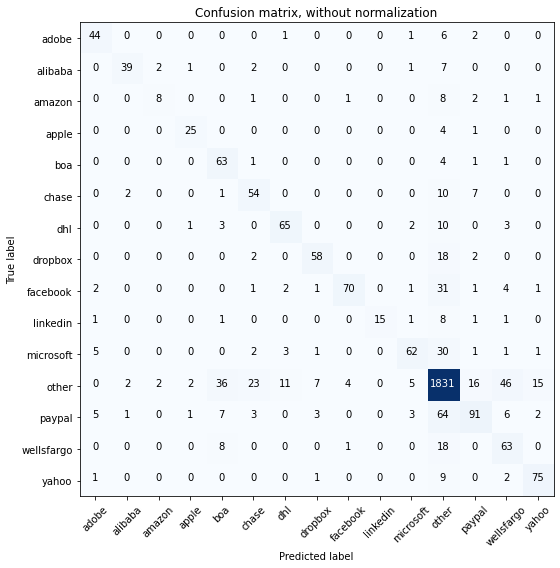

Acc     =  0.833
Pre     =  0.841
Rec     =  0.833
F1      =  0.831

Bal_Acc =  0.705
Bal_Pre =  0.768
Bal_Rec =  0.705
Bal_F1  =  0.735

              precision    recall  f1-score   support

       adobe       0.76      0.81      0.79        54
     alibaba       0.89      0.75      0.81        52
      amazon       0.67      0.36      0.47        22
       apple       0.83      0.83      0.83        30
         boa       0.53      0.90      0.67        70
       chase       0.61      0.73      0.66        74
         dhl       0.79      0.77      0.78        84
     dropbox       0.82      0.72      0.77        80
    facebook       0.92      0.61      0.74       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.82      0.58      0.68       106
       other       0.89      0.92      0.90      2000
      paypal       0.73      0.49      0.59       186
  wellsfargo       0.49      0.70      0.58        90
       yahoo       0.79      0.85      0.82        

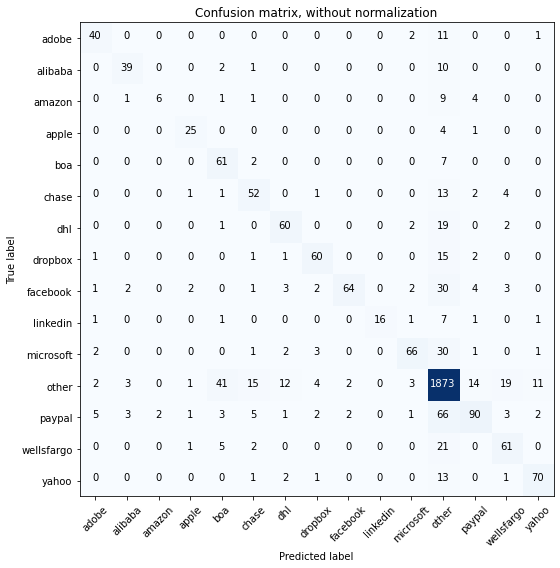

Acc     =  0.839
Pre     =  0.843
Rec     =  0.839
F1      =  0.834

Bal_Acc =  0.686
Bal_Pre =  0.784
Bal_Rec =  0.686
Bal_F1  =  0.732

              precision    recall  f1-score   support

       adobe       0.77      0.74      0.75        54
     alibaba       0.81      0.75      0.78        52
      amazon       0.75      0.27      0.40        22
       apple       0.81      0.83      0.82        30
         boa       0.53      0.87      0.66        70
       chase       0.63      0.70      0.67        74
         dhl       0.74      0.71      0.73        84
     dropbox       0.82      0.75      0.78        80
    facebook       0.94      0.56      0.70       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.86      0.62      0.72       106
       other       0.88      0.94      0.91      2000
      paypal       0.76      0.48      0.59       186
  wellsfargo       0.66      0.68      0.67        90
       yahoo       0.81      0.80      0.80        

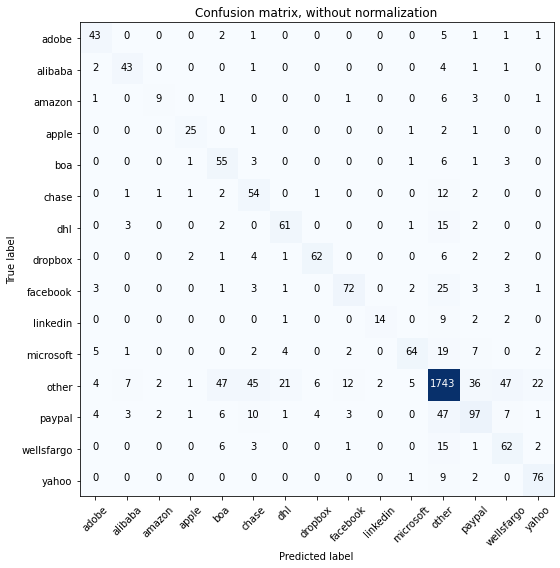

Acc     =  0.806
Pre     =  0.825
Rec     =  0.806
F1      =  0.81

Bal_Acc =  0.704
Bal_Pre =  0.701
Bal_Rec =  0.704
Bal_F1  =  0.702

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.74      0.83      0.78        52
      amazon       0.64      0.41      0.50        22
       apple       0.81      0.83      0.82        30
         boa       0.45      0.79      0.57        70
       chase       0.43      0.73      0.54        74
         dhl       0.68      0.73      0.70        84
     dropbox       0.85      0.78      0.81        80
    facebook       0.79      0.63      0.70       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.85      0.60      0.71       106
       other       0.91      0.87      0.89      2000
      paypal       0.60      0.52      0.56       186
  wellsfargo       0.48      0.69      0.57        90
       yahoo       0.72      0.86      0.78        8

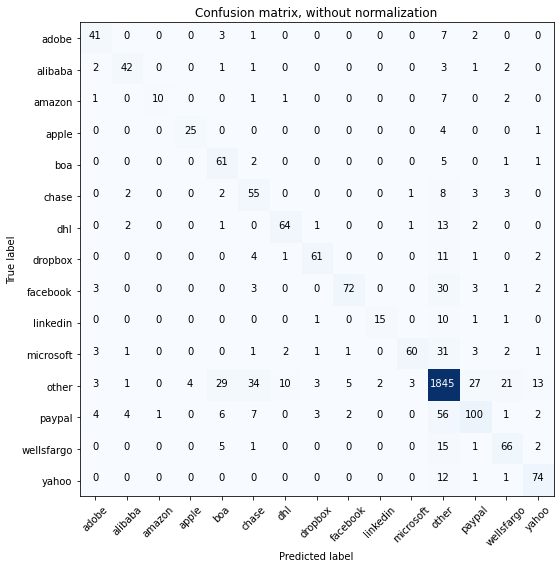

Acc     =  0.842
Pre     =  0.849
Rec     =  0.842
F1      =  0.84

Bal_Acc =  0.717
Bal_Pre =  0.784
Bal_Rec =  0.717
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.72      0.76      0.74        54
     alibaba       0.81      0.81      0.81        52
      amazon       0.91      0.45      0.61        22
       apple       0.86      0.83      0.85        30
         boa       0.56      0.87      0.69        70
       chase       0.50      0.74      0.60        74
         dhl       0.82      0.76      0.79        84
     dropbox       0.87      0.76      0.81        80
    facebook       0.90      0.63      0.74       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.92      0.57      0.70       106
       other       0.90      0.92      0.91      2000
      paypal       0.69      0.54      0.60       186
  wellsfargo       0.65      0.73      0.69        90
       yahoo       0.76      0.84      0.80        8

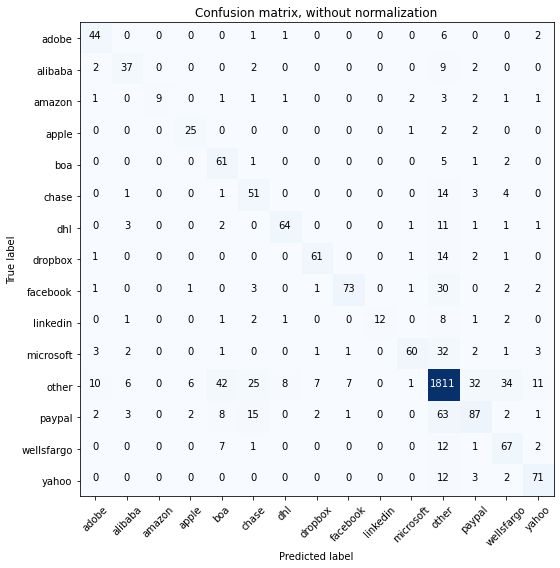

Acc     =  0.823
Pre     =  0.835
Rec     =  0.823
F1      =  0.822

Bal_Acc =  0.694
Bal_Pre =  0.762
Bal_Rec =  0.694
Bal_F1  =  0.726

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.70      0.71      0.70        52
      amazon       1.00      0.41      0.58        22
       apple       0.74      0.83      0.78        30
         boa       0.49      0.87      0.63        70
       chase       0.50      0.69      0.58        74
         dhl       0.85      0.76      0.81        84
     dropbox       0.85      0.76      0.80        80
    facebook       0.89      0.64      0.74       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.90      0.57      0.69       106
       other       0.89      0.91      0.90      2000
      paypal       0.63      0.47      0.54       186
  wellsfargo       0.56      0.74      0.64        90
       yahoo       0.76      0.81      0.78        

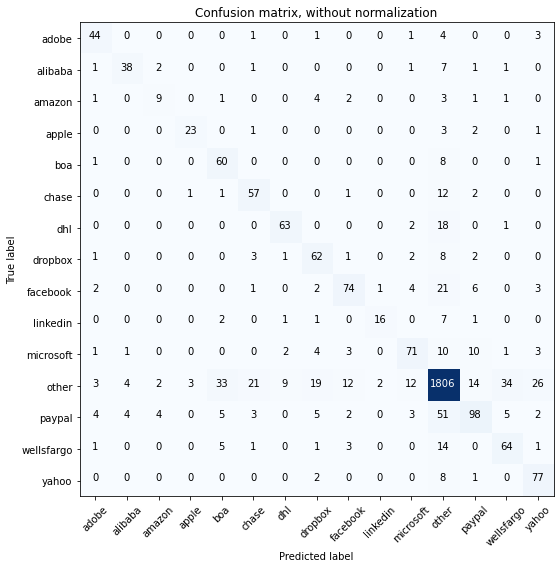

Acc     =  0.832
Pre     =  0.839
Rec     =  0.832
F1      =  0.832

Bal_Acc =  0.719
Bal_Pre =  0.72
Bal_Rec =  0.719
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.75      0.81      0.78        54
     alibaba       0.81      0.73      0.77        52
      amazon       0.53      0.41      0.46        22
       apple       0.85      0.77      0.81        30
         boa       0.56      0.86      0.68        70
       chase       0.64      0.77      0.70        74
         dhl       0.83      0.75      0.79        84
     dropbox       0.61      0.78      0.69        80
    facebook       0.76      0.65      0.70       114
    linkedin       0.84      0.57      0.68        28
   microsoft       0.74      0.67      0.70       106
       other       0.91      0.90      0.91      2000
      paypal       0.71      0.53      0.60       186
  wellsfargo       0.60      0.71      0.65        90
       yahoo       0.66      0.88      0.75        8

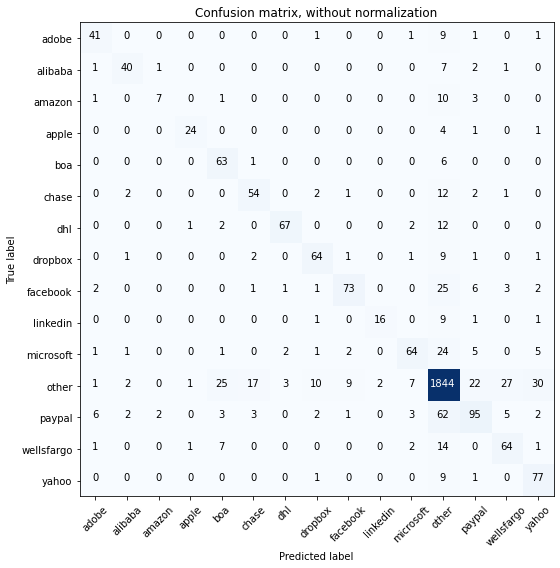

Acc     =  0.842
Pre     =  0.844
Rec     =  0.842
F1      =  0.839

Bal_Acc =  0.714
Bal_Pre =  0.77
Bal_Rec =  0.714
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.76      0.76      0.76        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.70      0.32      0.44        22
       apple       0.89      0.80      0.84        30
         boa       0.62      0.90      0.73        70
       chase       0.69      0.73      0.71        74
         dhl       0.92      0.80      0.85        84
     dropbox       0.77      0.80      0.79        80
    facebook       0.84      0.64      0.73       114
    linkedin       0.89      0.57      0.70        28
   microsoft       0.80      0.60      0.69       106
       other       0.90      0.92      0.91      2000
      paypal       0.68      0.51      0.58       186
  wellsfargo       0.63      0.71      0.67        90
       yahoo       0.64      0.88      0.74        8

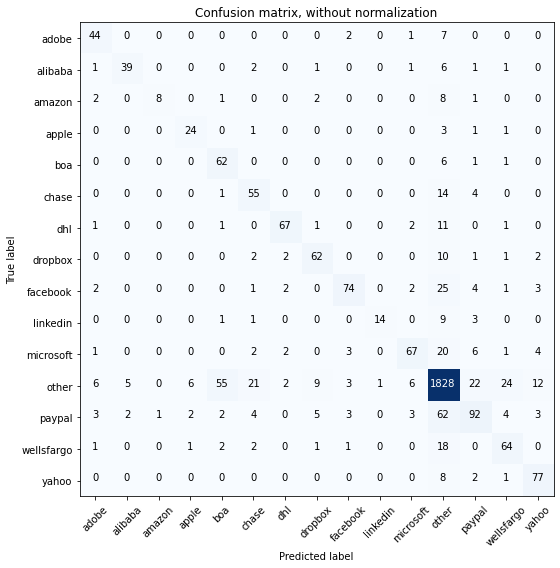

Acc     =  0.837
Pre     =  0.843
Rec     =  0.837
F1      =  0.835

Bal_Acc =  0.714
Bal_Pre =  0.768
Bal_Rec =  0.714
Bal_F1  =  0.74

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.85      0.75      0.80        52
      amazon       0.89      0.36      0.52        22
       apple       0.73      0.80      0.76        30
         boa       0.50      0.89      0.64        70
       chase       0.60      0.74      0.67        74
         dhl       0.89      0.80      0.84        84
     dropbox       0.77      0.78      0.77        80
    facebook       0.86      0.65      0.74       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.82      0.63      0.71       106
       other       0.90      0.91      0.91      2000
      paypal       0.67      0.49      0.57       186
  wellsfargo       0.64      0.71      0.67        90
       yahoo       0.76      0.88      0.81        8

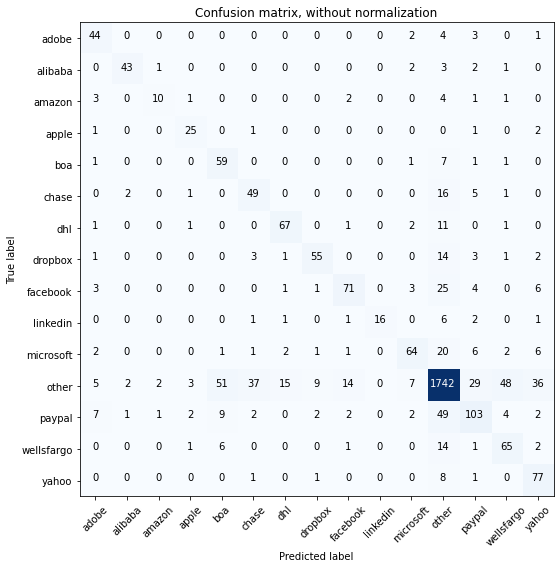

Acc     =  0.809
Pre     =  0.826
Rec     =  0.809
F1      =  0.813

Bal_Acc =  0.716
Bal_Pre =  0.714
Bal_Rec =  0.716
Bal_F1  =  0.715

              precision    recall  f1-score   support

       adobe       0.65      0.81      0.72        54
     alibaba       0.90      0.83      0.86        52
      amazon       0.71      0.45      0.56        22
       apple       0.74      0.83      0.78        30
         boa       0.47      0.84      0.60        70
       chase       0.52      0.66      0.58        74
         dhl       0.77      0.80      0.78        84
     dropbox       0.80      0.69      0.74        80
    facebook       0.76      0.62      0.69       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.77      0.60      0.68       106
       other       0.91      0.87      0.89      2000
      paypal       0.64      0.55      0.59       186
  wellsfargo       0.52      0.72      0.60        90
       yahoo       0.57      0.88      0.69        

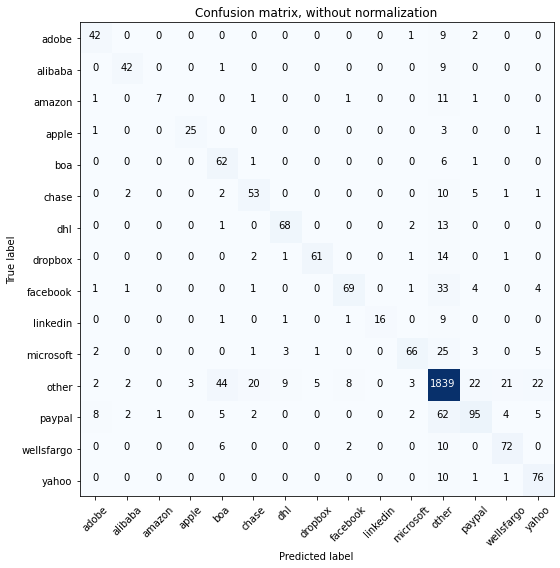

Acc     =  0.842
Pre     =  0.849
Rec     =  0.842
F1      =  0.84

Bal_Acc =  0.72
Bal_Pre =  0.798
Bal_Rec =  0.72
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.74      0.78      0.76        54
     alibaba       0.86      0.81      0.83        52
      amazon       0.88      0.32      0.47        22
       apple       0.89      0.83      0.86        30
         boa       0.51      0.89      0.65        70
       chase       0.65      0.72      0.68        74
         dhl       0.83      0.81      0.82        84
     dropbox       0.91      0.76      0.83        80
    facebook       0.85      0.61      0.71       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.87      0.62      0.73       106
       other       0.89      0.92      0.91      2000
      paypal       0.71      0.51      0.59       186
  wellsfargo       0.72      0.80      0.76        90
       yahoo       0.67      0.86      0.75        88


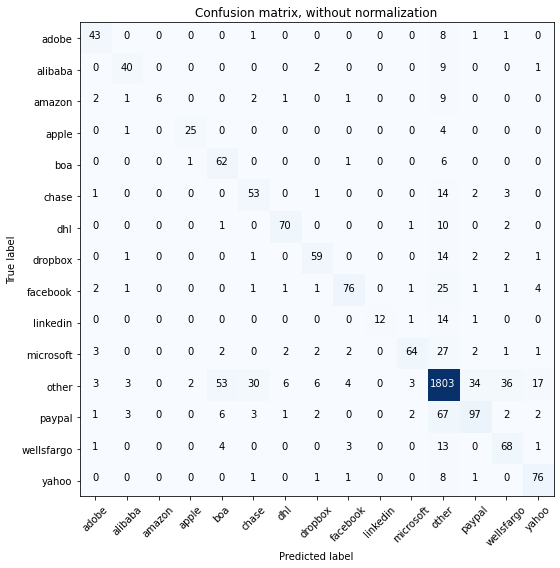

Acc     =  0.83
Pre     =  0.84
Rec     =  0.83
F1      =  0.828

Bal_Acc =  0.706
Bal_Pre =  0.789
Bal_Rec =  0.706
Bal_F1  =  0.745

              precision    recall  f1-score   support

       adobe       0.77      0.80      0.78        54
     alibaba       0.80      0.77      0.78        52
      amazon       1.00      0.27      0.43        22
       apple       0.89      0.83      0.86        30
         boa       0.48      0.89      0.63        70
       chase       0.58      0.72      0.64        74
         dhl       0.86      0.83      0.85        84
     dropbox       0.80      0.74      0.77        80
    facebook       0.86      0.67      0.75       114
    linkedin       1.00      0.43      0.60        28
   microsoft       0.89      0.60      0.72       106
       other       0.89      0.90      0.89      2000
      paypal       0.69      0.52      0.59       186
  wellsfargo       0.59      0.76      0.66        90
       yahoo       0.74      0.86      0.80        88


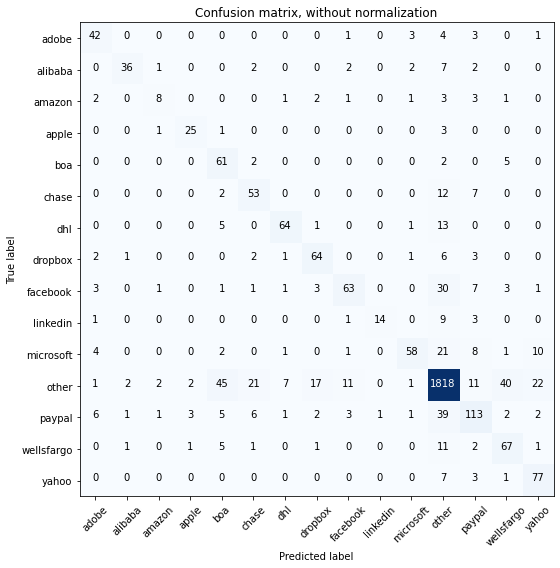

Acc     =  0.833
Pre     =  0.844
Rec     =  0.833
F1      =  0.833

Bal_Acc =  0.703
Bal_Pre =  0.731
Bal_Rec =  0.703
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.88      0.69      0.77        52
      amazon       0.57      0.36      0.44        22
       apple       0.81      0.83      0.82        30
         boa       0.48      0.87      0.62        70
       chase       0.60      0.72      0.65        74
         dhl       0.84      0.76      0.80        84
     dropbox       0.71      0.80      0.75        80
    facebook       0.76      0.55      0.64       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.85      0.55      0.67       106
       other       0.92      0.91      0.91      2000
      paypal       0.68      0.61      0.64       186
  wellsfargo       0.56      0.74      0.64        90
       yahoo       0.68      0.88      0.76        

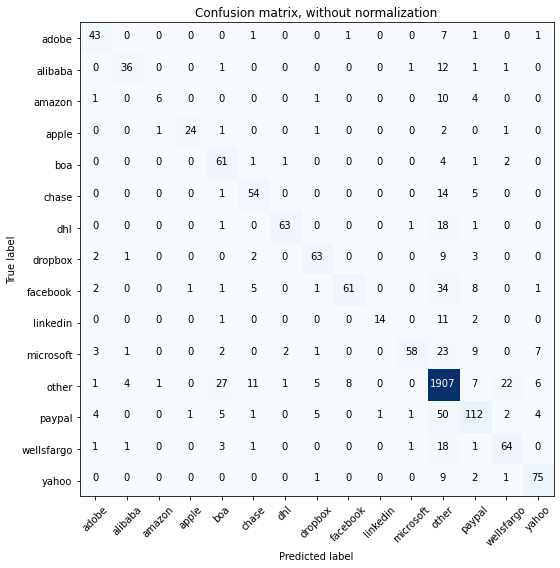

Acc     =  0.858
Pre     =  0.86
Rec     =  0.858
F1      =  0.852

Bal_Acc =  0.693
Bal_Pre =  0.81
Bal_Rec =  0.693
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.75      0.80      0.77        54
     alibaba       0.84      0.69      0.76        52
      amazon       0.75      0.27      0.40        22
       apple       0.92      0.80      0.86        30
         boa       0.59      0.87      0.70        70
       chase       0.71      0.73      0.72        74
         dhl       0.94      0.75      0.83        84
     dropbox       0.81      0.79      0.80        80
    facebook       0.87      0.54      0.66       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.94      0.55      0.69       106
       other       0.90      0.95      0.92      2000
      paypal       0.71      0.60      0.65       186
  wellsfargo       0.69      0.71      0.70        90
       yahoo       0.80      0.85      0.82        88

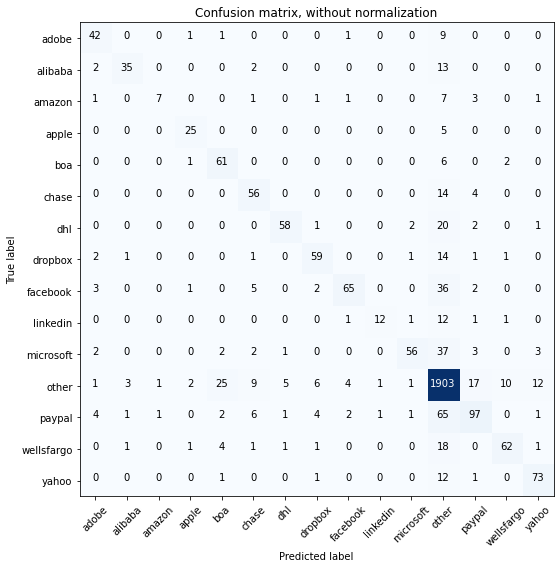

Acc     =  0.848
Pre     =  0.848
Rec     =  0.848
F1      =  0.841

Bal_Acc =  0.678
Bal_Pre =  0.801
Bal_Rec =  0.678
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.74      0.78      0.76        54
     alibaba       0.85      0.67      0.75        52
      amazon       0.78      0.32      0.45        22
       apple       0.81      0.83      0.82        30
         boa       0.64      0.87      0.73        70
       chase       0.67      0.76      0.71        74
         dhl       0.88      0.69      0.77        84
     dropbox       0.79      0.74      0.76        80
    facebook       0.88      0.57      0.69       114
    linkedin       0.86      0.43      0.57        28
   microsoft       0.90      0.53      0.67       106
       other       0.88      0.95      0.91      2000
      paypal       0.74      0.52      0.61       186
  wellsfargo       0.82      0.69      0.75        90
       yahoo       0.79      0.83      0.81        

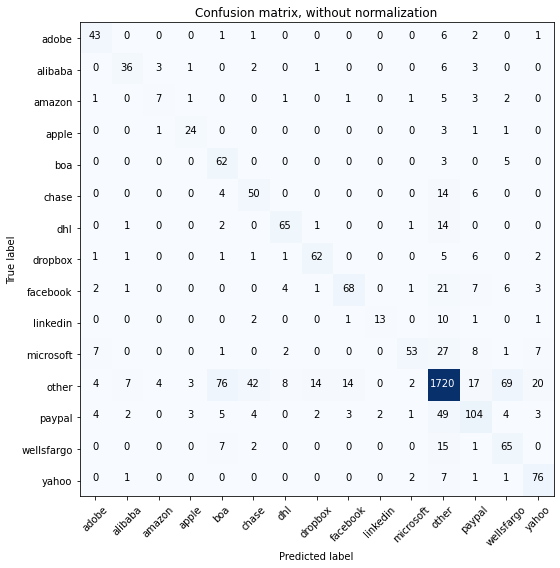

Acc     =  0.795
Pre     =  0.822
Rec     =  0.795
F1      =  0.801

Bal_Acc =  0.686
Bal_Pre =  0.683
Bal_Rec =  0.686
Bal_F1  =  0.684

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.73      0.69      0.71        52
      amazon       0.47      0.32      0.38        22
       apple       0.75      0.80      0.77        30
         boa       0.39      0.89      0.54        70
       chase       0.48      0.68      0.56        74
         dhl       0.80      0.77      0.79        84
     dropbox       0.77      0.78      0.77        80
    facebook       0.78      0.60      0.68       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.87      0.50      0.63       106
       other       0.90      0.86      0.88      2000
      paypal       0.65      0.56      0.60       186
  wellsfargo       0.42      0.72      0.53        90
       yahoo       0.67      0.86      0.76        

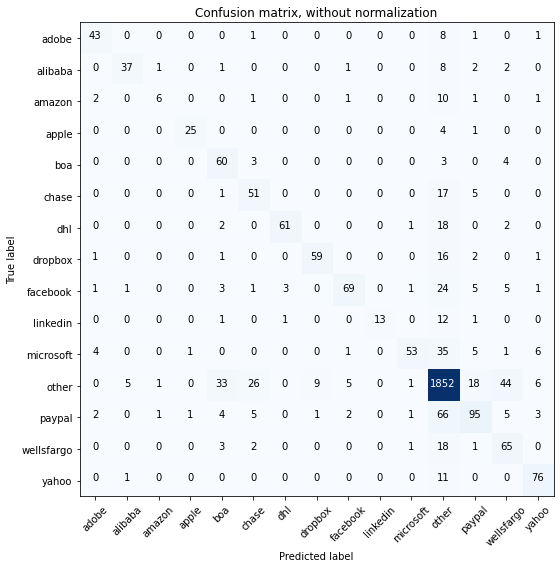

Acc     =  0.833
Pre     =  0.841
Rec     =  0.833
F1      =  0.83

Bal_Acc =  0.681
Bal_Pre =  0.788
Bal_Rec =  0.681
Bal_F1  =  0.731

              precision    recall  f1-score   support

       adobe       0.81      0.80      0.80        54
     alibaba       0.84      0.71      0.77        52
      amazon       0.67      0.27      0.39        22
       apple       0.93      0.83      0.88        30
         boa       0.55      0.86      0.67        70
       chase       0.57      0.69      0.62        74
         dhl       0.94      0.73      0.82        84
     dropbox       0.86      0.74      0.79        80
    facebook       0.87      0.61      0.72       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.91      0.50      0.65       106
       other       0.88      0.93      0.90      2000
      paypal       0.69      0.51      0.59       186
  wellsfargo       0.51      0.72      0.60        90
       yahoo       0.80      0.86      0.83        8

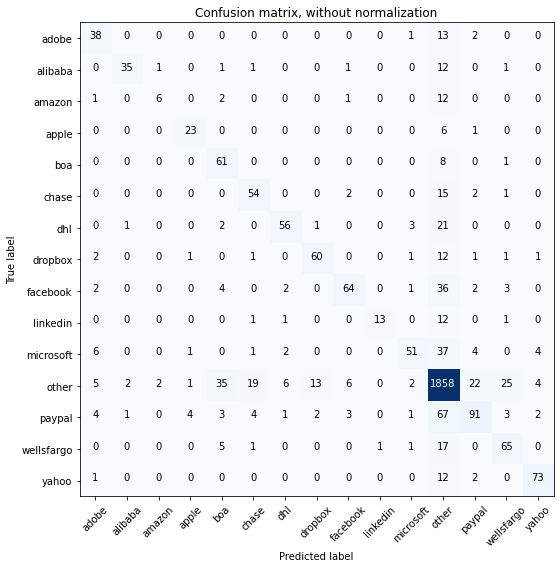

Acc     =  0.828
Pre     =  0.829
Rec     =  0.828
F1      =  0.821

Bal_Acc =  0.661
Bal_Pre =  0.765
Bal_Rec =  0.661
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.64      0.70      0.67        54
     alibaba       0.90      0.67      0.77        52
      amazon       0.67      0.27      0.39        22
       apple       0.77      0.77      0.77        30
         boa       0.54      0.87      0.67        70
       chase       0.66      0.73      0.69        74
         dhl       0.82      0.67      0.74        84
     dropbox       0.79      0.75      0.77        80
    facebook       0.83      0.56      0.67       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.84      0.48      0.61       106
       other       0.87      0.93      0.90      2000
      paypal       0.72      0.49      0.58       186
  wellsfargo       0.64      0.72      0.68        90
       yahoo       0.87      0.83      0.85        

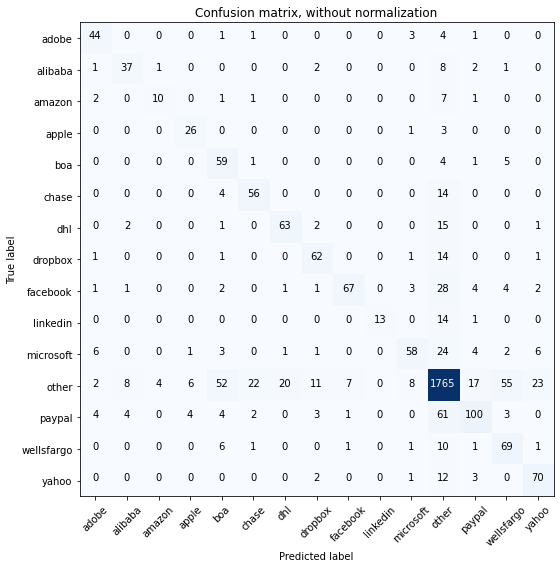

Acc     =  0.812
Pre     =  0.827
Rec     =  0.812
F1      =  0.813

Bal_Acc =  0.704
Bal_Pre =  0.722
Bal_Rec =  0.704
Bal_F1  =  0.713

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.71      0.71      0.71        52
      amazon       0.67      0.45      0.54        22
       apple       0.70      0.87      0.78        30
         boa       0.44      0.84      0.58        70
       chase       0.67      0.76      0.71        74
         dhl       0.74      0.75      0.75        84
     dropbox       0.74      0.78      0.76        80
    facebook       0.88      0.59      0.71       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.76      0.55      0.64       106
       other       0.89      0.88      0.89      2000
      paypal       0.74      0.54      0.62       186
  wellsfargo       0.50      0.77      0.60        90
       yahoo       0.67      0.80      0.73        

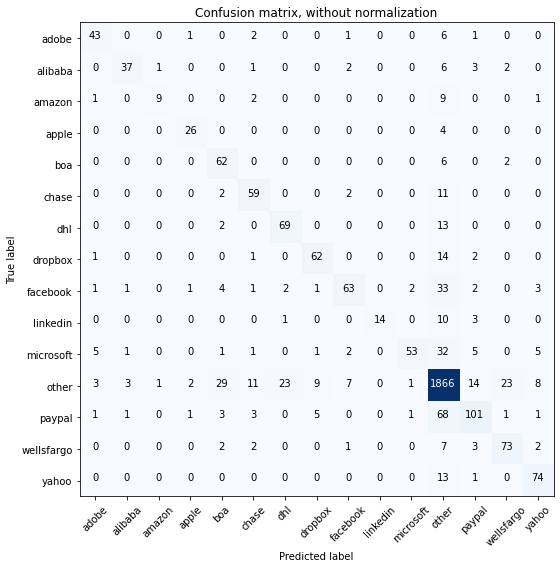

Acc     =  0.848
Pre     =  0.851
Rec     =  0.848
F1      =  0.843

Bal_Acc =  0.716
Bal_Pre =  0.8
Bal_Rec =  0.716
Bal_F1  =  0.756

              precision    recall  f1-score   support

       adobe       0.78      0.80      0.79        54
     alibaba       0.86      0.71      0.78        52
      amazon       0.82      0.41      0.55        22
       apple       0.84      0.87      0.85        30
         boa       0.59      0.89      0.71        70
       chase       0.71      0.80      0.75        74
         dhl       0.73      0.82      0.77        84
     dropbox       0.79      0.78      0.78        80
    facebook       0.81      0.55      0.66       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.93      0.50      0.65       106
       other       0.89      0.93      0.91      2000
      paypal       0.75      0.54      0.63       186
  wellsfargo       0.72      0.81      0.76        90
       yahoo       0.79      0.84      0.81        88

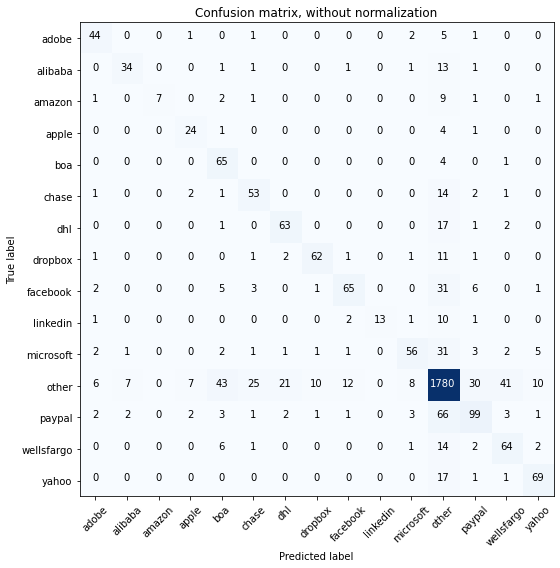

Acc     =  0.812
Pre     =  0.82
Rec     =  0.812
F1      =  0.81

Bal_Acc =  0.682
Bal_Pre =  0.749
Bal_Rec =  0.682
Bal_F1  =  0.714

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        54
     alibaba       0.77      0.65      0.71        52
      amazon       1.00      0.32      0.48        22
       apple       0.67      0.80      0.73        30
         boa       0.50      0.93      0.65        70
       chase       0.60      0.72      0.65        74
         dhl       0.71      0.75      0.73        84
     dropbox       0.83      0.78      0.80        80
    facebook       0.78      0.57      0.66       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.77      0.53      0.63       106
       other       0.88      0.89      0.88      2000
      paypal       0.66      0.53      0.59       186
  wellsfargo       0.56      0.71      0.62        90
       yahoo       0.78      0.78      0.78        88

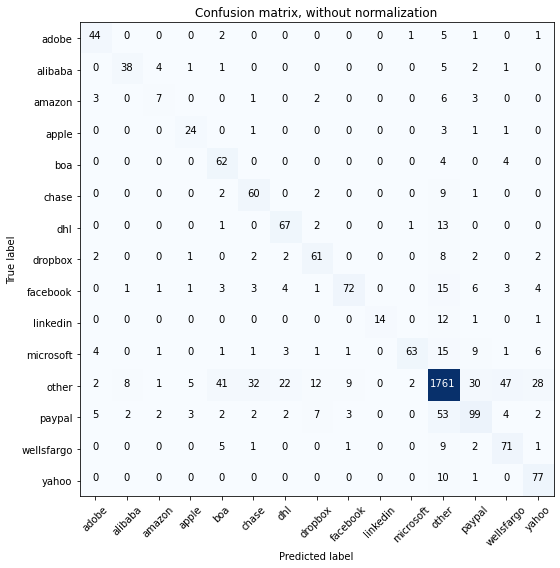

Acc     =  0.819
Pre     =  0.835
Rec     =  0.819
F1      =  0.821

Bal_Acc =  0.715
Bal_Pre =  0.705
Bal_Rec =  0.715
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.73      0.81      0.77        54
     alibaba       0.78      0.73      0.75        52
      amazon       0.44      0.32      0.37        22
       apple       0.69      0.80      0.74        30
         boa       0.52      0.89      0.65        70
       chase       0.58      0.81      0.68        74
         dhl       0.67      0.80      0.73        84
     dropbox       0.69      0.76      0.73        80
    facebook       0.84      0.63      0.72       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.94      0.59      0.73       106
       other       0.91      0.88      0.90      2000
      paypal       0.63      0.53      0.58       186
  wellsfargo       0.54      0.79      0.64        90
       yahoo       0.63      0.88      0.73        8

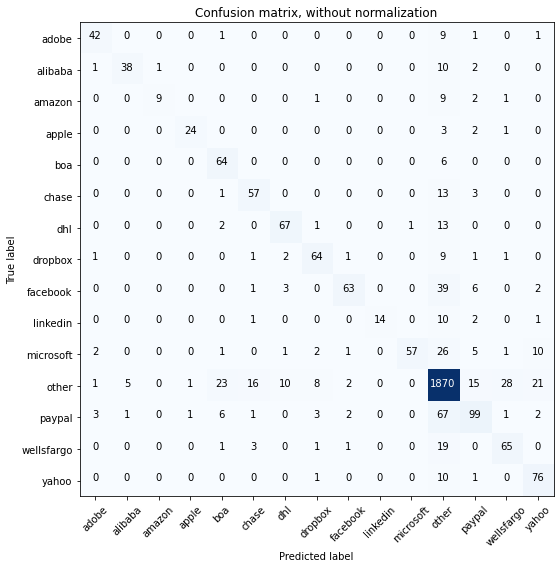

Acc     =  0.848
Pre     =  0.852
Rec     =  0.848
F1      =  0.842

Bal_Acc =  0.71
Bal_Pre =  0.82
Bal_Rec =  0.71
Bal_F1  =  0.761

              precision    recall  f1-score   support

       adobe       0.84      0.78      0.81        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.90      0.41      0.56        22
       apple       0.92      0.80      0.86        30
         boa       0.65      0.91      0.76        70
       chase       0.71      0.77      0.74        74
         dhl       0.81      0.80      0.80        84
     dropbox       0.79      0.80      0.80        80
    facebook       0.90      0.55      0.68       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.98      0.54      0.70       106
       other       0.88      0.94      0.91      2000
      paypal       0.71      0.53      0.61       186
  wellsfargo       0.66      0.72      0.69        90
       yahoo       0.67      0.86      0.76        88


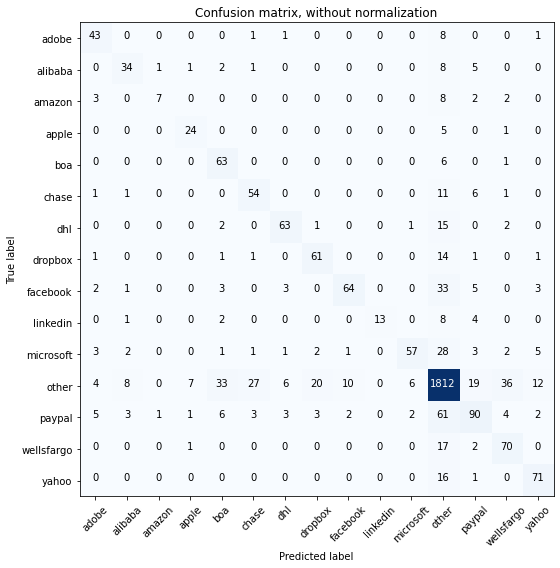

Acc     =  0.821
Pre     =  0.826
Rec     =  0.821
F1      =  0.817

Bal_Acc =  0.683
Bal_Pre =  0.741
Bal_Rec =  0.683
Bal_F1  =  0.711

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.68      0.65      0.67        52
      amazon       0.78      0.32      0.45        22
       apple       0.71      0.80      0.75        30
         boa       0.56      0.90      0.69        70
       chase       0.61      0.73      0.67        74
         dhl       0.82      0.75      0.78        84
     dropbox       0.70      0.76      0.73        80
    facebook       0.83      0.56      0.67       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.86      0.54      0.66       106
       other       0.88      0.91      0.89      2000
      paypal       0.65      0.48      0.56       186
  wellsfargo       0.59      0.78      0.67        90
       yahoo       0.75      0.81      0.78        

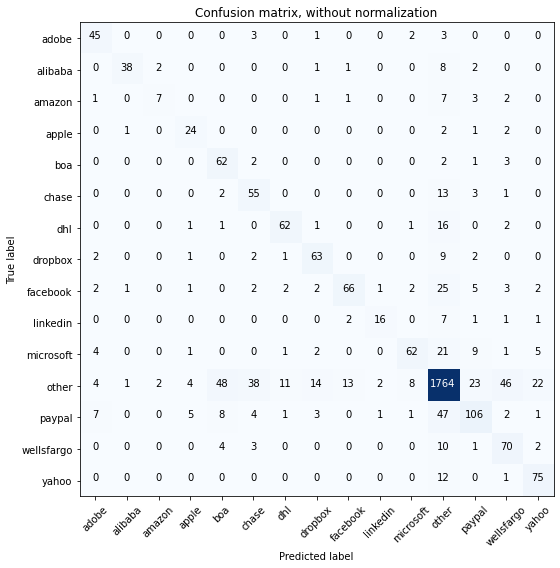

Acc     =  0.817
Pre     =  0.832
Rec     =  0.817
F1      =  0.819

Bal_Acc =  0.71
Bal_Pre =  0.708
Bal_Rec =  0.71
Bal_F1  =  0.709

              precision    recall  f1-score   support

       adobe       0.69      0.83      0.76        54
     alibaba       0.93      0.73      0.82        52
      amazon       0.64      0.32      0.42        22
       apple       0.65      0.80      0.72        30
         boa       0.50      0.89      0.64        70
       chase       0.50      0.74      0.60        74
         dhl       0.79      0.74      0.77        84
     dropbox       0.72      0.79      0.75        80
    facebook       0.80      0.58      0.67       114
    linkedin       0.80      0.57      0.67        28
   microsoft       0.82      0.58      0.68       106
       other       0.91      0.88      0.89      2000
      paypal       0.68      0.57      0.62       186
  wellsfargo       0.52      0.78      0.62        90
       yahoo       0.69      0.85      0.77        88

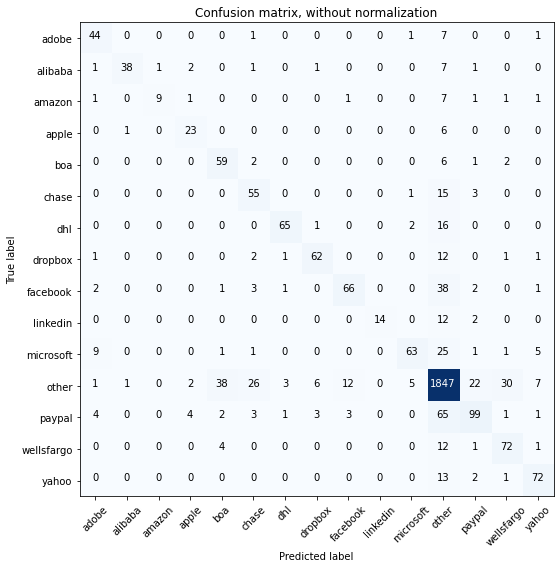

Acc     =  0.841
Pre     =  0.846
Rec     =  0.841
F1      =  0.838

Bal_Acc =  0.707
Bal_Pre =  0.796
Bal_Rec =  0.707
Bal_F1  =  0.749

              precision    recall  f1-score   support

       adobe       0.70      0.81      0.75        54
     alibaba       0.95      0.73      0.83        52
      amazon       0.90      0.41      0.56        22
       apple       0.72      0.77      0.74        30
         boa       0.56      0.84      0.67        70
       chase       0.59      0.74      0.65        74
         dhl       0.92      0.77      0.84        84
     dropbox       0.85      0.78      0.81        80
    facebook       0.80      0.58      0.67       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.59      0.71       106
       other       0.88      0.92      0.90      2000
      paypal       0.73      0.53      0.62       186
  wellsfargo       0.66      0.80      0.72        90
       yahoo       0.80      0.82      0.81        

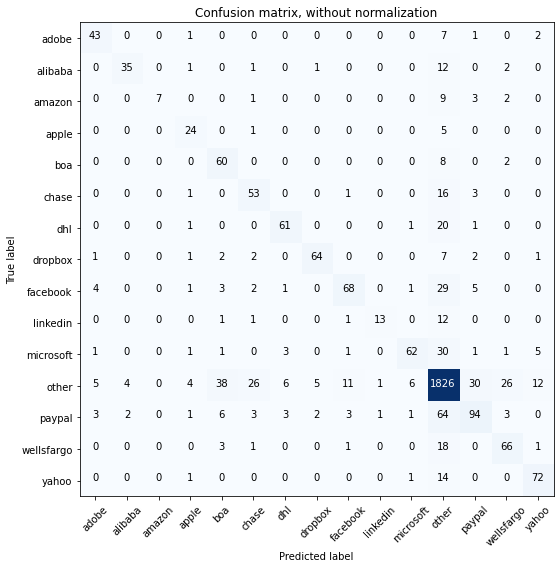

Acc     =  0.828
Pre     =  0.832
Rec     =  0.828
F1      =  0.824

Bal_Acc =  0.687
Bal_Pre =  0.771
Bal_Rec =  0.687
Bal_F1  =  0.727

              precision    recall  f1-score   support

       adobe       0.75      0.80      0.77        54
     alibaba       0.85      0.67      0.75        52
      amazon       1.00      0.32      0.48        22
       apple       0.65      0.80      0.72        30
         boa       0.53      0.86      0.65        70
       chase       0.58      0.72      0.64        74
         dhl       0.82      0.73      0.77        84
     dropbox       0.89      0.80      0.84        80
    facebook       0.79      0.60      0.68       114
    linkedin       0.87      0.46      0.60        28
   microsoft       0.86      0.58      0.70       106
       other       0.88      0.91      0.90      2000
      paypal       0.67      0.51      0.58       186
  wellsfargo       0.65      0.73      0.69        90
       yahoo       0.77      0.82      0.80        

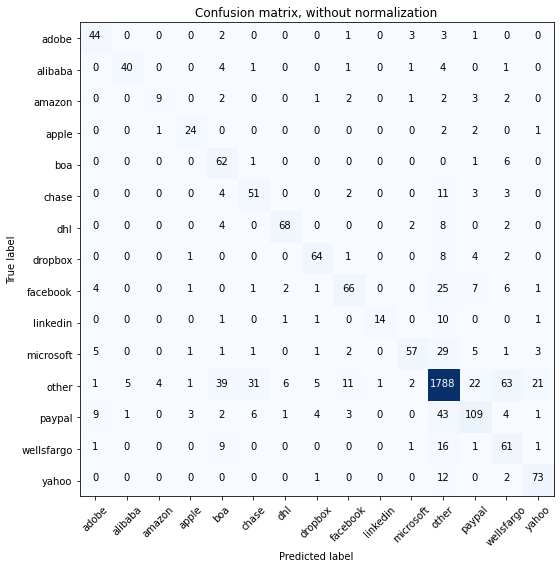

Acc     =  0.822
Pre     =  0.84
Rec     =  0.822
F1      =  0.825

Bal_Acc =  0.705
Bal_Pre =  0.729
Bal_Rec =  0.705
Bal_F1  =  0.717

              precision    recall  f1-score   support

       adobe       0.69      0.81      0.75        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.64      0.41      0.50        22
       apple       0.77      0.80      0.79        30
         boa       0.48      0.89      0.62        70
       chase       0.55      0.69      0.61        74
         dhl       0.87      0.81      0.84        84
     dropbox       0.82      0.80      0.81        80
    facebook       0.74      0.58      0.65       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.85      0.54      0.66       106
       other       0.91      0.89      0.90      2000
      paypal       0.69      0.59      0.63       186
  wellsfargo       0.40      0.68      0.50        90
       yahoo       0.72      0.83      0.77        8

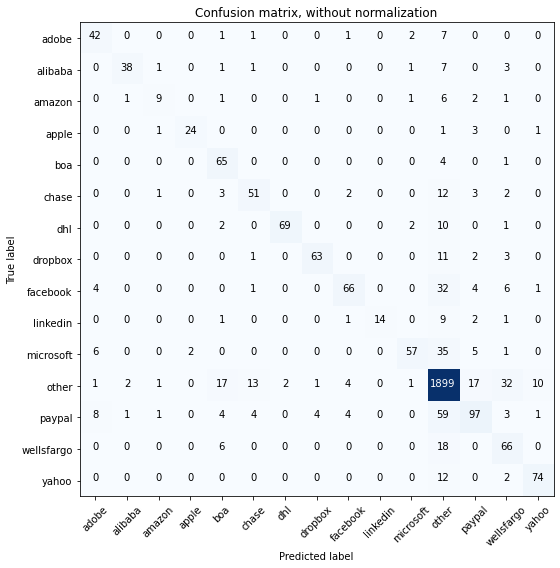

Acc     =  0.856
Pre     =  0.859
Rec     =  0.856
F1      =  0.851

Bal_Acc =  0.707
Bal_Pre =  0.809
Bal_Rec =  0.707
Bal_F1  =  0.755

              precision    recall  f1-score   support

       adobe       0.69      0.78      0.73        54
     alibaba       0.90      0.73      0.81        52
      amazon       0.64      0.41      0.50        22
       apple       0.92      0.80      0.86        30
         boa       0.64      0.93      0.76        70
       chase       0.71      0.69      0.70        74
         dhl       0.97      0.82      0.89        84
     dropbox       0.91      0.79      0.85        80
    facebook       0.85      0.58      0.69       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.54      0.67       106
       other       0.89      0.95      0.92      2000
      paypal       0.72      0.52      0.60       186
  wellsfargo       0.54      0.73      0.62        90
       yahoo       0.85      0.84      0.85        

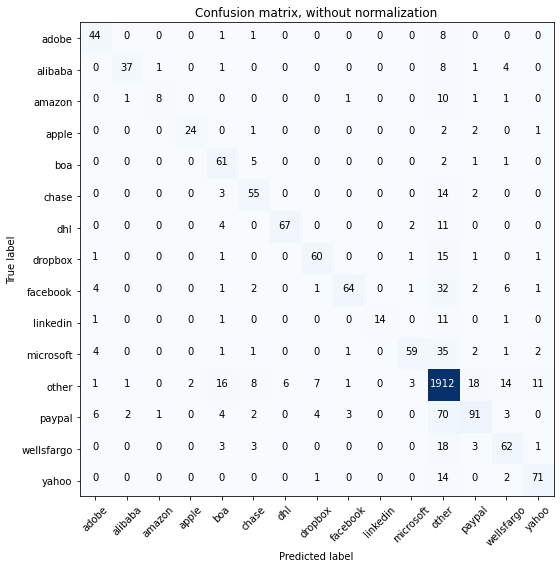

Acc     =  0.854
Pre     =  0.855
Rec     =  0.854
F1      =  0.847

Bal_Acc =  0.694
Bal_Pre =  0.82
Bal_Rec =  0.694
Bal_F1  =  0.752

              precision    recall  f1-score   support

       adobe       0.72      0.81      0.77        54
     alibaba       0.90      0.71      0.80        52
      amazon       0.80      0.36      0.50        22
       apple       0.92      0.80      0.86        30
         boa       0.63      0.87      0.73        70
       chase       0.71      0.74      0.72        74
         dhl       0.92      0.80      0.85        84
     dropbox       0.82      0.75      0.78        80
    facebook       0.91      0.56      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.89      0.56      0.69       106
       other       0.88      0.96      0.92      2000
      paypal       0.73      0.49      0.59       186
  wellsfargo       0.65      0.69      0.67        90
       yahoo       0.81      0.81      0.81        8

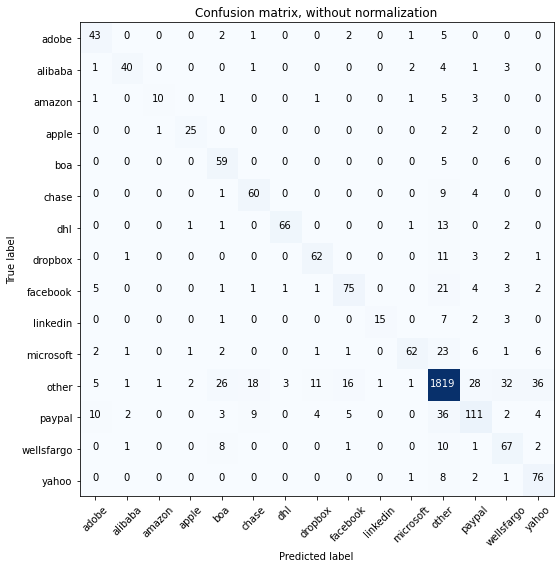

Acc     =  0.841
Pre     =  0.853
Rec     =  0.841
F1      =  0.843

Bal_Acc =  0.731
Bal_Pre =  0.765
Bal_Rec =  0.731
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.64      0.80      0.71        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.83      0.45      0.59        22
       apple       0.86      0.83      0.85        30
         boa       0.56      0.84      0.67        70
       chase       0.67      0.81      0.73        74
         dhl       0.94      0.79      0.86        84
     dropbox       0.78      0.78      0.78        80
    facebook       0.75      0.66      0.70       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.90      0.58      0.71       106
       other       0.92      0.91      0.91      2000
      paypal       0.66      0.60      0.63       186
  wellsfargo       0.55      0.74      0.63        90
       yahoo       0.60      0.86      0.71        

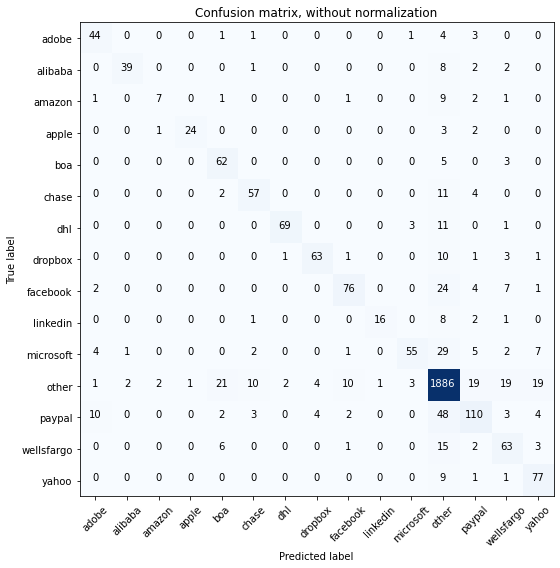

Acc     =  0.86
Pre     =  0.863
Rec     =  0.86
F1      =  0.857

Bal_Acc =  0.721
Bal_Pre =  0.807
Bal_Rec =  0.721
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.71      0.81      0.76        54
     alibaba       0.93      0.75      0.83        52
      amazon       0.70      0.32      0.44        22
       apple       0.96      0.80      0.87        30
         boa       0.65      0.89      0.75        70
       chase       0.76      0.77      0.77        74
         dhl       0.96      0.82      0.88        84
     dropbox       0.89      0.79      0.83        80
    facebook       0.83      0.67      0.74       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.89      0.52      0.65       106
       other       0.91      0.94      0.92      2000
      paypal       0.70      0.59      0.64       186
  wellsfargo       0.59      0.70      0.64        90
       yahoo       0.69      0.88      0.77        88

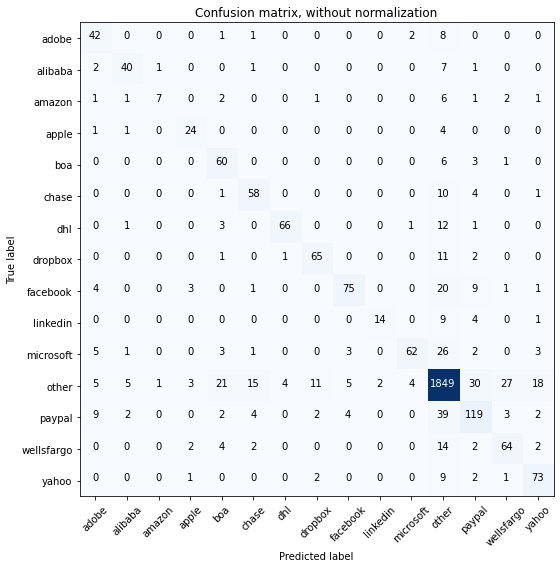

Acc     =  0.851
Pre     =  0.856
Rec     =  0.851
F1      =  0.849

Bal_Acc =  0.717
Bal_Pre =  0.767
Bal_Rec =  0.717
Bal_F1  =  0.741

              precision    recall  f1-score   support

       adobe       0.61      0.78      0.68        54
     alibaba       0.78      0.77      0.78        52
      amazon       0.78      0.32      0.45        22
       apple       0.73      0.80      0.76        30
         boa       0.61      0.86      0.71        70
       chase       0.70      0.78      0.74        74
         dhl       0.93      0.79      0.85        84
     dropbox       0.80      0.81      0.81        80
    facebook       0.86      0.66      0.75       114
    linkedin       0.88      0.50      0.64        28
   microsoft       0.90      0.58      0.71       106
       other       0.91      0.92      0.92      2000
      paypal       0.66      0.64      0.65       186
  wellsfargo       0.65      0.71      0.68        90
       yahoo       0.72      0.83      0.77        

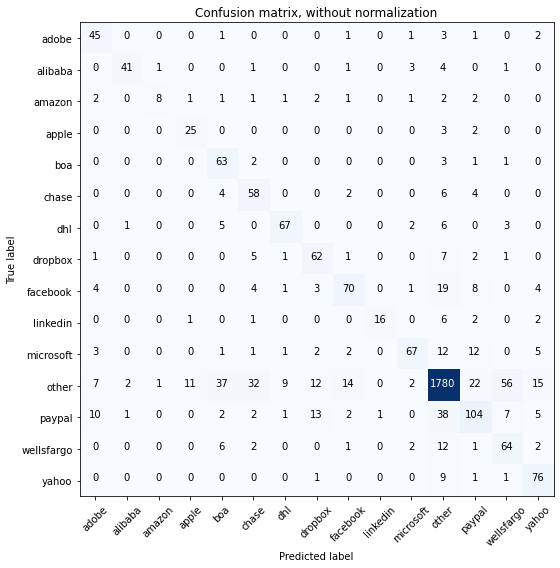

Acc     =  0.827
Pre     =  0.846
Rec     =  0.827
F1      =  0.831

Bal_Acc =  0.728
Bal_Pre =  0.72
Bal_Rec =  0.728
Bal_F1  =  0.724

              precision    recall  f1-score   support

       adobe       0.62      0.83      0.71        54
     alibaba       0.91      0.79      0.85        52
      amazon       0.80      0.36      0.50        22
       apple       0.66      0.83      0.74        30
         boa       0.53      0.90      0.66        70
       chase       0.53      0.78      0.63        74
         dhl       0.83      0.80      0.81        84
     dropbox       0.65      0.78      0.71        80
    facebook       0.74      0.61      0.67       114
    linkedin       0.94      0.57      0.71        28
   microsoft       0.85      0.63      0.72       106
       other       0.93      0.89      0.91      2000
      paypal       0.64      0.56      0.60       186
  wellsfargo       0.48      0.71      0.57        90
       yahoo       0.68      0.86      0.76        8

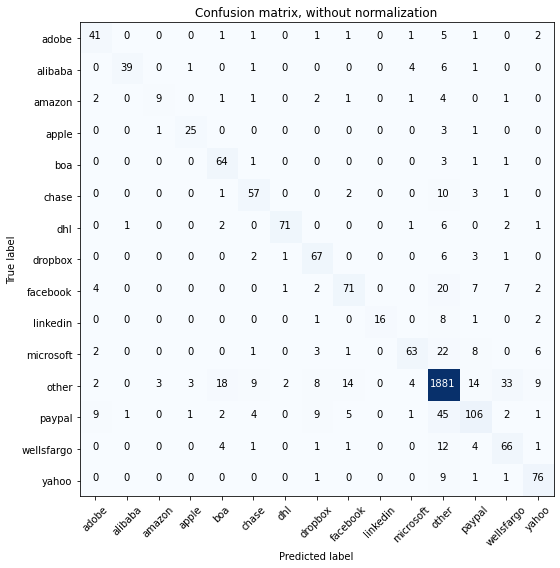

Acc     =  0.862
Pre     =  0.864
Rec     =  0.862
F1      =  0.859

Bal_Acc =  0.734
Bal_Pre =  0.785
Bal_Rec =  0.734
Bal_F1  =  0.759

              precision    recall  f1-score   support

       adobe       0.68      0.76      0.72        54
     alibaba       0.95      0.75      0.84        52
      amazon       0.69      0.41      0.51        22
       apple       0.83      0.83      0.83        30
         boa       0.69      0.91      0.79        70
       chase       0.73      0.77      0.75        74
         dhl       0.95      0.85      0.89        84
     dropbox       0.71      0.84      0.77        80
    facebook       0.74      0.62      0.68       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.84      0.59      0.70       106
       other       0.92      0.94      0.93      2000
      paypal       0.70      0.57      0.63       186
  wellsfargo       0.57      0.73      0.64        90
       yahoo       0.76      0.86      0.81        

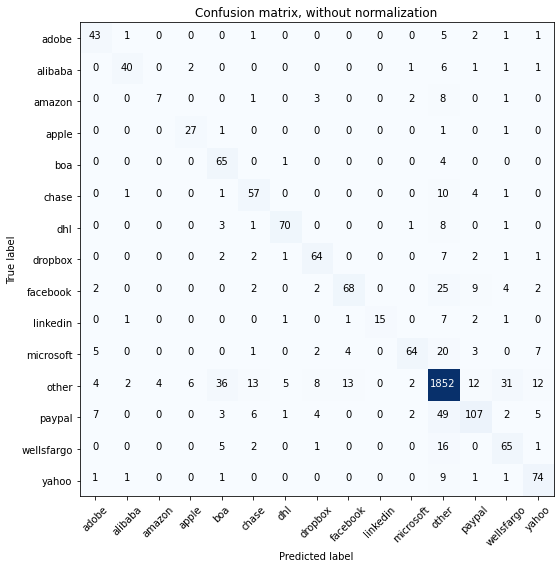

Acc     =  0.851
Pre     =  0.857
Rec     =  0.851
F1      =  0.849

Bal_Acc =  0.728
Bal_Pre =  0.765
Bal_Rec =  0.728
Bal_F1  =  0.746

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       0.87      0.77      0.82        52
      amazon       0.64      0.32      0.42        22
       apple       0.77      0.90      0.83        30
         boa       0.56      0.93      0.70        70
       chase       0.66      0.77      0.71        74
         dhl       0.89      0.83      0.86        84
     dropbox       0.76      0.80      0.78        80
    facebook       0.79      0.60      0.68       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.89      0.60      0.72       106
       other       0.91      0.93      0.92      2000
      paypal       0.75      0.58      0.65       186
  wellsfargo       0.59      0.72      0.65        90
       yahoo       0.71      0.84      0.77        

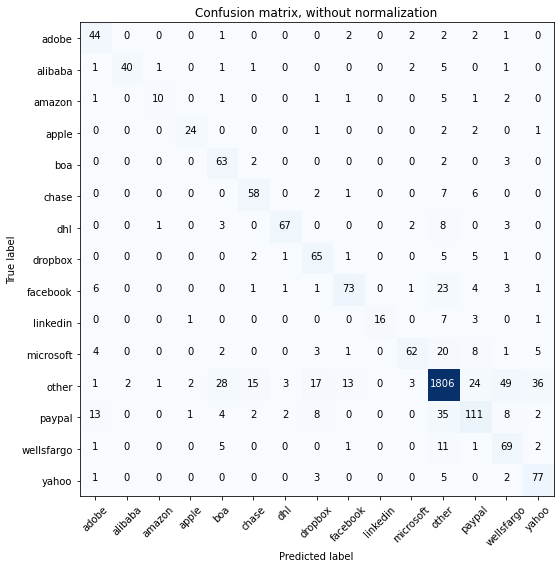

Acc     =  0.84
Pre     =  0.856
Rec     =  0.84
F1      =  0.843

Bal_Acc =  0.738
Bal_Pre =  0.758
Bal_Rec =  0.738
Bal_F1  =  0.748

              precision    recall  f1-score   support

       adobe       0.61      0.81      0.70        54
     alibaba       0.95      0.77      0.85        52
      amazon       0.77      0.45      0.57        22
       apple       0.86      0.80      0.83        30
         boa       0.58      0.90      0.71        70
       chase       0.72      0.78      0.75        74
         dhl       0.91      0.80      0.85        84
     dropbox       0.64      0.81      0.72        80
    facebook       0.78      0.64      0.71       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.86      0.58      0.70       106
       other       0.93      0.90      0.92      2000
      paypal       0.66      0.60      0.63       186
  wellsfargo       0.48      0.77      0.59        90
       yahoo       0.62      0.88      0.72        88

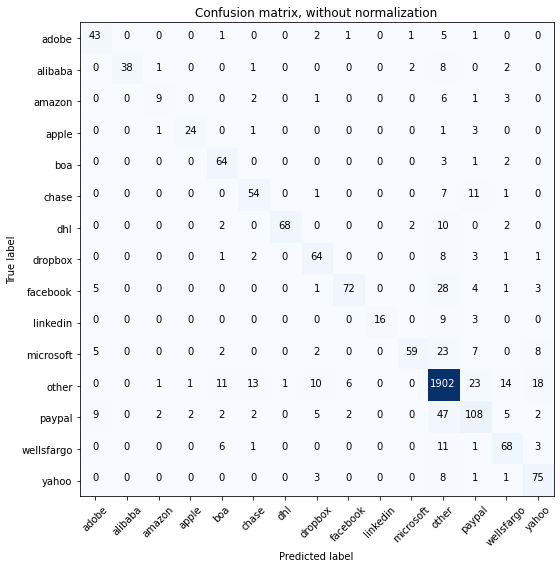

Acc     =  0.865
Pre     =  0.869
Rec     =  0.865
F1      =  0.862

Bal_Acc =  0.726
Bal_Pre =  0.806
Bal_Rec =  0.726
Bal_F1  =  0.764

              precision    recall  f1-score   support

       adobe       0.69      0.80      0.74        54
     alibaba       1.00      0.73      0.84        52
      amazon       0.64      0.41      0.50        22
       apple       0.89      0.80      0.84        30
         boa       0.72      0.91      0.81        70
       chase       0.71      0.73      0.72        74
         dhl       0.99      0.81      0.89        84
     dropbox       0.72      0.80      0.76        80
    facebook       0.89      0.63      0.74       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.92      0.56      0.69       106
       other       0.92      0.95      0.93      2000
      paypal       0.65      0.58      0.61       186
  wellsfargo       0.68      0.76      0.72        90
       yahoo       0.68      0.85      0.76        

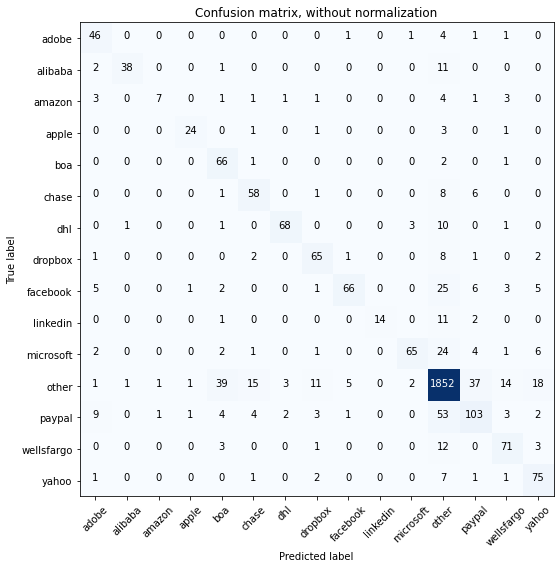

Acc     =  0.851
Pre     =  0.859
Rec     =  0.851
F1      =  0.849

Bal_Acc =  0.724
Bal_Pre =  0.794
Bal_Rec =  0.724
Bal_F1  =  0.757

              precision    recall  f1-score   support

       adobe       0.66      0.85      0.74        54
     alibaba       0.95      0.73      0.83        52
      amazon       0.78      0.32      0.45        22
       apple       0.89      0.80      0.84        30
         boa       0.55      0.94      0.69        70
       chase       0.69      0.78      0.73        74
         dhl       0.92      0.81      0.86        84
     dropbox       0.75      0.81      0.78        80
    facebook       0.89      0.58      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.92      0.61      0.73       106
       other       0.91      0.93      0.92      2000
      paypal       0.64      0.55      0.59       186
  wellsfargo       0.71      0.79      0.75        90
       yahoo       0.68      0.85      0.75        

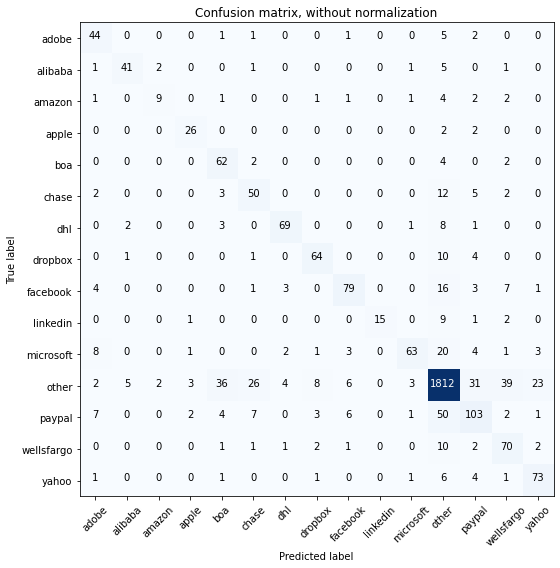

Acc     =  0.838
Pre     =  0.849
Rec     =  0.838
F1      =  0.839

Bal_Acc =  0.73
Bal_Pre =  0.749
Bal_Rec =  0.73
Bal_F1  =  0.739

              precision    recall  f1-score   support

       adobe       0.63      0.81      0.71        54
     alibaba       0.84      0.79      0.81        52
      amazon       0.69      0.41      0.51        22
       apple       0.79      0.87      0.83        30
         boa       0.55      0.89      0.68        70
       chase       0.56      0.68      0.61        74
         dhl       0.87      0.82      0.85        84
     dropbox       0.80      0.80      0.80        80
    facebook       0.81      0.69      0.75       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.89      0.59      0.71       106
       other       0.92      0.91      0.91      2000
      paypal       0.63      0.55      0.59       186
  wellsfargo       0.54      0.78      0.64        90
       yahoo       0.71      0.83      0.76        88

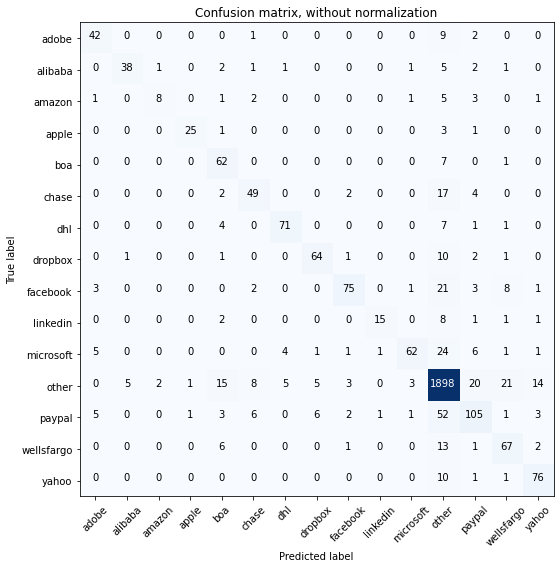

Acc     =  0.863
Pre     =  0.864
Rec     =  0.863
F1      =  0.859

Bal_Acc =  0.72
Bal_Pre =  0.8
Bal_Rec =  0.72
Bal_F1  =  0.758

              precision    recall  f1-score   support

       adobe       0.75      0.78      0.76        54
     alibaba       0.86      0.73      0.79        52
      amazon       0.73      0.36      0.48        22
       apple       0.93      0.83      0.88        30
         boa       0.63      0.89      0.73        70
       chase       0.71      0.66      0.69        74
         dhl       0.88      0.85      0.86        84
     dropbox       0.84      0.80      0.82        80
    facebook       0.88      0.66      0.75       114
    linkedin       0.88      0.54      0.67        28
   microsoft       0.90      0.58      0.71       106
       other       0.91      0.95      0.93      2000
      paypal       0.69      0.56      0.62       186
  wellsfargo       0.64      0.74      0.69        90
       yahoo       0.77      0.86      0.81        88



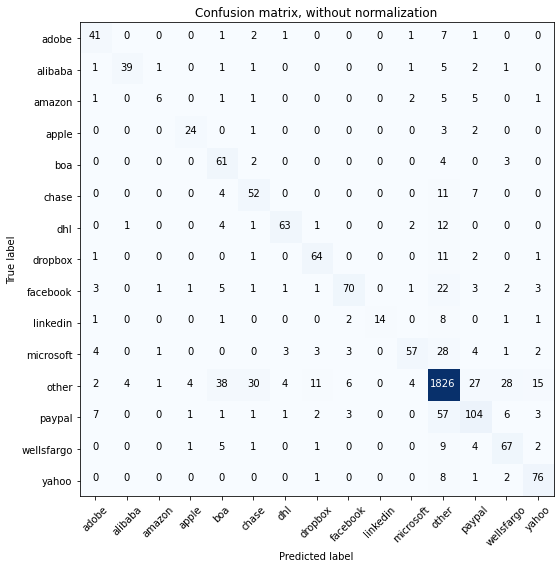

Acc     =  0.833
Pre     =  0.841
Rec     =  0.833
F1      =  0.832

Bal_Acc =  0.696
Bal_Pre =  0.744
Bal_Rec =  0.696
Bal_F1  =  0.719

              precision    recall  f1-score   support

       adobe       0.67      0.76      0.71        54
     alibaba       0.89      0.75      0.81        52
      amazon       0.60      0.27      0.37        22
       apple       0.77      0.80      0.79        30
         boa       0.50      0.87      0.64        70
       chase       0.55      0.70      0.62        74
         dhl       0.86      0.75      0.80        84
     dropbox       0.76      0.80      0.78        80
    facebook       0.83      0.61      0.71       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.84      0.54      0.66       106
       other       0.91      0.91      0.91      2000
      paypal       0.64      0.56      0.60       186
  wellsfargo       0.60      0.74      0.67        90
       yahoo       0.73      0.86      0.79        

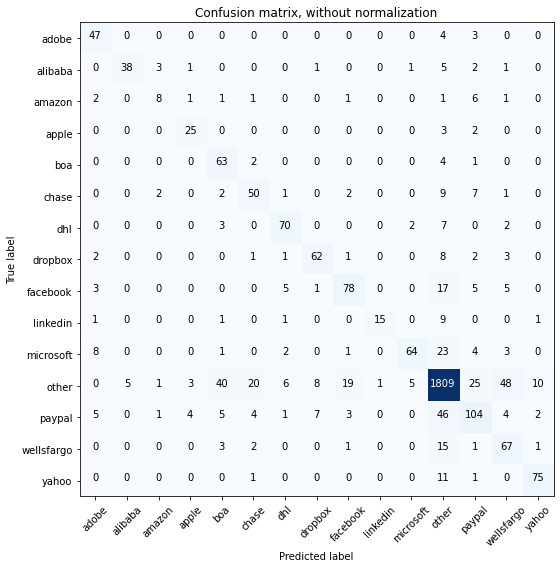

Acc     =  0.837
Pre     =  0.847
Rec     =  0.837
F1      =  0.838

Bal_Acc =  0.724
Bal_Pre =  0.736
Bal_Rec =  0.724
Bal_F1  =  0.73

              precision    recall  f1-score   support

       adobe       0.69      0.87      0.77        54
     alibaba       0.88      0.73      0.80        52
      amazon       0.53      0.36      0.43        22
       apple       0.74      0.83      0.78        30
         boa       0.53      0.90      0.67        70
       chase       0.62      0.68      0.65        74
         dhl       0.80      0.83      0.82        84
     dropbox       0.78      0.78      0.78        80
    facebook       0.74      0.68      0.71       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.89      0.60      0.72       106
       other       0.92      0.90      0.91      2000
      paypal       0.64      0.56      0.60       186
  wellsfargo       0.50      0.74      0.60        90
       yahoo       0.84      0.85      0.85        8

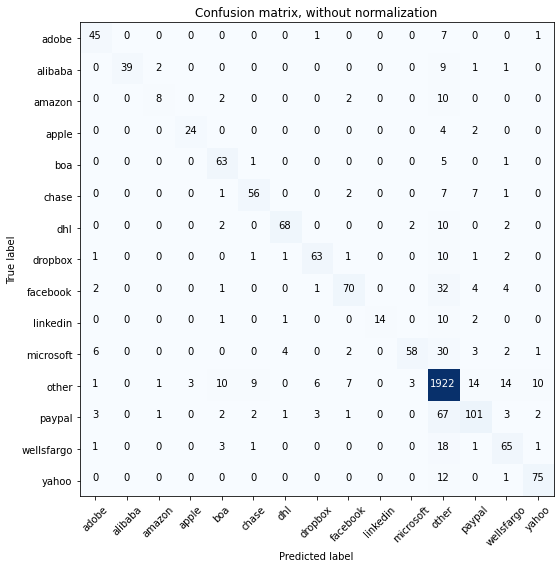

Acc     =  0.868
Pre     =  0.867
Rec     =  0.868
F1      =  0.861

Bal_Acc =  0.716
Bal_Pre =  0.834
Bal_Rec =  0.716
Bal_F1  =  0.771

              precision    recall  f1-score   support

       adobe       0.76      0.83      0.80        54
     alibaba       1.00      0.75      0.86        52
      amazon       0.67      0.36      0.47        22
       apple       0.89      0.80      0.84        30
         boa       0.74      0.90      0.81        70
       chase       0.80      0.76      0.78        74
         dhl       0.91      0.81      0.86        84
     dropbox       0.85      0.79      0.82        80
    facebook       0.82      0.61      0.70       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.92      0.55      0.69       106
       other       0.89      0.96      0.93      2000
      paypal       0.74      0.54      0.63       186
  wellsfargo       0.68      0.72      0.70        90
       yahoo       0.83      0.85      0.84        

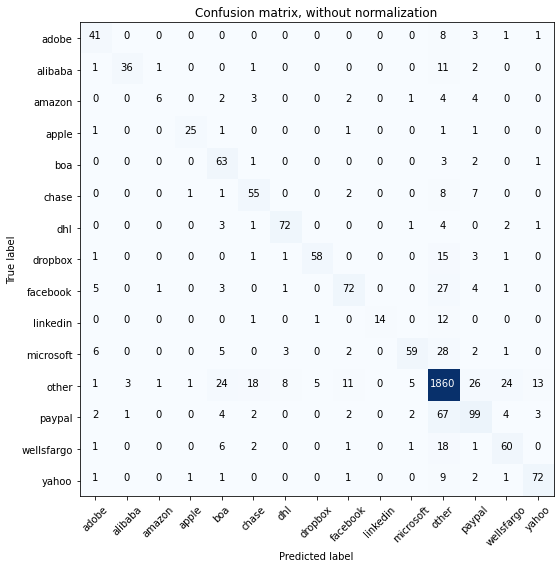

Acc     =  0.842
Pre     =  0.844
Rec     =  0.842
F1      =  0.839

Bal_Acc =  0.695
Bal_Pre =  0.778
Bal_Rec =  0.695
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.68      0.76      0.72        54
     alibaba       0.90      0.69      0.78        52
      amazon       0.67      0.27      0.39        22
       apple       0.89      0.83      0.86        30
         boa       0.56      0.90      0.69        70
       chase       0.65      0.74      0.69        74
         dhl       0.85      0.86      0.85        84
     dropbox       0.91      0.72      0.81        80
    facebook       0.77      0.63      0.69       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.86      0.56      0.67       106
       other       0.90      0.93      0.91      2000
      paypal       0.63      0.53      0.58       186
  wellsfargo       0.63      0.67      0.65        90
       yahoo       0.79      0.82      0.80        

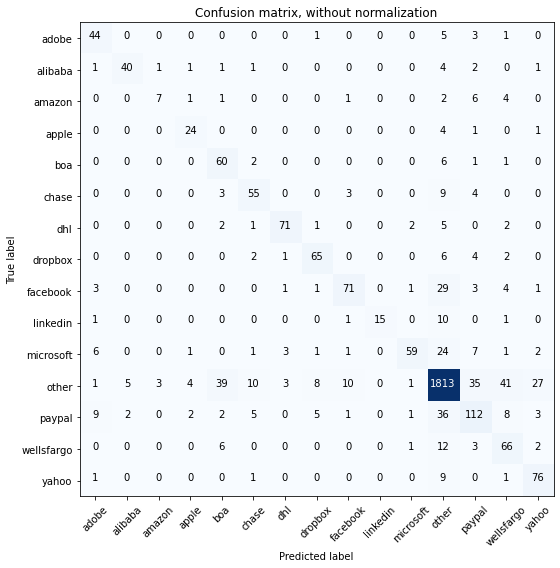

Acc     =  0.838
Pre     =  0.85
Rec     =  0.838
F1      =  0.839

Bal_Acc =  0.719
Bal_Pre =  0.749
Bal_Rec =  0.719
Bal_F1  =  0.734

              precision    recall  f1-score   support

       adobe       0.67      0.81      0.73        54
     alibaba       0.85      0.77      0.81        52
      amazon       0.64      0.32      0.42        22
       apple       0.73      0.80      0.76        30
         boa       0.53      0.86      0.65        70
       chase       0.71      0.74      0.72        74
         dhl       0.90      0.85      0.87        84
     dropbox       0.79      0.81      0.80        80
    facebook       0.81      0.62      0.70       114
    linkedin       1.00      0.54      0.70        28
   microsoft       0.91      0.56      0.69       106
       other       0.92      0.91      0.91      2000
      paypal       0.62      0.60      0.61       186
  wellsfargo       0.50      0.73      0.59        90
       yahoo       0.67      0.86      0.76        8

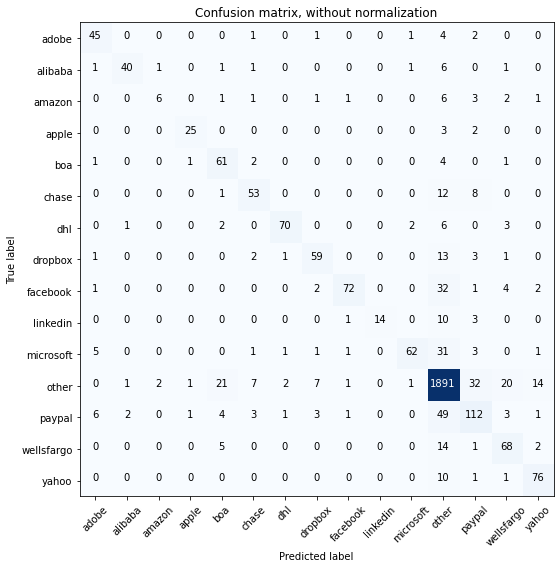

Acc     =  0.862
Pre     =  0.865
Rec     =  0.862
F1      =  0.859

Bal_Acc =  0.717
Bal_Pre =  0.813
Bal_Rec =  0.717
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.75      0.83      0.79        54
     alibaba       0.91      0.77      0.83        52
      amazon       0.67      0.27      0.39        22
       apple       0.89      0.83      0.86        30
         boa       0.64      0.87      0.73        70
       chase       0.75      0.72      0.73        74
         dhl       0.93      0.83      0.88        84
     dropbox       0.80      0.74      0.77        80
    facebook       0.94      0.63      0.75       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.93      0.58      0.72       106
       other       0.90      0.95      0.92      2000
      paypal       0.65      0.60      0.63       186
  wellsfargo       0.65      0.76      0.70        90
       yahoo       0.78      0.86      0.82        

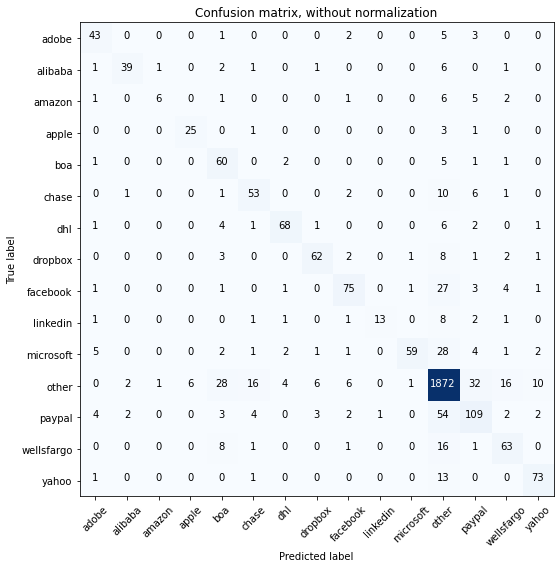

Acc     =  0.851
Pre     =  0.856
Rec     =  0.851
F1      =  0.848

Bal_Acc =  0.703
Bal_Pre =  0.786
Bal_Rec =  0.703
Bal_F1  =  0.742

              precision    recall  f1-score   support

       adobe       0.73      0.80      0.76        54
     alibaba       0.89      0.75      0.81        52
      amazon       0.75      0.27      0.40        22
       apple       0.81      0.83      0.82        30
         boa       0.53      0.86      0.65        70
       chase       0.66      0.72      0.69        74
         dhl       0.87      0.81      0.84        84
     dropbox       0.84      0.78      0.81        80
    facebook       0.81      0.66      0.72       114
    linkedin       0.93      0.46      0.62        28
   microsoft       0.95      0.56      0.70       106
       other       0.91      0.94      0.92      2000
      paypal       0.64      0.59      0.61       186
  wellsfargo       0.67      0.70      0.68        90
       yahoo       0.81      0.83      0.82        

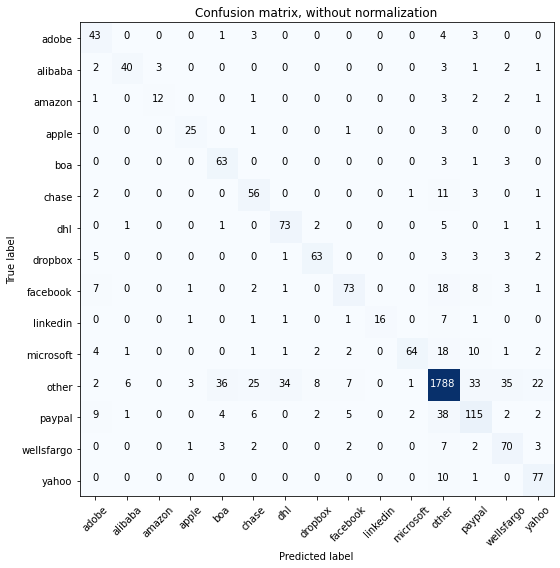

Acc     =  0.838
Pre     =  0.854
Rec     =  0.838
F1      =  0.841

Bal_Acc =  0.749
Bal_Pre =  0.746
Bal_Rec =  0.749
Bal_F1  =  0.747

              precision    recall  f1-score   support

       adobe       0.57      0.80      0.67        54
     alibaba       0.82      0.77      0.79        52
      amazon       0.80      0.55      0.65        22
       apple       0.81      0.83      0.82        30
         boa       0.58      0.90      0.71        70
       chase       0.57      0.76      0.65        74
         dhl       0.66      0.87      0.75        84
     dropbox       0.82      0.79      0.80        80
    facebook       0.80      0.64      0.71       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.94      0.60      0.74       106
       other       0.93      0.89      0.91      2000
      paypal       0.63      0.62      0.62       186
  wellsfargo       0.57      0.78      0.66        90
       yahoo       0.68      0.88      0.77        

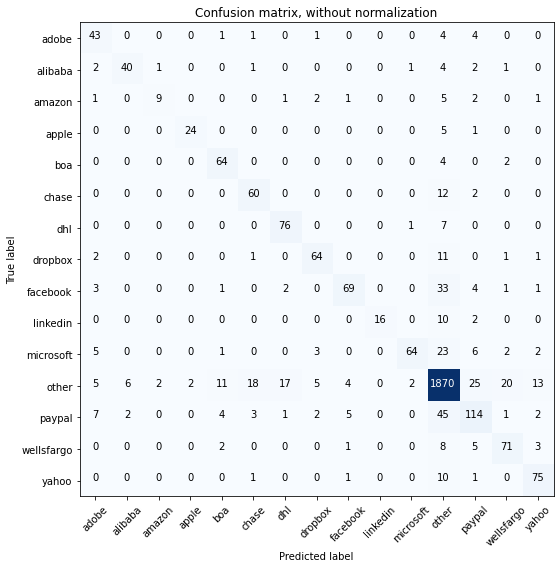

Acc     =  0.864
Pre     =  0.866
Rec     =  0.864
F1      =  0.861

Bal_Acc =  0.745
Bal_Pre =  0.806
Bal_Rec =  0.745
Bal_F1  =  0.774

              precision    recall  f1-score   support

       adobe       0.63      0.80      0.70        54
     alibaba       0.83      0.77      0.80        52
      amazon       0.75      0.41      0.53        22
       apple       0.92      0.80      0.86        30
         boa       0.76      0.91      0.83        70
       chase       0.71      0.81      0.75        74
         dhl       0.78      0.90      0.84        84
     dropbox       0.83      0.80      0.82        80
    facebook       0.85      0.61      0.71       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.94      0.60      0.74       106
       other       0.91      0.94      0.92      2000
      paypal       0.68      0.61      0.64       186
  wellsfargo       0.72      0.79      0.75        90
       yahoo       0.77      0.85      0.81        

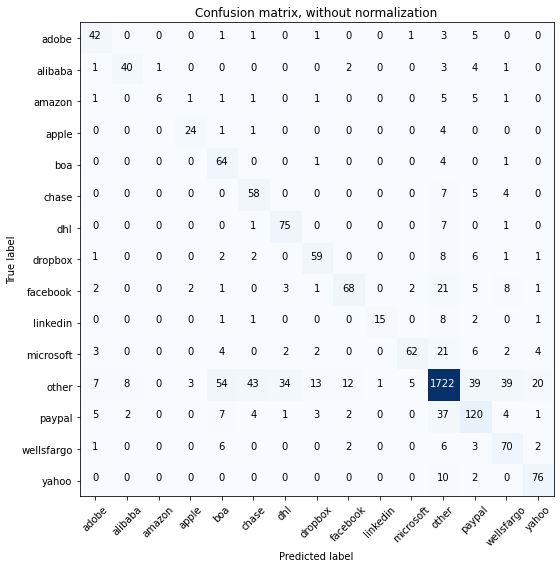

Acc     =  0.813
Pre     =  0.838
Rec     =  0.813
F1      =  0.818

Bal_Acc =  0.721
Bal_Pre =  0.723
Bal_Rec =  0.721
Bal_F1  =  0.722

              precision    recall  f1-score   support

       adobe       0.67      0.78      0.72        54
     alibaba       0.80      0.77      0.78        52
      amazon       0.86      0.27      0.41        22
       apple       0.80      0.80      0.80        30
         boa       0.45      0.91      0.60        70
       chase       0.52      0.78      0.62        74
         dhl       0.65      0.89      0.75        84
     dropbox       0.73      0.74      0.73        80
    facebook       0.79      0.60      0.68       114
    linkedin       0.94      0.54      0.68        28
   microsoft       0.89      0.58      0.70       106
       other       0.92      0.86      0.89      2000
      paypal       0.59      0.65      0.62       186
  wellsfargo       0.53      0.78      0.63        90
       yahoo       0.72      0.86      0.78        

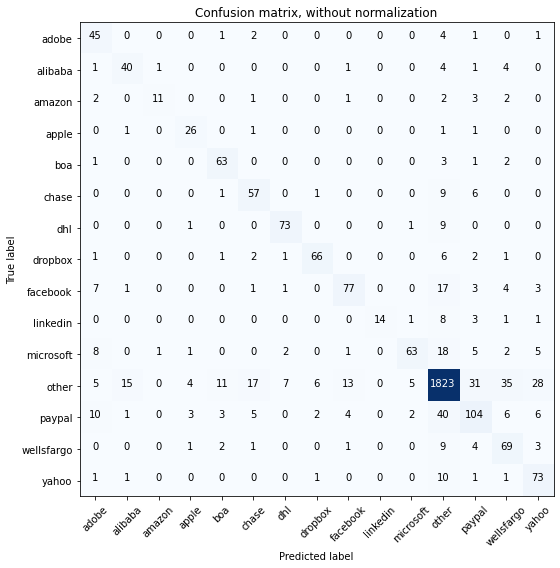

Acc     =  0.846
Pre     =  0.857
Rec     =  0.846
F1      =  0.847

Bal_Acc =  0.745
Bal_Pre =  0.755
Bal_Rec =  0.745
Bal_F1  =  0.75

              precision    recall  f1-score   support

       adobe       0.56      0.83      0.67        54
     alibaba       0.68      0.77      0.72        52
      amazon       0.85      0.50      0.63        22
       apple       0.72      0.87      0.79        30
         boa       0.77      0.90      0.83        70
       chase       0.66      0.77      0.71        74
         dhl       0.87      0.87      0.87        84
     dropbox       0.87      0.82      0.85        80
    facebook       0.79      0.68      0.73       114
    linkedin       1.00      0.50      0.67        28
   microsoft       0.88      0.59      0.71       106
       other       0.93      0.91      0.92      2000
      paypal       0.63      0.56      0.59       186
  wellsfargo       0.54      0.77      0.64        90
       yahoo       0.61      0.83      0.70        8

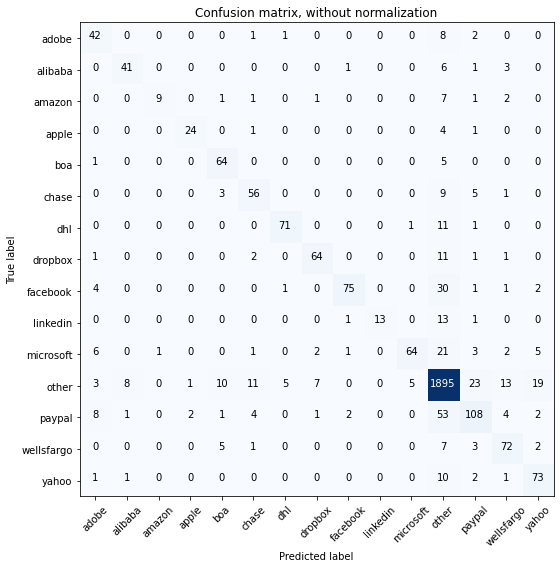

Acc     =  0.868
Pre     =  0.87
Rec     =  0.868
F1      =  0.864

Bal_Acc =  0.732
Bal_Pre =  0.824
Bal_Rec =  0.732
Bal_F1  =  0.775

              precision    recall  f1-score   support

       adobe       0.64      0.78      0.70        54
     alibaba       0.80      0.79      0.80        52
      amazon       0.90      0.41      0.56        22
       apple       0.89      0.80      0.84        30
         boa       0.76      0.91      0.83        70
       chase       0.72      0.76      0.74        74
         dhl       0.91      0.85      0.88        84
     dropbox       0.85      0.80      0.83        80
    facebook       0.94      0.66      0.77       114
    linkedin       1.00      0.46      0.63        28
   microsoft       0.91      0.60      0.73       106
       other       0.91      0.95      0.93      2000
      paypal       0.71      0.58      0.64       186
  wellsfargo       0.72      0.80      0.76        90
       yahoo       0.71      0.83      0.76        8

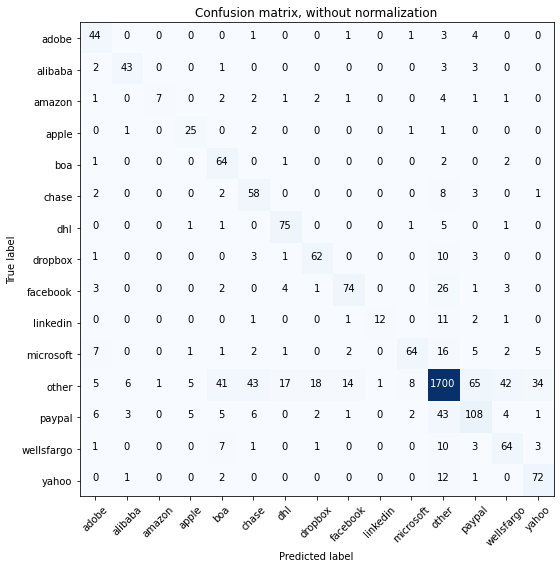

Acc     =  0.803
Pre     =  0.827
Rec     =  0.803
F1      =  0.808

Bal_Acc =  0.72
Bal_Pre =  0.704
Bal_Rec =  0.72
Bal_F1  =  0.712

              precision    recall  f1-score   support

       adobe       0.60      0.81      0.69        54
     alibaba       0.80      0.83      0.81        52
      amazon       0.88      0.32      0.47        22
       apple       0.68      0.83      0.75        30
         boa       0.50      0.91      0.65        70
       chase       0.49      0.78      0.60        74
         dhl       0.75      0.89      0.82        84
     dropbox       0.72      0.78      0.75        80
    facebook       0.79      0.65      0.71       114
    linkedin       0.92      0.43      0.59        28
   microsoft       0.83      0.60      0.70       106
       other       0.92      0.85      0.88      2000
      paypal       0.54      0.58      0.56       186
  wellsfargo       0.53      0.71      0.61        90
       yahoo       0.62      0.82      0.71        88

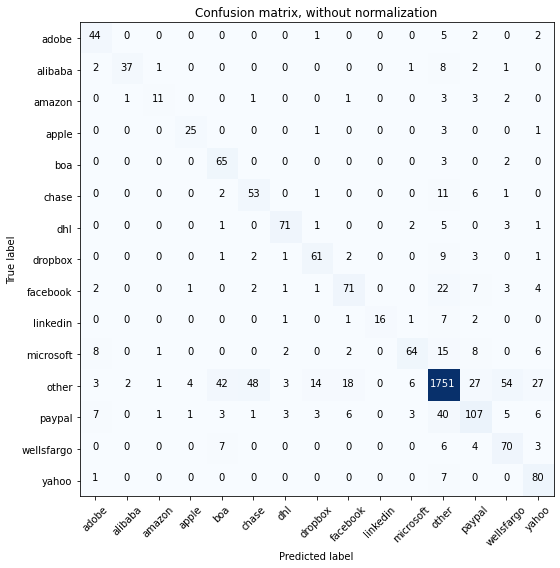

Acc     =  0.821
Pre     =  0.841
Rec     =  0.821
F1      =  0.825

Bal_Acc =  0.737
Bal_Pre =  0.73
Bal_Rec =  0.737
Bal_F1  =  0.733

              precision    recall  f1-score   support

       adobe       0.66      0.81      0.73        54
     alibaba       0.93      0.71      0.80        52
      amazon       0.73      0.50      0.59        22
       apple       0.81      0.83      0.82        30
         boa       0.54      0.93      0.68        70
       chase       0.50      0.72      0.59        74
         dhl       0.87      0.85      0.86        84
     dropbox       0.73      0.76      0.75        80
    facebook       0.70      0.62      0.66       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.83      0.60      0.70       106
       other       0.92      0.88      0.90      2000
      paypal       0.63      0.58      0.60       186
  wellsfargo       0.50      0.78      0.61        90
       yahoo       0.61      0.91      0.73        8

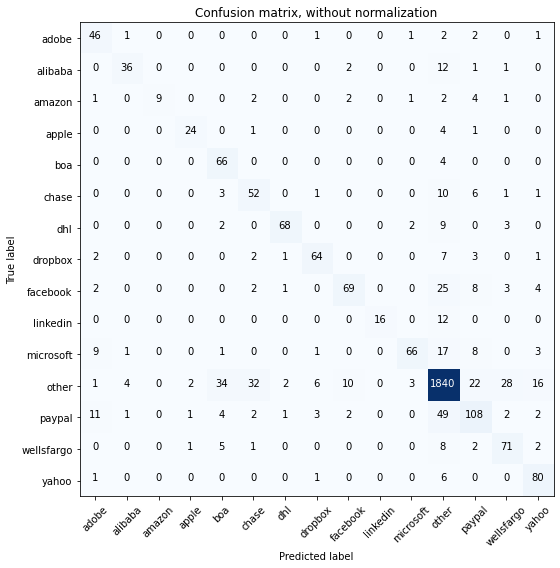

Acc     =  0.85
Pre     =  0.859
Rec     =  0.85
F1      =  0.849

Bal_Acc =  0.734
Bal_Pre =  0.792
Bal_Rec =  0.734
Bal_F1  =  0.762

              precision    recall  f1-score   support

       adobe       0.63      0.85      0.72        54
     alibaba       0.84      0.69      0.76        52
      amazon       1.00      0.41      0.58        22
       apple       0.86      0.80      0.83        30
         boa       0.57      0.94      0.71        70
       chase       0.55      0.70      0.62        74
         dhl       0.93      0.81      0.87        84
     dropbox       0.83      0.80      0.82        80
    facebook       0.81      0.61      0.69       114
    linkedin       1.00      0.57      0.73        28
   microsoft       0.90      0.62      0.74       106
       other       0.92      0.92      0.92      2000
      paypal       0.65      0.58      0.62       186
  wellsfargo       0.65      0.79      0.71        90
       yahoo       0.73      0.91      0.81        88

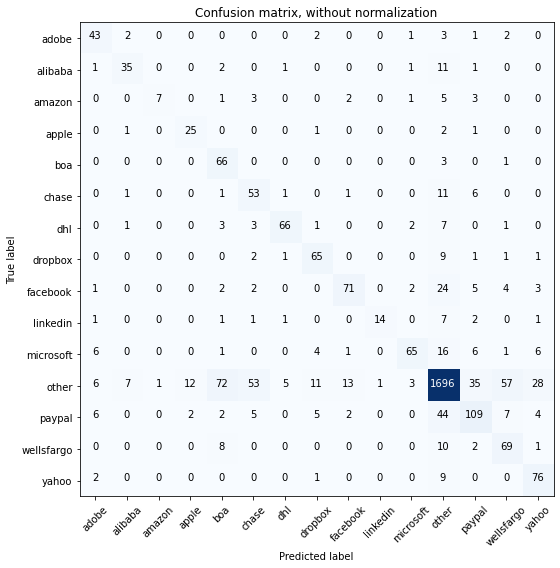

Acc     =  0.799
Pre     =  0.831
Rec     =  0.799
F1      =  0.806

Bal_Acc =  0.712
Bal_Pre =  0.708
Bal_Rec =  0.712
Bal_F1  =  0.71

              precision    recall  f1-score   support

       adobe       0.65      0.80      0.72        54
     alibaba       0.74      0.67      0.71        52
      amazon       0.88      0.32      0.47        22
       apple       0.64      0.83      0.72        30
         boa       0.42      0.94      0.58        70
       chase       0.43      0.72      0.54        74
         dhl       0.88      0.79      0.83        84
     dropbox       0.72      0.81      0.76        80
    facebook       0.79      0.62      0.70       114
    linkedin       0.93      0.50      0.65        28
   microsoft       0.87      0.61      0.72       106
       other       0.91      0.85      0.88      2000
      paypal       0.63      0.59      0.61       186
  wellsfargo       0.48      0.77      0.59        90
       yahoo       0.63      0.86      0.73        8

In [14]:
list_of_analysis=[]
for image_size in list_of_size:
    for models in list_of_combinations:
        model1 = models.split(",")[0]
        model2 = models.split(",")[1]
        for classifier in list_of_classifiers:
            for n_component in n_components:
                print("--------------------------------------------------------------------------")
                print(classifier, model1, model2, image_size, n_component)
                print("")
                accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc = classify(model1, model2, classifier, image_size, n_component)
                list_of_analysis.append(
                    [
                     classifier, model1, model2, image_size, n_component, accuracy, precision, recall, f1_score, balanced_accuracy, PPV, TPR, Bal_F1, TNR, NPV, FPR, FNR, FDR, Overall_Acc
                    ]
                )

In [15]:
list_of_analysis

[['RF',
  'Xception',
  'VGG16',
  128,
  50,
  0.807,
  0.82,
  0.807,
  0.809,
  0.683,
  0.654,
  0.683,
  0.668,
  0.98,
  0.978,
  0.02,
  0.317,
  0.346,
  0.974],
 ['RF',
  'Xception',
  'VGG16',
  128,
  100,
  0.821,
  0.824,
  0.821,
  0.818,
  0.671,
  0.698,
  0.671,
  0.684,
  0.979,
  0.98,
  0.021,
  0.329,
  0.302,
  0.976],
 ['RF',
  'Xception',
  'VGG16',
  128,
  500,
  0.779,
  0.793,
  0.779,
  0.779,
  0.638,
  0.672,
  0.638,
  0.655,
  0.975,
  0.974,
  0.025,
  0.362,
  0.328,
  0.971],
 ['RF',
  'Xception',
  'VGG19',
  128,
  50,
  0.813,
  0.823,
  0.813,
  0.813,
  0.687,
  0.665,
  0.687,
  0.676,
  0.98,
  0.979,
  0.02,
  0.313,
  0.335,
  0.975],
 ['RF',
  'Xception',
  'VGG19',
  128,
  100,
  0.827,
  0.829,
  0.827,
  0.824,
  0.678,
  0.716,
  0.678,
  0.696,
  0.98,
  0.981,
  0.02,
  0.322,
  0.284,
  0.977],
 ['RF',
  'Xception',
  'VGG19',
  128,
  500,
  0.777,
  0.792,
  0.777,
  0.777,
  0.637,
  0.673,
  0.637,
  0.655,
  0.975,
  0.974,
  0

In [16]:
import pandas as pd
df=pd.DataFrame(list_of_analysis, columns=[
                 "classifier",
                 "model1",
                 "model2",
                 "image_size",
                 "n_component",
                 "accuracy", 
                 "precision", 
                 "recall", 
                 "f1_score", 
                 "balanced_accuracy", 
                 "balanced_precision_PPV", 
                 "balanced_recall_TPR", 
                 "Bal_F1",
                 "TNR", 
                 "NPV", 
                 "FPR", 
                 "FNR", 
                 "FDR", 
                 "Overall_Acc"
                ])
df

,classifier,model1,model2,image_size,n_component,accuracy,precision,recall,f1_score,balanced_accuracy,balanced_precision_PPV,balanced_recall_TPR,Bal_F1,TNR,NPV,FPR,FNR,FDR,Overall_Acc
0,RF,Xception,VGG16,128,50,0.807,0.820,0.807,0.809,0.683,0.654,0.683,0.668,0.980,0.978,0.020,0.317,0.346,0.974
1,RF,Xception,VGG16,128,100,0.821,0.824,0.821,0.818,0.671,0.698,0.671,0.684,0.979,0.980,0.021,0.329,0.302,0.976
2,RF,Xception,VGG16,128,500,0.779,0.793,0.779,0.779,0.638,0.672,0.638,0.655,0.975,0.974,0.025,0.362,0.328,0.971
3,RF,Xception,VGG19,128,50,0.813,0.823,0.813,0.813,0.687,0.665,0.687,0.676,0.980,0.979,0.020,0.313,0.335,0.975
4,RF,Xception,VGG19,128,100,0.827,0.829,0.827,0.824,0.678,0.716,0.678,0.696,0.980,0.981,0.020,0.322,0.284,0.977
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
391,RF,DenseNet121,DenseNet201,256,100,0.868,0.870,0.868,0.864,0.732,0.824,0.732,0.775,0.983,0.986,0.017,0.268,0.176,0.982
392,RF,DenseNet121,DenseNet201,256,500,0.803,0.827,0.803,0.808,0.720,0.704,0.720,0.712,0.980,0.977,0.020,0.280,0.296,0.974
393,RF,DenseNet169,DenseNet201,256,50,0.821,0.841,0.821,0.825,0.737,0.730,0.737,0.733,0.982,0.979,0.018,0.263,0.270,0.976
394,RF,DenseNet169,DenseNet201,256,100,0.850,0.859,0.850,0.849,0.734,0.792,0.734,0.762,0.983,0.983,0.017,0.266,0.208,0.980


In [17]:
df.to_csv(analysis_output, header=True, index=False)

In [18]:
df.describe()

,image_size,n_component,accuracy,precision,recall,f1_score,balanced_accuracy,balanced_precision_PPV,balanced_recall_TPR,Bal_F1,TNR,NPV,FPR,FNR,FDR,Overall_Acc
count,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000,396.000000
mean,192.000000,216.666667,0.819636,0.831477,0.819636,0.819684,0.695174,0.723621,0.695174,0.708485,0.979838,0.979717,0.020162,0.304826,0.276379,0.975947
std,64.080961,201.638855,0.027841,0.022561,0.027841,0.025877,0.032769,0.050553,0.032769,0.036919,0.002700,0.003555,0.002700,0.032769,0.050553,0.003710
min,128.000000,50.000000,0.724000,0.742000,0.724000,0.725000,0.553000,0.587000,0.553000,0.569000,0.969000,0.968000,0.015000,0.244000,0.166000,0.963000
25%,128.000000,50.000000,0.803000,0.821000,0.803000,0.807000,0.678000,0.686750,0.678000,0.684000,0.979000,0.978000,0.018000,0.280000,0.235000,0.974000
50%,192.000000,100.000000,0.824000,0.834000,0.824000,0.823000,0.700000,0.723000,0.700000,0.713000,0.980000,0.980000,0.020000,0.300000,0.277000,0.976000
75%,256.000000,500.000000,0.839000,0.847000,0.839000,0.838000,0.720000,0.765000,0.720000,0.735250,0.982000,0.982000,0.021000,0.322000,0.313250,0.979000
max,256.000000,500.000000,0.875000,0.877000,0.875000,0.871000,0.756000,0.834000,0.756000,0.782000,0.985000,0.987000,0.031000,0.447000,0.413000,0.983000
